# Teaser Evaluation Setup

1.9.0+cu102 True
WARNING [02/17 17:25:52 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[02/17 17:25:52 d2.data.datasets.coco]: Loaded 690 images in COCO format from /home/subella/KeypointDetectorData/DataSets/dataset_home_subella_Downloads_2022-01-12-10-27-58.mat/Training/metadata.json
WARNING [02/17 17:25:52 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[02/17 17:25:52 d2.data.datasets.coco]: Loaded 172 images in COCO format from /home/subella/KeypointDetectorData/DataSets/dataset_home_subella_Downloads_2022-01-12-10-27-58.mat/Validation/metadata.json


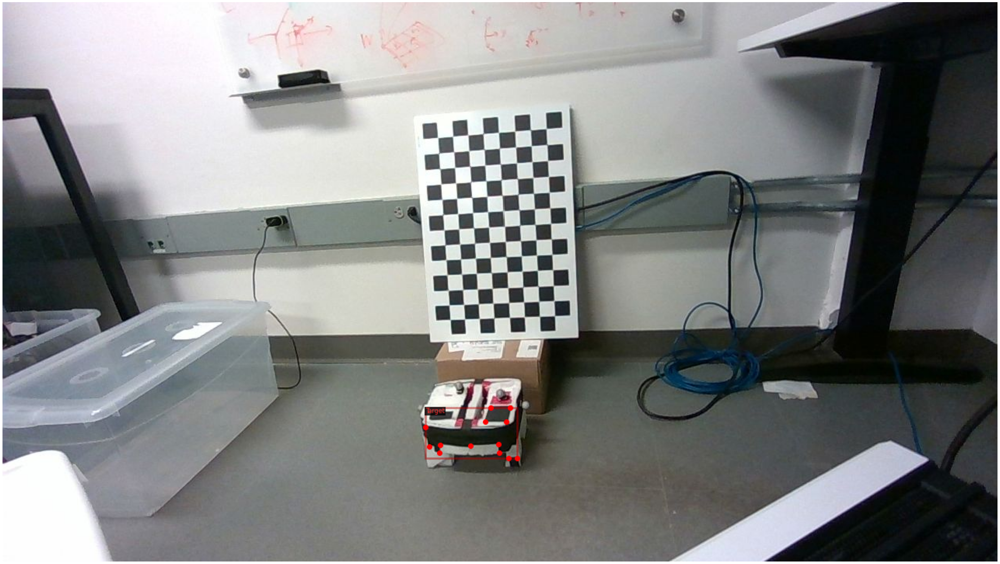

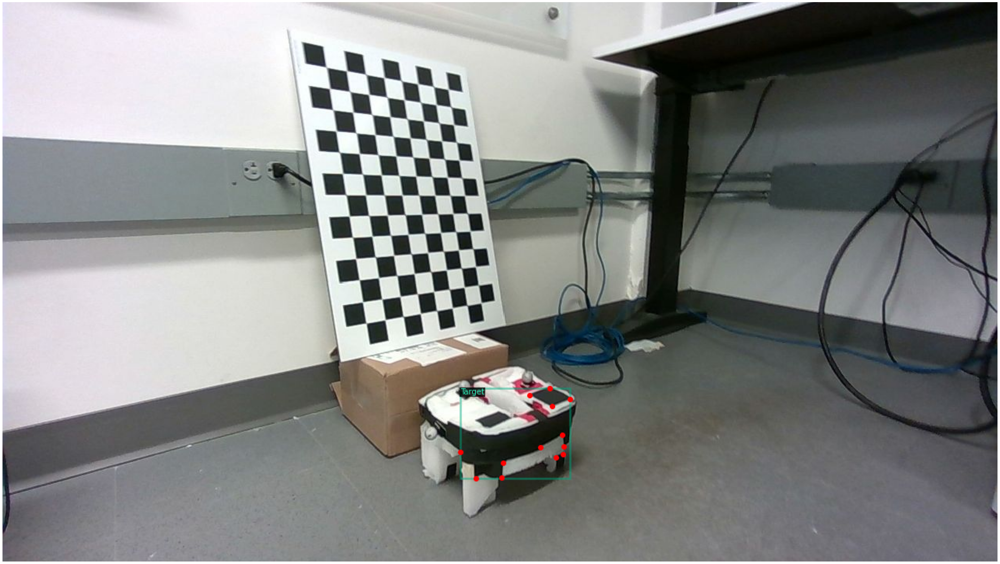

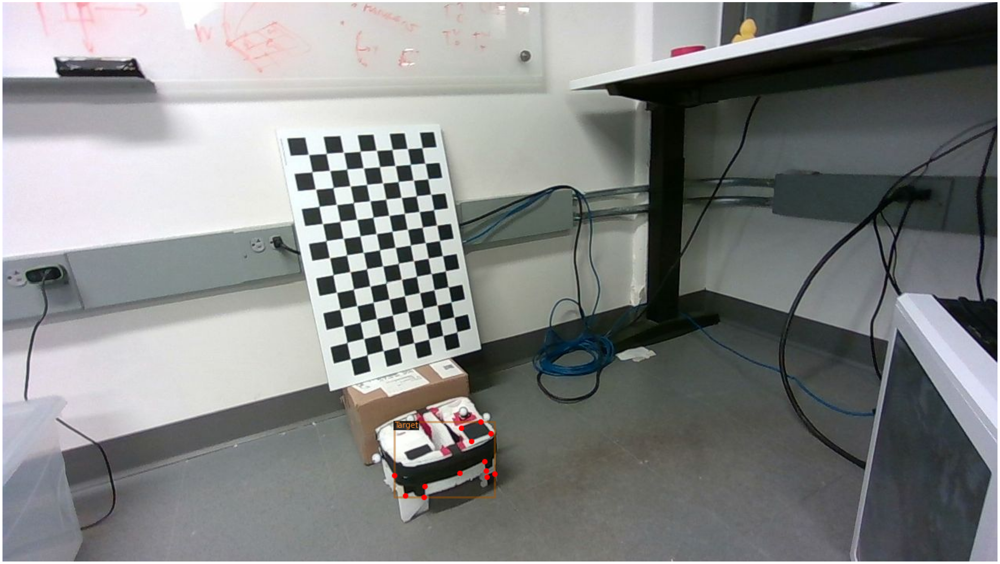

[02/17 17:26:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

WARNING [02/17 17:26:00 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[02/17 17:26:00 d2.data.datasets.coco]: Loaded 690 images in COCO format from /home/subella/KeypointDetectorData/DataSets/dataset_home_subella_Downloads_2022-01-12-10-27-58.mat/Training/metadata.json
[02/17 17:26:00 d2.data.build]: Removed 0 images with no usable annotations. 690 images left.
[02/17 17:26:00 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   Target   | 690          |
|            |              |
[02/17 17:26:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[02/17 17:26:00 d2.data.build]: Using training sampler TrainingSampler
[02/17 17:26:00 d2.data.common]: Serializing 690 elements to byte tensors and conca

/home/subella/src/VirtualEnvironments/python37/lib/python3.7/site-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/home/subella/src/VirtualEnvironments/python37/lib/python3.7/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, 

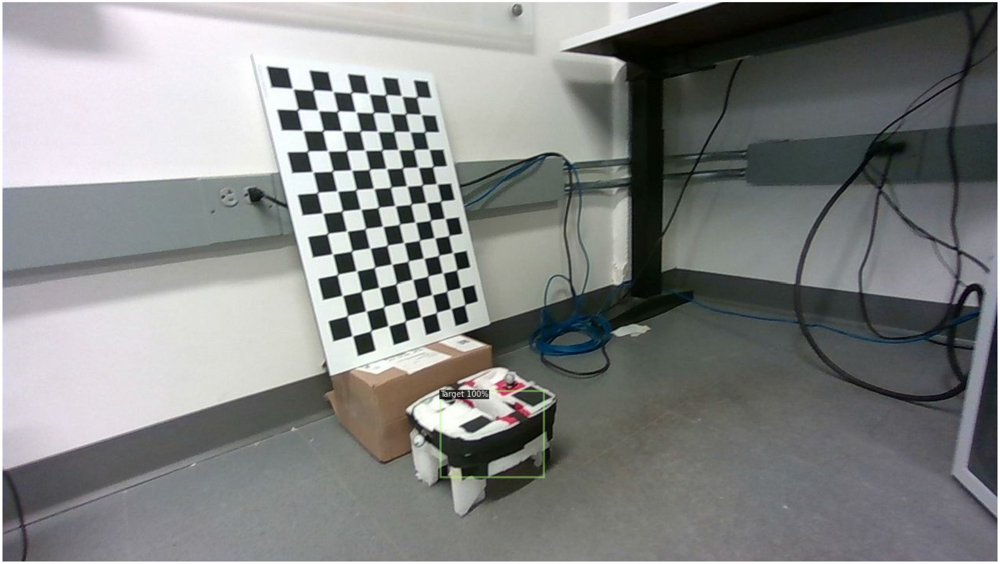

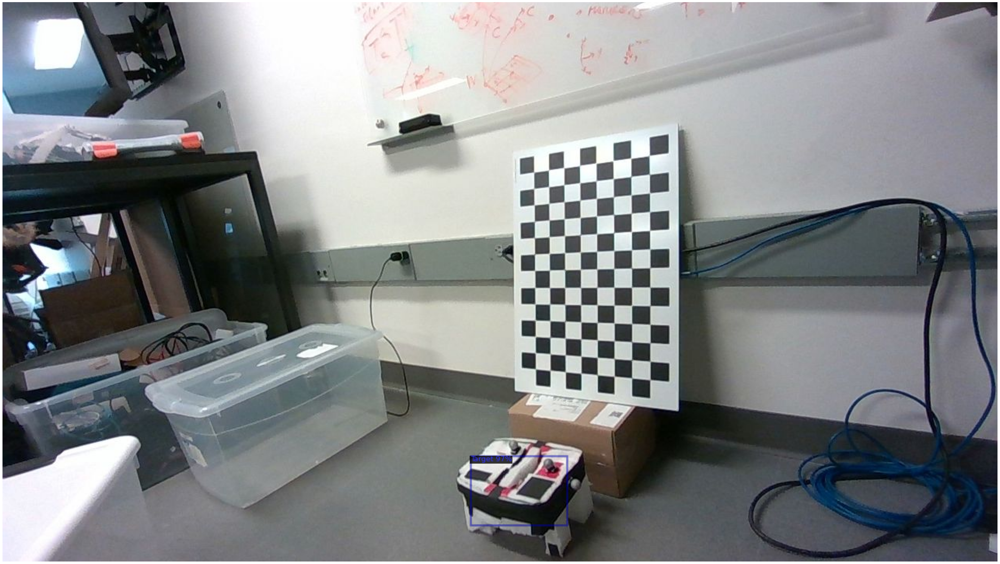

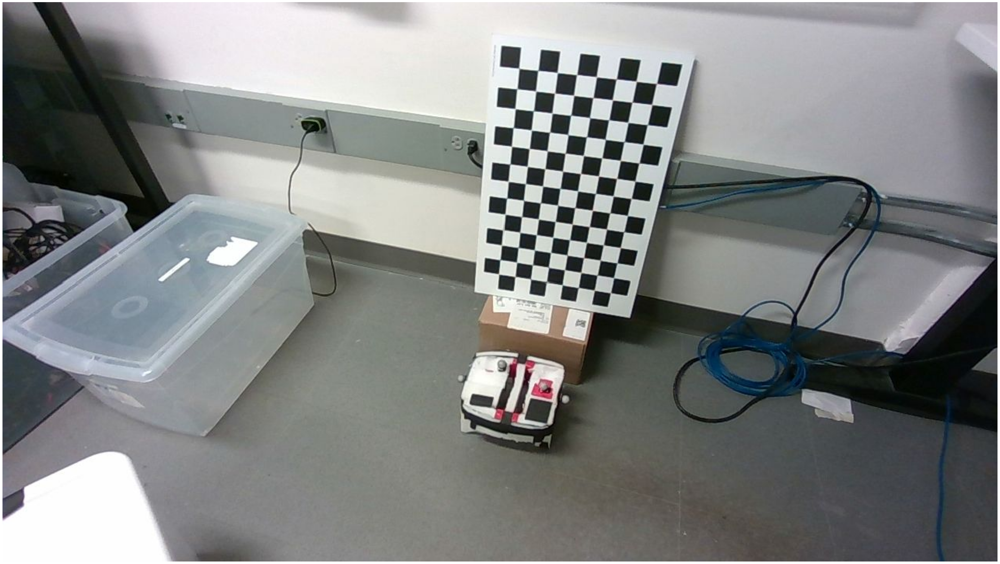

WARNING [02/17 17:26:07 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[02/17 17:26:07 d2.data.datasets.coco]: Loaded 172 images in COCO format from /home/subella/KeypointDetectorData/DataSets/dataset_home_subella_Downloads_2022-01-12-10-27-58.mat/Validation/metadata.json
[02/17 17:26:07 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   Target   | 172          |
|            |              |
[02/17 17:26:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/17 17:26:07 d2.data.common]: Serializing 172 elements to byte tensors and concatenating them all ...
[02/17 17:26:07 d2.data.common]: Serialized dataset takes 0.10 MiB
[02/17 17:26:07 d2.evaluation.evaluator]: Start inference on 172 batches
[02/17 17:26:09 d2.evaluation.eval

KeyboardInterrupt: 

In [29]:
import json
import seaborn as sns
from scipy.spatial.transform import Rotation as Rotation
import pandas as pd

Create some helper functions for coordinate frame conversion and Unity to ENU conversion:

In [6]:
# Converts Unity's left-handed coordinate system to ENU
# by swapping the y and z axes.
UNITY_TO_ENU = np.array([[1,0,0,0],
                         [0,0,1,0],
                         [0,1,0,0],
                         [0,0,0,1]])

CAMERA_TO_ENU = np.array([[1,0,0,0],
                         [0,0,1,0],
                         [0,-1,0,0],
                         [0,0,0,1]])

In [7]:
def transform_kpts(src, transformation):
    """
    Transforms array of positions by the transformation.

    Parameters
    ----------
    src : 3,x np array
        Positions in the original frame.
    transformation : 4,4 np array
        Transformation matrix.
        
    Returns
    -------
    3,x np array
        Positions in the transformed frame.

    """
    ones = np.ones(src.shape[1])
    src_homo_T = np.vstack((src, ones)).T
    dst = (src_homo_T.dot(transformation.T)).T[:3]
    return dst

def kpts_unity_to_enu_np(kpts_unity):
    """
    Converts a Unity keypoints dict to numpy array in ENU.

    Parameters
    ----------
    unity_keypoints : dict
        Contains keys "x", "y", "z" for positions
        in Unity's left-handed frame.

    Returns
    -------
    3x20 np array
        Array of keypoint positions.
        Rows are x,y,z.

    """
    kpts_np = np.zeros((3, len(kpts_unity)))
    for kpt_id in range(len(kpts_unity)):
        kpt = kpts_unity[kpt_id]
        kpt_np = pos_unity_to_np(kpt)
        kpts_np[:,kpt_id] = kpt_np.reshape((3,))
    kpts_enu = transform_kpts(kpts_np, UNITY_TO_ENU)
    return kpts_enu

def pos_unity_to_np(pos_unity):
    """
    Converts a Unity position dict to numpy array.

    Parameters
    ----------
    pos_unity : dict
        Contains keys "x", "y", "z" for position
        in Unity's left-handed frame.

    Returns
    -------
    3, np array
        Position vector in np format.

    """
    pos_np = np.array([pos_unity["x"], pos_unity["y"], pos_unity["z"]])
    return pos_np

def quat_unity_to_np(quat_unity):
    """
    Converts a Unity quaternion dict to numpy array.

    Parameters
    ----------
    quat_unity : dict
        Contains keys "x", "y", "z", "w" for quaternion
        in Unity's left-handed frame.

    Returns
    -------
    4, np array
        Quaternion in np format.

    """
    quat_np = np.array([quat_unity["x"], quat_unity["y"], quat_unity["z"], quat_unity["w"]])
    return quat_np

def quat_to_rot_matrix(quat):
    """
    Converts a quaternion to rotation matrix.

    Parameters
    ----------
    quat : 4, np array
        Quaternion in numpy format x, y, z, w.

    Returns
    -------
    3,3 np array
        Rotation matrix.

    """
    r = Rotation.from_quat(quat)
    rot_np = r.as_matrix()
    return rot_np
    
def make_transformation_matrix(rot, trans):
    """
    Creates a transformation matrix.

    Parameters
    ----------
    rot : 3,3 np array
        Rotation matrix.
    tras : 3, np array
        Translation vector.

    Returns
    -------
    4,4 np array
        Transformation matrix.

    """
    transformation = np.empty((4,4))
    transformation[:3, :3] = rot
    transformation[:3, 3] = trans
    transformation[3, :] = [0, 0, 0, 1]
    return transformation
        
def unity_to_enu_transformation(pos_unity, quat_unity):
    """
    Creates a transformation matrix from Unity to ENU.

    Parameters
    ----------
    pos_unity : dict
        Contains keys "x", "y", "z" for position
        in Unity's left-handed frame.
    quat_unity : dict
        Contains keys "x", "y", "z", "w" for quaternion
        in Unity's left-handed frame.

    Returns
    -------
    4,4 np array
        Transformation matrix.

    """
    
    quat_np = quat_unity_to_np(quat_unity)
    rot_matrix = quat_to_rot_matrix(quat_np)
    if pos_unity is not None:
        pos = pos_unity_to_np(pos_unity)
    else:
        pos = np.zeros((3,))
    
    transformation = make_transformation_matrix(rot_matrix, pos)
    unity_to_enu = UNITY_TO_ENU.dot(transformation).dot(UNITY_TO_ENU)
    return unity_to_enu

Evaluation and Visualization code:

In [8]:
def plot_teaser(src, dst, est_dst=None, dst_gt_pose=None):
    """
    Plots keypoints for teaser visualization.

    Parameters
    ----------
    src : 3,x np array
        Keypoints in the target frame.
    dst : 3,x np array
        Ground truth keypoints wrt the camera frame.
    est_dst: 3,x np array
        dst keypoints computed using Teaser's pose 
        estimate and transforming each src keypoint.
    dst_gt_pose : 3,x np array
        dst keypoints computed using the ground truth
        pose and transforming each src keypoint.

    """
    %matplotlib inline
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(src[0], src[1], src[2], c='green', label='src')
    ax.scatter(dst[0], dst[1], dst[2], c='red', label='dst')
    vals = np.hstack((src, dst))
    if est_dst is not None:
        vals = np.hstack((vals, est_dst))
        ax.scatter(est_dst[0], est_dst[1], est_dst[2], c='purple', label='est_dst')
    if dst_gt_pose is not None:
        vals = np.hstack((vals, dst_gt_pose))
        ax.scatter(dst_gt_pose[0], dst_gt_pose[1], dst_gt_pose[2], c='orange', label='transformed_dst')
    ax.legend()
    ax.set_box_aspect((np.ptp(vals[0]), np.ptp(vals[1]), np.ptp(vals[2])))
    plt.show()
    
def plot_samples(est_dst_kpts_arr, gt_dst_kpts_arr, est_transformation_arr, num_samples=3):
    for i in range(num_samples):
        est_dst_transformed = transform_kpts(src, est_transformation_arr[i])
        plot_teaser(src, gt_dst_kpts_arr[i], est_dst_kpts_arr[i], est_dst_transformed)
        
def evaluate_teaser(est_transformation_arr, gt_transformation_arr, data_name="Data"):
    """
    Computes error metrics on Teaser's performance.

    Parameters
    ----------
    est_transformation_arr : x,4,4 np array
        Estimated positions for each image.
    gt_transformation_arr : x,4,4 np array
        Ground truth positions for each image.

    """
    est_rot_arr = est_transformation_arr[:,:3,:3]
    gt_rot_arr = gt_transformation_arr[:,:3,:3]
    est_pos_arr = est_transformation_arr[:,:3,3]
    gt_pos_arr = gt_transformation_arr[:,:3,3]

    # Rotation error represents the angle between estimated and ground truth matrices:
    # theta = arccos( (tr(R) - 1) / 2), R = Rd'R
    R = np.matmul(gt_rot_arr.transpose((0,2,1)), est_rot_arr)

    cos_theta = np.clip((np.trace(R, axis1=1, axis2=2) - 1)/2, -1, 1)
    # rot_err_norms ia a (n,) array with each entry the rotation error formula above.
    rot_error_norms = np.arccos(cos_theta)
    rot_error_avg = np.mean(rot_error_norms)
    
    # pos_error_norms is a (n,) array with each entry the error norm for the
    # corresponding image.
    pos_error_norms = np.linalg.norm(est_pos_arr - gt_pos_arr, axis=1)
    # pos_error_avg averages all of the error norms for each image.
    pos_error_avg = np.mean(pos_error_norms)
    
    pos_error_norms = pd.DataFrame(pos_error_norms.T, columns = [data_name])
    rot_error_norms = pd.DataFrame(rot_error_norms.T, columns = [data_name])
    
    return pos_error_norms, rot_error_norms
    
def plot_errors(pos_error_norms, rot_error_norms, pos_max=None, rot_max=None):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,7))
    if pos_max is not None:
        ax[0].set_xlim([0, pos_max])
    sns.histplot(pos_error_norms, ax=ax[0]).set_title("Position Errors (mm)")
#     sns.histplot(pos_error_norms, ax=ax[1]).set_title("Position Errors (m)")
    
#     fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15,7))
    if rot_max is not None:
        ax[1].set_xlim(0, rot_max)
    sns.histplot(rot_error_norms, ax=ax[1]).set_title("Rotation Errors (rad)")
#     sns.histplot(rot_error_norms, ax=ax[1]).set_title("Rotation Errors (rad)")
    
def plot_errors_distance(pos_error_norms, rot_error_norms, gt_transformation_arr, column):
    distances = np.linalg.norm(gt_transformation_arr[:,:3,3], axis=1)
    distances = pd.DataFrame(distances, columns = ["Distance"])
    pos_error_norms = pd.concat([pos_error_norms, distances], axis=1)
    rot_error_norms = pd.concat([rot_error_norms, distances], axis=1)
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,7))
    sns.regplot("Distance", column, data=pos_error_norms, ax=ax[0]).set_title("{} Position Errors (mm)".format(column))
    sns.regplot("Distance", column, data=rot_error_norms, ax=ax[1]).set_title("{} Rotation Errors (rad)".format(column))
    ax[0].set(xlabel='Distance', ylabel='Error')
    ax[1].set(xlabel='Distance', ylabel='Error')

Teaser specific utils:

In [9]:
def estimate_pose(solver, src, dst):
    # Populate the parameters    
    solver.solve(src, dst)
    solution = solver.getSolution()
    return solution.translation.copy(), solution.rotation.copy()

def get_src_kpts(data):
    # Positions of the keypoints in the CAD frame.
    src_kpts = data["keypointFrame"]["localKeypoints"]
    src_kpts_wrt_cam = kpts_unity_to_enu_np(src_kpts)
    return src_kpts_wrt_cam

def get_est_tar_wrt_cam_tf(solver, src_kpts_wrt_cam, dst_kpts_wrt_cam):
    """
        Returns the transform of target wrt cam using teaser 
        with ground truth keypoints
    """

    # By construction the transform src wrt world is the identity.
    gt_src_wrt_cam_tf = np.eye(4)

    # Target's tf relative to the keypoints CAD frame.
    est_tar_wrt_src_pos, est_tar_wrt_src_rot = estimate_pose(solver, src_kpts_wrt_cam, dst_kpts_wrt_cam)
    est_tar_wrt_src_tf = make_transformation_matrix(est_tar_wrt_src_rot, est_tar_wrt_src_pos)

    est_tar_wrt_cam_tf = np.matmul(est_tar_wrt_src_tf, gt_src_wrt_cam_tf)
    return est_tar_wrt_cam_tf

def get_gt_tar_wrt_cam_tf(annotation):
    """
        Computes ground truth transformation matrix of target wrt camera.
    """
    gt_tar_wrt_cam_pos_unity = annotation["localPosition"]
    gt_tar_wrt_cam_rot_unity = annotation["localRotation"]
    gt_tar_wrt_cam_tf = unity_to_enu_transformation(gt_tar_wrt_cam_pos_unity, gt_tar_wrt_cam_rot_unity)
    return gt_tar_wrt_cam_tf

def get_gt_tar_wrt_cam_tf_hardware(annotation):
    gt_tar_wrt_cam_pos = annotation["localPosition"].copy()
    gt_tar_wrt_cam_rot = annotation["localRotation"].copy()
    gt_tar_wrt_cam_rot.append(gt_tar_wrt_cam_rot.pop(0))
    gt_tar_wrt_cam_rot = quat_to_rot_matrix(gt_tar_wrt_cam_rot)
    gt_tar_wrt_cam_tf = make_transformation_matrix(gt_tar_wrt_cam_rot, gt_tar_wrt_cam_pos)
    return gt_tar_wrt_cam_tf

#  Ground Truth Keypoint Detections

In [10]:
def get_all_ids(visibility):
    """
    Placeholder function that does not filter out any 
    invisible keypoints
    """
    best_ids = np.indices(visibility.shape)[0]
    return best_ids
    
def get_best_ids(visibility):
    """
    Returns an index array containing the visible keypoints.
    """
    best_ids = np.argpartition(visibility, -15)[-15:]
    return best_ids
    
def get_gt_kpts(annotation):
    """
    Returns the true ground truth world coordinates.
    """
    gt_kpts_wrt_cam_unity = annotation["groundTruthKeypoints"]
    dst_kpts_wrt_cam = kpts_unity_to_enu_np(gt_kpts_wrt_cam_unity)
    
    # TODO: Visibility information is only store in the "keypoints" entry.
    gt_kpts_wrt_cam_pix_unity = annotation["keypoints"]
    gt_kpts_wrt_cam_pix = kpts_pix_unity_to_np(gt_kpts_wrt_cam_pix_unity)
    visibility = gt_kpts_wrt_cam_pix[:,2]
    dst_kpts_wrt_cam = np.vstack((dst_kpts_wrt_cam, visibility.T))
    
    return dst_kpts_wrt_cam

def get_gt_kpts_hardware(annotation):
    dst_kpts_wrt_cam = np.array(annotation["groundTruthKeypoints"]).T
    print (dst_kpts_wrt_cam)
    return dst_kpts_wrt_cam

# Depth Keypoint Detections

In [11]:
def pixels_to_meters(px, py, z, K):
    """
        Convert pixel coordinates + depth to world coordinates.
    """
    fx = K[0,0]
    fy = K[1,1]
    cx = K[0,2]
    cy = K[1,2]
    x = (px - cx) * z / fx
    y = (py - cy) * z / fy
    pos = np.array([x, y, z])
    return pos

def kpts_pix_unity_to_np(kpts, filter_visible=True):
    """
        Convert a list of kpts in the form 
        [px1, py1, v1, ..., pxn, pyn, vn]
        to:
        [[px1,py1],
         ...
         [pxn, pyn]]
    """
    kpts_np = np.array(kpts)
    kpts_np = kpts_np.reshape((len(kpts)//3, 3))
    return kpts_np

def get_depth_kpts(annotation, kpts_wrt_cam_pix):
    """
        Returns keypoints in meters using depth info and
        ground truth pixel coordinates.
    """
    depth_image_name = teaser_folder + annotation["depth_file_name"]
    depth_image_rgba = cv2.imread(depth_image_name,cv2.IMREAD_UNCHANGED)
    depth_image_bgra = cv2.cvtColor(depth_image_rgba, cv2.COLOR_RGBA2BGRA)
    
    # Converts BGRA to float array.
    coeffs = np.array([1.0, 1/255., 1/(255.**2), 1/(255.**3)])
    depth_image = np.dot(depth_image_bgra, coeffs).astype('float32')  
    depth_image /= 255.0
    
    # Multiply by far render distance to get values in meters. (TODO: hardcoded)
    depth_image *= 50

    px = np.clip(kpts_wrt_cam_pix[:,0].astype(int), 0, 719)
    py = np.clip(kpts_wrt_cam_pix[:,1].astype(int), 0 , 479)
    z = depth_image[py,px]

    # Hardcoded camera matrix from tesse.
    K = np.array([[415.69219381653056, 0.0, 360.0],
                  [0.0, 415.69219381653056, 240.0],
                  [0.0, 0.0, 1.0]])

    # Get the 3D coordinate for each keypoint 
    est_kpts_wrt_cam = pixels_to_meters(px, py, z, K)
    
    # Convert camera coordinate frame to ENU
    est_kpts_wrt_cam_enu = transform_kpts(est_kpts_wrt_cam, CAMERA_TO_ENU)
    
    # Append visibility info to array.
    est_kpts_wrt_cam_enu = np.vstack((est_kpts_wrt_cam_enu, kpts_wrt_cam_pix[:,2].T))
    return est_kpts_wrt_cam_enu

def get_depth_kpts_hardware(annotation, kpts_wrt_cam_pix):
    """
        Returns keypoints in meters using depth info and
        ground truth pixel coordinates.
    """
    depth_image_name = teaser_folder + annotation["depth_file_name"]
    depth_image = cv2.imread(depth_image_name,cv2.IMREAD_UNCHANGED)   


    px = np.clip(kpts_wrt_cam_pix[:,0].astype(int), 0, 1279)
    py = np.clip(kpts_wrt_cam_pix[:,1].astype(int), 0 , 719)
    z = depth_image[py,px]

    # Hardcoded camera matrix from tesse.
    K = np.array([[629.1040649414062, 0.0, 637.203369140625], 
                  [0.0, 628.583251953125, 380.56463623046875], 
                  [0.0, 0.0, 1.0]])

    # Get the 3D coordinate for each keypoint 
    est_kpts_wrt_cam = pixels_to_meters(px, py, z, K)
    
    # Convert camera coordinate frame to ENU
#     est_kpts_wrt_cam_enu = transform_kpts(est_kpts_wrt_cam, CAMERA_TO_ENU)
    
    # Append visibility info to array.
    est_kpts_wrt_cam_enu = np.vstack((est_kpts_wrt_cam, kpts_wrt_cam_pix[:,2].T))
    return est_kpts_wrt_cam_enu

def get_depth_gt_kpts(annotation):
    gt_kpts_wrt_cam_pix_unity = annotation["keypoints"]
    # The ground truth keypoints' pixels (px, py) wrt to the camera frame using
    # a camera coordinate system. (z forward, x right, y down)
    gt_kpts_wrt_cam_pix = kpts_pix_unity_to_np(gt_kpts_wrt_cam_pix_unity)
    return get_depth_kpts(annotation, gt_kpts_wrt_cam_pix)

def get_depth_gt_kpts_hardware(annotation):
    gt_kpts_wrt_cam_pix_unity = annotation["keypoints"]
    # The ground truth keypoints' pixels (px, py) wrt to the camera frame using
    # a camera coordinate system. (z forward, x right, y down)
    gt_kpts_wrt_cam_pix = kpts_pix_unity_to_np(gt_kpts_wrt_cam_pix_unity)
    return get_depth_kpts_hardware(annotation, gt_kpts_wrt_cam_pix)

# Neural Net + Depth Keypoint Predictions

In [12]:
def get_nn_visible_ids(visibility):
    visible_ids = np.where(visibility > 0.0)[0]
    return visible_ids

def get_depth_nn_kpts(annotation):
    rgb_image_name = teaser_folder + annotation["file_name"]
    bgr_image = cv2.imread(rgb_image_name)
    rgb_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)
    
    model = model_no_detectron
    est_kpts_wrt_cam_pix = model(rgb_image)
    
    if est_kpts_wrt_cam_pix is None:
        return None
    
    est_kpts_wrt_cam_pix = est_kpts_wrt_cam_pix.cpu().detach().numpy()[:,:3]
    return get_depth_kpts(annotation, est_kpts_wrt_cam_pix)

def get_depth_nn_kpts_hardware(annotation):
    rgb_image_name = teaser_folder + annotation["depth_file_name"]
    rgb_image_name = rgb_image_name.replace("depth", "rgb")
    rgb_image = cv2.imread(rgb_image_name)
    
#     model = model_no_detectron
    est_kpts_wrt_cam_pix = model(rgb_image)
    
    if est_kpts_wrt_cam_pix is None:
        return None
    
    est_kpts_wrt_cam_pix = est_kpts_wrt_cam_pix.cpu().detach().numpy()[:,:3]
    return get_depth_kpts_hardware(annotation, est_kpts_wrt_cam_pix)    

# Teaser Evaluation

In [13]:
def compute_test_set(data, solver_params, get_est_kpts, filter_best=False):

    annotations = data["annotations"]
    # TODO: Make consistent between unity and hardware.
#     gt_src_kpts_wrt_cam = get_src_kpts(data)
    gt_src_kpts_wrt_cam = np.array(data['keypointFrame']['localKeypoints']).T
    
    gt_transformation_arr = np.zeros((len(annotations),4,4))
    est_transformation_arr = np.zeros((len(annotations),4,4))
    gt_dst_kpts_arr = np.zeros((len(annotations), 
                                gt_src_kpts_wrt_cam.shape[0],
                                gt_src_kpts_wrt_cam.shape[1]))
    est_dst_kpts_arr = np.zeros((len(annotations), 
                                gt_src_kpts_wrt_cam.shape[0],
                                gt_src_kpts_wrt_cam.shape[1]))
    failures = 0
    
    for annotation_id, annotation in enumerate(annotations):
        solver = teaserpp_python.RobustRegistrationSolver(solver_params)

        gt_dst_kpts_wrt_cam = get_gt_kpts_hardware(annotation)
        est_dst_kpts_wrt_cam = get_est_kpts(annotation)
        
        if est_dst_kpts_wrt_cam is None:
            print("Error getting keypoints")
            failures += 1
            continue
        
        if filter_best:
            est_best_ids = get_best_ids(est_dst_kpts_wrt_cam[3])
            # TODO: IT's probably better to just leave keypoints as (n,4) and transpose
            # for final step.
            src = (gt_src_kpts_wrt_cam.T[est_best_ids].T)[:3]
            dst = (est_dst_kpts_wrt_cam.T[est_best_ids].T)[:3]
        else:
            src = gt_src_kpts_wrt_cam[:3]
            dst = est_dst_kpts_wrt_cam[:3]
        
        
        if (src.shape[1] <= 3):
            print("Too little keypoints!")
            failures += 1
            continue
        
        gt_tar_wrt_cam_tf = get_gt_tar_wrt_cam_tf_hardware(annotation)
        est_tar_wrt_cam_tf = get_est_tar_wrt_cam_tf(solver, 
                                                    src, 
                                                    dst)
        
        print("GT", gt_tar_wrt_cam_tf)
        print("EST", est_tar_wrt_cam_tf)
        
        gt_transformation_arr[annotation_id] = gt_tar_wrt_cam_tf
        est_transformation_arr[annotation_id] = est_tar_wrt_cam_tf
        
        gt_dst_kpts_arr[annotation_id] = gt_dst_kpts_wrt_cam[:3]
        est_dst_kpts_arr[annotation_id] = est_dst_kpts_wrt_cam[:3]
        
        plot_teaser(src, dst, gt_dst_kpts_wrt_cam[:3], transform_kpts(src, gt_tar_wrt_cam_tf))
    
    print("{} out of {} images failed".format(failures, len(annotations)))
    return gt_transformation_arr, est_transformation_arr, gt_dst_kpts_arr, est_dst_kpts_arr

Plot the first annotated keypoint frame for a sanity check:

In [15]:
teaser_folder = "/home/subella/KeypointDetectorData/DataSets/dataset_home_subella_Downloads_2022-01-12-10-27-58.mat/Validation/"

# Open the data folder and parse the metadata into a python dict.
with open(teaser_folder + "metadata.json") as json_file:
    data = json.load(json_file)

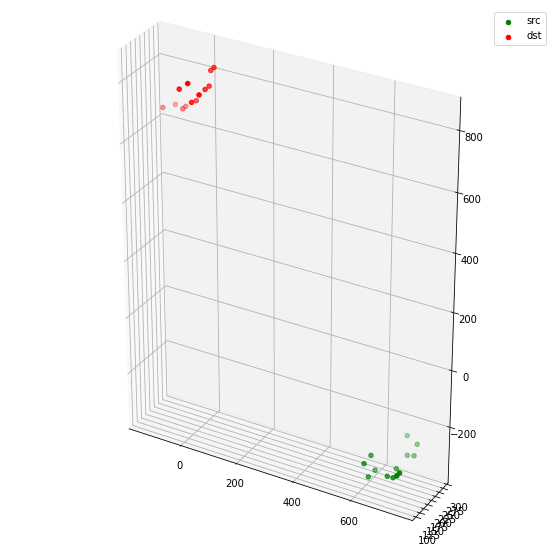

In [18]:
src_kpts = data["keypointFrame"]["localKeypoints"]
dst_kpts = data["annotations"][0]["groundTruthKeypoints"]

# src = kpts_unity_to_enu_np(src_kpts)
# dst = kpts_unity_to_enu_np(dst_kpts)

src = np.array(src_kpts)
dst = np.array(dst_kpts)

plot_teaser(src.T, dst.T)

Initialize the solver:

In [21]:
import teaserpp_python

# Initialize Teaser Solver
solver_params = teaserpp_python.RobustRegistrationSolver.Params()
solver_params.cbar2 = 1
solver_params.noise_bound = 5
solver_params.estimate_scaling = False
solver_params.rotation_estimation_algorithm = (
    teaserpp_python.RobustRegistrationSolver.ROTATION_ESTIMATION_ALGORITHM.GNC_TLS
)
solver_params.rotation_gnc_factor = 1.4
solver_params.rotation_max_iterations = 100
solver_params.rotation_cost_threshold = 1e-6

print("TEASER++ Parameters are:", solver_params)

TEASER++ Parameters are: <Params with noise_bound=5
cbar2=1
estimate_sccaling=0
rotation_estimation_algorithm=GNC-TLS
inlier_selection_mode=PMC_EXACT
>


In [30]:
def evaluate_comparison(data, solver_params):
    gt_transformation_arr, est_transformation_arr,\
    gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_gt_kpts_hardware)
    gt_pos_error_norms, gt_rot_error_norms = evaluate_teaser(est_transformation_arr, 
                                                             gt_transformation_arr, 
                                                             data_name="Ground Truth")
    
    
#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_gt_kpts, filter_best=True)
#     gt_pos_error_norms_filt, gt_rot_error_norms_filt = evaluate_teaser(est_transformation_arr,
#                                                                        gt_transformation_arr,
#                                                                        data_name="Ground Truth Filt")

    gt_transformation_arr, est_transformation_arr,\
    gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_gt_kpts_hardware)
    depth_pos_error_norms, depth_rot_error_norms = evaluate_teaser(est_transformation_arr, 
                                                                   gt_transformation_arr,
                                                                   data_name="Depth")

#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_gt_kpts, filter_best=True)
#     depth_pos_error_norms_filt, depth_rot_error_norms_filt = evaluate_teaser(est_transformation_arr, 
#                                                                              gt_transformation_arr,
#                                                                              data_name="Depth Filt")

    gt_transformation_arr, est_transformation_arr,\
    gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_nn_kpts_hardware)
    nn_pos_error_norms, nn_rot_error_norms = evaluate_teaser(est_transformation_arr, 
                                                             gt_transformation_arr,
                                                             data_name="Detector")

#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_nn_kpts, filter_best=True)
#     nn_pos_error_norms_filt, nn_rot_error_norms_filt = evaluate_teaser(est_transformation_arr,
#                                                                        gt_transformation_arr,
#                                                                        data_name="Detector Filt")

#     pos_error_norms = pd.concat([gt_pos_error_norms, gt_pos_error_norms_filt,
#                                  depth_pos_error_norms, depth_pos_error_norms_filt,
#                                  nn_pos_error_norms, nn_pos_error_norms_filt], axis=1)
    
#     rot_error_norms = pd.concat([gt_rot_error_norms, gt_pos_error_norms_filt,
#                                  depth_rot_error_norms, depth_rot_error_norms_filt,
#                                  nn_rot_error_norms, nn_rot_error_norms_filt], axis=1)

    pos_error_norms = pd.concat([gt_pos_error_norms, depth_pos_error_norms, nn_pos_error_norms], axis=1)
    
    rot_error_norms = pd.concat([gt_rot_error_norms, depth_rot_error_norms, nn_rot_error_norms], axis=1)

    return pos_error_norms, rot_error_norms, gt_transformation_arr

def plot_comparison(pos_error_norms, rot_error_norms):
    # Plotting
    plot_errors(pos_error_norms[["Depth", "Depth Filt"]], 
                rot_error_norms[["Depth", "Depth Filt"]],
                pos_max=0.05, rot_max=0.5)
    
    plot_errors(pos_error_norms[["Detector", "Detector Filt"]], 
                rot_error_norms[["Detector", "Detector Filt"]],
                pos_max=None, rot_max=None)
    
    plot_errors(pos_error_norms[["Ground Truth", "Depth", "Detector"]], 
                rot_error_norms[["Ground Truth", "Depth", "Detector"]],
                pos_max=0.05, rot_max=0.2)

# Easy Test Set

In [31]:
teaser_folder = "/home/subella/KeypointDetectorData/DataSets/dataset_home_subella_Downloads_2022-01-12-10-27-58.mat/Validation/"

# Open the data folder and parse the metadata into a python dict.
with open(teaser_folder + "metadata.json") as json_file:
    data = json.load(json_file)

[[  33.2724982     4.9671052     1.25381468  -31.26401346   21.82148281
    20.08924026  -14.09728151  -66.51182183  -69.04602762 -105.7634699
  -126.35688104   21.54286407    9.59531259]
 [ 164.79990612  168.29259231  154.91091854  159.63966852  239.96312074
   219.90923897  224.50828476  232.98404034  253.64538866  254.1953732
   216.87030347  268.9356993   270.24513745]
 [ 780.78155908  747.98341003  813.90712514  785.87050527  774.19316156
   771.4787762   724.36339773  680.92319297  679.28279643  676.00235736
   676.99352248  822.48078072  809.36966347]]
[[  33.2724982     4.9671052     1.25381468  -31.26401346   21.82148281
    20.08924026  -14.09728151  -66.51182183  -69.04602762 -105.7634699
  -126.35688104   21.54286407    9.59531259]
 [ 164.79990612  168.29259231  154.91091854  159.63966852  239.96312074
   219.90923897  224.50828476  232.98404034  253.64538866  254.1953732
   216.87030347  268.9356993   270.24513745]
 [ 780.78155908  747.98341003  813.90712514  785.87050527 

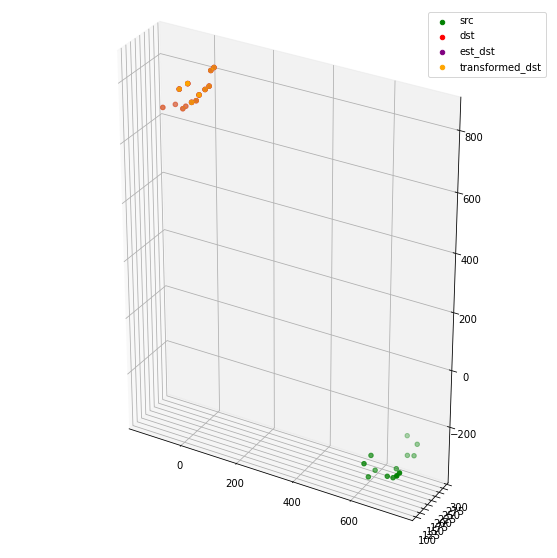

[[  33.31021063    5.01059094    1.28562427  -31.22724863   21.86120745
    20.12920981  -14.04902333  -66.45587277  -68.98955527 -105.70641728
  -126.30042864   21.57448003    9.62923546]
 [ 164.75957353  168.25233147  154.8712072   159.60011376  239.92286855
   219.86898573  224.46806048  232.94408191  253.60544661  254.1558262
   216.83099981  268.89582166  270.20529573]
 [ 780.89885351  748.09573051  814.01889845  785.97655875  774.30787662
   771.59334271  724.47195402  681.02252304  679.38152471  676.09466349
   677.08251598  822.59522357  809.48200811]]
[[  33.31021063    5.01059094    1.28562427  -31.22724863   21.86120745
    20.12920981  -14.04902333  -66.45587277  -68.98955527 -105.70641728
  -126.30042864   21.57448003    9.62923546]
 [ 164.75957353  168.25233147  154.8712072   159.60011376  239.92286855
   219.86898573  224.46806048  232.94408191  253.60544661  254.1558262
   216.83099981  268.89582166  270.20529573]
 [ 780.89885351  748.09573051  814.01889845  785.9765587

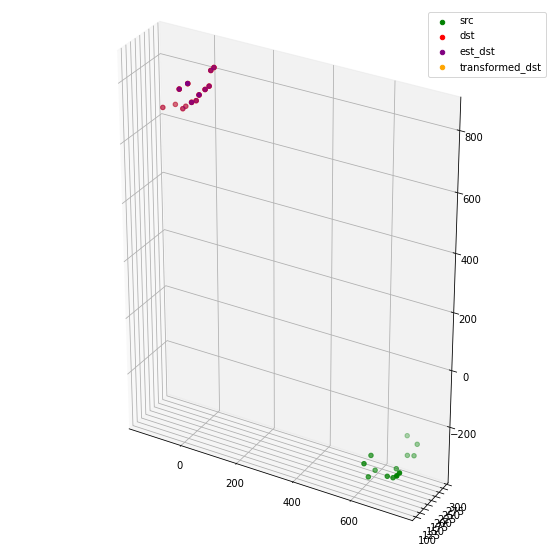

[[  33.29223215    4.99157132    1.26666508  -31.24653981   21.86684006
    20.1282486   -14.05161427  -66.45861045  -68.98579138 -105.70269179
  -126.30857708   21.59256054    9.64687205]
 [ 164.47334278  167.9980616   154.57209083  159.3309805   239.64488084
   219.5934538   224.2363695   232.75949662  253.42281173  253.98723065
   216.66831235  268.58419239  269.90664526]
 [ 780.86514837  748.06634252  813.98039501  785.94351299  774.3274233
   771.59899893  724.48309197  681.04305381  679.4166531   676.13260296
   677.09574833  822.63501192  809.52350344]]
[[  33.29223215    4.99157132    1.26666508  -31.24653981   21.86684006
    20.1282486   -14.05161427  -66.45861045  -68.98579138 -105.70269179
  -126.30857708   21.59256054    9.64687205]
 [ 164.47334278  167.9980616   154.57209083  159.3309805   239.64488084
   219.5934538   224.2363695   232.75949662  253.42281173  253.98723065
   216.66831235  268.58419239  269.90664526]
 [ 780.86514837  748.06634252  813.98039501  785.943512

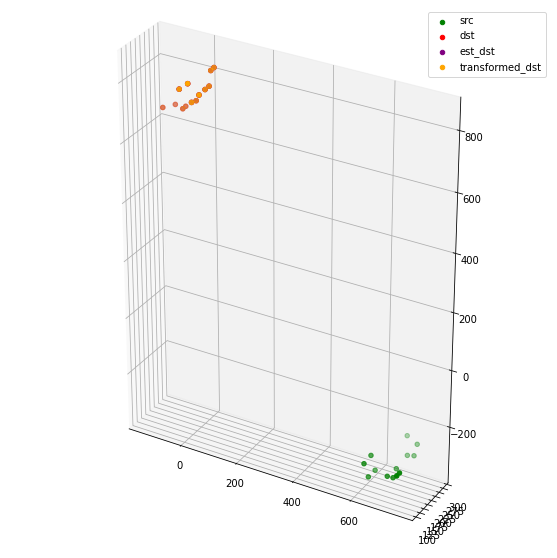

[[  44.8096422    15.91668332   13.43506004  -19.59464846   32.76996686
    31.11783902   -3.91119559  -57.12577772  -59.81893571  -96.59061383
  -116.92685786   33.14751257   20.96573848]
 [ 164.1031988   167.44620488  153.98062458  158.52854025  239.19820086
   219.13622628  223.56138123  231.74402789  252.39036489  252.7101738
   215.25417973  268.12402525  269.36961401]
 [ 779.23681262  746.93922836  812.90371598  785.441431    772.92583401
   770.22132377  723.71204384  681.19820609  679.62337828  676.98221543
   678.29275269  821.24080315  808.3406908 ]]
[[  44.8096422    15.91668332   13.43506004  -19.59464846   32.76996686
    31.11783902   -3.91119559  -57.12577772  -59.81893571  -96.59061383
  -116.92685786   33.14751257   20.96573848]
 [ 164.1031988   167.44620488  153.98062458  158.52854025  239.19820086
   219.13622628  223.56138123  231.74402789  252.39036489  252.7101738
   215.25417973  268.12402525  269.36961401]
 [ 779.23681262  746.93922836  812.90371598  785.441431 

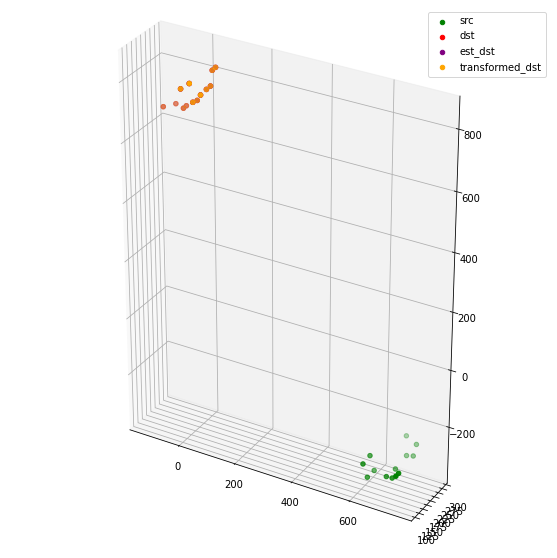

[[  47.37335199   18.39673661   16.08480832  -17.01564968   35.33278696
    33.66943359   -1.48017159  -54.8040357   -57.49702131  -94.27541252
  -114.6159261    35.84265884   23.62745478]
 [ 166.83777815  170.09416433  156.81873583  161.29481063  241.91691928
   221.847611    226.14661965  234.2184934   254.86079771  255.18091596
   217.73321286  270.98138558  272.19251533]
 [ 779.51372876  747.28230896  813.29148953  785.90268322  773.01842824
   770.37592059  723.94584239  681.54791521  679.92079655  677.37485963
   678.84620645  821.24890542  808.37715479]]
[[  47.37335199   18.39673661   16.08480832  -17.01564968   35.33278696
    33.66943359   -1.48017159  -54.8040357   -57.49702131  -94.27541252
  -114.6159261    35.84265884   23.62745478]
 [ 166.83777815  170.09416433  156.81873583  161.29481063  241.91691928
   221.847611    226.14661965  234.2184934   254.86079771  255.18091596
   217.73321286  270.98138558  272.19251533]
 [ 779.51372876  747.28230896  813.29148953  785.90268

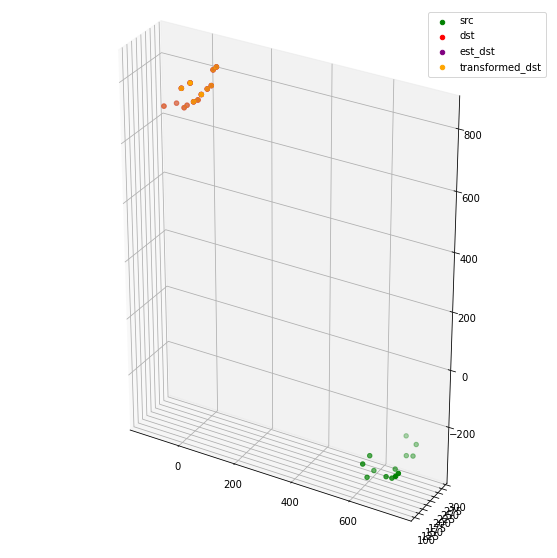

[[ 4.85877473e+01  1.95755921e+01  1.73331159e+01 -1.57966606e+01
   3.65781210e+01  3.49014435e+01 -2.99563328e-01 -5.36682259e+01
  -5.63525224e+01 -9.31336611e+01 -1.13491628e+02  3.71585801e+01
   2.49291378e+01]
 [ 1.66846410e+02  1.70109568e+02  1.56851851e+02  1.61338021e+02
   2.41930080e+02  2.21860966e+02  2.26166353e+02  2.34254923e+02
   2.54898195e+02  2.55236513e+02  2.17799602e+02  2.71006355e+02
   2.72220518e+02]
 [ 7.79443056e+02  7.47244308e+02  8.13259444e+02  7.85907763e+02
   7.72942826e+02  7.70307278e+02  7.23916749e+02  6.81578412e+02
   6.79949225e+02  6.77445687e+02  6.78949922e+02  8.21165388e+02
   8.08307450e+02]]
[[ 4.85877473e+01  1.95755921e+01  1.73331159e+01 -1.57966606e+01
   3.65781210e+01  3.49014435e+01 -2.99563328e-01 -5.36682259e+01
  -5.63525224e+01 -9.31336611e+01 -1.13491628e+02  3.71585801e+01
   2.49291378e+01]
 [ 1.66846410e+02  1.70109568e+02  1.56851851e+02  1.61338021e+02
   2.41930080e+02  2.21860966e+02  2.26166353e+02  2.34254923e+02

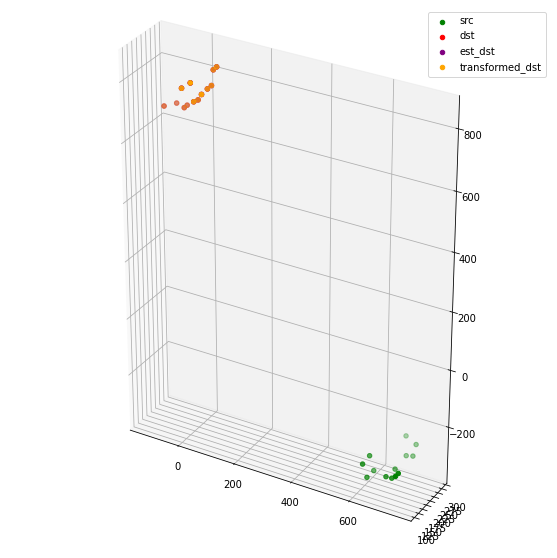

[[ 4.88187296e+01  1.98216038e+01  1.75433869e+01 -1.55723279e+01
   3.68682265e+01  3.51774535e+01 -2.20059413e-03 -5.33482335e+01
  -5.60163367e+01 -9.27962307e+01 -1.13182989e+02  3.74517871e+01
   2.52282798e+01]
 [ 1.65564680e+02  1.68888082e+02  1.55553399e+02  1.60097142e+02
   2.40665077e+02  2.20600387e+02  2.24987597e+02  2.33166857e+02
   2.53814075e+02  2.54183111e+02  2.16759796e+02  2.69683419e+02
   2.70922125e+02]
 [ 7.79551684e+02  7.47345560e+02  8.13343968e+02  7.85984763e+02
   7.73136284e+02  7.70476163e+02  7.24077103e+02  6.81727672e+02
   6.80122048e+02  6.77604601e+02  6.79056287e+02  8.21393692e+02
   8.08532452e+02]]
[[ 4.88187296e+01  1.98216038e+01  1.75433869e+01 -1.55723279e+01
   3.68682265e+01  3.51774535e+01 -2.20059413e-03 -5.33482335e+01
  -5.60163367e+01 -9.27962307e+01 -1.13182989e+02  3.74517871e+01
   2.52282798e+01]
 [ 1.65564680e+02  1.68888082e+02  1.55553399e+02  1.60097142e+02
   2.40665077e+02  2.20600387e+02  2.24987597e+02  2.33166857e+02

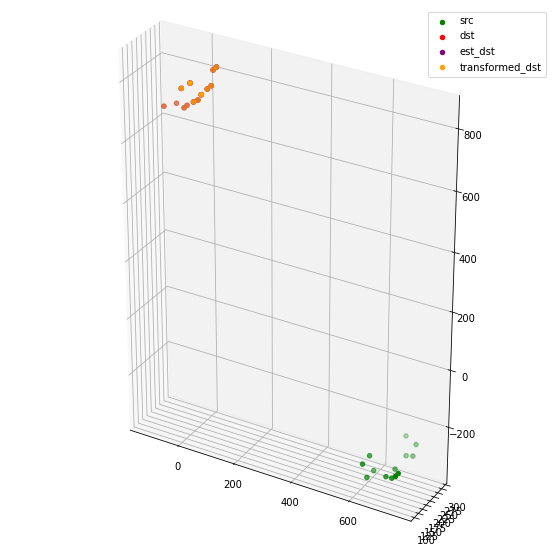

[[ 4.88737152e+01  1.98284483e+01  1.76533724e+01 -1.55043911e+01
   3.68633026e+01  3.51823037e+01 -6.64441030e-02 -5.34783365e+01
  -5.61626858e+01 -9.29463737e+01 -1.13305735e+02  3.74960648e+01
   2.52533933e+01]
 [ 1.64291983e+02  1.67665630e+02  1.54186095e+02  1.58766755e+02
   2.39398003e+02  2.19337994e+02  2.23802071e+02  2.32037054e+02
   2.52685893e+02  2.53035416e+02  2.15595198e+02  2.68311858e+02
   2.69570192e+02]
 [ 7.79453288e+02  7.47295805e+02  8.13268263e+02  7.85966201e+02
   7.73218115e+02  7.70516815e+02  7.24177564e+02  6.81922047e+02
   6.80365093e+02  6.77900855e+02  6.79300267e+02  8.21537580e+02
   8.08696490e+02]]
[[ 4.88737152e+01  1.98284483e+01  1.76533724e+01 -1.55043911e+01
   3.68633026e+01  3.51823037e+01 -6.64441030e-02 -5.34783365e+01
  -5.61626858e+01 -9.29463737e+01 -1.13305735e+02  3.74960648e+01
   2.52533933e+01]
 [ 1.64291983e+02  1.67665630e+02  1.54186095e+02  1.58766755e+02
   2.39398003e+02  2.19337994e+02  2.23802071e+02  2.32037054e+02

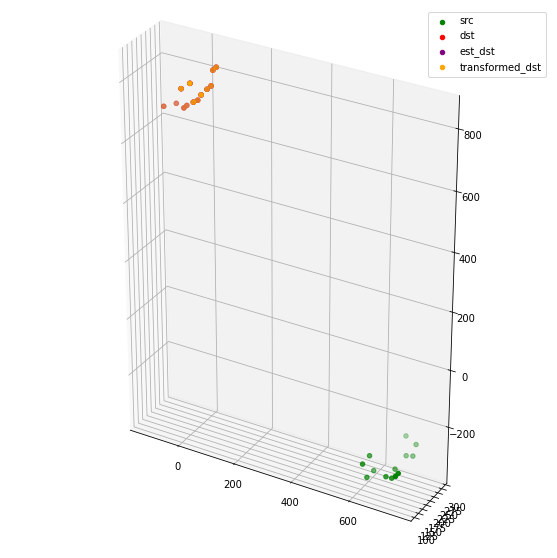

[[ 4.94704671e+01  2.03947796e+01  1.82708972e+01 -1.49097057e+01
   3.75829877e+01  3.58642333e+01  5.70947480e-01 -5.28743074e+01
  -5.55246824e+01 -9.23104702e+01 -1.12732987e+02  3.83203494e+01
   2.60653781e+01]
 [ 1.66240337e+02  1.69578354e+02  1.56278996e+02  1.60844126e+02
   2.41350126e+02  2.21285912e+02  2.25687200e+02  2.33901771e+02
   2.54550996e+02  2.54957685e+02  2.17556685e+02  2.70391891e+02
   2.71637115e+02]
 [ 7.79162342e+02  7.47028641e+02  8.13039323e+02  7.85762420e+02
   7.72739806e+02  7.70094066e+02  7.23782717e+02  6.81565429e+02
   6.79956267e+02  6.77532479e+02  6.79054933e+02  8.20981016e+02
   8.08150384e+02]]
[[ 4.94704671e+01  2.03947796e+01  1.82708972e+01 -1.49097057e+01
   3.75829877e+01  3.58642333e+01  5.70947480e-01 -5.28743074e+01
  -5.55246824e+01 -9.23104702e+01 -1.12732987e+02  3.83203494e+01
   2.60653781e+01]
 [ 1.66240337e+02  1.69578354e+02  1.56278996e+02  1.60844126e+02
   2.41350126e+02  2.21285912e+02  2.25687200e+02  2.33901771e+02

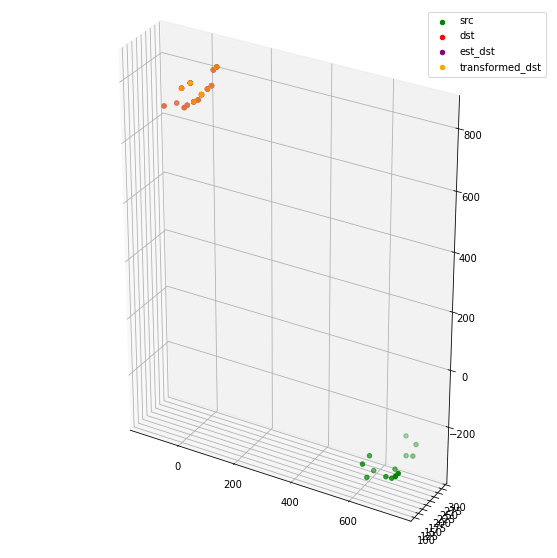

[[ 76.46423675  46.22787027  46.58482056  12.41008323  63.7189145
   62.07625955  25.1091715  -29.88303942 -32.76406008 -69.61522373
  -89.65277615  65.93971499  53.22247695]
 [167.10233134 170.18059991 156.89224386 161.16497939 242.10617898
  222.02701462 226.10984402 233.85415392 254.47954322 254.57423433
  217.0026071  271.17394816 272.31000552]
 [779.19635598 748.1254835  814.17157433 788.10141254 773.19459225
  770.61475322 725.59816419 685.3234046  683.80767043 682.70444705
  684.96301769 821.37461861 808.9915156 ]]
[[ 76.46423675  46.22787027  46.58482056  12.41008323  63.7189145
   62.07625955  25.1091715  -29.88303942 -32.76406008 -69.61522373
  -89.65277615  65.93971499  53.22247695]
 [167.10233134 170.18059991 156.89224386 161.16497939 242.10617898
  222.02701462 226.10984402 233.85415392 254.47954322 254.57423433
  217.0026071  271.17394816 272.31000552]
 [779.19635598 748.1254835  814.17157433 788.10141254 773.19459225
  770.61475322 725.59816419 685.3234046  683.80767043 

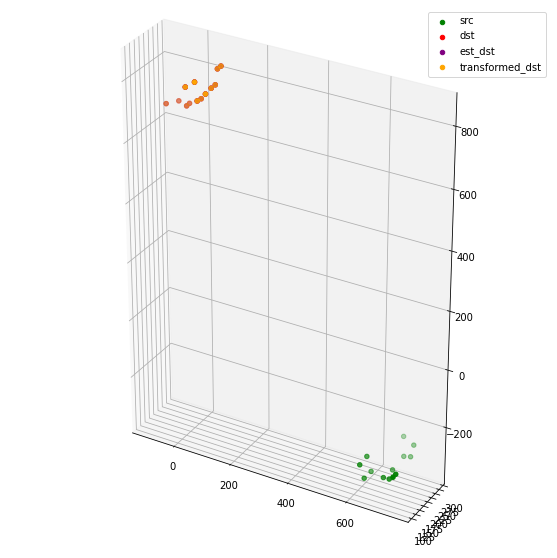

[[111.99769364  80.39119653  83.72754469  48.41161864  98.97201491
   97.22092154  58.26190769   1.5086017   -1.44407923 -38.30755373
  -58.21153089 103.35243867  90.08984836]
 [165.13843149 168.40459711 154.67832451 159.10335255 240.17274436
  220.11015798 224.46936538 232.44759159 253.08084175 253.16056353
  215.56265775 268.92138206 270.13192335]
 [779.51231464 749.85638414 815.72938434 791.25436094 774.59040919
  771.95355014 728.67629361 690.97239429 689.72536704 690.28413549
  693.19291457 822.81394927 811.02419533]]
[[111.99769364  80.39119653  83.72754469  48.41161864  98.97201491
   97.22092154  58.26190769   1.5086017   -1.44407923 -38.30755373
  -58.21153089 103.35243867  90.08984836]
 [165.13843149 168.40459711 154.67832451 159.10335255 240.17274436
  220.11015798 224.46936538 232.44759159 253.08084175 253.16056353
  215.56265775 268.92138206 270.13192335]
 [779.51231464 749.85638414 815.72938434 791.25436094 774.59040919
  771.95355014 728.67629361 690.97239429 689.7253670

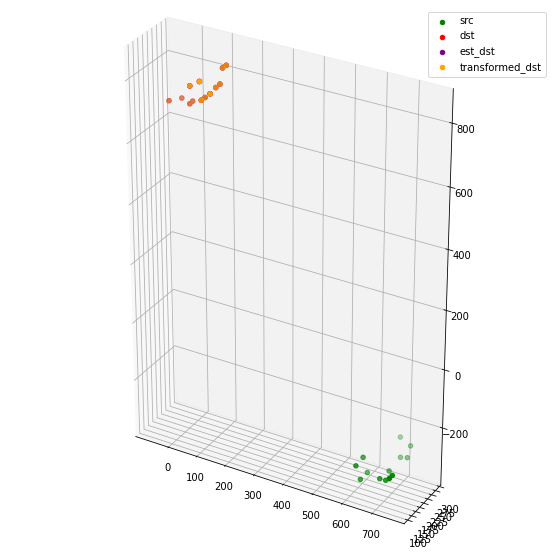

[[ 1.13681104e+02  8.20139006e+01  8.54449296e+01  5.00903072e+01
   1.01126904e+02  9.92388678e+01  6.01884568e+01  3.38310213e+00
   5.60351400e-01 -3.63001391e+01 -5.64384766e+01  1.05827297e+02
   9.25400220e+01]
 [ 1.61751698e+02  1.65669460e+02  1.50925944e+02  1.55947755e+02
   2.36934015e+02  2.16925320e+02  2.22189476e+02  2.31101970e+02
   2.51770268e+02  2.52078143e+02  2.14569034e+02  2.64920272e+02
   2.66394345e+02]
 [ 7.82352901e+02  7.52841003e+02  8.18488933e+02  7.94185551e+02
   7.78604195e+02  7.75669203e+02  7.32575323e+02  6.95160179e+02
   6.94233937e+02  6.94900107e+02  6.97297160e+02  8.27244280e+02
   8.15512466e+02]]
[[ 1.13681104e+02  8.20139006e+01  8.54449296e+01  5.00903072e+01
   1.01126904e+02  9.92388678e+01  6.01884568e+01  3.38310213e+00
   5.60351400e-01 -3.63001391e+01 -5.64384766e+01  1.05827297e+02
   9.25400220e+01]
 [ 1.61751698e+02  1.65669460e+02  1.50925944e+02  1.55947755e+02
   2.36934015e+02  2.16925320e+02  2.22189476e+02  2.31101970e+02

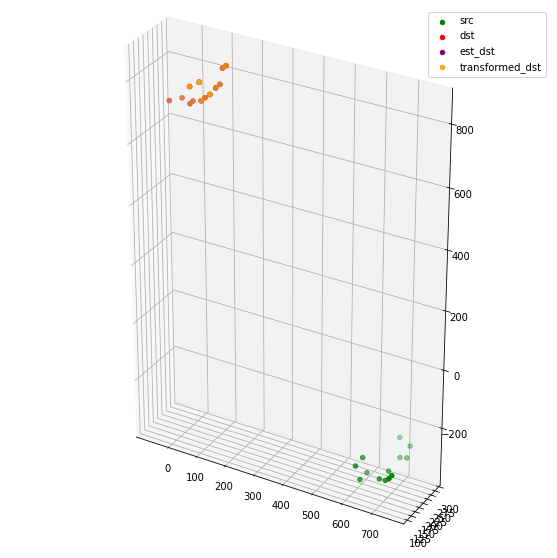

[[119.09302691  87.40973797  90.68765974  55.40119963 109.59841584
  106.87348832  67.77472674  11.12466745   9.14320388 -27.66838664
  -49.30682994 115.77477016 102.47829315]
 [158.75641374 164.32541565 148.64893385 155.40748605 234.42879513
  214.55137804 221.93367656 233.61581111 254.39190252 256.19555747
  219.51290997 261.6003676  263.7594425 ]
 [787.27510834 758.04724268 823.48650521 799.50713946 784.52108878
  781.36042645 738.62265752 701.73807573 701.08062466 702.02294219
  704.11888237 833.45717359 821.84243707]]
[[119.09302691  87.40973797  90.68765974  55.40119963 109.59841584
  106.87348832  67.77472674  11.12466745   9.14320388 -27.66838664
  -49.30682994 115.77477016 102.47829315]
 [158.75641374 164.32541565 148.64893385 155.40748605 234.42879513
  214.55137804 221.93367656 233.61581111 254.39190252 256.19555747
  219.51290997 261.6003676  263.7594425 ]
 [787.27510834 758.04724268 823.48650521 799.50713946 784.52108878
  781.36042645 738.62265752 701.73807573 701.0806246

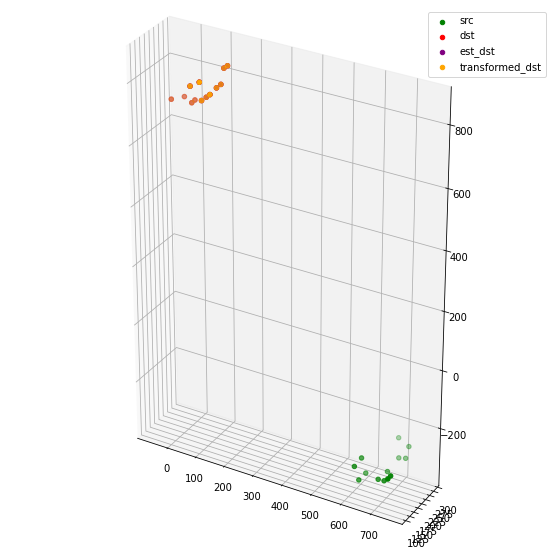

[[102.35166156  71.41146521  72.96249916  38.37750676  95.80384772
   92.37622373  54.32861595  -1.19123351  -2.3658901  -39.09245068
  -62.14941401 102.17154137  89.16891677]
 [164.35378127 171.28845943 155.14823063 163.38151485 240.34794549
  220.60667195 229.70956338 243.75003614 264.58999532 267.79724249
  231.95963961 267.00094491 269.72980171]
 [792.30217646 762.57462695 827.96484978 803.43092208 789.84154511
  786.51585138 743.1655885  705.39542436 704.82912299 705.1572138
  706.66535264 839.03760389 827.21199169]]
[[102.35166156  71.41146521  72.96249916  38.37750676  95.80384772
   92.37622373  54.32861595  -1.19123351  -2.3658901  -39.09245068
  -62.14941401 102.17154137  89.16891677]
 [164.35378127 171.28845943 155.14823063 163.38151485 240.34794549
  220.60667195 229.70956338 243.75003614 264.58999532 267.79724249
  231.95963961 267.00094491 269.72980171]
 [792.30217646 762.57462695 827.96484978 803.43092208 789.84154511
  786.51585138 743.1655885  705.39542436 704.82912299

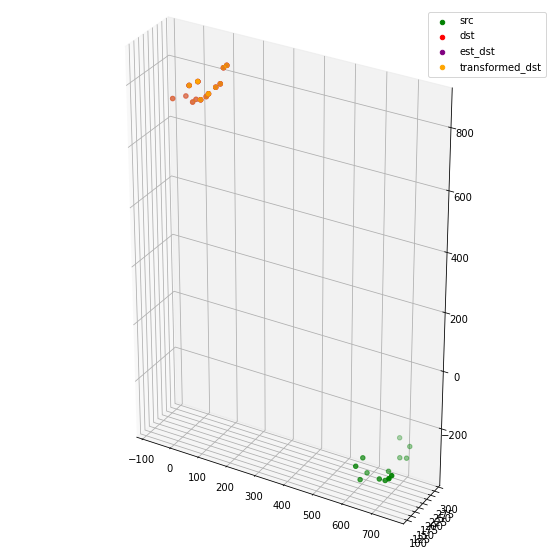

[[ 99.94109148  68.9103242   70.65659394  36.01595487  93.94909309
   90.3581365   52.17063516  -3.42459844  -4.4463338  -41.14590941
  -64.46227291 100.75315192  87.7143035 ]
 [173.01477596 180.23276399 163.96541143 172.49993604 249.05990925
  229.35068166 238.81400163 253.33517138 274.18428402 277.66477625
  241.99751864 275.57733797 278.42407701]
 [797.21296272 767.64769861 833.00148745 808.64968483 794.91617664
  791.57280937 748.42320105 710.94681529 710.42243677 710.93395782
  712.49143932 844.12707845 832.36933553]]
[[ 99.94109148  68.9103242   70.65659394  36.01595487  93.94909309
   90.3581365   52.17063516  -3.42459844  -4.4463338  -41.14590941
  -64.46227291 100.75315192  87.7143035 ]
 [173.01477596 180.23276399 163.96541143 172.49993604 249.05990925
  229.35068166 238.81400163 253.33517138 274.18428402 277.66477625
  241.99751864 275.57733797 278.42407701]
 [797.21296272 767.64769861 833.00148745 808.64968483 794.91617664
  791.57280937 748.42320105 710.94681529 710.4224367

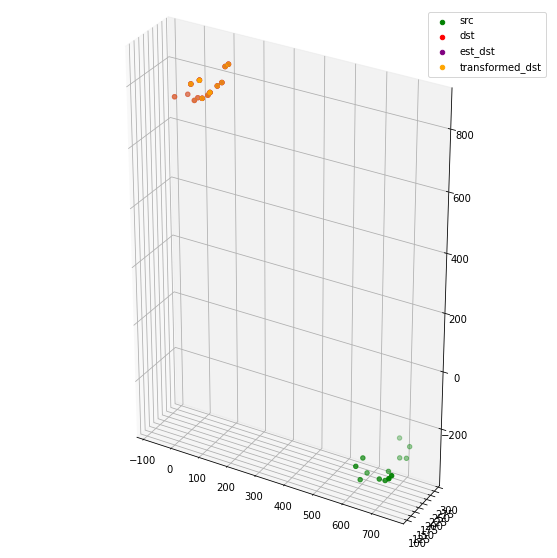

[[ 94.66697364  63.53784483  65.50148812  30.79214703  89.02083417
   85.32265405  46.9864325   -8.70798889  -9.63444088 -46.31465016
  -69.79052379  96.16996686  83.0919047 ]
 [178.91199438 186.29385814 169.97705932 178.68902952 254.98577505
  235.29569114 244.96496728 259.76989384 280.62388766 284.27574445
  248.71700048 281.43985368 284.35503187]
 [805.5020415  776.08099226 841.41628223 817.2256747  803.27885197
  799.93957276 756.96786582 719.7506731  719.24367953 719.92229511
  721.56269315 852.47492626 840.77766008]]
[[ 94.66697364  63.53784483  65.50148812  30.79214703  89.02083417
   85.32265405  46.9864325   -8.70798889  -9.63444088 -46.31465016
  -69.79052379  96.16996686  83.0919047 ]
 [178.91199438 186.29385814 169.97705932 178.68902952 254.98577505
  235.29569114 244.96496728 259.76989384 280.62388766 284.27574445
  248.71700048 281.43985368 284.35503187]
 [805.5020415  776.08099226 841.41628223 817.2256747  803.27885197
  799.93957276 756.96786582 719.7506731  719.2436795

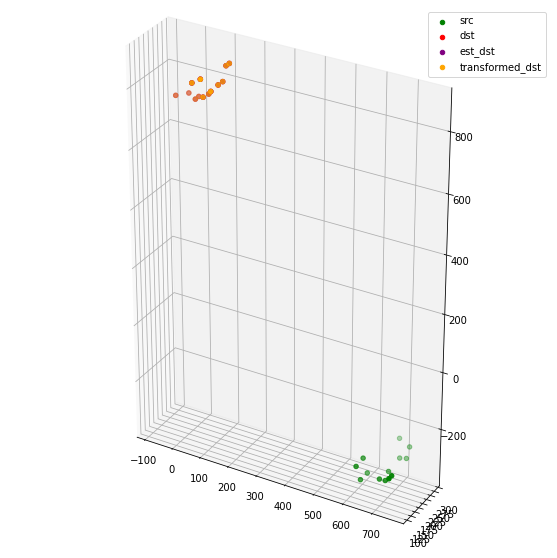

[[ 86.22101397  55.17073784  56.96460766  22.35114196  81.45085602
   77.52519289  39.29085447 -16.23976695 -16.92609995 -53.5616219
  -77.44504894  88.91799295  75.87110065]
 [165.97070315 174.32359164 156.6234698  166.23798869 242.13427604
  222.56214565 233.56792696 249.78742914 270.65674546 274.71556251
  239.40286139 267.47044829 270.77976996]
 [820.63954266 791.39535832 856.37444459 832.38921381 820.00920524
  816.26119151 773.52085312 736.65011008 736.57941686 737.35328123
  738.26260701 869.74352279 858.11652828]]
[[ 86.22101397  55.17073784  56.96460766  22.35114196  81.45085602
   77.52519289  39.29085447 -16.23976695 -16.92609995 -53.5616219
  -77.44504894  88.91799295  75.87110065]
 [165.97070315 174.32359164 156.6234698  166.23798869 242.13427604
  222.56214565 233.56792696 249.78742914 270.65674546 274.71556251
  239.40286139 267.47044829 270.77976996]
 [820.63954266 791.39535832 856.37444459 832.38921381 820.00920524
  816.26119151 773.52085312 736.65011008 736.57941686 

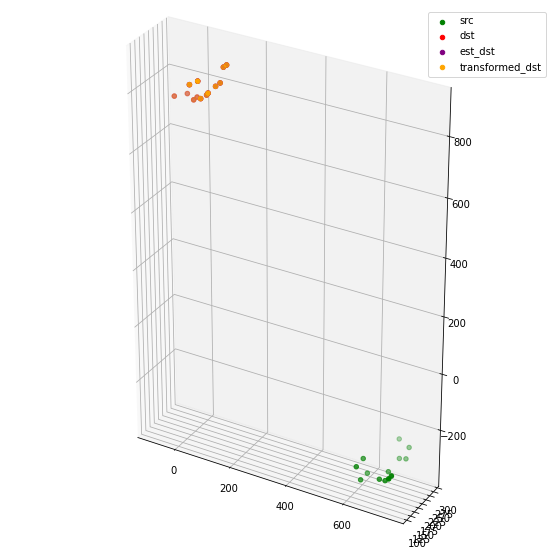

[[ 89.07613207  57.57987371  60.36550364  25.36413662  83.65866145
   79.84921243  40.97231297 -15.16641635 -16.02886735 -52.68405839
  -76.25623674  91.55756701  78.33354138]
 [185.23221414 193.11245614 175.90443419 185.05517253 261.34688397
  241.71589087 252.09031384 267.57750995 288.4393288  292.19932979
  256.69711873 287.10792801 290.22350584]
 [828.98434843 800.0879783  865.16422728 841.56357957 827.86648538
  824.31135747 781.99485457 745.73518433 745.52280102 746.74496831
  748.2205151  877.31502429 865.83554997]]
[[ 89.07613207  57.57987371  60.36550364  25.36413662  83.65866145
   79.84921243  40.97231297 -15.16641635 -16.02886735 -52.68405839
  -76.25623674  91.55756701  78.33354138]
 [185.23221414 193.11245614 175.90443419 185.05517253 261.34688397
  241.71589087 252.09031384 267.57750995 288.4393288  292.19932979
  256.69711873 287.10792801 290.22350584]
 [828.98434843 800.0879783  865.16422728 841.56357957 827.86648538
  824.31135747 781.99485457 745.73518433 745.5228010

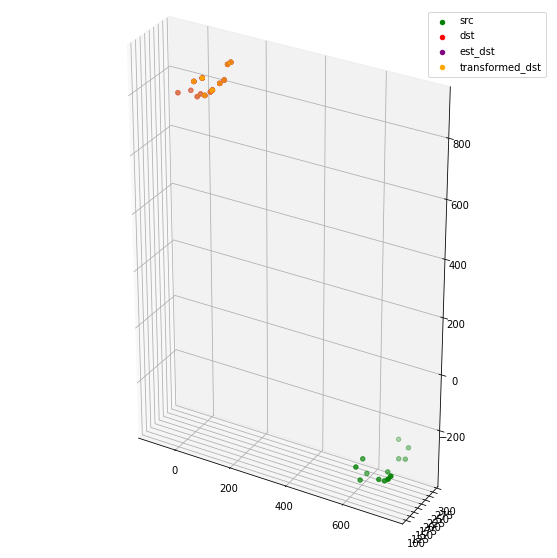

[[ 78.52739733  47.03240564  49.81828968  14.83009473  73.44624372
   69.54558465  30.66529437 -25.44683877 -26.21700654 -62.85369707
  -86.58134606  81.51752576  68.2939445 ]
 [206.87595396 214.70465164 197.91545045 207.06522167 283.00487701
  263.3679056  273.6346863  289.13085025 309.99443261 313.92525337
  278.53866095 309.05724133 312.15550494]
 [834.51046689 805.59870972 870.78425649 847.16371084 832.89475595
  829.4740924  787.13445822 750.83747107 750.48791913 751.72722756
  753.46491906 882.16250219 870.67783106]]
[[ 78.52739733  47.03240564  49.81828968  14.83009473  73.44624372
   69.54558465  30.66529437 -25.44683877 -26.21700654 -62.85369707
  -86.58134606  81.51752576  68.2939445 ]
 [206.87595396 214.70465164 197.91545045 207.06522167 283.00487701
  263.3679056  273.6346863  289.13085025 309.99443261 313.92525337
  278.53866095 309.05724133 312.15550494]
 [834.51046689 805.59870972 870.78425649 847.16371084 832.89475595
  829.4740924  787.13445822 750.83747107 750.4879191

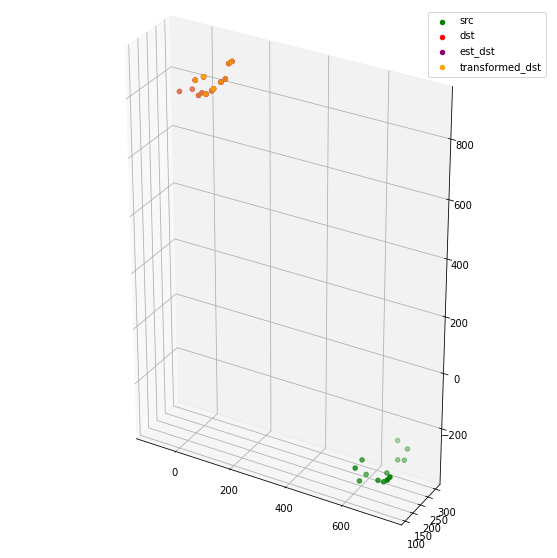

[[ 75.34641047  43.49254383  47.08862906  11.79523314  69.8966985
   66.04833741  26.64747955 -29.94008979 -30.81026054 -67.44841997
  -90.99173161  78.40139369  65.03536169]
 [219.48985218 227.14172003 210.43768465 219.4004175  295.59278615
  275.93432178 285.97543957 301.17338678 322.03280984 325.79660101
  290.30329146 321.736501   324.7612469 ]
 [841.72054947 813.15671202 878.32447481 855.08941723 840.08175481
  836.72592082 794.8155792  759.13584747 758.77296152 760.42022584
  762.46210611 889.22805104 877.88961593]]
[[ 75.34641047  43.49254383  47.08862906  11.79523314  69.8966985
   66.04833741  26.64747955 -29.94008979 -30.81026054 -67.44841997
  -90.99173161  78.40139369  65.03536169]
 [219.48985218 227.14172003 210.43768465 219.4004175  295.59278615
  275.93432178 285.97543957 301.17338678 322.03280984 325.79660101
  290.30329146 321.736501   324.7612469 ]
 [841.72054947 813.15671202 878.32447481 855.08941723 840.08175481
  836.72592082 794.8155792  759.13584747 758.77296152 

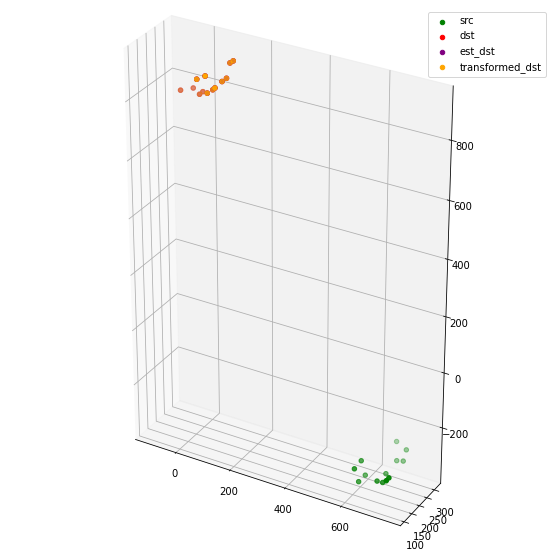

[[  64.62752788   32.62922796   36.55218572    1.12645182   58.75369156
    55.00136594   15.39494934  -41.40367323  -42.38979639  -79.04190949
  -102.38224221   67.29181728   53.86853763]
 [ 230.55622785  237.85358424  221.58019432  230.20309851  306.61636043
   286.91638154  296.47754529  311.14051307  331.99216141  335.56563411
   299.9575401   333.11520793  335.99528049]
 [ 848.58357749  820.08848838  885.34629341  862.18414373  846.48695005
   843.26862594  801.43987634  765.87180485  765.38115563  767.13820664
   769.48859603  895.43685905  884.1284217 ]]
[[  64.62752788   32.62922796   36.55218572    1.12645182   58.75369156
    55.00136594   15.39494934  -41.40367323  -42.38979639  -79.04190949
  -102.38224221   67.29181728   53.86853763]
 [ 230.55622785  237.85358424  221.58019432  230.20309851  306.61636043
   286.91638154  296.47754529  311.14051307  331.99216141  335.56563411
   299.9575401   333.11520793  335.99528049]
 [ 848.58357749  820.08848838  885.34629341  862.18414

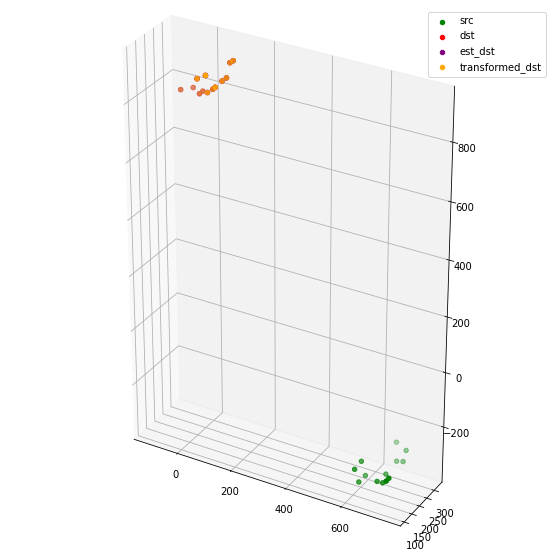

[[ 77.12279305  44.12871545  50.36938249  14.08854574  69.72181999
   66.25285238  25.20204306 -32.93551452 -34.33812173 -70.98096425
  -93.54708003  79.24848028  65.43080502]
 [236.9439188  243.62203541 227.42881814 235.36624183 312.87654712
  293.10777967 301.902223   315.4660289  336.29476434 339.16060156
  303.10895671 339.53626649 342.15661636]
 [855.27448656 827.78073612 892.87779998 870.82059104 853.40282373
  850.29013621 809.70421251 775.907446   775.45924189 778.34427201
  781.390769   902.08222601 891.19344156]]
[[ 77.12279305  44.12871545  50.36938249  14.08854574  69.72181999
   66.25285238  25.20204306 -32.93551452 -34.33812173 -70.98096425
  -93.54708003  79.24848028  65.43080502]
 [236.9439188  243.62203541 227.42881814 235.36624183 312.87654712
  293.10777967 301.902223   315.4660289  336.29476434 339.16060156
  303.10895671 339.53626649 342.15661636]
 [855.27448656 827.78073612 892.87779998 870.82059104 853.40282373
  850.29013621 809.70421251 775.907446   775.4592418

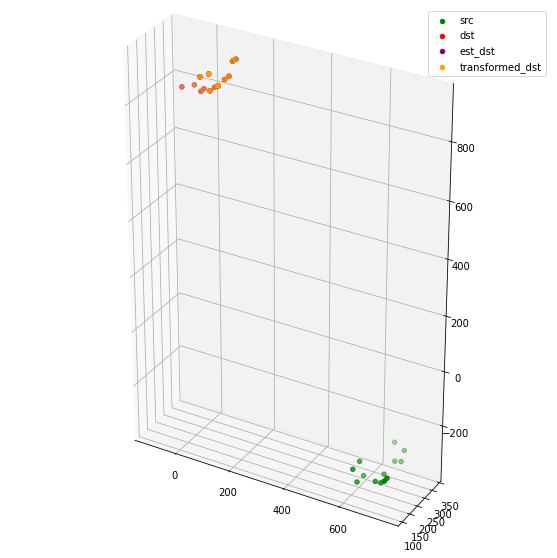

[[ 74.92027851  41.76148452  48.39297504  11.98769125  67.7257941
   64.17900868  22.88177619 -35.44235425 -36.7878989  -73.40210336
  -96.05105103  77.65633187  63.77337087]
 [236.99653135 243.91602389 227.35590584 235.51485475 312.95887125
  293.2170515  302.3460423  316.2564999  337.0912492  340.04584759
  304.04274735 339.32967431 342.04775683]
 [864.31403934 837.0793608  902.04535004 880.2758957  862.89845495
  859.70352268 819.44276639 786.11156723 785.78423688 788.93141184
  791.93703378 911.65445218 900.87319849]]
[[ 74.92027851  41.76148452  48.39297504  11.98769125  67.7257941
   64.17900868  22.88177619 -35.44235425 -36.7878989  -73.40210336
  -96.05105103  77.65633187  63.77337087]
 [236.99653135 243.91602389 227.35590584 235.51485475 312.95887125
  293.2170515  302.3460423  316.2564999  337.0912492  340.04584759
  304.04274735 339.32967431 342.04775683]
 [864.31403934 837.0793608  902.04535004 880.2758957  862.89845495
  859.70352268 819.44276639 786.11156723 785.78423688 

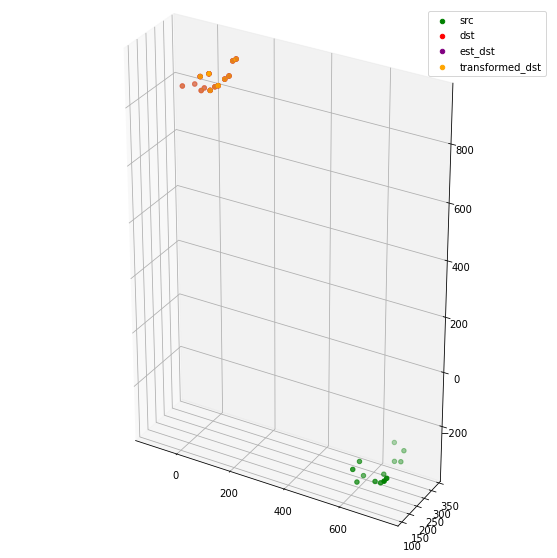

[[ 72.53909855  39.16727141  46.30922617   9.7352484   65.3703307
   61.78858903  20.17565201 -38.40599614 -39.74402091 -76.33049571
  -98.97215788  75.70259606  61.73531669]
 [225.96319584 233.35097736 215.69917239 224.23553272 301.94111154
  282.25701066 292.07572085 306.56473711 327.40251482 330.31662769
  294.27603497 327.48540499 330.38913452]
 [874.58918697 847.74045237 912.36397903 891.02628985 874.50757666
  871.00985952 831.23945866 798.61381282 798.64733445 802.13619366
  804.71740105 923.61883265 912.99605186]]
[[ 72.53909855  39.16727141  46.30922617   9.7352484   65.3703307
   61.78858903  20.17565201 -38.40599614 -39.74402091 -76.33049571
  -98.97215788  75.70259606  61.73531669]
 [225.96319584 233.35097736 215.69917239 224.23553272 301.94111154
  282.25701066 292.07572085 306.56473711 327.40251482 330.31662769
  294.27603497 327.48540499 330.38913452]
 [874.58918697 847.74045237 912.36397903 891.02628985 874.50757666
  871.00985952 831.23945866 798.61381282 798.64733445 

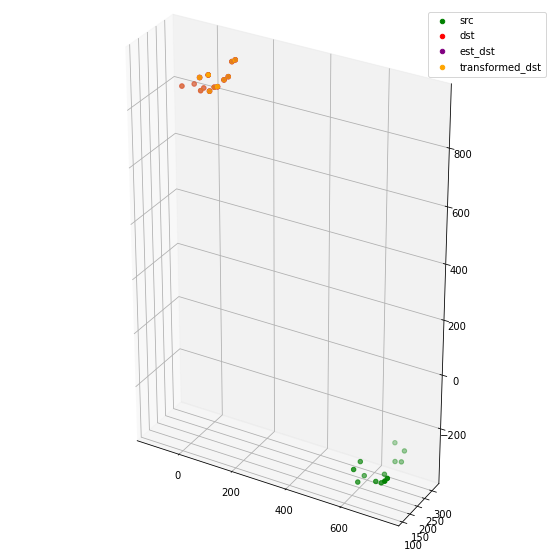

[[  57.12586161   23.68240036   30.99958867   -5.65932211   49.14269626
    45.77300282    4.06556717  -54.66120075  -56.22263094  -92.83899095
  -115.09337794   59.19003355   45.19466251]
 [ 225.73583581  232.99973096  214.86142109  223.19128752  301.63032996
   281.94027599  291.65943161  305.80406238  326.62520678  329.1162602
   292.81378748  326.85376117  329.70028881]
 [ 880.29576719  853.50242029  917.97143924  896.69798483  880.87576461
   877.20511526  837.50931942  804.99363077  805.2087951   808.71181701
   810.97114336  930.21146803  919.6102002 ]]
[[  57.12586161   23.68240036   30.99958867   -5.65932211   49.14269626
    45.77300282    4.06556717  -54.66120075  -56.22263094  -92.83899095
  -115.09337794   59.19003355   45.19466251]
 [ 225.73583581  232.99973096  214.86142109  223.19128752  301.63032996
   281.94027599  291.65943161  305.80406238  326.62520678  329.1162602
   292.81378748  326.85376117  329.70028881]
 [ 880.29576719  853.50242029  917.97143924  896.6979848

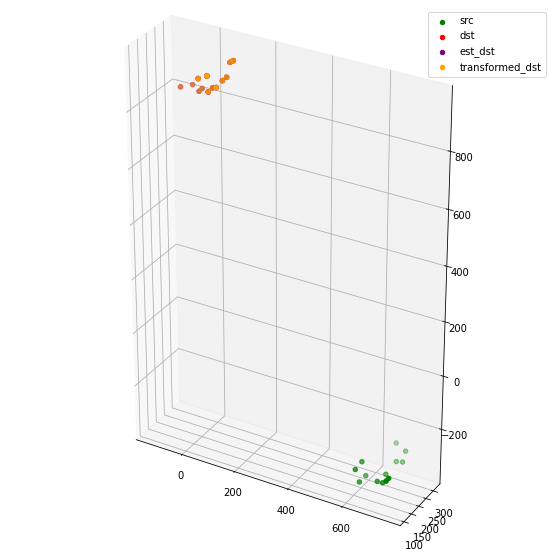

[[  59.83461114   25.99725268   34.2711929    -2.70472517   51.70327367
    48.32235737    6.03268734  -53.18126199  -54.78260783  -91.35033807
  -113.49494208   62.40127841   48.2501913 ]
 [ 234.07368404  241.24637538  223.17677321  231.41339515  309.9520222
   290.25202206  299.85221434  313.8487674   334.66682163  337.08532607
   300.73896178  335.23710169  338.04597096]
 [ 883.80316997  857.48400617  921.85655719  901.10175489  884.43619246
   880.82979181  841.72546342  810.03984262  810.26057619  814.28379274
   816.88958194  933.60325003  923.20051015]]
[[  59.83461114   25.99725268   34.2711929    -2.70472517   51.70327367
    48.32235737    6.03268734  -53.18126199  -54.78260783  -91.35033807
  -113.49494208   62.40127841   48.2501913 ]
 [ 234.07368404  241.24637538  223.17677321  231.41339515  309.9520222
   290.25202206  299.85221434  313.8487674   334.66682163  337.08532607
   300.73896178  335.23710169  338.04597096]
 [ 883.80316997  857.48400617  921.85655719  901.1017548

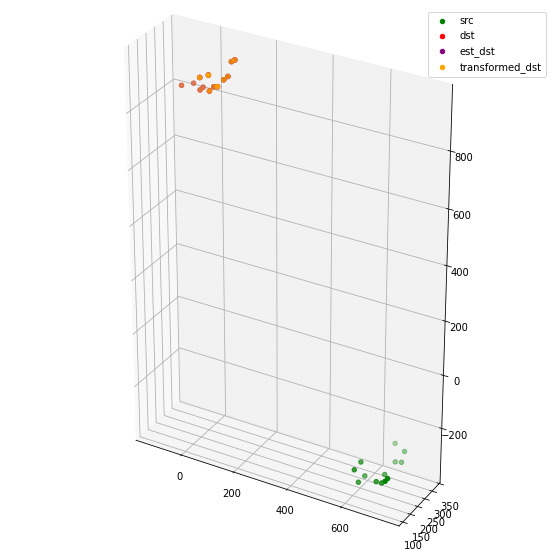

[[  56.94607938   22.83035436   31.79452875   -5.42115783   48.204272
    44.95313786    2.25791412  -57.3334426   -59.10192312  -95.65278642
  -117.47859675   59.11166053   44.85081397]
 [ 240.16913066  247.12803025  228.97476921  236.95889078  315.97703357
   296.25870716  305.60631644  319.19482557  339.99857114  342.10972181
   305.57819042  341.23246641  343.95050925]
 [ 890.07317014  864.05771829  928.31420921  907.89194803  890.95873709
   887.33320862  848.61023802  817.45905052  817.74376226  822.08101541
   824.78527848  940.09501785  929.81880705]]
[[  56.94607938   22.83035436   31.79452875   -5.42115783   48.204272
    44.95313786    2.25791412  -57.3334426   -59.10192312  -95.65278642
  -117.47859675   59.11166053   44.85081397]
 [ 240.16913066  247.12803025  228.97476921  236.95889078  315.97703357
   296.25870716  305.60631644  319.19482557  339.99857114  342.10972181
   305.57819042  341.23246641  343.95050925]
 [ 890.07317014  864.05771829  928.31420921  907.89194803 

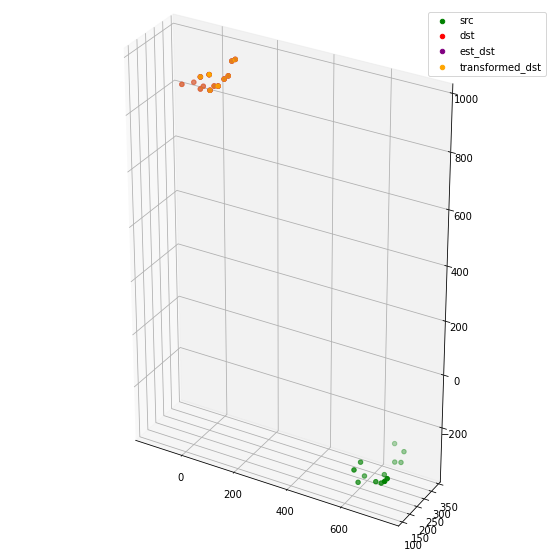

[[  44.42654839   10.30147466   19.28664892  -17.93019209   35.87051803
    32.5676308   -10.14400013  -69.73367009  -71.45112819 -107.99230886
  -129.90437193   46.88938084   32.62476926]
 [ 239.19442932  246.46735226  227.7214338   235.97730618  315.0124659
   295.33513     305.1305541   319.14038031  339.94500432  342.10626923
   305.60525275  339.8031908   342.64718239]
 [ 897.91765537  872.00054429  936.08370213  915.77189292  899.48648948
   895.68910699  857.09513556  826.12789701  826.59945977  830.99324852
   833.39514541  948.83410058  938.59727597]]
[[  44.42654839   10.30147466   19.28664892  -17.93019209   35.87051803
    32.5676308   -10.14400013  -69.73367009  -71.45112819 -107.99230886
  -129.90437193   46.88938084   32.62476926]
 [ 239.19442932  246.46735226  227.7214338   235.97730618  315.0124659
   295.33513     305.1305541   319.14038031  339.94500432  342.10626923
   305.60525275  339.8031908   342.64718239]
 [ 897.91765537  872.00054429  936.08370213  915.7718929

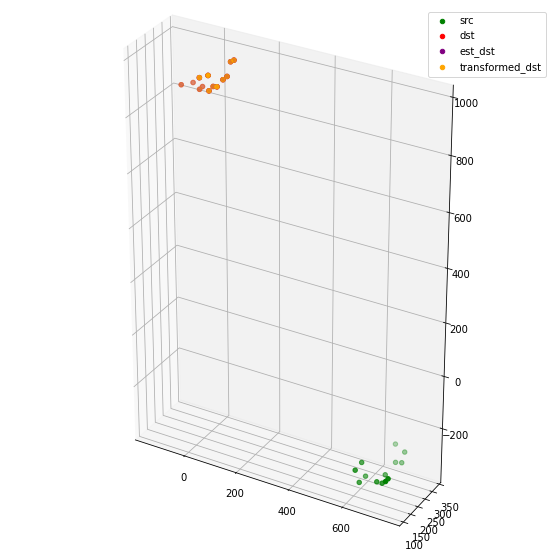

[[  27.57149206   -6.78260281    2.79543077  -34.64515632   17.65747779
    14.69439255  -28.34101889  -88.29695783  -90.38699229 -126.94328078
  -148.18449068   28.42558915   14.07116868]
 [ 235.74933647  242.70009196  223.38950502  231.20319756  311.37766965
   291.68850903  301.15078011  314.434688    335.19817087  336.6489528
   299.73317328  335.79865149  338.50120938]
 [ 905.69371873  879.99165897  943.82077802  923.74664231  908.16537986
   904.15491777  865.83850916  835.26078791  835.97769028  840.53480934
   842.60073419  957.75212732  947.60290057]]
[[  27.57149206   -6.78260281    2.79543077  -34.64515632   17.65747779
    14.69439255  -28.34101889  -88.29695783  -90.38699229 -126.94328078
  -148.18449068   28.42558915   14.07116868]
 [ 235.74933647  242.70009196  223.38950502  231.20319756  311.37766965
   291.68850903  301.15078011  314.434688    335.19817087  336.6489528
   299.73317328  335.79865149  338.50120938]
 [ 905.69371873  879.99165897  943.82077802  923.7466423

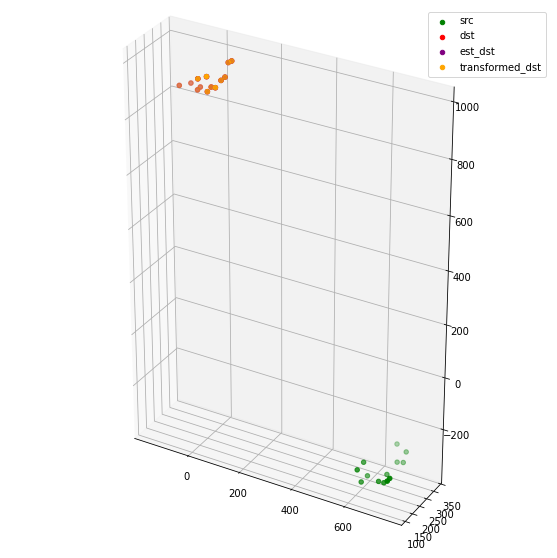

[[  33.52948362   -1.19287572    9.28971839  -28.3912806    25.04383585
    21.64445406  -21.95928184  -82.25523112  -83.95258437 -120.37939512
  -142.24386095   37.23075394   22.73043032]
 [ 239.60326482  247.17795916  227.69650029  236.19017808  315.39950045
   295.76750864  306.01124115  320.38392967  341.18201164  343.29782997
   306.77472388  339.62065891  342.58395726]
 [ 909.57798619  884.55610618  948.19086017  928.85638242  912.21730709
   908.27321948  870.80979009  841.41594406  842.1664055   847.44325132
   849.94118576  961.57312347  951.70805947]]
[[  33.52948362   -1.19287572    9.28971839  -28.3912806    25.04383585
    21.64445406  -21.95928184  -82.25523112  -83.95258437 -120.37939512
  -142.24386095   37.23075394   22.73043032]
 [ 239.60326482  247.17795916  227.69650029  236.19017808  315.39950045
   295.76750864  306.01124115  320.38392967  341.18201164  343.29782997
   306.77472388  339.62065891  342.58395726]
 [ 909.57798619  884.55610618  948.19086017  928.85638

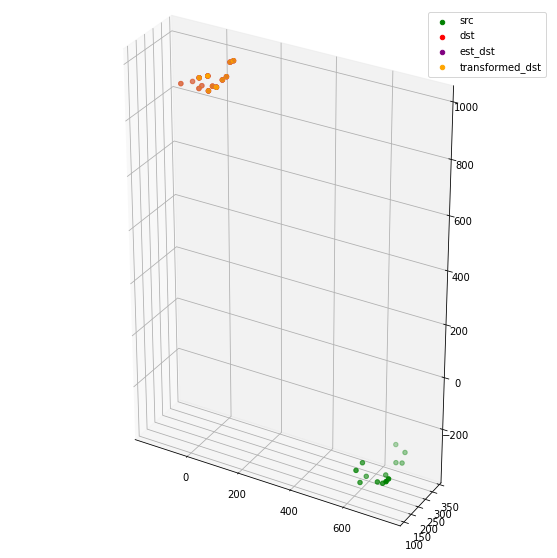

[[  27.48105415   -7.5889245     3.78937408  -34.18821333   18.18451611
    14.96093427  -29.15209896  -89.91477073  -91.83442197 -128.22388881
  -149.65419601   30.62971478   15.99269173]
 [ 252.943226    259.94104216  241.07054118  248.99884791  328.65972074
   308.9615001   318.43384562  331.91376177  352.69710959  354.45294087
   317.71199009  353.39580756  356.12274974]
 [ 913.20026959  888.49723581  952.16223756  933.17100054  915.35163468
   911.59459467  874.52650392  845.67579443  846.28555387  851.93870255
   854.95139073  964.38657262  954.6561383 ]]
[[  27.48105415   -7.5889245     3.78937408  -34.18821333   18.18451611
    14.96093427  -29.15209896  -89.91477073  -91.83442197 -128.22388881
  -149.65419601   30.62971478   15.99269173]
 [ 252.943226    259.94104216  241.07054118  248.99884791  328.65972074
   308.9615001   318.43384562  331.91376177  352.69710959  354.45294087
   317.71199009  353.39580756  356.12274974]
 [ 913.20026959  888.49723581  952.16223756  933.17100

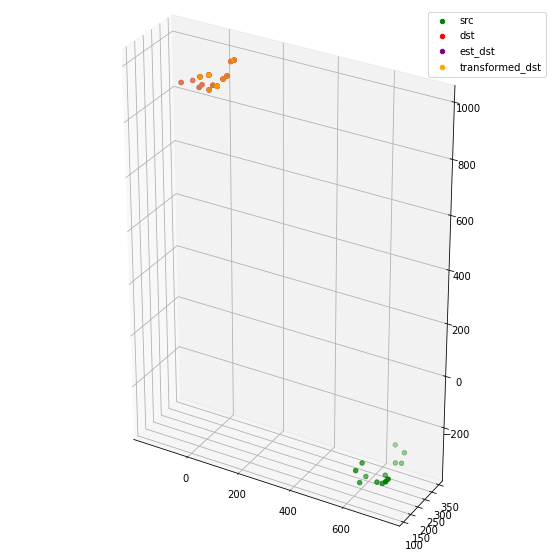

[[  15.44875148  -19.66301458   -8.17810844  -46.18357022    6.28198955
     3.01774467  -41.15972275 -101.9623572  -103.84634703 -140.22054018
  -161.70494232   18.87415866    4.22063006]
 [ 251.51136698  258.73617087  239.41003295  247.53081505  327.22640864
   307.55977365  317.35881724  331.136122    351.91790391  353.69441831
   316.96876573  351.60455585  354.42225588]
 [ 920.93290364  896.35488898  959.86387463  941.01022646  923.62446649
   919.73925095  882.83317423  854.20802137  854.96468305  860.70893229
   863.51583945  972.80093765  963.12133662]]
[[  15.44875148  -19.66301458   -8.17810844  -46.18357022    6.28198955
     3.01774467  -41.15972275 -101.9623572  -103.84634703 -140.22054018
  -161.70494232   18.87415866    4.22063006]
 [ 251.51136698  258.73617087  239.41003295  247.53081505  327.22640864
   307.55977365  317.35881724  331.136122    351.91790391  353.69441831
   316.96876573  351.60455585  354.42225588]
 [ 920.93290364  896.35488898  959.86387463  941.01022

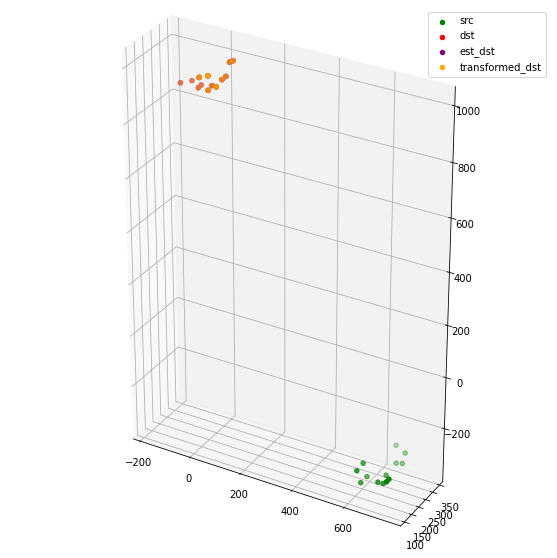

[[  -3.87771594  -39.08074456  -27.33992534  -65.45449124  -14.23336987
   -17.18580507  -61.48489537 -122.47551416 -124.6859144  -161.08764954
  -181.99515296   -2.06084257  -16.74977745]
 [ 247.26847988  254.18917303  234.40616875  242.119584    322.79945611
   303.12421932  312.60082544  325.71076828  346.45176119  347.59957998
   310.51506282  346.8750171   349.56000843]
 [ 929.48240343  904.9474591   968.26870229  949.46430471  932.92821663
   928.84227616  891.99783403  863.45930434  864.42354388  870.15333633
   872.5713332   982.35876429  972.69511987]]
[[  -3.87771594  -39.08074456  -27.33992534  -65.45449124  -14.23336987
   -17.18580507  -61.48489537 -122.47551416 -124.6859144  -161.08764954
  -181.99515296   -2.06084257  -16.74977745]
 [ 247.26847988  254.18917303  234.40616875  242.119584    322.79945611
   303.12421932  312.60082544  325.71076828  346.45176119  347.59957998
   310.51506282  346.8750171   349.56000843]
 [ 929.48240343  904.9474591   968.26870229  949.46430

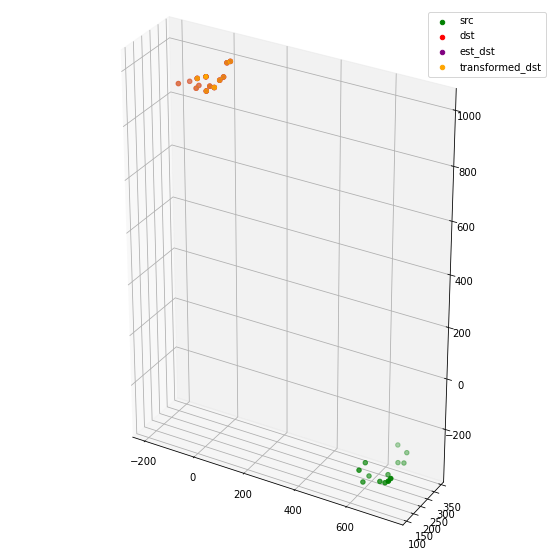

[[  -2.15009691  -37.55814776  -25.30238741  -63.52853942  -11.11563475
   -14.47251477  -59.09790348 -120.23217292 -122.06075604 -158.35433807
  -179.88142945    2.15933849  -12.61086725]
 [ 245.79966229  253.45368176  233.17733771  241.64927465  321.4854317
   301.88433395  312.31087111  326.62738174  347.39960065  349.16476295
   312.44509901  345.11610814  348.10450401]
 [ 935.98278503  911.96615262  975.03326088  956.79018374  939.89750189
   935.76772591  899.57946281  871.94230517  873.0265648   879.26310518
   881.80916841  989.25890702  979.81059911]]
[[  -2.15009691  -37.55814776  -25.30238741  -63.52853942  -11.11563475
   -14.47251477  -59.09790348 -120.23217292 -122.06075604 -158.35433807
  -179.88142945    2.15933849  -12.61086725]
 [ 245.79966229  253.45368176  233.17733771  241.64927465  321.4854317
   301.88433395  312.31087111  326.62738174  347.39960065  349.16476295
   312.44509901  345.11610814  348.10450401]
 [ 935.98278503  911.96615262  975.03326088  956.7901837

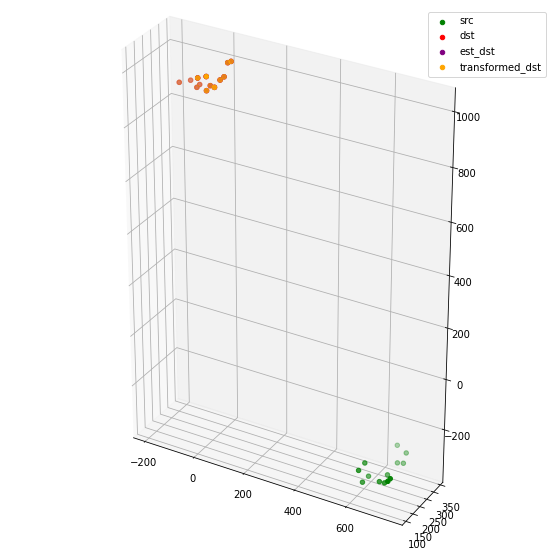

[[  -7.84660441  -43.37707445  -30.79774588  -69.10228969  -16.38145468
   -19.87101054  -64.68708904 -125.93209417 -127.64242993 -163.88250023
  -185.58710914   -2.64276847  -17.46122436]
 [ 255.45895448  263.22868171  243.08059301  251.7010182   331.20328266
   311.60785745  322.16204849  336.72073857  357.50567624  359.48420608
   322.88827997  354.91387827  357.95229341]
 [ 939.08341918  915.28573548  978.33023522  960.32266822  942.82436118
   938.77849452  902.8639217   875.60098443  876.63323037  883.11220052
   885.91932809  992.02027825  982.66392169]]
[[  -7.84660441  -43.37707445  -30.79774588  -69.10228969  -16.38145468
   -19.87101054  -64.68708904 -125.93209417 -127.64242993 -163.88250023
  -185.58710914   -2.64276847  -17.46122436]
 [ 255.45895448  263.22868171  243.08059301  251.7010182   331.20328266
   311.60785745  322.16204849  336.72073857  357.50567624  359.48420608
   322.88827997  354.91387827  357.95229341]
 [ 939.08341918  915.28573548  978.33023522  960.32266

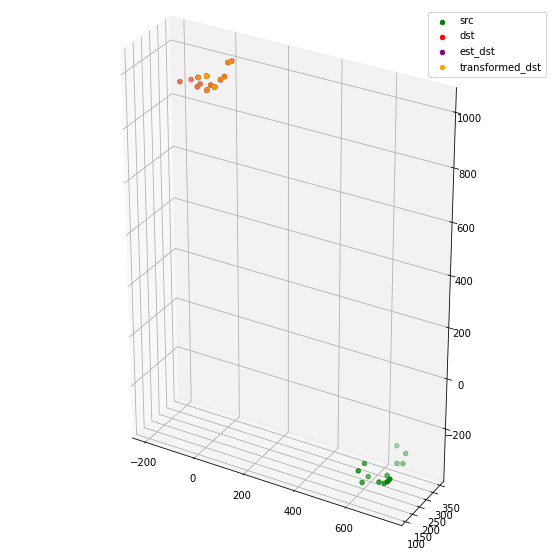

[[ -47.74020499  -83.09737948  -70.93391439 -109.19108471  -58.87138954
   -61.63238924 -106.15391979 -167.37541623 -169.79875557 -206.19063724
  -226.70171791  -46.781385    -61.5305576 ]
 [ 262.94622258  269.48979428  249.85495931  257.16306793  338.36640362
   318.65985296  327.65953049  340.12146672  360.83864784  361.60892448
   324.3092811   362.58684621  365.11471277]
 [ 940.29839083  915.88190883  979.16948507  960.49322354  943.7530384
   939.68419731  902.98859126  874.65482381  875.61931676  881.47354195
   883.97633938  993.13303487  983.51888862]]
[[ -47.74020499  -83.09737948  -70.93391439 -109.19108471  -58.87138954
   -61.63238924 -106.15391979 -167.37541623 -169.79875557 -206.19063724
  -226.70171791  -46.781385    -61.5305576 ]
 [ 262.94622258  269.48979428  249.85495931  257.16306793  338.36640362
   318.65985296  327.65953049  340.12146672  360.83864784  361.60892448
   324.3092811   362.58684621  365.11471277]
 [ 940.29839083  915.88190883  979.16948507  960.493223

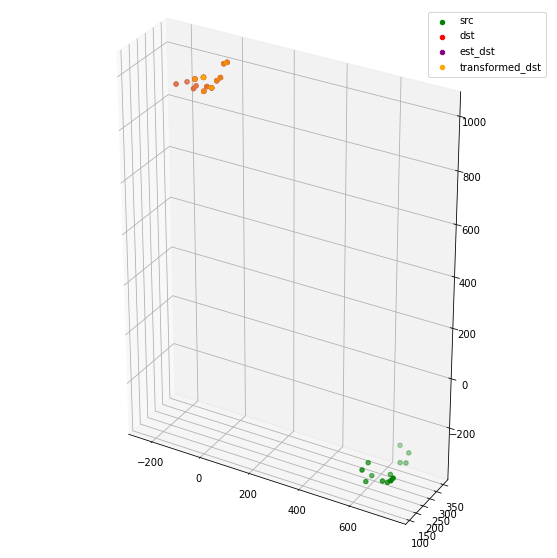

[[ -43.32389073  -78.75861921  -66.43268314 -104.68022131  -52.31772767
   -55.67031784 -100.33543965 -161.50273508 -163.33907572 -199.62729736
  -221.13630428  -39.00459815  -53.78528892]
 [ 267.34650426  274.96569043  254.74661763  263.18729382  343.03167482
   323.42575364  333.80350198  348.07128795  368.84361841  370.59855275
   333.87188648  366.70871955  369.6830557 ]
 [ 944.40596734  920.4176216   983.48944042  965.27672273  948.26698048
   944.15666173  908.00340995  880.41417089  881.48307403  887.75360084
   890.35098934  997.59587906  988.15953896]]
[[ -43.32389073  -78.75861921  -66.43268314 -104.68022131  -52.31772767
   -55.67031784 -100.33543965 -161.50273508 -163.33907572 -199.62729736
  -221.13630428  -39.00459815  -53.78528892]
 [ 267.34650426  274.96569043  254.74661763  263.18729382  343.03167482
   323.42575364  333.80350198  348.07128795  368.84361841  370.59855275
   333.87188648  366.70871955  369.6830557 ]
 [ 944.40596734  920.4176216   983.48944042  965.27672

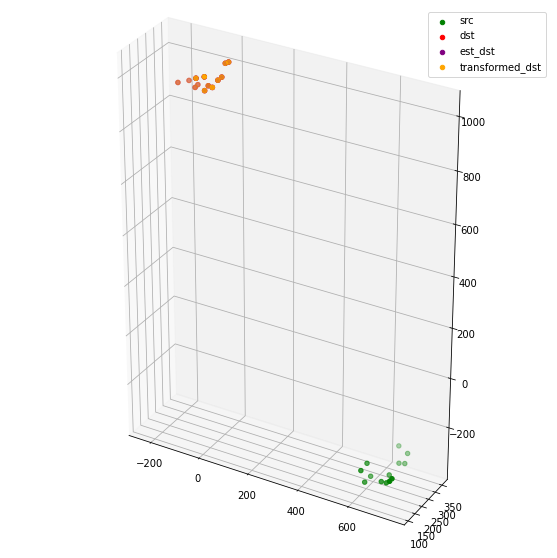

[[ -39.71190358  -75.41436971  -62.37580682 -100.8046814   -48.0665946
   -51.62696148  -96.70522753 -158.13536718 -159.79624151 -195.97983386
  -217.73405548  -33.89147245  -48.77755484]
 [ 273.82890127  281.81064558  261.25872135  270.06162638  349.56569078
   330.00179189  340.85893105  355.70015683  376.48176874  378.49136576
   341.9212697   372.95277639  376.07619277]
 [ 950.25516829  926.78735242  989.60779672  971.95694015  954.51890146
   950.38315797  914.88948473  888.20147582  889.37216658  896.15032965
   898.9096297  1003.74584773  994.52582437]]
[[ -39.71190358  -75.41436971  -62.37580682 -100.8046814   -48.0665946
   -51.62696148  -96.70522753 -158.13536718 -159.79624151 -195.97983386
  -217.73405548  -33.89147245  -48.77755484]
 [ 273.82890127  281.81064558  261.25872135  270.06162638  349.56569078
   330.00179189  340.85893105  355.70015683  376.48176874  378.49136576
   341.9212697   372.95277639  376.07619277]
 [ 950.25516829  926.78735242  989.60779672  971.9569401

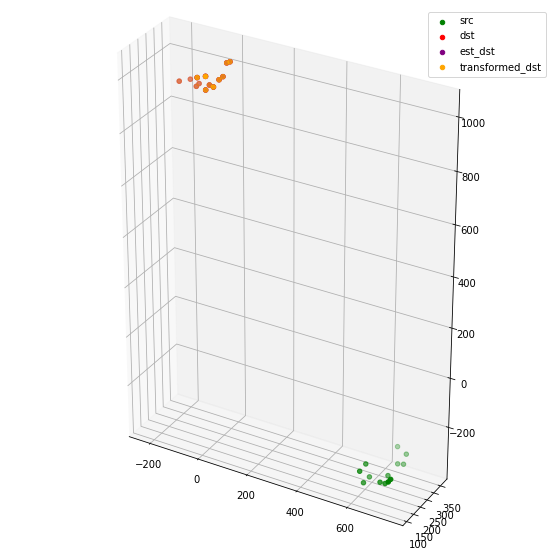

[[ -25.98597706  -62.41449746  -47.40618636  -86.41744977  -35.35087429
   -38.72829387  -84.89073101 -147.22269051 -149.16103105 -185.17756817
  -206.30396122  -20.22194547  -35.39269552]
 [ 276.30085372  283.77886208  263.34346148  271.59440236  351.89899259
   332.28944156  342.51797405  356.47482127  377.2278142   378.6884607
   341.7942486   375.43202973  378.34471443]
 [ 957.52366067  935.0257718   997.44322876  980.83402714  962.13469812
   958.06219624  923.79654432  898.77441212  900.02362558  907.76377392
   911.03859473 1011.00691698 1002.19076018]]
[[ -25.98597706  -62.41449746  -47.40618636  -86.41744977  -35.35087429
   -38.72829387  -84.89073101 -147.22269051 -149.16103105 -185.17756817
  -206.30396122  -20.22194547  -35.39269552]
 [ 276.30085372  283.77886208  263.34346148  271.59440236  351.89899259
   332.28944156  342.51797405  356.47482127  377.2278142   378.6884607
   341.7942486   375.43202973  378.34471443]
 [ 957.52366067  935.0257718   997.44322876  980.8340271

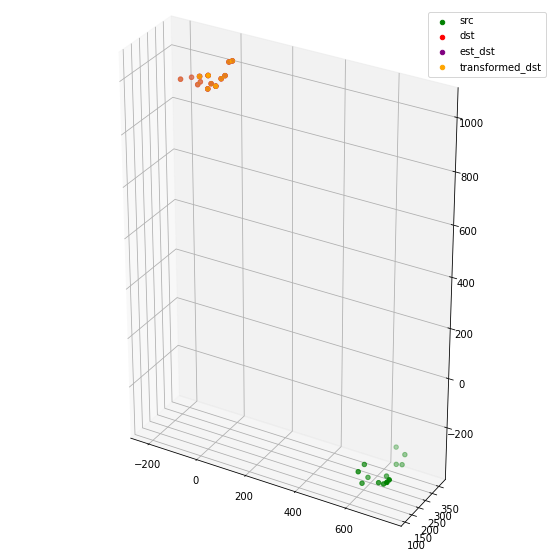

[[ -12.4553653   -49.21898858  -33.24560555  -72.45538015  -20.48523467
   -24.26701334  -70.96208367 -133.56690458 -135.13932632 -170.95757907
  -192.61100835   -3.95581698  -19.25785637]
 [ 262.99980774  271.43115804  249.72738675  258.87525623  338.65134673
   319.16846722  330.70021012  346.06485342  366.82266283  368.73087887
   332.13016399  361.12675194  364.427351  ]
 [ 967.37172146  945.77401217 1007.52019651  991.8762732   973.40557718
   969.08790624  935.97721773  912.50941011  914.13583334  922.65908456
   925.78134206 1022.32200194 1013.87726119]]
[[ -12.4553653   -49.21898858  -33.24560555  -72.45538015  -20.48523467
   -24.26701334  -70.96208367 -133.56690458 -135.13932632 -170.95757907
  -192.61100835   -3.95581698  -19.25785637]
 [ 262.99980774  271.43115804  249.72738675  258.87525623  338.65134673
   319.16846722  330.70021012  346.06485342  366.82266283  368.73087887
   332.13016399  361.12675194  364.427351  ]
 [ 967.37172146  945.77401217 1007.52019651  991.87627

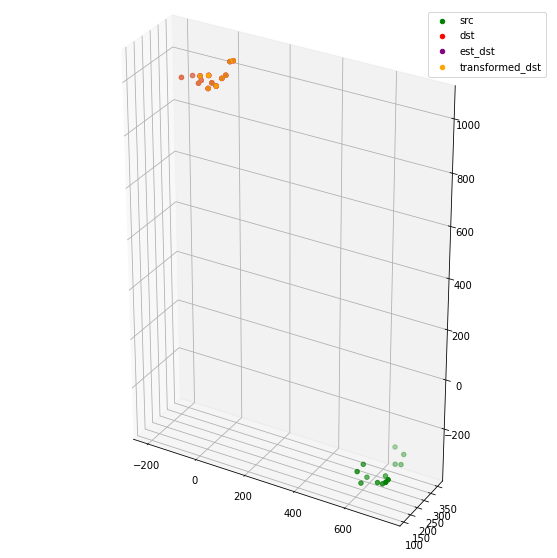

[[ -20.03098895  -56.89679028  -40.6362157   -79.92726255  -28.22169001
   -31.97249066  -78.82091717 -141.55160744 -143.16827665 -178.95841711
  -200.51081989  -11.56119383  -26.90318511]
 [ 269.13203752  277.40573768  255.93713748  264.94037139  344.78274621
   325.27714614  336.59058462  351.72909071  372.48810492  374.33680383
   337.69395276  367.45351137  370.69022647]
 [ 971.02742283  949.54321259 1011.29664855  995.77319232  976.85187628
   972.61043942  939.64137173  916.36348543  917.93004979  926.58351665
   929.90424272 1025.6334955  1017.23665153]]
[[ -20.03098895  -56.89679028  -40.6362157   -79.92726255  -28.22169001
   -31.97249066  -78.82091717 -141.55160744 -143.16827665 -178.95841711
  -200.51081989  -11.56119383  -26.90318511]
 [ 269.13203752  277.40573768  255.93713748  264.94037139  344.78274621
   325.27714614  336.59058462  351.72909071  372.48810492  374.33680383
   337.69395276  367.45351137  370.69022647]
 [ 971.02742283  949.54321259 1011.29664855  995.77319

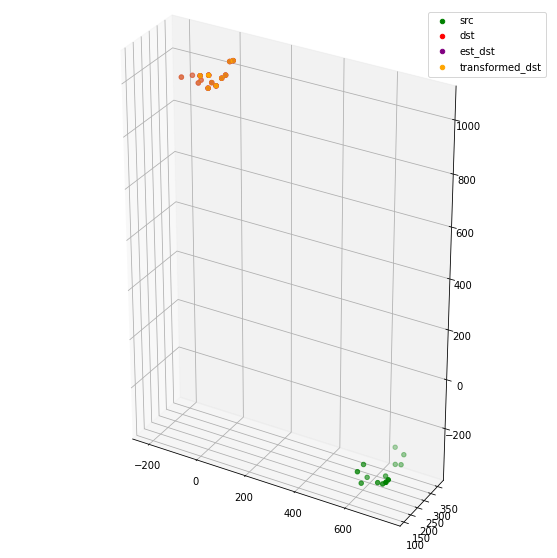

[[ -34.70523511  -71.49402265  -55.45469873  -94.69064983  -42.9330558
   -46.66423537  -93.39425327 -156.04264433 -157.66938778 -193.49129725
  -215.04799249  -26.45568508  -41.76757085]
 [ 257.301777    265.82404925  243.62585165  252.8063697   332.87656576
   313.42211966  325.11872801  340.52232601  361.26098916  363.00076373
   326.3174486   354.96882856  358.30253931]
 [ 977.50560755  955.98657647 1017.53959464 1001.98065808  984.1985769
   979.71197993  946.70859887  923.38303082  925.19023047  933.73413572
   936.54039699 1033.3067257  1024.8928956 ]]
[[ -34.70523511  -71.49402265  -55.45469873  -94.69064983  -42.9330558
   -46.66423537  -93.39425327 -156.04264433 -157.66938778 -193.49129725
  -215.04799249  -26.45568508  -41.76757085]
 [ 257.301777    265.82404925  243.62585165  252.8063697   332.87656576
   313.42211966  325.11872801  340.52232601  361.26098916  363.00076373
   326.3174486   354.96882856  358.30253931]
 [ 977.50560755  955.98657647 1017.53959464 1001.98065808

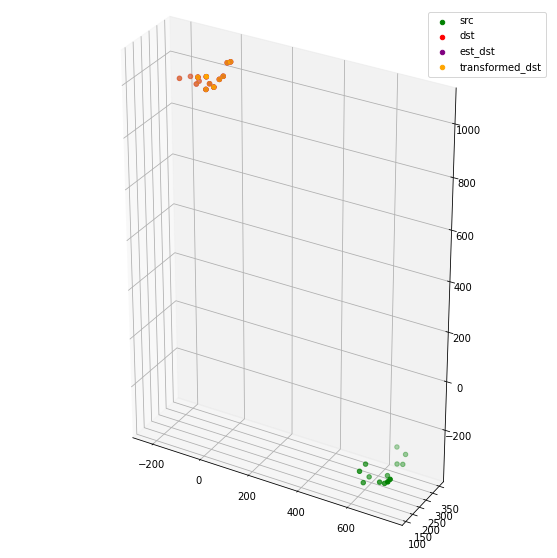

[[ -32.43690372  -69.52114604  -52.63731353  -92.09703015  -40.86145916
   -44.57578489  -91.75465114 -154.74427229 -156.42542019 -192.14480787
  -213.52876485  -23.85833016  -39.28566521]
 [ 211.68243145  221.02756075  196.09183113  205.8100297   286.83372582
   267.5903331   280.59186708  296.78342379  317.40992738  318.6018271
   281.73641387  306.71522978  310.36670374]
 [ 993.48864979  972.8357991  1033.10137404 1018.46205515 1003.75273222
   998.42147091  966.56486916  944.74022762  947.51970698  956.57172606
   957.94995373 1053.62057261 1045.55682154]]
[[ -32.43690372  -69.52114604  -52.63731353  -92.09703015  -40.86145916
   -44.57578489  -91.75465114 -154.74427229 -156.42542019 -192.14480787
  -213.52876485  -23.85833016  -39.28566521]
 [ 211.68243145  221.02756075  196.09183113  205.8100297   286.83372582
   267.5903331   280.59186708  296.78342379  317.40992738  318.6018271
   281.73641387  306.71522978  310.36670374]
 [ 993.48864979  972.8357991  1033.10137404 1018.4620551

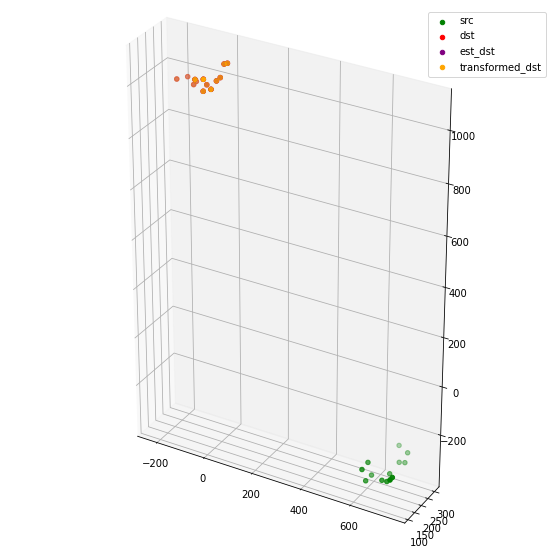

[[ -37.84340472  -75.2617093   -57.42086802  -97.15623797  -47.14840046
   -50.66475845  -98.34172735 -161.7641306  -163.68741355 -199.32262849
  -220.20390634  -29.88706091  -45.44472997]
 [ 228.40424114  237.02784051  213.00610523  222.04059225  303.55186949
   284.20189023  296.22140785  311.33913268  331.97242961  332.8019492
   295.67898279  324.22311946  327.58051247]
 [ 995.41240253  975.05026296 1035.411298   1021.08298002 1004.91464309
   999.84115755  968.34248752  947.00643771  949.57011754  958.98700046
   961.00923225 1054.37096404 1046.43075904]]
[[ -37.84340472  -75.2617093   -57.42086802  -97.15623797  -47.14840046
   -50.66475845  -98.34172735 -161.7641306  -163.68741355 -199.32262849
  -220.20390634  -29.88706091  -45.44472997]
 [ 228.40424114  237.02784051  213.00610523  222.04059225  303.55186949
   284.20189023  296.22140785  311.33913268  331.97242961  332.8019492
   295.67898279  324.22311946  327.58051247]
 [ 995.41240253  975.05026296 1035.411298   1021.0829800

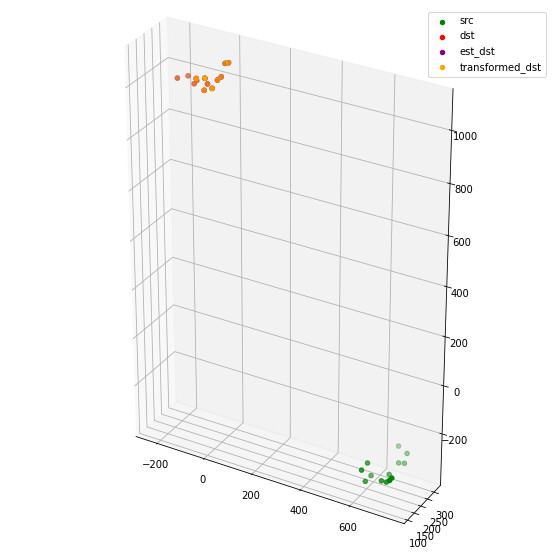

[[ -65.37630044 -102.6891542   -85.16258013 -124.83057948  -74.92009572
   -78.35866548 -125.86956091 -189.19554941 -191.18413419 -226.87853341
  -247.6826333   -58.01323625  -73.52975081]
 [ 252.2731699   260.42163719  237.57387158  246.2397635   327.56117045
   308.11121962  319.42166072  333.97952009  354.65210323  355.56728786
   318.43602425  349.19382017  352.36350475]
 [ 993.36961304  972.62193519 1033.5283613  1018.79152238 1001.41165958
   996.67854466  964.67046571  942.66906187  944.8356838   954.01754812
   956.60415042 1050.57840311 1042.48205299]]
[[ -65.37630044 -102.6891542   -85.16258013 -124.83057948  -74.92009572
   -78.35866548 -125.86956091 -189.19554941 -191.18413419 -226.87853341
  -247.6826333   -58.01323625  -73.52975081]
 [ 252.2731699   260.42163719  237.57387158  246.2397635   327.56117045
   308.11121962  319.42166072  333.97952009  354.65210323  355.56728786
   318.43602425  349.19382017  352.36350475]
 [ 993.36961304  972.62193519 1033.5283613  1018.79152

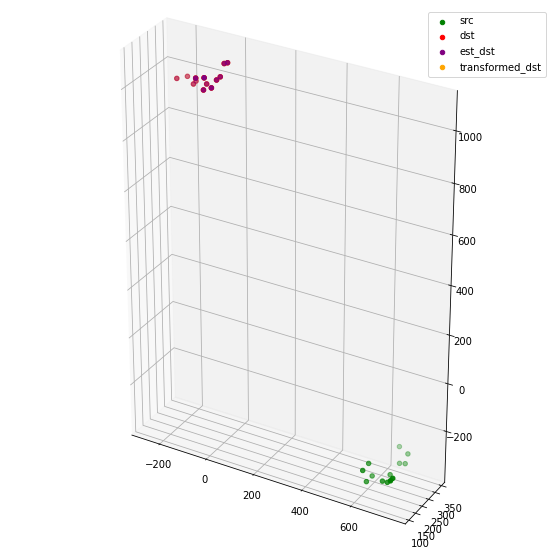

[[ -82.86383187 -120.35293923 -102.31405144 -142.13498247  -93.11558151
   -96.38340922 -144.15432592 -207.7244486  -209.90765735 -245.56573493
  -265.98827976  -76.19264152  -91.77777781]
 [ 249.06303019  256.92014842  234.0137618   242.341791    324.22107499
   304.75625861  315.71714371  329.72974121  350.3730774   350.89841324
   313.55268871  345.83152835  348.87802598]
 [ 999.96949213  979.42818656 1040.16277237 1025.64520857 1008.34872242
  1003.55612901  971.81456482  950.16599736  952.42225186  961.77424932
   964.31360806 1057.51969462 1049.50830344]]
[[ -82.86383187 -120.35293923 -102.31405144 -142.13498247  -93.11558151
   -96.38340922 -144.15432592 -207.7244486  -209.90765735 -245.56573493
  -265.98827976  -76.19264152  -91.77777781]
 [ 249.06303019  256.92014842  234.0137618   242.341791    324.22107499
   304.75625861  315.71714371  329.72974121  350.3730774   350.89841324
   313.55268871  345.83152835  348.87802598]
 [ 999.96949213  979.42818656 1040.16277237 1025.64520

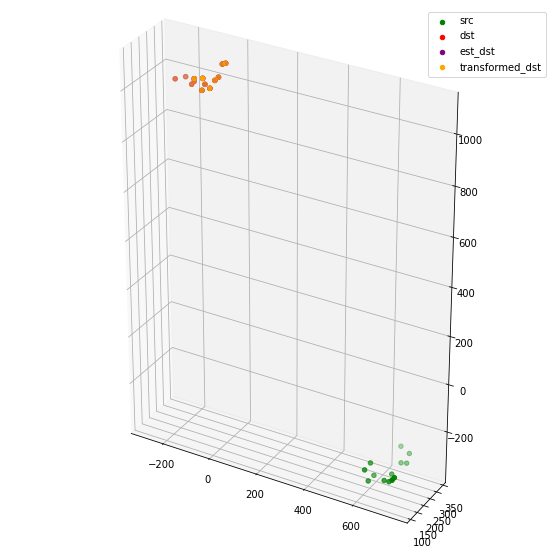

[[-119.94626282 -157.28049724 -139.67339077 -179.44107706 -131.97428546
  -134.73985852 -182.24915708 -245.77340898 -248.44403408 -284.24388396
  -303.87715948 -116.2842823  -131.80827737]
 [ 260.18519919  266.99100339  245.1380392   252.42715975  335.18283078
   315.60047309  325.16211475  337.5322541   358.14505535  357.98032734
   320.22073617  357.68535304  360.30048706]
 [ 998.49684208  977.30843296 1038.55573243 1023.34974263 1005.8943751
  1001.26732431  968.69172085  945.93599778  947.93214413  956.73997833
   959.38186936 1055.07407003 1046.79598687]]
[[-119.94626282 -157.28049724 -139.67339077 -179.44107706 -131.97428546
  -134.73985852 -182.24915708 -245.77340898 -248.44403408 -284.24388396
  -303.87715948 -116.2842823  -131.80827737]
 [ 260.18519919  266.99100339  245.1380392   252.42715975  335.18283078
   315.60047309  325.16211475  337.5322541   358.14505535  357.98032734
   320.22073617  357.68535304  360.30048706]
 [ 998.49684208  977.30843296 1038.55573243 1023.349742

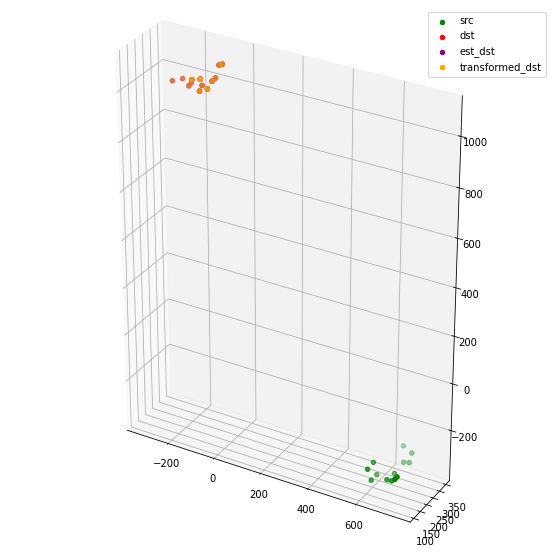

[[-112.87225916 -150.34214192 -132.36035944 -172.17156161 -123.24152144
  -126.47505384 -174.2146318  -237.77246989 -239.98789025 -275.66035615
  -296.03429502 -106.42104421 -121.99865562]
 [ 265.44647825  273.07665712  250.71015918  258.8588741   340.65813391
   321.14889116  331.77349092  345.51271921  366.17129155  366.72531891
   329.37359154  362.70748281  365.66411011]
 [1002.31028637  981.64870443 1042.60105634 1027.95561664 1010.03859928
  1005.40605769  973.50340955  951.64457423  953.72296668  963.01826444
   965.84366675 1059.04961701 1050.99006445]]
[[-112.87225916 -150.34214192 -132.36035944 -172.17156161 -123.24152144
  -126.47505384 -174.2146318  -237.77246989 -239.98789025 -275.66035615
  -296.03429502 -106.42104421 -121.99865562]
 [ 265.44647825  273.07665712  250.71015918  258.8588741   340.65813391
   321.14889116  331.77349092  345.51271921  366.17129155  366.72531891
   329.37359154  362.70748281  365.66411011]
 [1002.31028637  981.64870443 1042.60105634 1027.95561

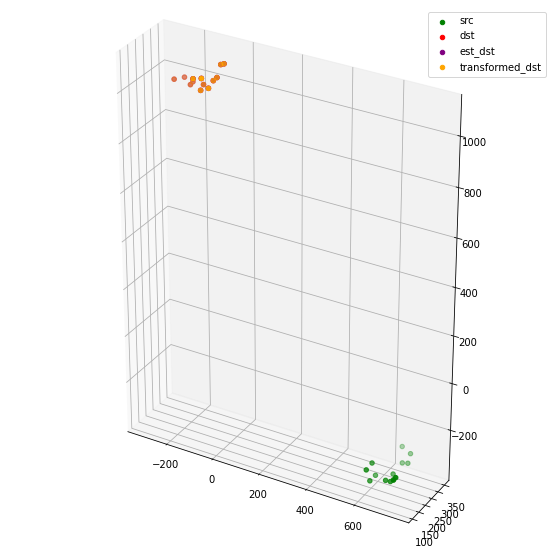

[[-112.49777546 -150.2770488  -131.37349823 -171.42798879 -123.47421389
  -126.58045012 -174.78812645 -238.72327523 -241.10606218 -276.67050313
  -296.66177999 -106.28494368 -121.98294934]
 [ 263.91102668  271.24152799  248.89606769  256.70867474  339.00378294
   319.47651832  329.73277744  342.93169382  363.56361501  363.76247714
   326.21566581  361.09020986  363.92097559]
 [1008.13311648  987.93155793 1048.61211589 1034.45502459 1016.17285059
  1011.5291496   980.21529527  959.13783773  961.29435539  971.00853699
   973.97798633 1065.03900283 1057.17011515]]
[[-112.49777546 -150.2770488  -131.37349823 -171.42798879 -123.47421389
  -126.58045012 -174.78812645 -238.72327523 -241.10606218 -276.67050313
  -296.66177999 -106.28494368 -121.98294934]
 [ 263.91102668  271.24152799  248.89606769  256.70867474  339.00378294
   319.47651832  329.73277744  342.93169382  363.56361501  363.76247714
   326.21566581  361.09020986  363.92097559]
 [1008.13311648  987.93155793 1048.61211589 1034.45502

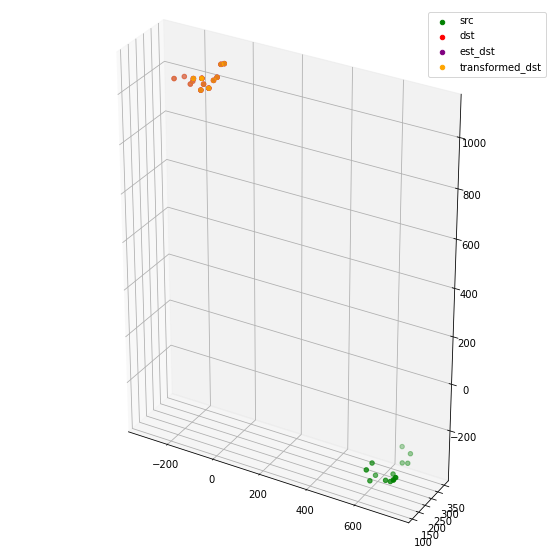

[[-107.75466074 -146.20545139 -125.19714374 -165.8003209  -121.04128847
  -123.59982099 -172.81994551 -237.62070821 -240.63992798 -275.96186661
  -294.61887732 -103.49378086 -119.45173789]
 [ 248.65318179  254.95005364  232.5331429   239.16362666  323.23415786
   303.67010121  312.67257472  323.96606811  344.47925931  343.36818344
   305.13851821  345.30364281  347.69881566]
 [1020.95194942 1001.6906199  1061.64833047 1048.48622704 1030.18152689
  1025.36194965  995.26106604  975.78051115  978.24986593  988.75512613
   991.6945936  1078.92785917 1071.44676539]]
[[-107.75466074 -146.20545139 -125.19714374 -165.8003209  -121.04128847
  -123.59982099 -172.81994551 -237.62070821 -240.63992798 -275.96186661
  -294.61887732 -103.49378086 -119.45173789]
 [ 248.65318179  254.95005364  232.5331429   239.16362666  323.23415786
   303.67010121  312.67257472  323.96606811  344.47925931  343.36818344
   305.13851821  345.30364281  347.69881566]
 [1020.95194942 1001.6906199  1061.64833047 1048.48622

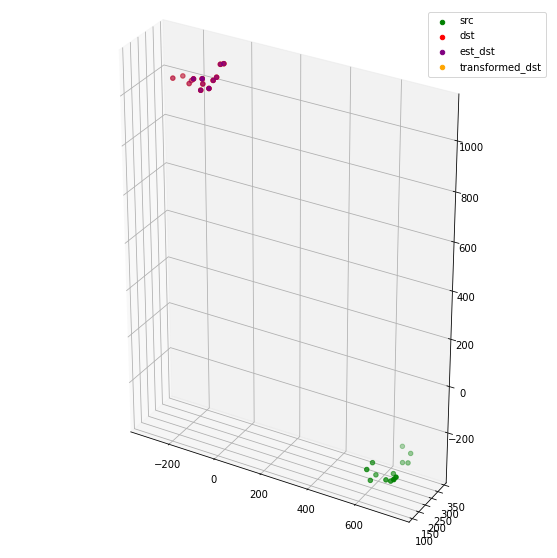

[[-107.23549629 -146.07966969 -123.78914822 -164.68765125 -121.31586154
  -123.70489326 -173.53149661 -238.78718549 -242.0260151  -277.15059562
  -295.2670533  -103.23968504 -119.34956175]
 [ 249.0148408   254.75827572  232.81172129  238.88194085  323.4517861
   303.84072195  312.11634899  322.52075897  343.00216541  341.47816913
   303.02486538  345.90613607  348.07336426]
 [1026.85438964 1008.21958727 1067.8876301  1055.38614374 1036.06992308
  1031.35553906 1002.05448145  983.6257761   986.08064609  997.17909683
  1000.55092314 1084.44591    1077.22545265]]
[[-107.23549629 -146.07966969 -123.78914822 -164.68765125 -121.31586154
  -123.70489326 -173.53149661 -238.78718549 -242.0260151  -277.15059562
  -295.2670533  -103.23968504 -119.34956175]
 [ 249.0148408   254.75827572  232.81172129  238.88194085  323.4517861
   303.84072195  312.11634899  322.52075897  343.00216541  341.47816913
   303.02486538  345.90613607  348.07336426]
 [1026.85438964 1008.21958727 1067.8876301  1055.3861437

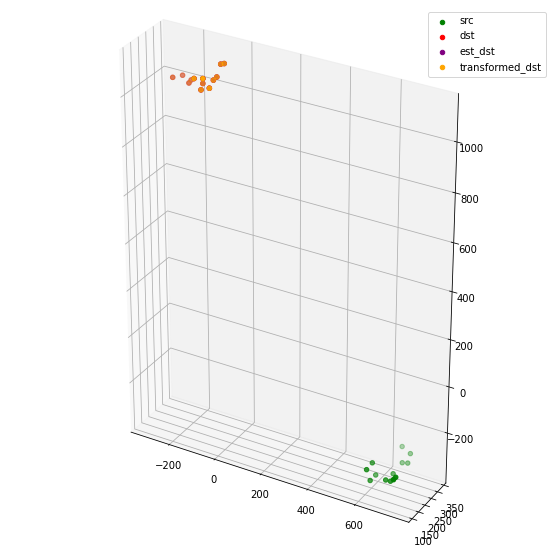

[[-107.67064931 -146.76652115 -123.65724016 -164.72553183 -121.70260361
  -124.13443183 -174.35704196 -239.86406251 -243.09070996 -278.06208015
  -296.09245419 -103.00379229 -119.21104014]
 [ 255.92919406  261.4911488   240.03202481  245.96679584  330.42291623
   310.77342413  318.77405312  328.97418859  349.47116954  348.0016852
   309.55927985  353.27120929  355.36714823]
 [1027.43007872 1009.27270624 1068.80640311 1056.80656192 1036.25227709
  1031.72343639 1003.02835409  985.39425773  987.73240488  999.31161961
  1003.22555678 1084.20529638 1077.18445834]]
[[-107.67064931 -146.76652115 -123.65724016 -164.72553183 -121.70260361
  -124.13443183 -174.35704196 -239.86406251 -243.09070996 -278.06208015
  -296.09245419 -103.00379229 -119.21104014]
 [ 255.92919406  261.4911488   240.03202481  245.96679584  330.42291623
   310.77342413  318.77405312  328.97418859  349.47116954  348.0016852
   309.55927985  353.27120929  355.36714823]
 [1027.43007872 1009.27270624 1068.80640311 1056.8065619

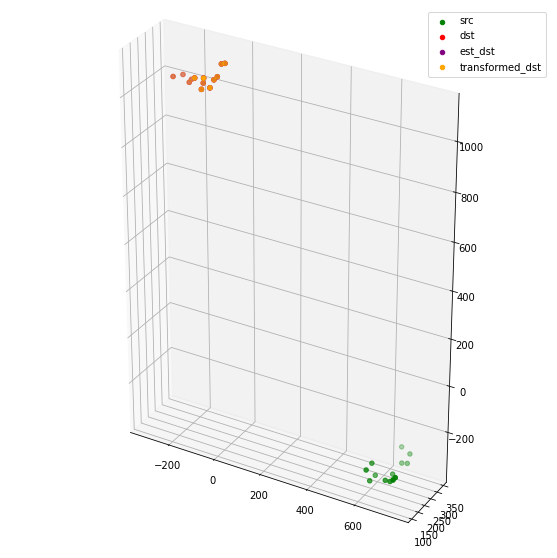

[[-111.04407059 -150.09629616 -127.17292653 -168.16324558 -123.52327241
  -126.37277319 -176.54491355 -241.90622604 -244.70615128 -279.65030071
  -298.44032315 -104.15964302 -120.35088962]
 [ 250.35053083  256.78915636  234.58697272  241.40945908  325.07128101
   305.49658822  314.64838186  326.25726785  346.80427359  345.98993169
   307.90310339  347.3106443   349.76767988]
 [1029.4636107  1011.5030848  1070.8358422  1059.04306047 1038.6896923
  1034.08117046 1005.64300269  988.34252714  990.78903237 1002.51411649
  1006.32992407 1086.66513057 1079.72492023]]
[[-111.04407059 -150.09629616 -127.17292653 -168.16324558 -123.52327241
  -126.37277319 -176.54491355 -241.90622604 -244.70615128 -279.65030071
  -298.44032315 -104.15964302 -120.35088962]
 [ 250.35053083  256.78915636  234.58697272  241.40945908  325.07128101
   305.49658822  314.64838186  326.25726785  346.80427359  345.98993169
   307.90310339  347.3106443   349.76767988]
 [1029.4636107  1011.5030848  1070.8358422  1059.043060

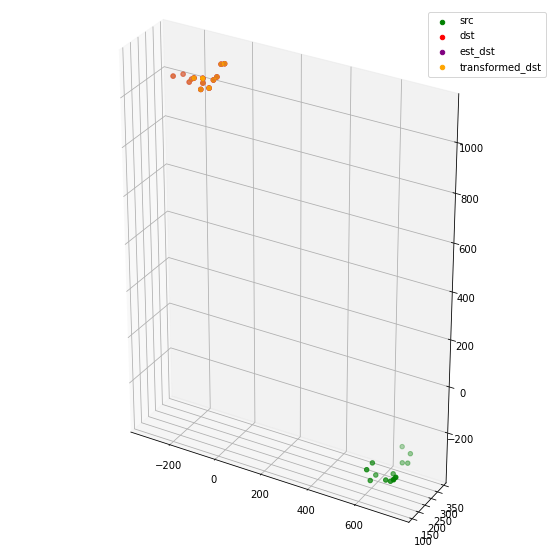

[[-102.72222724 -142.17803617 -117.8893122  -159.16127958 -115.59544769
  -118.38452406 -169.19027757 -234.97604251 -237.88629128 -272.57926883
  -290.99064173  -95.44167682 -111.78837469]
 [ 235.32728042  241.68293241  218.89918194  225.54306915  309.81906517
   290.28340321  299.39801611  310.70253905  331.19285174  329.9447347
   291.6613086   331.59018011  334.00627636]
 [1037.78638973 1020.69962466 1079.26371379 1068.38686922 1048.24085135
  1043.43401342 1016.13149296 1000.30067647 1003.07230988 1015.4849584
  1019.17717392 1096.10551654 1089.52463837]]
[[-102.72222724 -142.17803617 -117.8893122  -159.16127958 -115.59544769
  -118.38452406 -169.19027757 -234.97604251 -237.88629128 -272.57926883
  -290.99064173  -95.44167682 -111.78837469]
 [ 235.32728042  241.68293241  218.89918194  225.54306915  309.81906517
   290.28340321  299.39801611  310.70253905  331.19285174  329.9447347
   291.6613086   331.59018011  334.00627636]
 [1037.78638973 1020.69962466 1079.26371379 1068.38686922

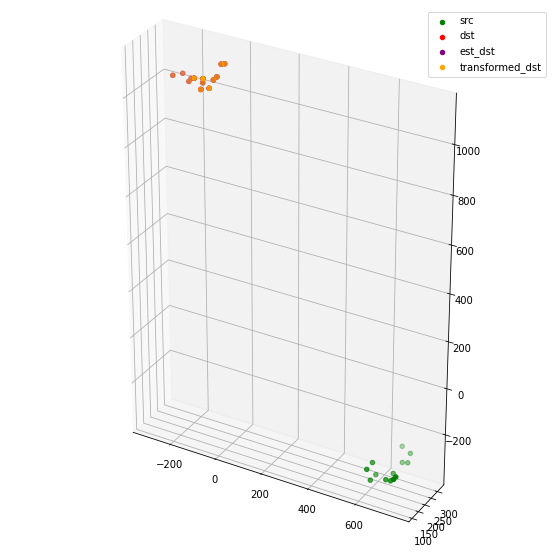

[[ -64.36950361 -104.44754515  -77.92757539 -119.54948865  -75.91706253
   -79.13651494 -130.96073308 -197.23121445 -199.78191869 -233.92093262
  -252.59878158  -53.47195732  -70.05753034]
 [ 215.05439507  222.18109898  197.94344862  205.25054778  289.45000865
   270.04792383  280.26373227  292.59433473  313.053568    311.92316778
   273.7715793   310.01880883  312.74420581]
 [1048.25897486 1033.02501973 1090.01643525 1081.06965288 1060.74849571
  1055.67691241 1030.78482423 1018.04302683 1021.34728108 1035.22115052
  1038.93949365 1108.12279054 1102.3046303 ]]
[[ -64.36950361 -104.44754515  -77.92757539 -119.54948865  -75.91706253
   -79.13651494 -130.96073308 -197.23121445 -199.78191869 -233.92093262
  -252.59878158  -53.47195732  -70.05753034]
 [ 215.05439507  222.18109898  197.94344862  205.25054778  289.45000865
   270.04792383  280.26373227  292.59433473  313.053568    311.92316778
   273.7715793   310.01880883  312.74420581]
 [1048.25897486 1033.02501973 1090.01643525 1081.06965

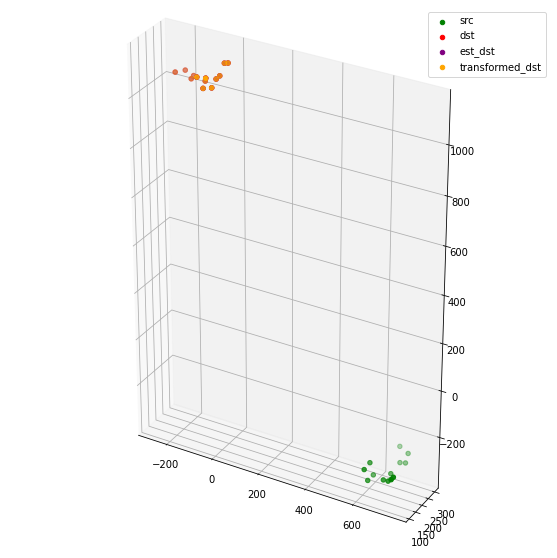

[[ -65.87602701 -106.1205818   -78.98468887 -120.72063923  -77.72615485
   -80.88178676 -132.97092369 -199.41403917 -202.04909128 -236.06232587
  -254.49778779  -54.99304568  -71.64216767]
 [ 234.11427769  240.75458957  217.67601037  224.60018484  308.65731071
   289.15119916  298.6455771   310.39308764  330.89388633  329.82768539
   291.64885828  330.18471813  332.71751037]
 [1045.32351144 1030.3103579  1087.49266662 1078.77552649 1056.59082111
  1051.89185039 1027.26854876 1014.879753   1017.84255019 1032.0269578
  1036.581376   1103.39849759 1097.67558657]]
[[ -65.87602701 -106.1205818   -78.98468887 -120.72063923  -77.72615485
   -80.88178676 -132.97092369 -199.41403917 -202.04909128 -236.06232587
  -254.49778779  -54.99304568  -71.64216767]
 [ 234.11427769  240.75458957  217.67601037  224.60018484  308.65731071
   289.15119916  298.6455771   310.39308764  330.89388633  329.82768539
   291.64885828  330.18471813  332.71751037]
 [1045.32351144 1030.3103579  1087.49266662 1078.775526

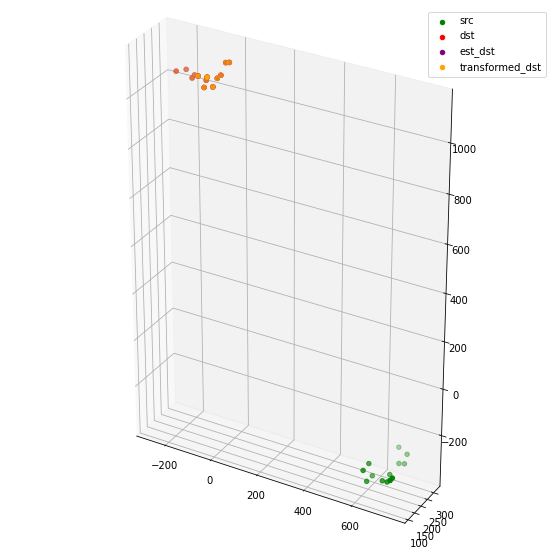

[[ -43.39841738  -84.2998916   -54.5902444   -96.7479078   -56.18672059
   -59.15775904 -112.31094443 -179.38225556 -182.2810437  -215.70552861
  -233.24647728  -32.09374079  -48.99213751]
 [ 245.42558876  251.14365082  229.30888347  235.3665155   319.88488406
   300.26521839  308.49758551  318.88492257  339.37212825  337.8806664
   299.43955051  342.42978335  344.58749713]
 [1045.06464618 1031.51895004 1087.90488563 1080.70358107 1055.8495529
  1051.51730457 1028.78636979 1018.80056431 1021.6069579  1037.09287667
  1042.8224098  1101.48328976 1096.36973234]]
[[ -43.39841738  -84.2998916   -54.5902444   -96.7479078   -56.18672059
   -59.15775904 -112.31094443 -179.38225556 -182.2810437  -215.70552861
  -233.24647728  -32.09374079  -48.99213751]
 [ 245.42558876  251.14365082  229.30888347  235.3665155   319.88488406
   300.26521839  308.49758551  318.88492257  339.37212825  337.8806664
   299.43955051  342.42978335  344.58749713]
 [1045.06464618 1031.51895004 1087.90488563 1080.70358107

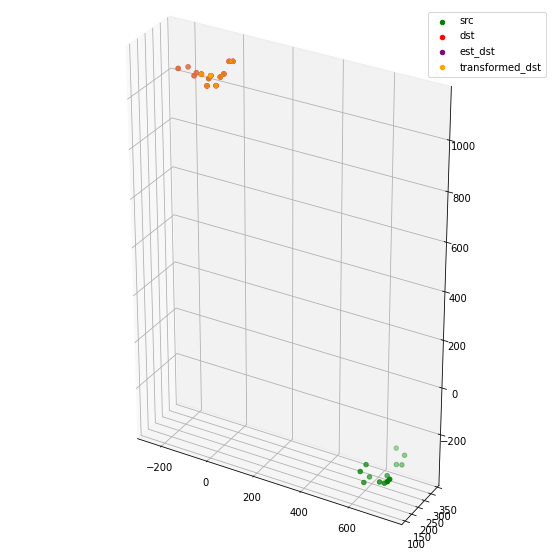

[[ -39.15284268  -80.11976738  -50.07320535  -92.21017365  -50.54489604
   -53.90125538 -107.19072952 -174.19787249 -176.71465929 -209.96130008
  -228.07503054  -25.50024204  -42.42303729]
 [ 252.56092715  258.86540623  236.9764785   243.69205748  327.30978124
   307.70970958  316.6633934   328.10902169  348.66409439  347.8632741
   309.77222707  349.80295849  352.20681017]
 [1041.3686535  1028.28900002 1084.475056   1077.75202257 1051.7065208
  1047.57145503 1025.44021302 1016.20905689 1018.88472213 1034.79867493
  1041.05940379 1096.85078271 1091.93138154]]
[[ -39.15284268  -80.11976738  -50.07320535  -92.21017365  -50.54489604
   -53.90125538 -107.19072952 -174.19787249 -176.71465929 -209.96130008
  -228.07503054  -25.50024204  -42.42303729]
 [ 252.56092715  258.86540623  236.9764785   243.69205748  327.30978124
   307.70970958  316.6633934   328.10902169  348.66409439  347.8632741
   309.77222707  349.80295849  352.20681017]
 [1041.3686535  1028.28900002 1084.475056   1077.75202257

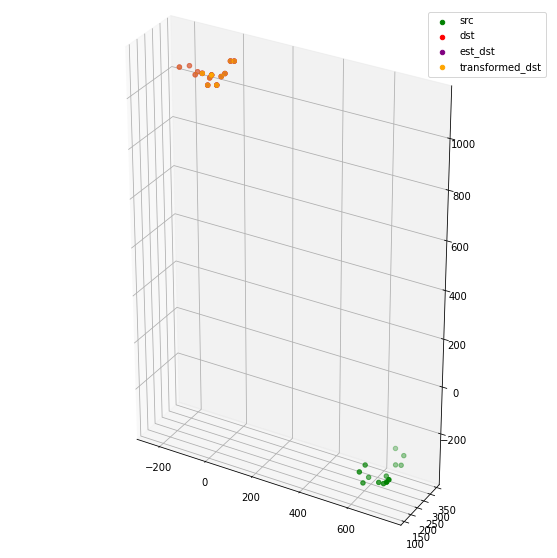

[[ -65.26037539 -106.08124131  -76.62595243 -118.66749522  -76.32300561
   -79.75355556 -132.80621121 -199.6695185  -202.09435581 -235.4763984
  -253.85287703  -51.53094557  -68.39854919]
 [ 210.61346529  217.67951161  193.37333295  200.60149936  284.95206242
   265.55413808  275.70354765  287.90498367  308.35033555  307.10604739
   268.90133658  305.46463037  308.16379931]
 [1047.66454259 1034.51765681 1090.01891418 1083.23035275 1060.90964577
  1055.96206203 1033.77797776 1024.47222917 1027.95248266 1043.55137077
  1048.12705939 1107.12404196 1102.16839419]]
[[ -65.26037539 -106.08124131  -76.62595243 -118.66749522  -76.32300561
   -79.75355556 -132.80621121 -199.6695185  -202.09435581 -235.4763984
  -253.85287703  -51.53094557  -68.39854919]
 [ 210.61346529  217.67951161  193.37333295  200.60149936  284.95206242
   265.55413808  275.70354765  287.90498367  308.35033555  307.10604739
   268.90133658  305.46463037  308.16379931]
 [1047.66454259 1034.51765681 1090.01891418 1083.2303527

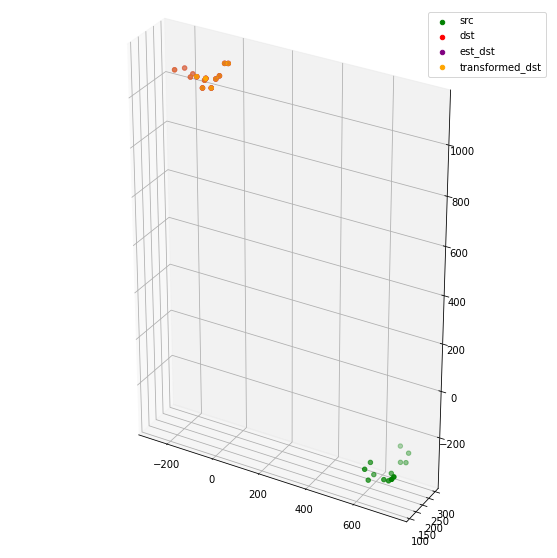

[[ -77.48571019 -118.19557083  -89.11713535 -131.0489787   -87.5102113
   -91.21015678 -144.1019975  -210.7817887  -212.92107566 -246.32639247
  -265.24064736  -62.45925033  -79.28436347]
 [ 178.35244937  186.45023467  159.79412046  167.8473303   252.32715612
   233.16552458  244.83452603  258.2951499   278.63745235  277.31467881
   239.23487354  270.8499889   273.95886363]
 [1049.74151359 1036.8478783  1091.46188839 1084.92823698 1065.5937597
  1059.96623746 1038.14844719 1029.27202282 1033.46947399 1049.01197731
  1052.23861849 1112.50363201 1107.64457085]]
[[ -77.48571019 -118.19557083  -89.11713535 -131.0489787   -87.5102113
   -91.21015678 -144.1019975  -210.7817887  -212.92107566 -246.32639247
  -265.24064736  -62.45925033  -79.28436347]
 [ 178.35244937  186.45023467  159.79412046  167.8473303   252.32715612
   233.16552458  244.83452603  258.2951499   278.63745235  277.31467881
   239.23487354  270.8499889   273.95886363]
 [1049.74151359 1036.8478783  1091.46188839 1084.92823698

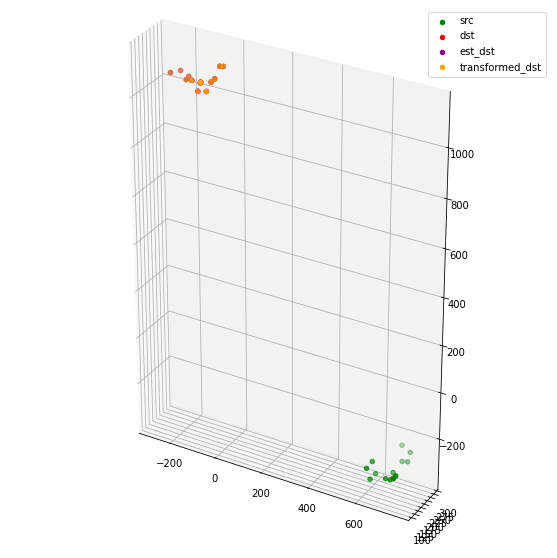

[[ -82.61410501 -123.71124661  -93.14058967 -135.37216167  -94.56149218
   -97.78062852 -151.27708723 -218.43207299 -221.10262715 -254.24333783
  -272.0021523   -69.42785436  -86.39981584]
 [ 203.89194695  210.57130358  185.80590911  192.52684791  277.83723499
   258.47359041  268.20250296  279.57300516  299.92184683  297.93764417
   259.39927679  297.96163752  300.49337815]
 [1040.80846741 1028.33754688 1083.02670581 1076.93198807 1055.41654341
  1050.19992036 1028.91129552 1020.72023776 1024.56695026 1040.59787556
  1044.79913356 1101.6170929  1096.93704771]]
[[ -82.61410501 -123.71124661  -93.14058967 -135.37216167  -94.56149218
   -97.78062852 -151.27708723 -218.43207299 -221.10262715 -254.24333783
  -272.0021523   -69.42785436  -86.39981584]
 [ 203.89194695  210.57130358  185.80590911  192.52684791  277.83723499
   258.47359041  268.20250296  279.57300516  299.92184683  297.93764417
   259.39927679  297.96163752  300.49337815]
 [1040.80846741 1028.33754688 1083.02670581 1076.93198

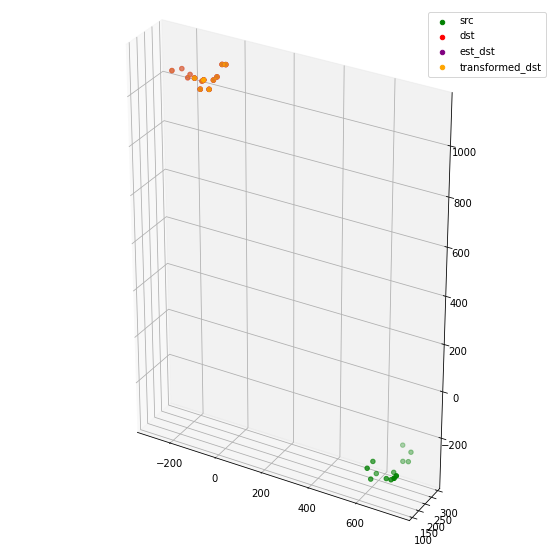

[[ -50.55897689  -92.47223432  -58.17029708 -100.87160746  -64.16975998
   -67.0157951  -121.88316635 -189.72671548 -192.86565692 -225.00394126
  -241.20697916  -37.25872204  -54.53464771]
 [ 253.7944309   258.64500639  237.22213212  242.35320121  327.89087905
   308.22966093  315.35904309  324.26500074  344.66724882  342.34132098
   303.4839545   350.75935736  352.55641218]
 [1028.60311937 1018.16935298 1072.05099637 1068.03945074 1040.78936252
  1036.56286135 1017.89546026 1012.98520377 1016.13158801 1034.04680695
  1040.81426245 1084.65291046 1080.82237575]]
[[ -50.55897689  -92.47223432  -58.17029708 -100.87160746  -64.16975998
   -67.0157951  -121.88316635 -189.72671548 -192.86565692 -225.00394126
  -241.20697916  -37.25872204  -54.53464771]
 [ 253.7944309   258.64500639  237.22213212  242.35320121  327.89087905
   308.22966093  315.35904309  324.26500074  344.66724882  342.34132098
   303.4839545   350.75935736  352.55641218]
 [1028.60311937 1018.16935298 1072.05099637 1068.03945

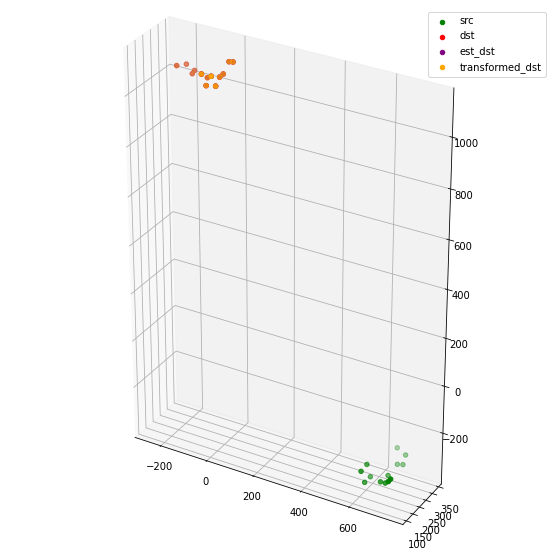

[[ -54.34971508  -96.45267016  -61.16072152 -103.94609669  -68.09816426
   -70.92322199 -126.12582847 -194.08208564 -197.2625008  -229.08729171
  -244.99581781  -40.56728293  -57.91264587]
 [ 239.7612138   244.6066332   222.30911974  227.30610215  313.53828516
   293.94920827  301.16915738  309.83345175  330.15483845  327.32185175
   288.26051364  335.68160879  337.46743117]
 [1031.52521496 1021.88281922 1074.76091665 1071.55715082 1045.3803748
  1040.81815588 1023.20358933 1019.59097626 1023.18689284 1041.58230532
  1047.85625807 1089.23132567 1085.72287407]]
[[ -54.34971508  -96.45267016  -61.16072152 -103.94609669  -68.09816426
   -70.92322199 -126.12582847 -194.08208564 -197.2625008  -229.08729171
  -244.99581781  -40.56728293  -57.91264587]
 [ 239.7612138   244.6066332   222.30911974  227.30610215  313.53828516
   293.94920827  301.16915738  309.83345175  330.15483845  327.32185175
   288.26051364  335.68160879  337.46743117]
 [1031.52521496 1021.88281922 1074.76091665 1071.557150

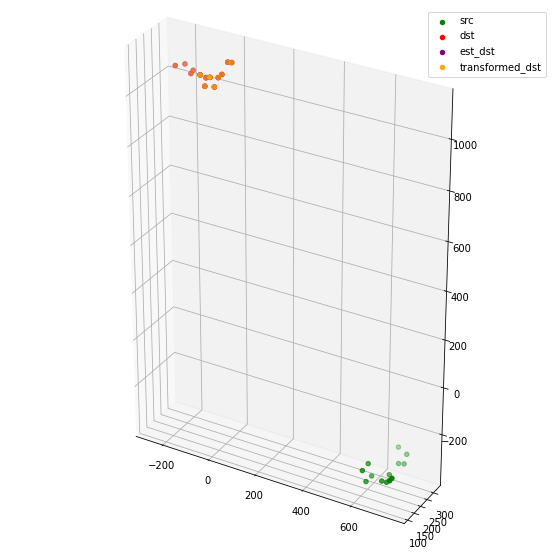

[[ -79.22189095 -121.33902158  -85.96113429 -128.74525814  -92.81047594
   -95.68003324 -150.91144034 -218.86098009 -221.99788335 -253.78410188
  -269.74511953  -65.13827405  -82.48874696]
 [ 253.44569946  258.31983979  236.20405462  241.26048915  327.30931744
   307.70443894  314.93921578  323.70470319  344.04786507  341.35453919
   302.35005965  349.60586789  351.40565445]
 [1027.38667911 1017.8209708  1070.71795626 1067.59169765 1040.93503195
  1036.46948541 1018.95155018 1015.45868065 1018.96866882 1037.45154298
  1043.9421757  1084.61907001 1081.14317185]]
[[ -79.22189095 -121.33902158  -85.96113429 -128.74525814  -92.81047594
   -95.68003324 -150.91144034 -218.86098009 -221.99788335 -253.78410188
  -269.74511953  -65.13827405  -82.48874696]
 [ 253.44569946  258.31983979  236.20405462  241.26048915  327.30931744
   307.70443894  314.93921578  323.70470319  344.04786507  341.35453919
   302.35005965  349.60586789  351.40565445]
 [1027.38667911 1017.8209708  1070.71795626 1067.59169

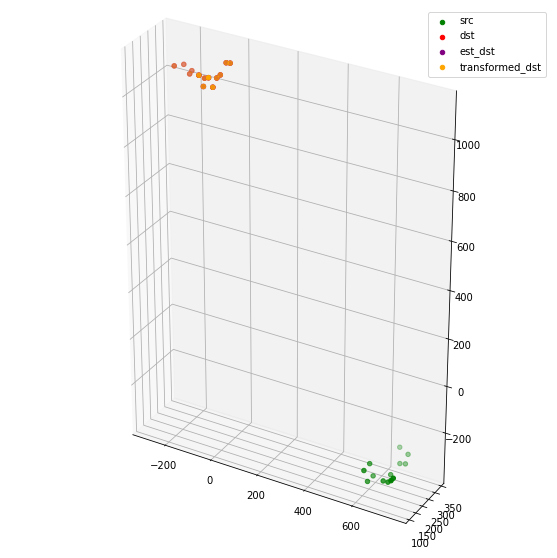

[[ -54.47204103  -96.98257903  -59.23164419 -102.11771563  -67.49900676
   -70.55029965 -126.52306032 -194.56863683 -197.56148475 -228.47781999
  -244.09528497  -37.90084268  -55.39220287]
 [ 252.09775294  257.00163225  234.47111843  239.50039612  325.82339441
   306.25450578  313.5715364   322.28105174  342.58890675  339.69457835
   300.61490901  347.77392494  349.58192576]
 [1029.01446991 1021.40402718 1072.45338369 1071.30729504 1043.8087094
  1039.30593961 1024.36473795 1024.021637   1027.84764017 1047.72318819
  1054.58657314 1086.39162843 1083.71890294]]
[[ -54.47204103  -96.98257903  -59.23164419 -102.11771563  -67.49900676
   -70.55029965 -126.52306032 -194.56863683 -197.56148475 -228.47781999
  -244.09528497  -37.90084268  -55.39220287]
 [ 252.09775294  257.00163225  234.47111843  239.50039612  325.82339441
   306.25450578  313.5715364   322.28105174  342.58890675  339.69457835
   300.61490901  347.77392494  349.58192576]
 [1029.01446991 1021.40402718 1072.45338369 1071.307295

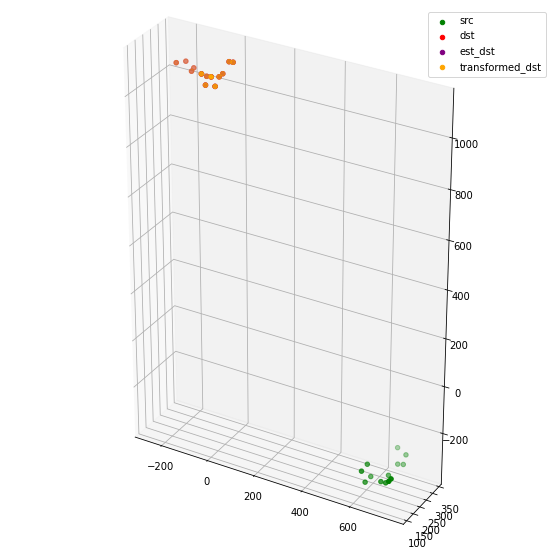

[[ -41.74039506  -84.49178943  -45.08122701  -88.01621713  -54.83115778
   -57.87963317 -114.3221147  -182.40640023 -185.42452264 -215.71406577
  -230.84896799  -24.12999035  -41.70533246]
 [ 263.7117452   268.27864494  246.34241561  251.07512196  337.44466099
   317.82619315  324.66680348  332.91552917  353.22774211  350.25742858
   311.11995457  359.87635563  361.54875927]
 [1026.96193238 1020.59212726 1070.63614135 1070.73807666 1041.66331422
  1037.37971252 1024.06878804 1025.70048886 1029.48325993 1050.29083415
  1057.86874175 1083.20172409 1081.04060738]]
[[ -41.74039506  -84.49178943  -45.08122701  -88.01621713  -54.83115778
   -57.87963317 -114.3221147  -182.40640023 -185.42452264 -215.71406577
  -230.84896799  -24.12999035  -41.70533246]
 [ 263.7117452   268.27864494  246.34241561  251.07512196  337.44466099
   317.82619315  324.66680348  332.91552917  353.22774211  350.25742858
   311.11995457  359.87635563  361.54875927]
 [1026.96193238 1020.59212726 1070.63614135 1070.73807

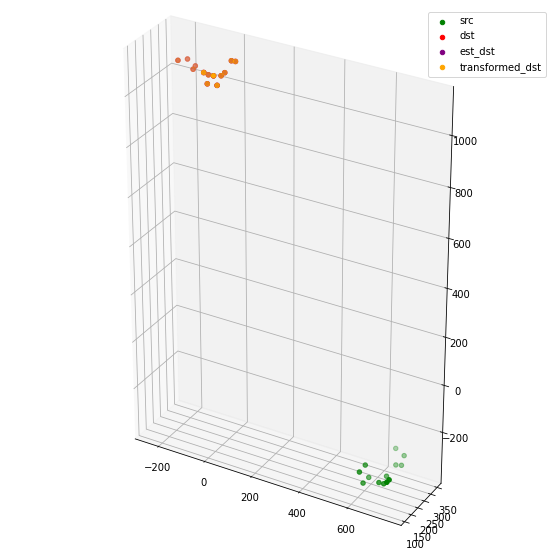

[[ -32.08497836  -75.00014316  -34.27347101  -77.21395559  -45.14381165
   -48.20788117 -104.99063705 -173.05088786 -176.06696154 -205.82252492
  -220.58966632  -13.5332861   -31.16378932]
 [ 253.34142725  257.80628315  235.20336493  239.72121227  326.74353271
   307.18721348  313.97769895  321.86017746  342.08878585  338.60944649
   299.27244811  348.60533467  350.22791081]
 [1030.86915908 1025.62831912 1074.30316065 1075.53852131 1047.16760552
  1042.61913516 1030.8150544  1034.25636966 1038.46482733 1059.95284669
  1067.21672408 1088.32606016 1086.62529198]]
[[ -32.08497836  -75.00014316  -34.27347101  -77.21395559  -45.14381165
   -48.20788117 -104.99063705 -173.05088786 -176.06696154 -205.82252492
  -220.58966632  -13.5332861   -31.16378932]
 [ 253.34142725  257.80628315  235.20336493  239.72121227  326.74353271
   307.18721348  313.97769895  321.86017746  342.08878585  338.60944649
   299.27244811  348.60533467  350.22791081]
 [1030.86915908 1025.62831912 1074.30316065 1075.53852

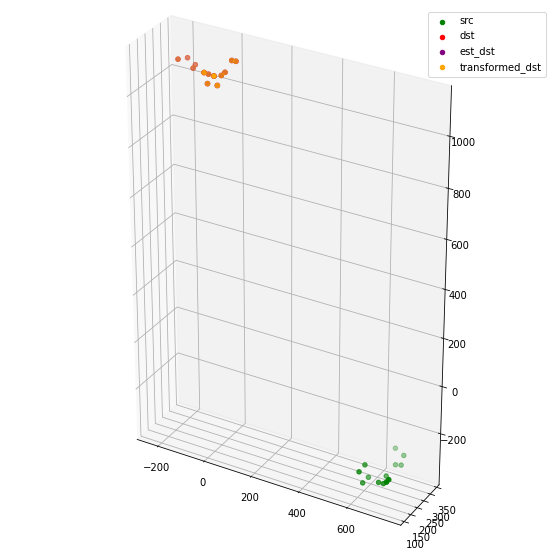

[[ -17.84466891  -60.97243059  -18.32414749  -61.26482489  -31.48219086
   -34.3945535   -91.6324348  -159.65521151 -162.84047005 -191.815751
  -205.73174413    1.12772121  -16.57199106]
 [ 253.36658122  257.18500769  235.06602785  238.91751818  326.50912886
   306.92169727  312.87144329  319.69319011  339.86010716  335.85761109
   296.27587572  348.73149259  350.0871633 ]
 [1029.28297273 1025.4713454  1072.70130001 1075.36335245 1046.26023068
  1041.746098   1031.83883561 1037.54317424 1041.91970238 1064.36179341
  1071.96857861 1086.43413122 1085.31952272]]
[[ -17.84466891  -60.97243059  -18.32414749  -61.26482489  -31.48219086
   -34.3945535   -91.6324348  -159.65521151 -162.84047005 -191.815751
  -205.73174413    1.12772121  -16.57199106]
 [ 253.36658122  257.18500769  235.06602785  238.91751818  326.50912886
   306.92169727  312.87144329  319.69319011  339.86010716  335.85761109
   296.27587572  348.73149259  350.0871633 ]
 [1029.28297273 1025.4713454  1072.70130001 1075.36335245 

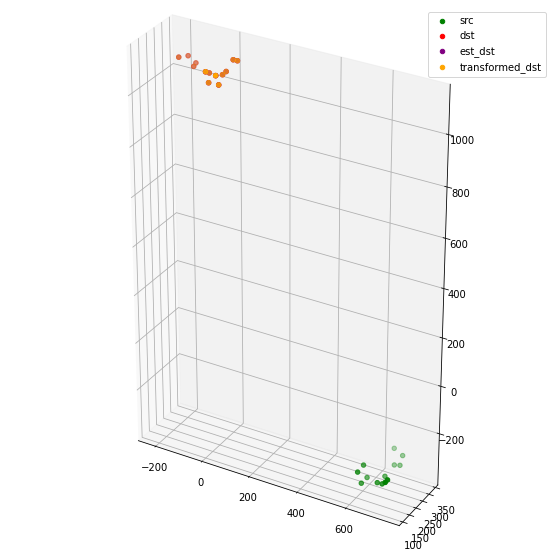

[[ -35.10910592  -78.31773762  -35.04526541  -78.03716652  -50.02374786
   -52.59274369 -109.97703269 -178.08738184 -181.62629915 -210.41686659
  -223.559233    -17.6447372   -35.37160585]
 [ 241.95836854  245.0182713   223.12738835  226.14540485  314.62300674
   295.04082673  300.04240527  305.52564016  325.57519014  320.76179438
   280.83833488  336.96091367  337.99988911]
 [1027.95219386 1024.37954031 1071.14572817 1074.04577862 1045.88109174
  1041.14134356 1031.56240993 1037.65242909 1042.28880953 1064.80921755
  1071.99443904 1086.17748962 1085.15833917]]
[[ -35.10910592  -78.31773762  -35.04526541  -78.03716652  -50.02374786
   -52.59274369 -109.97703269 -178.08738184 -181.62629915 -210.41686659
  -223.559233    -17.6447372   -35.37160585]
 [ 241.95836854  245.0182713   223.12738835  226.14540485  314.62300674
   295.04082673  300.04240527  305.52564016  325.57519014  320.76179438
   280.83833488  336.96091367  337.99988911]
 [1027.95219386 1024.37954031 1071.14572817 1074.04577

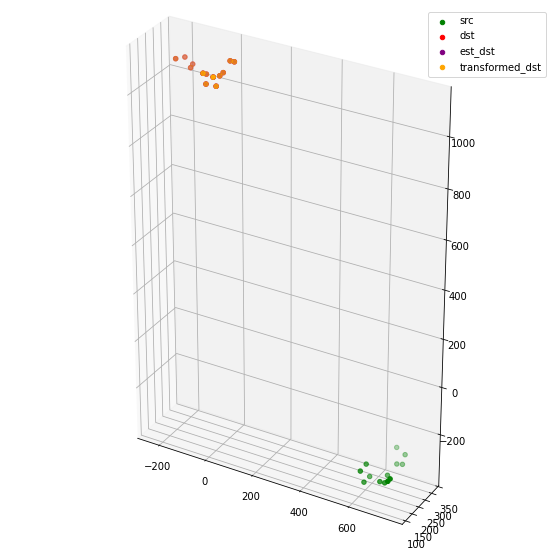

[[ -42.87475521  -86.12114719  -42.34403301  -85.30649987  -57.67463774
   -60.27324863 -117.75877895 -185.80767388 -189.31818059 -217.86872281
  -230.89620802  -24.90140808  -42.63891973]
 [ 237.10716934  240.15612401  217.83370627  220.7745464   309.56743263
   290.03214725  295.06877844  300.41435018  320.41133143  315.33529699
   275.32574183  331.5259162   332.55582569]
 [1027.34340979 1024.25048758 1070.33809844 1073.71451325 1046.17198618
  1041.25806994 1032.32641101 1039.17817138 1044.05684924 1066.8238153
  1073.73409356 1086.35808473 1085.53347788]]
[[ -42.87475521  -86.12114719  -42.34403301  -85.30649987  -57.67463774
   -60.27324863 -117.75877895 -185.80767388 -189.31818059 -217.86872281
  -230.89620802  -24.90140808  -42.63891973]
 [ 237.10716934  240.15612401  217.83370627  220.7745464   309.56743263
   290.03214725  295.06877844  300.41435018  320.41133143  315.33529699
   275.32574183  331.5259162   332.55582569]
 [1027.34340979 1024.25048758 1070.33809844 1073.714513

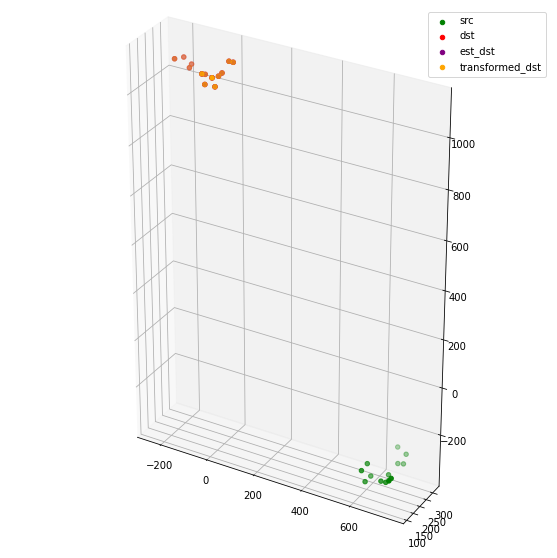

[[ -21.47781665  -64.8602975   -18.80703396  -61.62897108  -36.6341306
   -39.12291977  -97.01029456 -164.78376643 -168.40673598 -195.87719736
  -207.94980195   -2.54095107  -20.3118264 ]
 [ 234.16802188  236.52132472  214.72543284  216.94811586  306.29648807
   286.74207735  290.87411339  295.07577131  314.99191657  309.35344389
   269.10724559  328.61975412  329.36250892]
 [1026.94286502 1025.70390043 1069.78144515 1074.99332182 1046.73710865
  1041.84245076 1035.38439382 1045.14535899 1050.2664588  1074.20002744
  1081.46140209 1085.60237596 1085.53668504]]
[[ -21.47781665  -64.8602975   -18.80703396  -61.62897108  -36.6341306
   -39.12291977  -97.01029456 -164.78376643 -168.40673598 -195.87719736
  -207.94980195   -2.54095107  -20.3118264 ]
 [ 234.16802188  236.52132472  214.72543284  216.94811586  306.29648807
   286.74207735  290.87411339  295.07577131  314.99191657  309.35344389
   269.10724559  328.61975412  329.36250892]
 [1026.94286502 1025.70390043 1069.78144515 1074.9933218

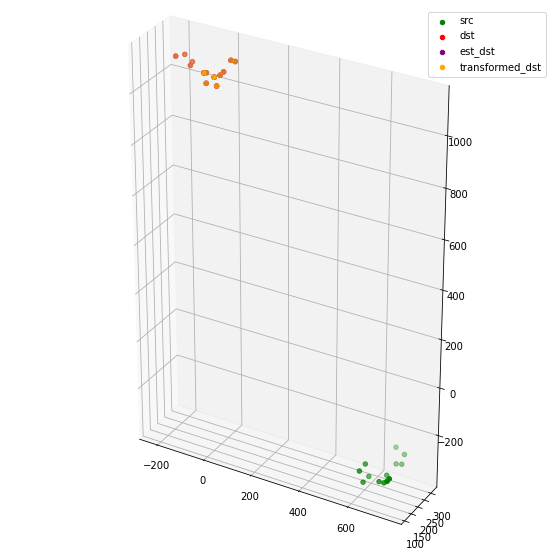

[[   3.56828417  -39.79522709    7.67443975  -34.87632682   -9.86116673
   -12.7938343   -70.83253077 -138.10834659 -141.26856251 -167.84454776
  -180.1411584    26.0240408     8.27549601]
 [ 248.87469712  251.79364273  229.78012741  232.61839543  321.37157196
   301.80922582  306.65316056  311.842457    331.84978884  326.79027078
   286.77437387  343.58426658  344.56268547]
 [1022.79985415 1023.24522907 1065.68141418 1072.55155064 1042.49489298
  1037.88611871 1033.67015035 1046.04793962 1051.11983493 1076.16684305
  1084.27567663 1079.77800146 1080.40399188]]
[[   3.56828417  -39.79522709    7.67443975  -34.87632682   -9.86116673
   -12.7938343   -70.83253077 -138.10834659 -141.26856251 -167.84454776
  -180.1411584    26.0240408     8.27549601]
 [ 248.87469712  251.79364273  229.78012741  232.61839543  321.37157196
   301.80922582  306.65316056  311.842457    331.84978884  326.79027078
   286.77437387  343.58426658  344.56268547]
 [1022.79985415 1023.24522907 1065.68141418 1072.55155

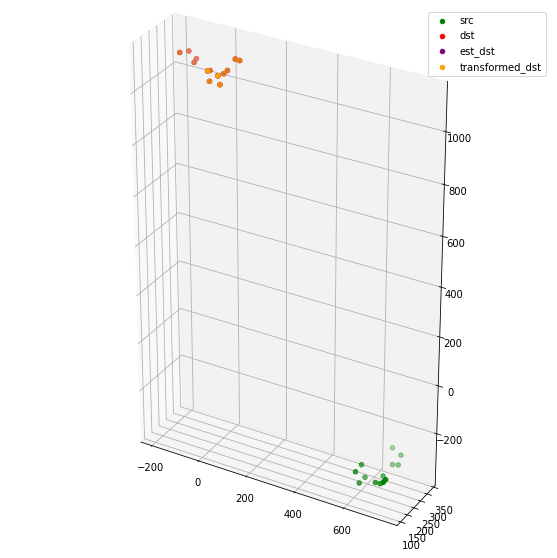

[[  22.21268339  -21.12500018   28.15846719  -14.11599084    8.91008678
     5.97593981  -52.22416143 -119.01034923 -122.15015877 -147.68319696
  -159.2943121    46.02007395   28.30133742]
 [ 268.43056827  270.97879969  249.76416945  252.2973611   340.98539949
   321.35722192  325.66101125  330.38173121  350.40645777  345.34628977
   305.30131522  363.84641944  364.67717105]
 [1016.10290506 1018.21582036 1058.95736232 1067.45885718 1035.67019811
  1031.35138424 1029.36291897 1044.31262736 1049.32823664 1075.43748769
  1084.37134685 1071.32696072 1072.63701323]]
[[  22.21268339  -21.12500018   28.15846719  -14.11599084    8.91008678
     5.97593981  -52.22416143 -119.01034923 -122.15015877 -147.68319696
  -159.2943121    46.02007395   28.30133742]
 [ 268.43056827  270.97879969  249.76416945  252.2973611   340.98539949
   321.35722192  325.66101125  330.38173121  350.40645777  345.34628977
   305.30131522  363.84641944  364.67717105]
 [1016.10290506 1018.21582036 1058.95736232 1067.45885

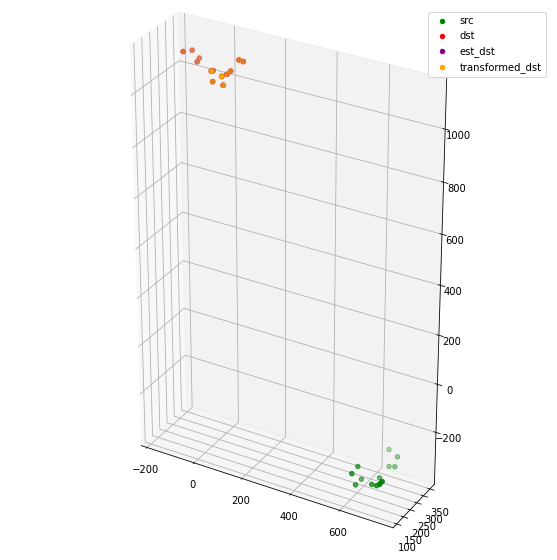

[[  22.39872931  -20.87196426   29.16515891  -12.90706446    9.85391701
     6.7369933   -51.47142745 -117.90252783 -120.84148529 -145.83812707
  -157.44426094   47.81872855   30.13586151]
 [ 264.37846947  267.10734937  245.37441687  248.03701921  336.84863398
   317.26583818  321.84726775  326.7613696   346.76311989  341.62892833
   301.57303529  359.28177219  360.18314768]
 [1013.08602626 1016.13774768 1055.66950559 1065.08549446 1033.45130327
  1029.0552117  1028.33504608 1044.7342645  1049.95891076 1076.56797513
  1085.45925799 1068.47428851 1070.16654886]]
[[  22.39872931  -20.87196426   29.16515891  -12.90706446    9.85391701
     6.7369933   -51.47142745 -117.90252783 -120.84148529 -145.83812707
  -157.44426094   47.81872855   30.13586151]
 [ 264.37846947  267.10734937  245.37441687  248.03701921  336.84863398
   317.26583818  321.84726775  326.7613696   346.76311989  341.62892833
   301.57303529  359.28177219  360.18314768]
 [1013.08602626 1016.13774768 1055.66950559 1065.08549

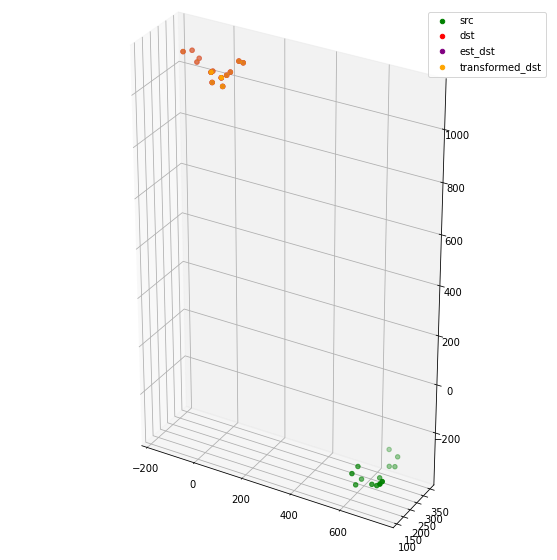

[[  12.9771111   -30.29304956   21.17361232  -20.77479923   -1.52798604
    -4.08934209  -62.41917359 -128.64853786 -132.13650009 -156.43814527
  -166.56140208   36.35056385   18.68340746]
 [ 257.05011015  258.32286892  237.78068603  238.95196246  328.8265072
   309.20487652  311.88347276  314.42443575  334.25650741  327.99420884
   287.47793175  352.0806088   352.38184626]
 [1013.33453916 1017.23146015 1055.54588786 1065.78215457 1034.82389819
  1030.24593021 1030.67518621 1048.3779734  1053.90314012 1080.91143493
  1089.5243777  1069.40198832 1071.43689636]]
[[  12.9771111   -30.29304956   21.17361232  -20.77479923   -1.52798604
    -4.08934209  -62.41917359 -128.64853786 -132.13650009 -156.43814527
  -166.56140208   36.35056385   18.68340746]
 [ 257.05011015  258.32286892  237.78068603  238.95196246  328.8265072
   309.20487652  311.88347276  314.42443575  334.25650741  327.99420884
   287.47793175  352.0806088   352.38184626]
 [1013.33453916 1017.23146015 1055.54588786 1065.7821545

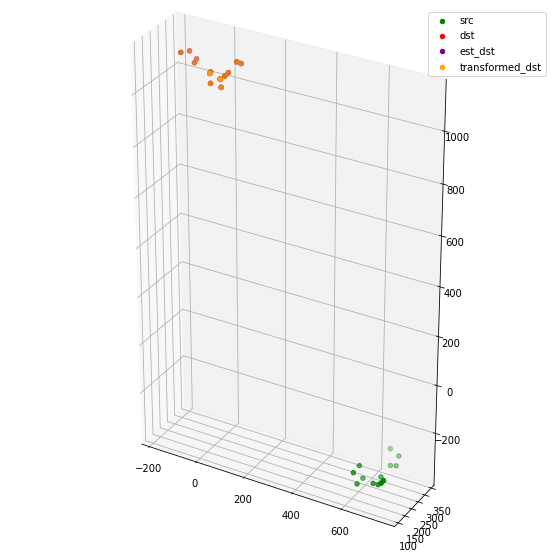

[[ 1.50592073e+01 -2.81221580e+01  2.45286749e+01 -1.71816309e+01
  -1.27801738e-02 -2.38631338e+00 -6.07237184e+01 -1.26551456e+02
  -1.30205900e+02 -1.53772537e+02 -1.63083471e+02  3.83117151e+01
   2.06944678e+01]
 [ 2.66277877e+02  2.66920757e+02  2.47292971e+02  2.47878121e+02
   3.37911272e+02  3.18236439e+02  3.20047519e+02  3.21668855e+02
   3.41467593e+02  3.34946531e+02  2.94316932e+02  3.61858024e+02
   3.61903793e+02]
 [ 1.00871529e+03  1.01362132e+03  1.05078896e+03  1.06200192e+03
   1.03029152e+03  1.02584247e+03  1.02763008e+03  1.04687207e+03
   1.05240916e+03  1.08000126e+03  1.08898870e+03  1.06389164e+03
   1.06633919e+03]]
[[ 1.50592073e+01 -2.81221580e+01  2.45286749e+01 -1.71816309e+01
  -1.27801738e-02 -2.38631338e+00 -6.07237184e+01 -1.26551456e+02
  -1.30205900e+02 -1.53772537e+02 -1.63083471e+02  3.83117151e+01
   2.06944678e+01]
 [ 2.66277877e+02  2.66920757e+02  2.47292971e+02  2.47878121e+02
   3.37911272e+02  3.18236439e+02  3.20047519e+02  3.21668855e+02

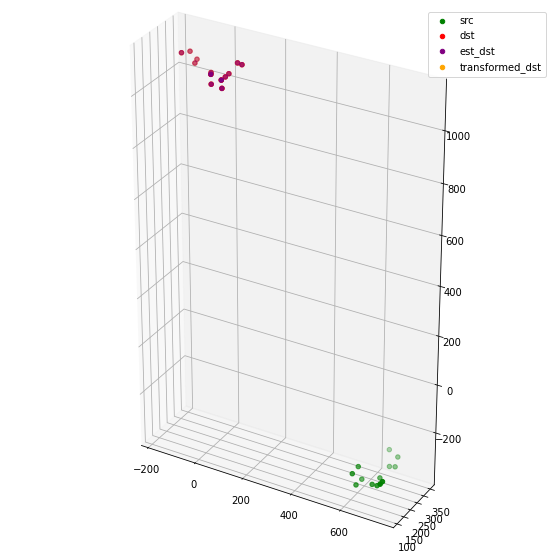

[[  37.9816456    -4.95803148   49.57354722    8.37121152   22.50705527
    20.31353646  -37.91961464 -102.8932602  -106.67756069 -128.93069859
  -137.09639143   61.76682406   44.27107022]
 [ 247.10263765  246.74996105  227.11572963  226.55445847  317.77842678
   298.19546431  298.79915955  298.56666018  318.12302134  310.35158924
   269.30558583  341.51055687  341.13755567]
 [1010.67252404 1017.39357029 1051.73884384 1064.69549405 1034.95238098
  1030.03071636 1034.30436185 1056.31674894 1062.58031198 1090.92880449
  1099.10063936 1067.61181538 1070.792928  ]]
[[  37.9816456    -4.95803148   49.57354722    8.37121152   22.50705527
    20.31353646  -37.91961464 -102.8932602  -106.67756069 -128.93069859
  -137.09639143   61.76682406   44.27107022]
 [ 247.10263765  246.74996105  227.11572963  226.55445847  317.77842678
   298.19546431  298.79915955  298.56666018  318.12302134  310.35158924
   269.30558583  341.51055687  341.13755567]
 [1010.67252404 1017.39357029 1051.73884384 1064.69549

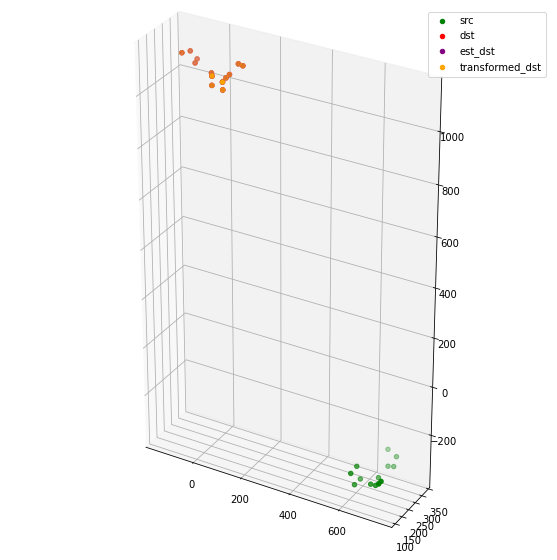

[[  63.65274294   21.12420385   77.77272138   37.29536722   47.66263411
    45.71221013  -12.23193695  -75.99958377  -79.95001524 -100.5603164
  -107.28775096   87.90389173   70.60344261]
 [ 248.81633483  247.30751702  228.71110447  226.97409405  318.82584057
   299.24488514  298.32970311  296.22674793  315.61599354  306.99429195
   265.67331187  343.21000556  342.36150028]
 [1004.73328294 1013.57407156 1044.94145647 1059.92107169 1030.56015062
  1025.52936968 1032.69642228 1057.90433092 1064.57183869 1093.89957433
  1101.99587292 1061.49937787 1065.54097519]]
[[  63.65274294   21.12420385   77.77272138   37.29536722   47.66263411
    45.71221013  -12.23193695  -75.99958377  -79.95001524 -100.5603164
  -107.28775096   87.90389173   70.60344261]
 [ 248.81633483  247.30751702  228.71110447  226.97409405  318.82584057
   299.24488514  298.32970311  296.22674793  315.61599354  306.99429195
   265.67331187  343.21000556  342.36150028]
 [1004.73328294 1013.57407156 1044.94145647 1059.9210716

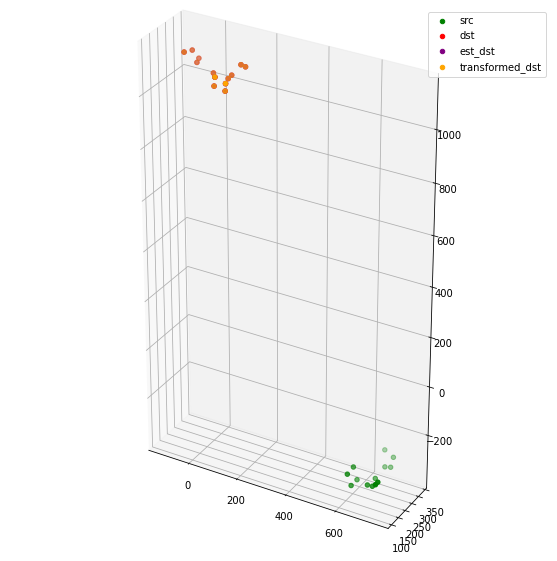

[[  33.53612758   -9.07882776   47.28610593    6.658294     17.08927096
    15.24392351  -42.7697192  -106.79299542 -110.864851   -131.75928536
  -138.46152323   56.93809065   39.59843237]
 [ 271.46093396  269.96674763  252.00896672  250.3856911   341.80949044
   322.14892134  321.17940134  319.28000201  338.75712111  330.52404081
   289.31207082  366.77438758  365.93862814]
 [ 998.73955465 1007.1565434  1039.39481708 1053.97453418 1023.32863914
  1018.57643525 1025.14953739 1049.71752964 1056.04731934 1085.28553631
  1093.93916896 1054.31262822 1058.18532324]]
[[  33.53612758   -9.07882776   47.28610593    6.658294     17.08927096
    15.24392351  -42.7697192  -106.79299542 -110.864851   -131.75928536
  -138.46152323   56.93809065   39.59843237]
 [ 271.46093396  269.96674763  252.00896672  250.3856911   341.80949044
   322.14892134  321.17940134  319.28000201  338.75712111  330.52404081
   289.31207082  366.77438758  365.93862814]
 [ 998.73955465 1007.1565434  1039.39481708 1053.97453

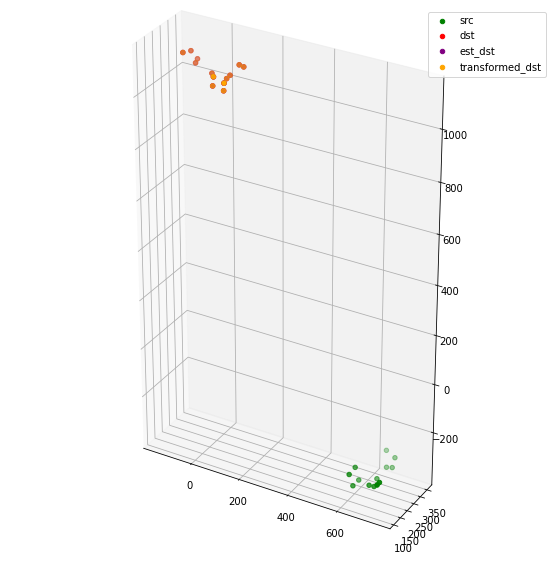

[[ 2.53928448e+01 -1.71299058e+01  3.95696569e+01 -8.99900996e-01
   9.24466519e+00  7.33899780e+00 -5.06011143e+01 -1.14357579e+02
  -1.18351906e+02 -1.38934852e+02 -1.45563326e+02  4.94360224e+01
   3.21385862e+01]
 [ 2.71423920e+02  2.69932608e+02  2.51885960e+02  2.50252562e+02
   3.41731566e+02  3.22081202e+02  3.21125179e+02  3.19206701e+02
   3.38673213e+02  3.30392282e+02  2.89166463e+02  3.66617484e+02
   3.65782016e+02]
 [ 9.99278844e+02  1.00815039e+03  1.03974584e+03  1.05475814e+03
   1.02418091e+03  1.01941034e+03  1.02660463e+03  1.05185550e+03
   1.05826680e+03  1.08771171e+03  1.09635619e+03  1.05478365e+03
   1.05884083e+03]]
[[ 2.53928448e+01 -1.71299058e+01  3.95696569e+01 -8.99900996e-01
   9.24466519e+00  7.33899780e+00 -5.06011143e+01 -1.14357579e+02
  -1.18351906e+02 -1.38934852e+02 -1.45563326e+02  4.94360224e+01
   3.21385862e+01]
 [ 2.71423920e+02  2.69932608e+02  2.51885960e+02  2.50252562e+02
   3.41731566e+02  3.22081202e+02  3.21125179e+02  3.19206701e+02

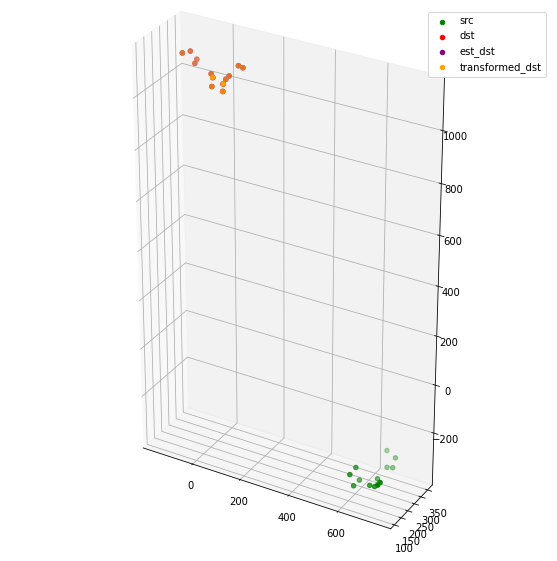

[[  54.50898288   12.46822849   70.71789278   31.02221612   39.15613917
    37.14024154  -20.38328927  -82.8479512   -86.64572538 -105.74912192
  -111.71448834   80.61692058   63.53832293]
 [ 284.92385563  283.27295096  265.80079571  264.07008671  355.34624395
   335.64676935  334.43258792  332.37406493  351.87094579  343.72204919
   302.53370241  380.70568783  379.80903621]
 [ 994.29219223 1005.19917146 1034.19045179 1051.13389235 1019.37244304
  1014.85651754 1024.82133307 1053.10741359 1059.54581105 1090.00709887
  1099.28968006 1047.81685041 1052.70331417]]
[[  54.50898288   12.46822849   70.71789278   31.02221612   39.15613917
    37.14024154  -20.38328927  -82.8479512   -86.64572538 -105.74912192
  -111.71448834   80.61692058   63.53832293]
 [ 284.92385563  283.27295096  265.80079571  264.07008671  355.34624395
   335.64676935  334.43258792  332.37406493  351.87094579  343.72204919
   302.53370241  380.70568783  379.80903621]
 [ 994.29219223 1005.19917146 1034.19045179 1051.13389

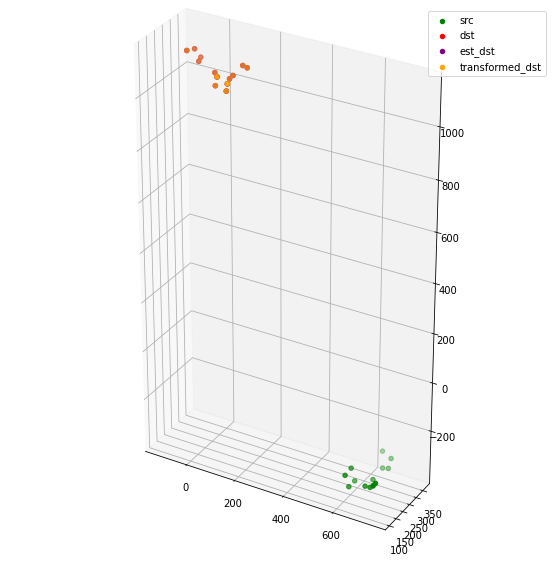

[[  46.89382497    5.00489663   63.81905184   24.34292133   30.80362374
    29.02276524  -28.36313296  -90.47391798  -94.48151332 -113.1260568
  -118.39201315   72.20640292   55.19780378]
 [ 287.63567224  285.40513419  268.84681407  266.58518573  357.89072561
   338.15315102  336.13354521  333.24350171  352.69934422  344.35066071
   303.10350285  383.91579634  382.78482118]
 [ 988.79586433 1000.17369778 1028.5552255  1045.94322233 1013.88320112
  1009.43534562 1020.04233677 1049.02633049 1055.46168484 1086.15231554
  1095.59548733 1041.80608903 1046.88432301]]
[[  46.89382497    5.00489663   63.81905184   24.34292133   30.80362374
    29.02276524  -28.36313296  -90.47391798  -94.48151332 -113.1260568
  -118.39201315   72.20640292   55.19780378]
 [ 287.63567224  285.40513419  268.84681407  266.58518573  357.89072561
   338.15315102  336.13354521  333.24350171  352.69934422  344.35066071
   303.10350285  383.91579634  382.78482118]
 [ 988.79586433 1000.17369778 1028.5552255  1045.9432223

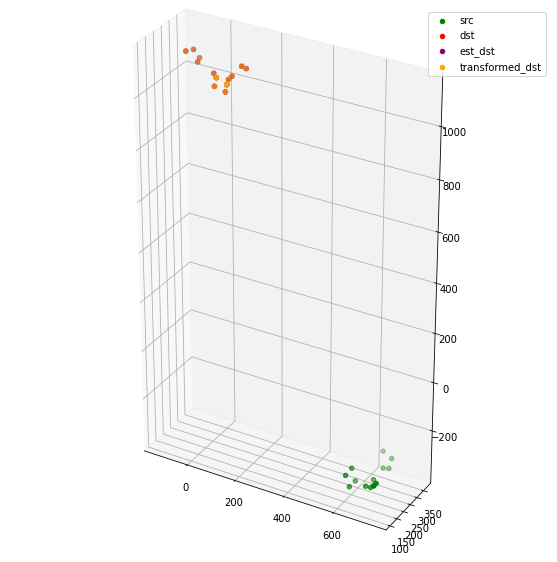

[[  76.52006528   35.25257914   95.60186601   57.02556977   60.42702222
    58.7762639     1.99137266  -58.63901584  -62.67188368  -79.71720667
   -83.83375575  102.64069082   85.90967382]
 [ 275.70040274  272.62284545  256.81150147  253.68460954  345.40717142
   325.68720768  322.55712085  318.28919506  337.60619735  328.62416889
   287.19825566  371.8704831   370.39101785]
 [ 981.69288595  994.98333141 1020.41478655 1039.59587601 1008.26395919
  1003.68960097 1016.9337342  1048.74434027 1055.57030641 1087.0030037
  1096.2322809  1034.51050979 1040.36236952]]
[[  76.52006528   35.25257914   95.60186601   57.02556977   60.42702222
    58.7762639     1.99137266  -58.63901584  -62.67188368  -79.71720667
   -83.83375575  102.64069082   85.90967382]
 [ 275.70040274  272.62284545  256.81150147  253.68460954  345.40717142
   325.68720768  322.55712085  318.28919506  337.60619735  328.62416889
   287.19825566  371.8704831   370.39101785]
 [ 981.69288595  994.98333141 1020.41478655 1039.595876

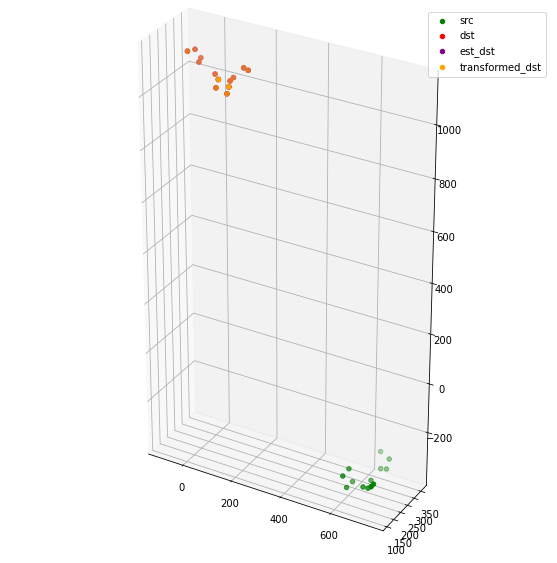

[[  82.42375532   41.3708141   102.13664241   63.86449979   66.57926008
    64.90379119    8.33470215  -51.79375168  -55.7659864   -72.30959704
   -76.19074012  109.1279279    92.49148808]
 [ 257.79765148  254.37614942  238.26331712  234.69328632  326.97347646
   307.33492742  303.82219567  298.82772709  318.00835796  308.41843733
   266.8227119   353.06741948  351.44020167]
 [ 980.53012268  994.38876809 1018.61034275 1038.31618595 1008.59609453
  1003.69232844 1017.73965066 1050.38621531 1057.62010532 1089.14115701
  1097.68306399 1034.6709695  1040.74888381]]
[[  82.42375532   41.3708141   102.13664241   63.86449979   66.57926008
    64.90379119    8.33470215  -51.79375168  -55.7659864   -72.30959704
   -76.19074012  109.1279279    92.49148808]
 [ 257.79765148  254.37614942  238.26331712  234.69328632  326.97347646
   307.33492742  303.82219567  298.82772709  318.00835796  308.41843733
   266.8227119   353.06741948  351.44020167]
 [ 980.53012268  994.38876809 1018.61034275 1038.31618

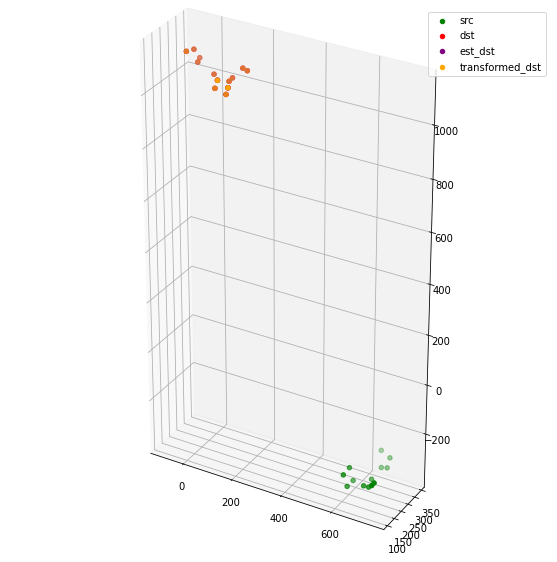

[[  83.76893265   42.85968737  103.7982295    65.73709333   68.70866108
    66.84702662   10.42464632  -49.34849432  -53.10974642  -69.34531679
   -73.39887829  111.73030722   95.15593298]
 [ 242.34710891  238.94470984  222.02488275  218.35404492  311.12079088
   291.58205357  288.18374522  283.00128695  302.07732386  292.04291392
   250.32966248  336.48378735  334.85627619]
 [ 983.13554343  997.41735153 1020.63388591 1040.72610181 1012.58737624
  1007.36255205 1022.01502225 1055.27893127 1062.89222308 1094.43507017
  1102.29669306 1038.60733921 1044.85244414]]
[[  83.76893265   42.85968737  103.7982295    65.73709333   68.70866108
    66.84702662   10.42464632  -49.34849432  -53.10974642  -69.34531679
   -73.39887829  111.73030722   95.15593298]
 [ 242.34710891  238.94470984  222.02488275  218.35404492  311.12079088
   291.58205357  288.18374522  283.00128695  302.07732386  292.04291392
   250.32966248  336.48378735  334.85627619]
 [ 983.13554343  997.41735153 1020.63388591 1040.72610

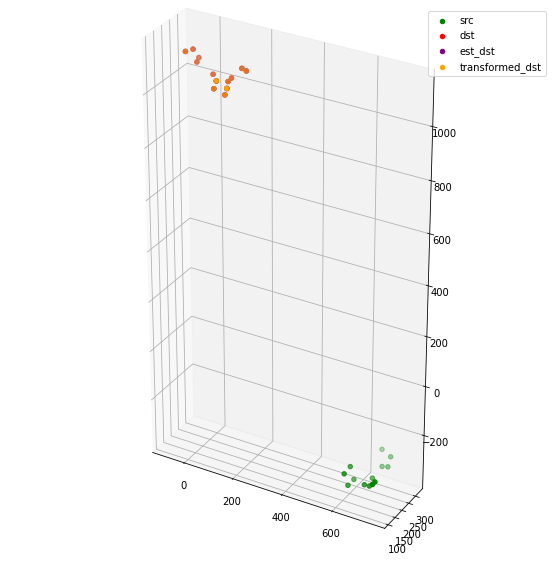

[[  51.77621415   10.50280624   70.51605837   31.95907611   37.71878704
    35.5083365   -21.27816364  -81.85272644  -85.3241719  -102.4610172
  -107.66474182   80.76243763   64.02486051]
 [ 269.28798878  267.27199843  249.69205344  247.52386061  339.2746377
   319.63017969  317.98558564  315.21589286  334.60148462  325.93138148
   284.58774636  364.44415188  363.39285127]
 [ 972.82124266  986.29545114 1011.35835274 1030.70984714  999.80826333
   995.1460853  1008.64857003 1040.73010681 1047.66929353 1079.13979043
  1088.1872711  1025.97927401 1031.90449882]]
[[  51.77621415   10.50280624   70.51605837   31.95907611   37.71878704
    35.5083365   -21.27816364  -81.85272644  -85.3241719  -102.4610172
  -107.66474182   80.76243763   64.02486051]
 [ 269.28798878  267.27199843  249.69205344  247.52386061  339.2746377
   319.63017969  317.98558564  315.21589286  334.60148462  325.93138148
   284.58774636  364.44415188  363.39285127]
 [ 972.82124266  986.29545114 1011.35835274 1030.70984714 

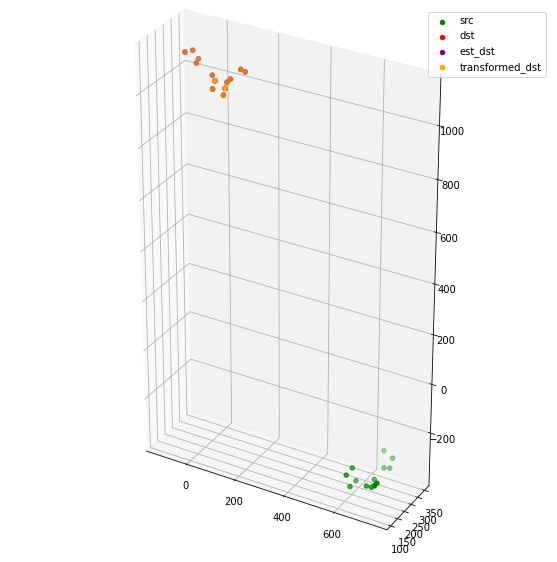

[[  77.35359357   36.84615062   98.46689981   60.95704582   62.60896223
    60.74023888    4.7345297   -54.13282927  -57.82090608  -73.17863375
   -76.76050668  106.11812621   89.71989391]
 [ 260.61956115  257.23353891  241.10495217  237.57357298  329.82770674
   310.18612236  306.71813141  301.78577323  320.97466841  311.42035729
   269.83394827  355.91808745  354.30562709]
 [ 964.49165719  979.87978997 1001.82394393 1022.95123652  993.07259488
   988.25152004 1004.40893195 1039.28700168 1046.64830627 1078.7744587
  1087.49068447 1017.51491032 1024.21251876]]
[[  77.35359357   36.84615062   98.46689981   60.95704582   62.60896223
    60.74023888    4.7345297   -54.13282927  -57.82090608  -73.17863375
   -76.76050668  106.11812621   89.71989391]
 [ 260.61956115  257.23353891  241.10495217  237.57357298  329.82770674
   310.18612236  306.71813141  301.78577323  320.97466841  311.42035729
   269.83394827  355.91808745  354.30562709]
 [ 964.49165719  979.87978997 1001.82394393 1022.951236

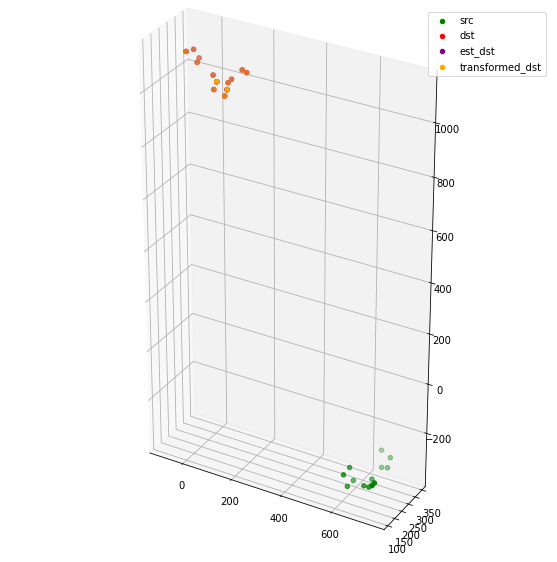

[[ 134.23533676   94.87398007  157.71634293  121.74579321  122.22411017
   119.82540428   65.05775385    8.73288662    5.7622147    -7.40134733
   -10.78011642  167.59844306  151.69455715]
 [ 270.71756187  267.93311896  251.37517028  248.47419614  340.38147194
   320.7109382   318.02000775  314.09527011  333.40021272  324.35512517
   282.9050481   366.25973603  364.89582436]
 [ 949.17692738  967.39897964  985.16033375 1008.89904009  977.92952095
   973.47496836  993.54962256 1032.51473033 1039.8970547  1073.12567725
  1082.54410871  998.96918499 1006.81559615]]
[[ 134.23533676   94.87398007  157.71634293  121.74579321  122.22411017
   119.82540428   65.05775385    8.73288662    5.7622147    -7.40134733
   -10.78011642  167.59844306  151.69455715]
 [ 270.71756187  267.93311896  251.37517028  248.47419614  340.38147194
   320.7109382   318.02000775  314.09527011  333.40021272  324.35512517
   282.9050481   366.25973603  364.89582436]
 [ 949.17692738  967.39897964  985.16033375 1008.89904

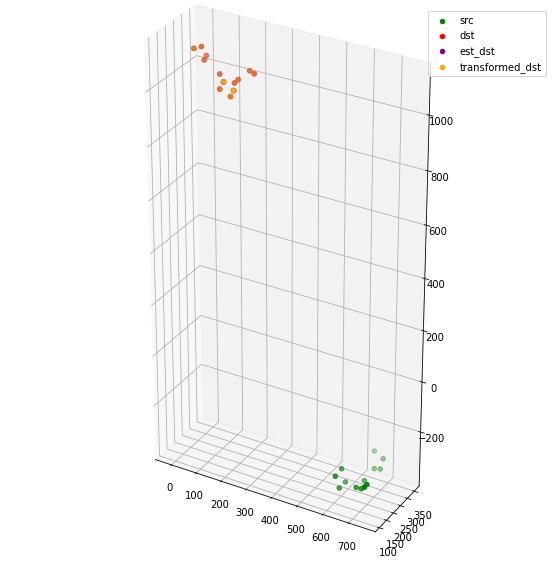

[[ 136.19579964   96.94235186  159.44156781  123.62555325  126.47865078
   123.46912653   68.8365668    12.7883601    10.44777258   -2.66124061
    -7.1520943   172.77889459  156.91620758]
 [ 305.8824918   305.00876658  287.36011715  286.49806202  376.99579312
   357.23713116  356.98546106  356.32658772  375.99852265  368.7222595
   327.81307666  402.3769267   401.80530323]
 [ 932.04071652  950.68250166  968.60363758  992.73436982  957.97364849
   954.35912672  974.97340481 1014.52512121 1021.12368471 1054.80519444
  1065.96327731  977.55086947  985.57635495]]
[[ 136.19579964   96.94235186  159.44156781  123.62555325  126.47865078
   123.46912653   68.8365668    12.7883601    10.44777258   -2.66124061
    -7.1520943   172.77889459  156.91620758]
 [ 305.8824918   305.00876658  287.36011715  286.49806202  376.99579312
   357.23713116  356.98546106  356.32658772  375.99852265  368.7222595
   327.81307666  402.3769267   401.80530323]
 [ 932.04071652  950.68250166  968.60363758  992.7343698

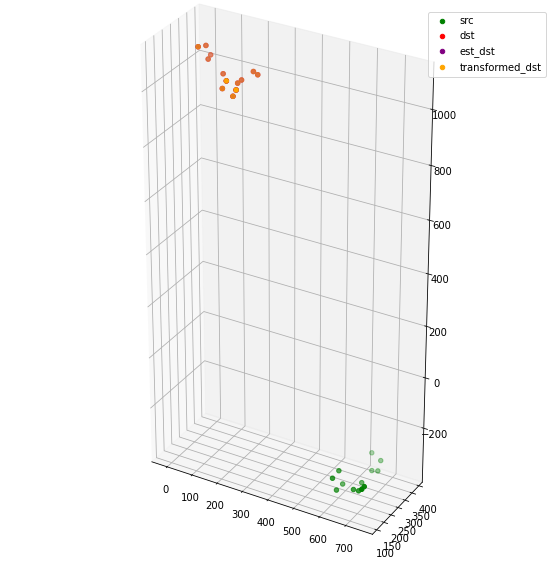

[[ 149.50629514  110.74787971  173.5746704   138.39579597  140.94320054
   137.70882967   83.63251436   28.63267655   26.59619199   14.32266378
     9.85225054  187.90669763  172.25544933]
 [ 316.33934086  316.02839857  298.21538695  297.97589921  387.90828476
   368.11833005  368.5681562   368.91084365  388.69755981  382.03069972
   341.32992136  413.2586827   412.92205326]
 [ 920.82286611  940.49012977  957.05167929  982.11583131  945.8947876
   942.66627961  964.69530957 1005.69621523 1012.04782984 1046.16744022
  1058.07096355  963.86613608  972.3091875 ]]
[[ 149.50629514  110.74787971  173.5746704   138.39579597  140.94320054
   137.70882967   83.63251436   28.63267655   26.59619199   14.32266378
     9.85225054  187.90669763  172.25544933]
 [ 316.33934086  316.02839857  298.21538695  297.97589921  387.90828476
   368.11833005  368.5681562   368.91084365  388.69755981  382.03069972
   341.32992136  413.2586827   412.92205326]
 [ 920.82286611  940.49012977  957.05167929  982.115831

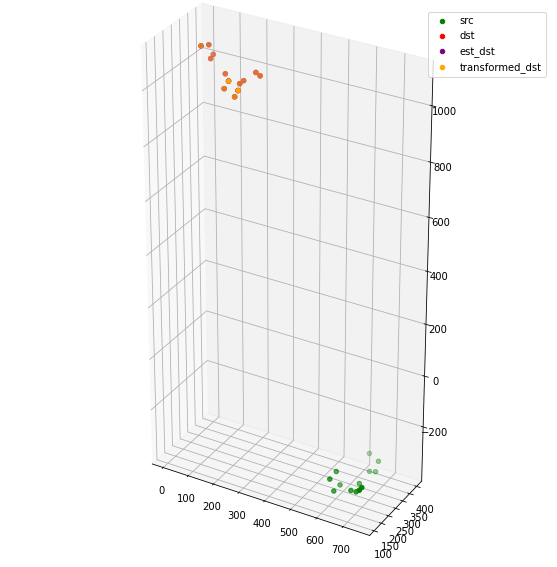

[[ 133.50066754   94.67002422  157.22348117  121.95332622  125.6844162
   122.23048509   68.08340644   12.94265023   11.11472978   -1.35991801
    -6.34946413  172.87565142  157.19094521]
 [ 341.57371234  342.35323724  324.36399725  325.34957451  414.01685383
   394.17086836  395.96506529  398.28183782  418.2874893   412.87984998
   372.64356628  439.39476698  439.51496023]
 [ 911.32360022  930.83478142  948.22001084  973.13721541  934.01586838
   931.42088345  953.20627104  993.95309213  999.64844371 1033.91759792
  1047.12281372  951.34015602  959.72678552]]
[[ 133.50066754   94.67002422  157.22348117  121.95332622  125.6844162
   122.23048509   68.08340644   12.94265023   11.11472978   -1.35991801
    -6.34946413  172.87565142  157.19094521]
 [ 341.57371234  342.35323724  324.36399725  325.34957451  414.01685383
   394.17086836  395.96506529  398.28183782  418.2874893   412.87984998
   372.64356628  439.39476698  439.51496023]
 [ 911.32360022  930.83478142  948.22001084  973.1372154

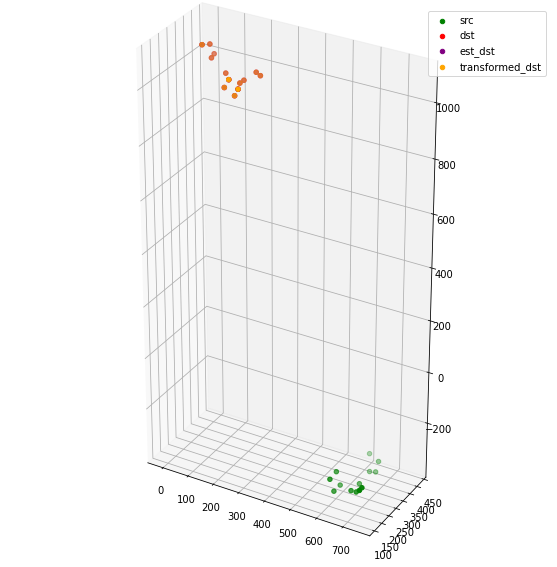

[[ 116.22294273   77.27311076  139.66809048  104.24536424  108.45873015
   104.96799458   50.69055831   -4.6978671    -6.50784717  -19.21127206
   -24.39111684  155.60833356  139.87179702]
 [ 331.3781671   332.14756951  313.88599461  314.81977641  403.70664878
   383.88582201  385.69798629  387.9231593   407.89963131  402.32309197
   362.02302937  428.85336718  428.9664829 ]
 [ 913.00946215  932.2820157   949.95049957  974.65233745  936.08215833
   933.34787272  954.80490778  995.21956842 1001.02206374 1035.17992572
  1048.11460715  953.85121998  962.14028702]]
[[ 116.22294273   77.27311076  139.66809048  104.24536424  108.45873015
   104.96799458   50.69055831   -4.6978671    -6.50784717  -19.21127206
   -24.39111684  155.60833356  139.87179702]
 [ 331.3781671   332.14756951  313.88599461  314.81977641  403.70664878
   383.88582201  385.69798629  387.9231593   407.89963131  402.32309197
   362.02302937  428.85336718  428.9664829 ]
 [ 913.00946215  932.2820157   949.95049957  974.65233

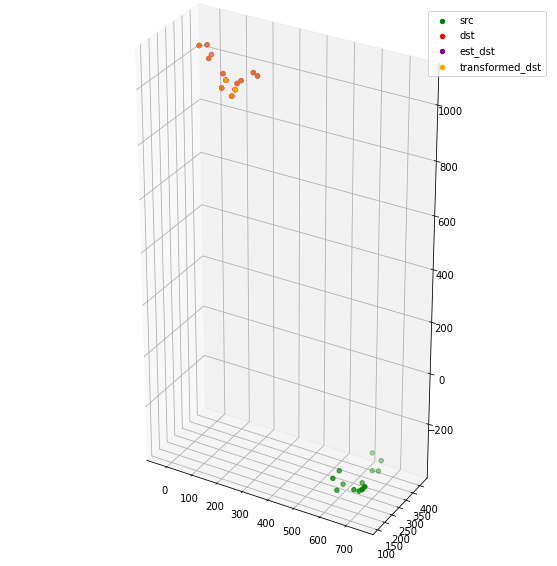

[[ 103.55211739   64.55035739  126.88174398   91.39235886   95.78426142
    92.28473093   37.95031054  -17.54661276  -19.35604132  -32.15743445
   -37.40575876  142.90573151  127.14667775]
 [ 316.0295428   316.73692562  298.3367915   299.17897252  388.2504309
   368.44617803  370.19839559  372.27154827  392.2208206   386.48739932
   346.12871099  413.27029233  413.35588801]
 [ 913.22296906  932.39260751  950.14161437  974.75089213  936.6290645
   933.78801175  955.10534921  995.37900562 1001.27450524 1035.36976216
  1048.09230866  954.65004367  962.8965525 ]]
[[ 103.55211739   64.55035739  126.88174398   91.39235886   95.78426142
    92.28473093   37.95031054  -17.54661276  -19.35604132  -32.15743445
   -37.40575876  142.90573151  127.14667775]
 [ 316.0295428   316.73692562  298.3367915   299.17897252  388.2504309
   368.44617803  370.19839559  372.27154827  392.2208206   386.48739932
   346.12871099  413.27029233  413.35588801]
 [ 913.22296906  932.39260751  950.14161437  974.75089213

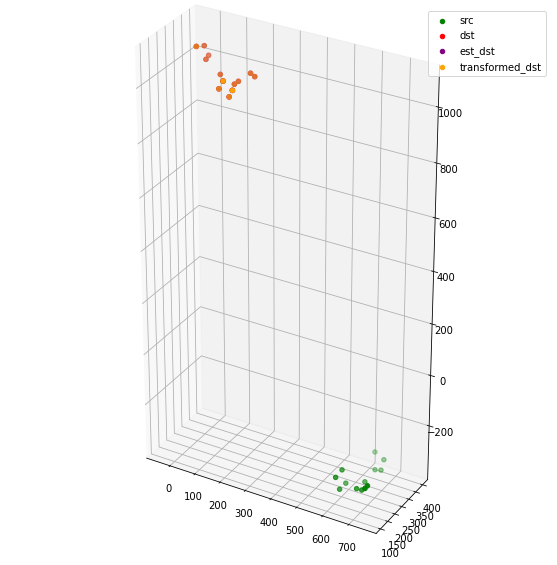

[[ 100.50823012   61.58503225  123.85156015   88.46209833   93.33849981
    89.6886292    35.44873657  -19.87983952  -21.52621109  -34.23901442
   -39.7239316   140.70298402  124.9761508 ]
 [ 303.92503563  304.88399887  286.02315204  287.08550092  376.17026399
   356.39466342  358.50392513  360.91916174  380.87348241  375.18883643
   334.85265186  400.8352165   401.02185932]
 [ 910.61090901  929.92871864  947.41991341  972.16419929  934.13246326
   931.28100872  952.80572577  993.29139186  999.21751718 1033.35406302
  1046.04814508  952.00500795  960.31114371]]
[[ 100.50823012   61.58503225  123.85156015   88.46209833   93.33849981
    89.6886292    35.44873657  -19.87983952  -21.52621109  -34.23901442
   -39.7239316   140.70298402  124.9761508 ]
 [ 303.92503563  304.88399887  286.02315204  287.08550092  376.17026399
   356.39466342  358.50392513  360.91916174  380.87348241  375.18883643
   334.85265186  400.8352165   401.02185932]
 [ 910.61090901  929.92871864  947.41991341  972.16419

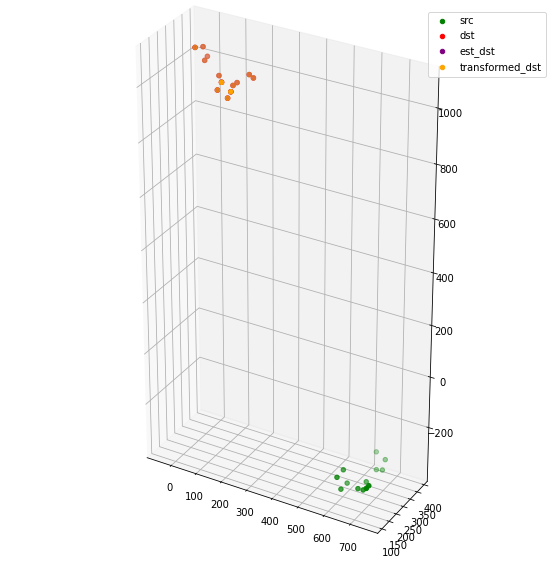

[[  95.27390581   56.39780962  118.34909953   83.01488505   89.39136151
    85.39455532   31.22689484  -23.9999057   -25.29152785  -38.05793554
   -44.22730771  137.20021482  121.48955629]
 [ 313.80951984  315.70637534  296.00244387  298.01438839  386.47943423
   366.7336729   370.07690615  374.00086682  394.05897499  389.05763931
   348.99800625  410.55525086  411.12765425]
 [ 901.76728909  921.11060307  938.7907246   963.55496582  924.31769449
   921.73754407  943.28785104  983.79435539  989.45195406 1023.67533505
  1036.91906818  941.80628217  950.12539106]]
[[  95.27390581   56.39780962  118.34909953   83.01488505   89.39136151
    85.39455532   31.22689484  -23.9999057   -25.29152785  -38.05793554
   -44.22730771  137.20021482  121.48955629]
 [ 313.80951984  315.70637534  296.00244387  298.01438839  386.47943423
   366.7336729   370.07690615  374.00086682  394.05897499  389.05763931
   348.99800625  410.55525086  411.12765425]
 [ 901.76728909  921.11060307  938.7907246   963.55496

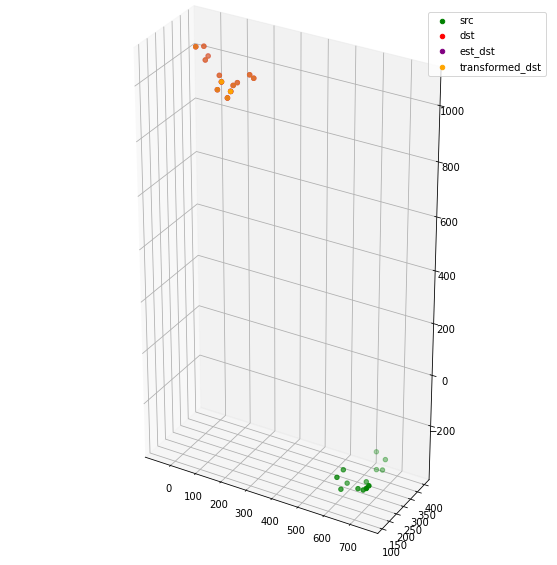

[[  96.88615043   58.63355776  121.94152296   87.40188871   88.60108651
    85.3842672    31.87405824  -22.08452082  -24.05874733  -35.44249648
   -39.41390714  135.87411286  120.44068893]
 [ 340.45583644  341.05176668  324.36892018  325.33580151  413.22487803
   393.27987631  394.70618912  397.03037315  417.11924231  412.23103849
   372.20458338  439.662333    439.71884098]
 [ 880.68700562  901.31457778  917.20728395  943.12833878  902.13615172
   900.04433294  923.37567559  965.67512917  971.01780447 1005.74171625
  1019.89595976  917.54731827  926.38848575]]
[[  96.88615043   58.63355776  121.94152296   87.40188871   88.60108651
    85.3842672    31.87405824  -22.08452082  -24.05874733  -35.44249648
   -39.41390714  135.87411286  120.44068893]
 [ 340.45583644  341.05176668  324.36892018  325.33580151  413.22487803
   393.27987631  394.70618912  397.03037315  417.11924231  412.23103849
   372.20458338  439.662333    439.71884098]
 [ 880.68700562  901.31457778  917.20728395  943.12833

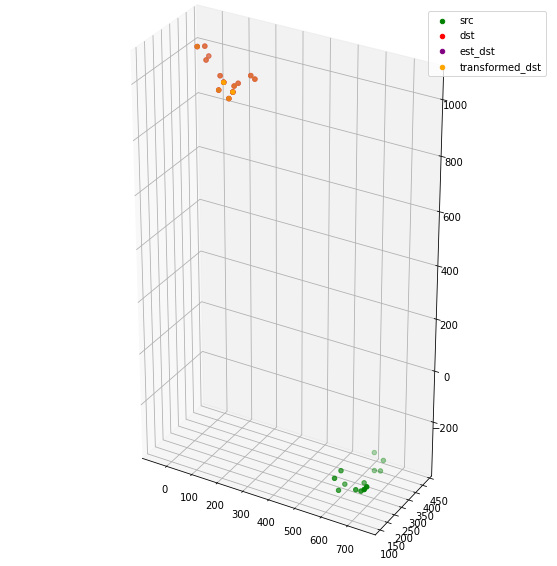

[[ 82.2391054   44.18587258 107.82720115  73.534194    73.35863797
   70.34265628  17.0507235  -36.51392633 -38.65821662 -49.6468938
  -53.03600099 120.48438547 105.13850748]
 [357.96996181 358.58339031 342.92738256 344.06326191 431.07932291
  411.06097689 412.39551828 415.02141912 435.19547997 430.91461896
  391.15364823 458.34711958 458.42164039]
 [858.75568396 879.74825143 895.35160534 921.59130267 878.76068797
  877.1186152  900.94963032 943.72937776 948.67040015 983.60115355
  998.6281619  893.14169239 902.13382703]]
[[ 82.2391054   44.18587258 107.82720115  73.534194    73.35863797
   70.34265628  17.0507235  -36.51392633 -38.65821662 -49.6468938
  -53.03600099 120.48438547 105.13850748]
 [357.96996181 358.58339031 342.92738256 344.06326191 431.07932291
  411.06097689 412.39551828 415.02141912 435.19547997 430.91461896
  391.15364823 458.34711958 458.42164039]
 [858.75568396 879.74825143 895.35160534 921.59130267 878.76068797
  877.1186152  900.94963032 943.72937776 948.67040015 

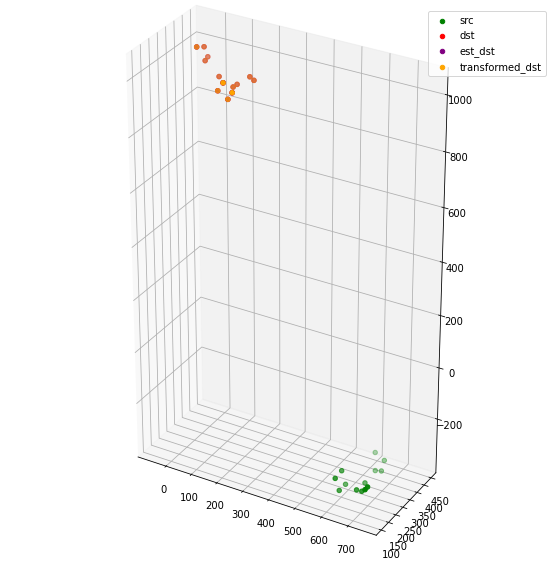

[[ 87.70949481  50.1899828  114.23689818  80.60599341  79.15939315
   76.15025989  23.46588376 -29.02185669 -31.08951767 -41.19410361
  -44.11459029 126.56502062 111.44790247]
 [350.2758813  350.57812489 334.93000696 335.71130557 423.15572375
  403.1472743  404.10235377 406.15620215 426.27358603 421.61087686
  381.69117656 450.39862528 450.34233438]
 [849.57755696 871.51628023 885.36990681 912.46555395 870.5409988
  868.7707463  893.93366974 938.0584096  943.25649174 978.40461853
  993.10564253 884.02109154 893.39283525]]
[[ 87.70949481  50.1899828  114.23689818  80.60599341  79.15939315
   76.15025989  23.46588376 -29.02185669 -31.08951767 -41.19410361
  -44.11459029 126.56502062 111.44790247]
 [350.2758813  350.57812489 334.93000696 335.71130557 423.15572375
  403.1472743  404.10235377 406.15620215 426.27358603 421.61087686
  381.69117656 450.39862528 450.34233438]
 [849.57755696 871.51628023 885.36990681 912.46555395 870.5409988
  868.7707463  893.93366974 938.0584096  943.25649174 

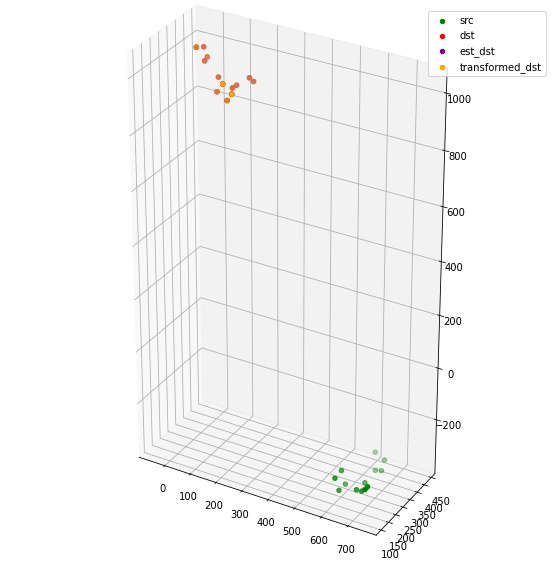

[[ 69.52098038  32.16041511  96.68653203  63.23678578  59.23187012
   56.72993375   4.21557419 -47.99822574 -50.55013091 -60.28470729
  -62.06699946 106.00864685  90.9639037 ]
 [349.82016757 349.0634413  335.02808939 334.83100956 422.37135629
  402.29863892 401.78855872 402.30800066 422.34454735 417.28421055
  377.24513992 450.78203382 450.2970543 ]
 [845.53775664 867.73523938 881.08376237 908.41319544 866.85678085
  865.02564513 890.55426123 935.04721724 940.34145849 975.5389775
  990.09672728 880.12134499 889.59660268]]
[[ 69.52098038  32.16041511  96.68653203  63.23678578  59.23187012
   56.72993375   4.21557419 -47.99822574 -50.55013091 -60.28470729
  -62.06699946 106.00864685  90.9639037 ]
 [349.82016757 349.0634413  335.02808939 334.83100956 422.37135629
  402.29863892 401.78855872 402.30800066 422.34454735 417.28421055
  377.24513992 450.78203382 450.2970543 ]
 [845.53775664 867.73523938 881.08376237 908.41319544 866.85678085
  865.02564513 890.55426123 935.04721724 940.34145849

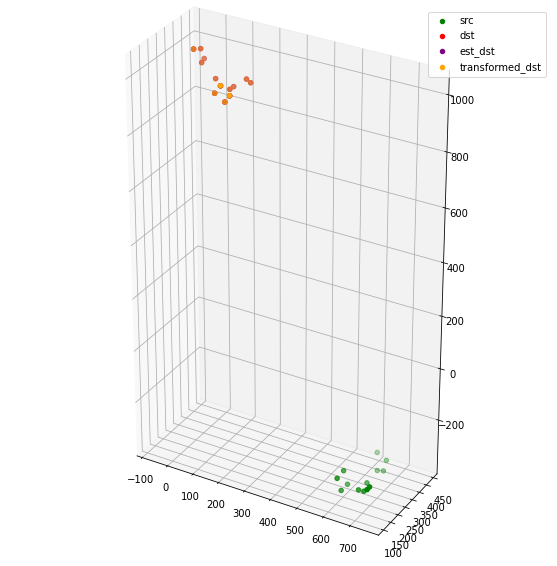

[[ 72.05505004  34.90530158  99.37204066  66.18967595  62.90848199
   60.13065658   7.86463011 -43.90334013 -46.14551255 -55.60194708
  -57.75801842 110.17383433  95.2168782 ]
 [348.24266252 347.94883505 333.07363731 333.28495476 420.90303654
  400.86565504 401.01075354 402.16614308 422.22959478 417.2665773
  377.24203887 448.69878925 448.39979739]
 [839.05674902 861.61606121 874.32676454 901.98012408 860.52421063
  858.70383853 884.74169183 929.74076062 935.07320683 970.3602956
  984.90744311 873.35248798 882.97330277]]
[[ 72.05505004  34.90530158  99.37204066  66.18967595  62.90848199
   60.13065658   7.86463011 -43.90334013 -46.14551255 -55.60194708
  -57.75801842 110.17383433  95.2168782 ]
 [348.24266252 347.94883505 333.07363731 333.28495476 420.90303654
  400.86565504 401.01075354 402.16614308 422.22959478 417.2665773
  377.24203887 448.69878925 448.39979739]
 [839.05674902 861.61606121 874.32676454 901.98012408 860.52421063
  858.70383853 884.74169183 929.74076062 935.07320683 9

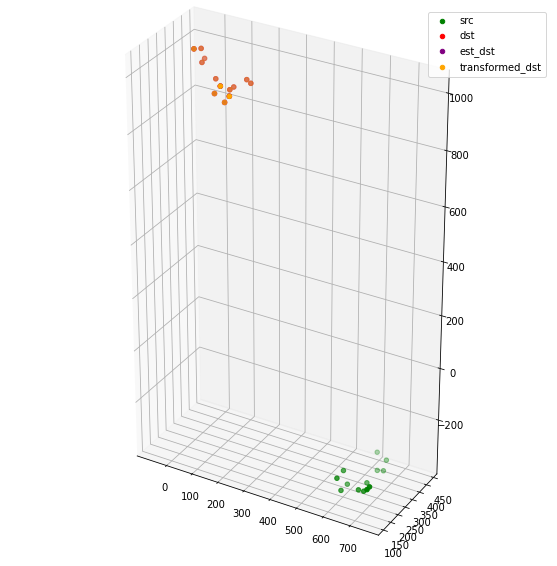

[[101.68814898  65.07835733 128.552064    96.03813322  98.23008722
   93.98146354  42.39975693  -8.22834587  -8.91262772 -17.98459682
  -22.71958222 147.62306607 132.88140827]
 [318.63517553 320.31830221 300.50972071 302.26135389 391.0892421
  371.36436432 374.45943198 377.95994421 397.96399074 392.63646186
  352.45109436 415.04727506 415.52869842]
 [842.51044416 865.87715021 876.71701157 905.10007629 866.22734982
  863.90245845 891.09577528 937.25544903 943.20307836 978.53792155
  991.9896119  878.7783815  888.71879229]]
[[101.68814898  65.07835733 128.552064    96.03813322  98.23008722
   93.98146354  42.39975693  -8.22834587  -8.91262772 -17.98459682
  -22.71958222 147.62306607 132.88140827]
 [318.63517553 320.31830221 300.50972071 302.26135389 391.0892421
  371.36436432 374.45943198 377.95994421 397.96399074 392.63646186
  352.45109436 415.04727506 415.52869842]
 [842.51044416 865.87715021 876.71701157 905.10007629 866.22734982
  863.90245845 891.09577528 937.25544903 943.20307836 

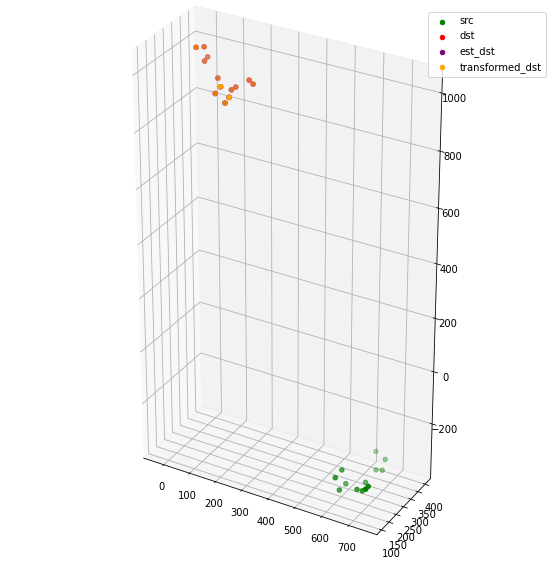

[[  89.24070596   52.52314113  115.93529494   83.29017071   85.70954567
    81.46159706   29.75515577  -21.08599532  -21.78765998  -31.0271924
   -35.84572726  135.05582156  120.26818531]
 [ 296.54124049  297.7251008   277.63997737  278.77779542  368.44994367
   348.78452882  351.30387103  353.80456688  373.6712781   367.56192393
   327.08923543  392.09108217  392.35965352]
 [ 850.41404023  873.64186017  884.33206595  912.59553196  875.72630764
   872.94186561  899.95714323  945.94733497  952.33684715  987.50133438
  1000.03030194  889.03884782  898.91881206]]
[[  89.24070596   52.52314113  115.93529494   83.29017071   85.70954567
    81.46159706   29.75515577  -21.08599532  -21.78765998  -31.0271924
   -35.84572726  135.05582156  120.26818531]
 [ 296.54124049  297.7251008   277.63997737  278.77779542  368.44994367
   348.78452882  351.30387103  353.80456688  373.6712781   367.56192393
   327.08923543  392.09108217  392.35965352]
 [ 850.41404023  873.64186017  884.33206595  912.5955319

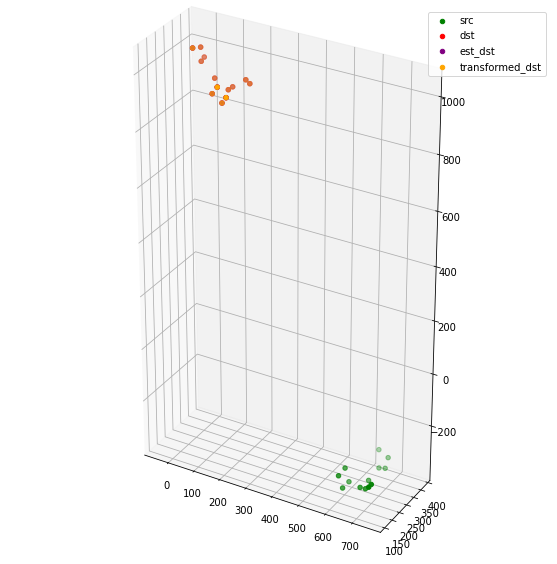

[[  89.708729     53.18158716  116.6389328    84.22451983   86.51972507
    82.21167582   30.7292138   -19.73535353  -20.34735483  -29.31539805
   -34.11084411  136.0169168   121.30979646]
 [ 261.27122841  261.63433346  241.05631074  241.17618264  332.17576688
   312.63675919  314.2152645   315.05540833  334.66710218  327.24587639
   286.33574536  355.21609618  355.13438404]
 [ 863.66558428  887.21868971  896.62635678  925.17655362  891.708734
   888.21665489  915.72652232  962.1893619   969.33158373 1004.31349246
  1015.3405817   905.50559368  915.50829053]]
[[  89.708729     53.18158716  116.6389328    84.22451983   86.51972507
    82.21167582   30.7292138   -19.73535353  -20.34735483  -29.31539805
   -34.11084411  136.0169168   121.30979646]
 [ 261.27122841  261.63433346  241.05631074  241.17618264  332.17576688
   312.63675919  314.2152645   315.05540833  334.66710218  327.24587639
   286.33574536  355.21609618  355.13438404]
 [ 863.66558428  887.21868971  896.62635678  925.1765536

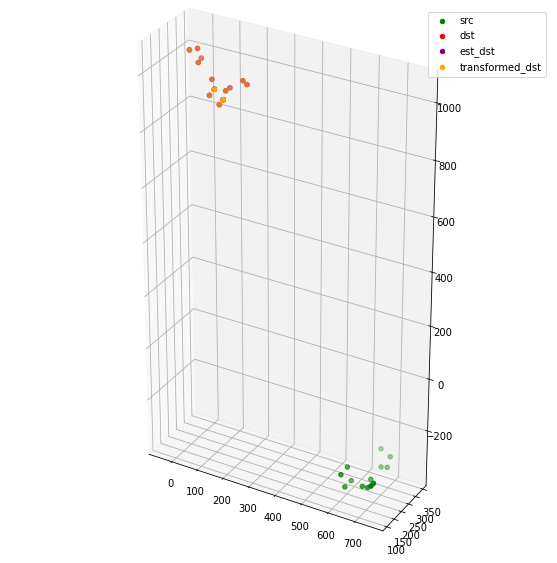

[[  80.5354834    44.07795149  107.66819703   75.33959802   77.06654484
    72.848466     21.44153265  -28.88673529  -29.57801667  -38.4025725
   -42.95456872  126.48596308  111.8096031 ]
 [ 249.82934766  249.70574816  229.33921354  228.93054788  320.35642142
   300.84106305  301.80534759  301.79712136  321.31357127  313.40459495
   272.33412123  343.47645601  343.19223781]
 [ 871.50302612  895.16620009  904.12604793  932.77071505  900.45021769
   896.72391595  924.40289245  971.02090653  978.41243727 1013.32389153
  1023.84659748  914.3917815   924.43586869]]
[[  80.5354834    44.07795149  107.66819703   75.33959802   77.06654484
    72.848466     21.44153265  -28.88673529  -29.57801667  -38.4025725
   -42.95456872  126.48596308  111.8096031 ]
 [ 249.82934766  249.70574816  229.33921354  228.93054788  320.35642142
   300.84106305  301.80534759  301.79712136  321.31357127  313.40459495
   272.33412123  343.47645601  343.19223781]
 [ 871.50302612  895.16620009  904.12604793  932.7707150

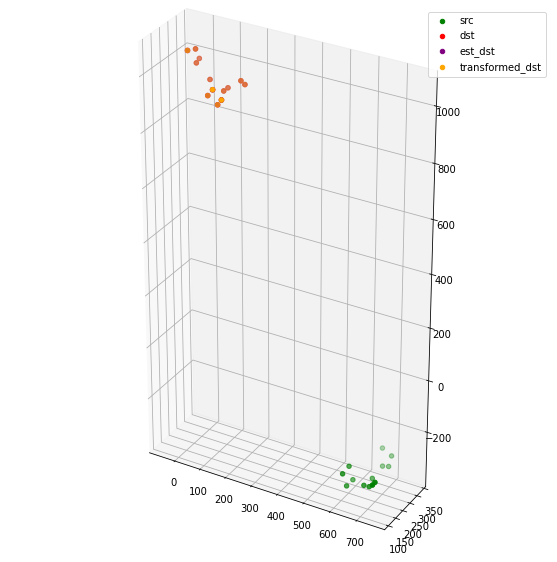

[[  75.36437748   38.99434755  102.56493291   70.34147417   72.18297125
    67.90121296   16.59955801  -33.55594028  -34.16994453  -42.8856356
   -47.50382111  121.71259033  107.07277023]
 [ 236.32767188  235.93775274  215.27900889  214.51843884  306.41769762
   286.97150159  287.64607617  287.05934211  306.46353003  298.04998272
   256.83670173  329.20061173  328.80137967]
 [ 877.86961371  901.66418445  910.07791803  938.83365688  907.89141435
   903.88657576  931.76871216  978.56887875  986.25685011 1021.07758074
  1030.99572842  921.99594408  932.08932265]]
[[  75.36437748   38.99434755  102.56493291   70.34147417   72.18297125
    67.90121296   16.59955801  -33.55594028  -34.16994453  -42.8856356
   -47.50382111  121.71259033  107.07277023]
 [ 236.32767188  235.93775274  215.27900889  214.51843884  306.41769762
   286.97150159  287.64607617  287.05934211  306.46353003  298.04998272
   256.83670173  329.20061173  328.80137967]
 [ 877.86961371  901.66418445  910.07791803  938.8336568

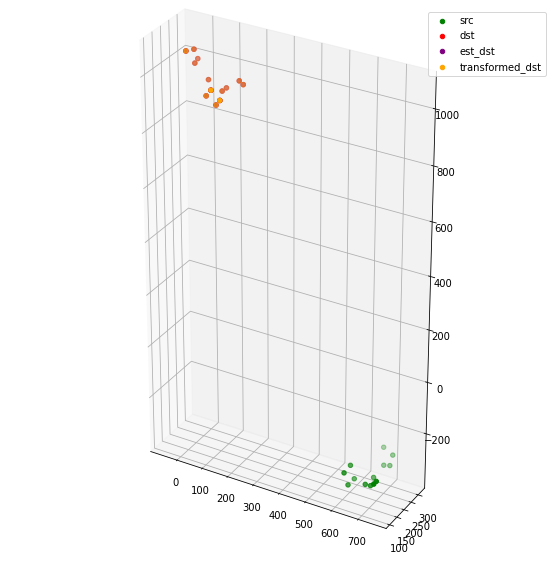

[[ 6.05299651e+01  2.39831052e+01  8.77175212e+01  5.52825439e+01
   5.63178770e+01  5.22889950e+01  7.68076714e-01 -4.97392990e+01
  -5.06338293e+01 -5.95232313e+01 -6.37487946e+01  1.05473932e+02
   9.07616904e+01]
 [ 2.27264626e+02  2.26209447e+02  2.06181691e+02  2.04749746e+02
   2.96989378e+02  2.77539946e+02  2.77336706e+02  2.75683086e+02
   2.94995827e+02  2.86112673e+02  2.44746193e+02  3.20178532e+02
   3.19506037e+02]
 [ 8.80932935e+02  9.04434559e+02  9.13129797e+02  9.41620920e+02
   9.11669866e+02  9.07425524e+02  9.34907920e+02  9.81302363e+02
   9.89190473e+02  1.02385028e+03  1.03329437e+03  9.26405111e+02
   9.36377959e+02]]
[[ 6.05299651e+01  2.39831052e+01  8.77175212e+01  5.52825439e+01
   5.63178770e+01  5.22889950e+01  7.68076714e-01 -4.97392990e+01
  -5.06338293e+01 -5.95232313e+01 -6.37487946e+01  1.05473932e+02
   9.07616904e+01]
 [ 2.27264626e+02  2.26209447e+02  2.06181691e+02  2.04749746e+02
   2.96989378e+02  2.77539946e+02  2.77336706e+02  2.75683086e+02

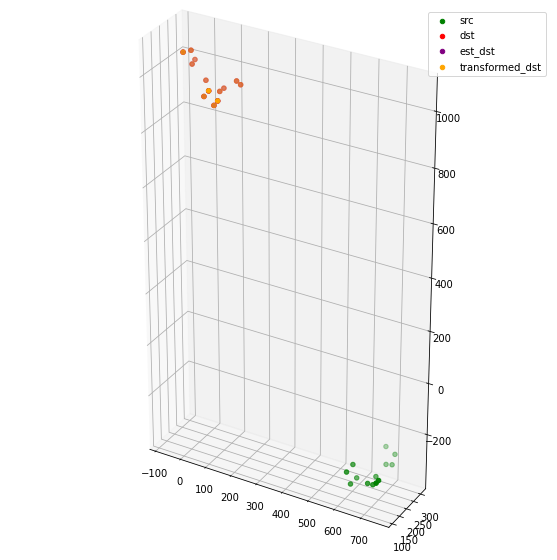

[[  41.98586628    5.29087075   69.28728955   36.67329997   36.37864613
    32.70811903  -19.00186088  -69.81251261  -71.08894183  -80.08132067
   -83.68061218   85.02919864   70.25773596]
 [ 229.34978907  227.77453853  208.8569816   206.99427915  299.11696981
   279.58558603  278.62626304  276.3099517   295.63650497  286.74464555
   245.35128177  323.18891692  322.30916105]
 [ 879.66651797  902.90675463  912.14679547  940.40772786  910.08265088
   905.88991851  932.99870046  979.03223424  986.83348292 1021.46448477
  1031.04917867  925.07755679  934.94619042]]
[[  41.98586628    5.29087075   69.28728955   36.67329997   36.37864613
    32.70811903  -19.00186088  -69.81251261  -71.08894183  -80.08132067
   -83.68061218   85.02919864   70.25773596]
 [ 229.34978907  227.77453853  208.8569816   206.99427915  299.11696981
   279.58558603  278.62626304  276.3099517   295.63650497  286.74464555
   245.35128177  323.18891692  322.30916105]
 [ 879.66651797  902.90675463  912.14679547  940.40772

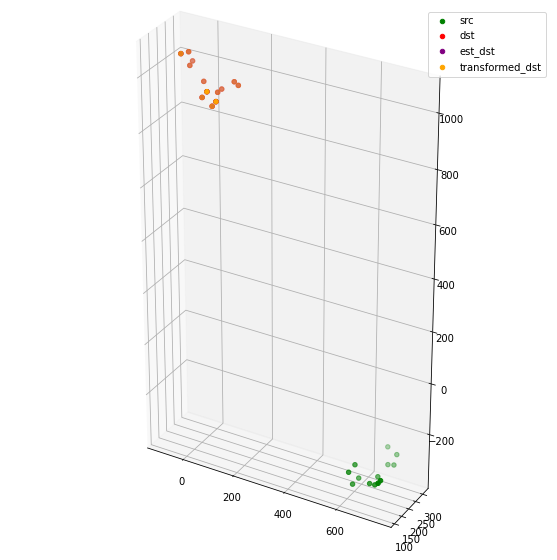

[[  39.82810293    3.31251434   67.38795493   34.99174958   34.41519296
    30.72342868  -20.77749921  -71.2338676   -72.46124683  -81.18404866
   -84.68742409   83.1656726    68.47048396]
 [ 248.09917151  246.95832471  228.24823994  226.91856759  318.43840968
   298.82824701  298.37192157  296.92463872  316.39771286  308.17261694
   266.97060941  342.81481044  342.11988054]
 [ 871.01789582  894.56408383  903.6780607   932.21821009  900.12345452
   896.3367511   923.85355641  970.31035484  977.74657281 1012.6105206
  1023.01978363  914.27845084  924.27487587]]
[[  39.82810293    3.31251434   67.38795493   34.99174958   34.41519296
    30.72342868  -20.77749921  -71.2338676   -72.46124683  -81.18404866
   -84.68742409   83.1656726    68.47048396]
 [ 248.09917151  246.95832471  228.24823994  226.91856759  318.43840968
   298.82824701  298.37192157  296.92463872  316.39771286  308.17261694
   266.97060941  342.81481044  342.11988054]
 [ 871.01789582  894.56408383  903.6780607   932.218210

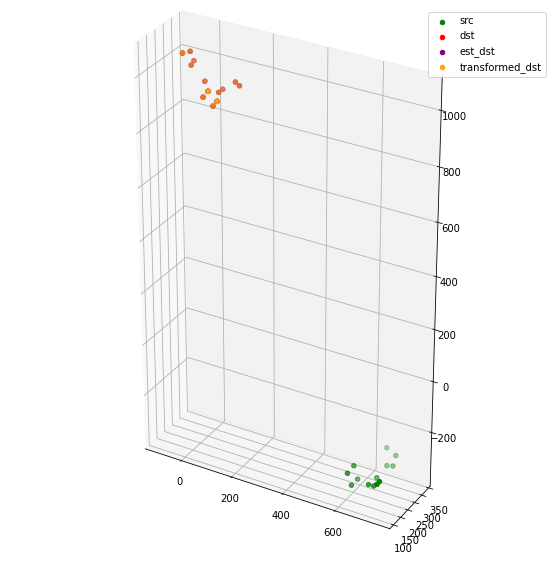

[[  32.32995534   -4.25036498   59.53695875   27.06184761   27.83548392
    23.8785452   -27.68489525  -78.259913    -79.23166977  -88.14617017
   -92.24802438   76.8901241    62.16443092]
 [ 272.53116518  272.41658915  253.02133265  252.77044191  343.56177119
   323.92638851  324.79197002  325.06875644  344.71579515  337.38132526
   296.47086174  367.56253903  367.29214166]
 [ 861.96617796  885.43913579  895.12393266  923.60421508  889.50695328
   886.14226766  913.53187807  959.88125593  966.88511006 1001.89898681
  1013.20122495  903.24695035  913.21895393]]
[[  32.32995534   -4.25036498   59.53695875   27.06184761   27.83548392
    23.8785452   -27.68489525  -78.259913    -79.23166977  -88.14617017
   -92.24802438   76.8901241    62.16443092]
 [ 272.53116518  272.41658915  253.02133265  252.77044191  343.56177119
   323.92638851  324.79197002  325.06875644  344.71579515  337.38132526
   296.47086174  367.56253903  367.29214166]
 [ 861.96617796  885.43913579  895.12393266  923.60421

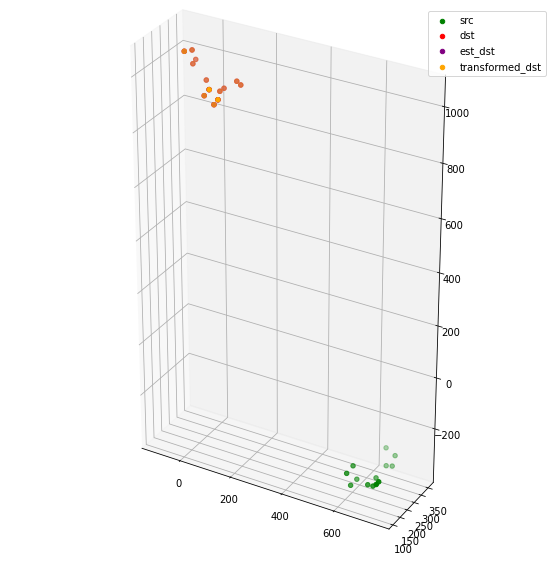

[[  16.04981278  -20.46462133   44.04207655   11.64224692    8.83815356
     5.64238627  -45.87628965  -96.35713614  -98.08155444 -106.65393106
  -109.14666906   56.94280184   42.25309885]
 [ 260.7167038   258.80820569  241.75649344  239.79207005  331.07363136
   311.35503046  309.78127136  307.35728684  326.83826427  318.60896928
   277.39604412  356.74267202  355.74203271]
 [ 863.87613359  887.37435582  896.69739026  925.19676495  892.54556476
   888.87261283  916.31487394  962.70433714  970.02023175 1004.92048094
  1015.57472318  906.62481425  916.60335908]]
[[  16.04981278  -20.46462133   44.04207655   11.64224692    8.83815356
     5.64238627  -45.87628965  -96.35713614  -98.08155444 -106.65393106
  -109.14666906   56.94280184   42.25309885]
 [ 260.7167038   258.80820569  241.75649344  239.79207005  331.07363136
   311.35503046  309.78127136  307.35728684  326.83826427  318.60896928
   277.39604412  356.74267202  355.74203271]
 [ 863.87613359  887.37435582  896.69739026  925.19676

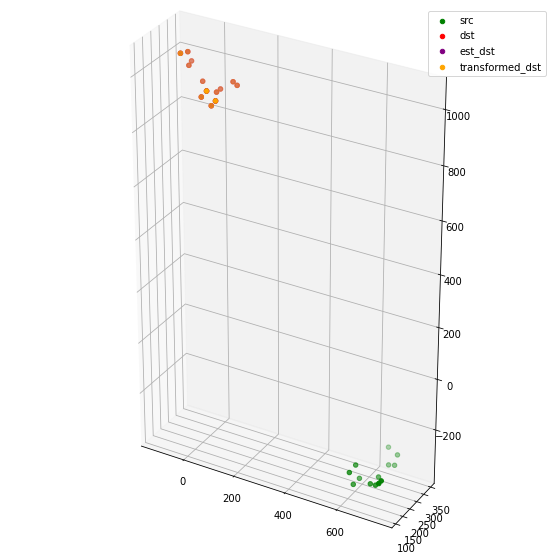

[[  -1.12608463  -37.79215004   26.91136101   -5.68020832   -9.73538358
   -12.57373463  -64.27885269 -115.08502343 -117.1914583  -125.90728518
  -127.80156206   37.82151918   23.07044328]
 [ 265.15528372  262.81615341  246.91209967  244.62331691  335.59659835
   315.80035523  313.57573745  310.66125541  330.16544134  322.05801066
   280.89082731  362.16882816  360.99894737]
 [ 861.38026875  884.60182831  894.56730198  922.82280337  889.45058639
   885.90386287  912.94753538  958.95202069  966.10422855 1000.99746944
  1011.94765442  903.71381546  913.58281483]]
[[  -1.12608463  -37.79215004   26.91136101   -5.68020832   -9.73538358
   -12.57373463  -64.27885269 -115.08502343 -117.1914583  -125.90728518
  -127.80156206   37.82151918   23.07044328]
 [ 265.15528372  262.81615341  246.91209967  244.62331691  335.59659835
   315.80035523  313.57573745  310.66125541  330.16544134  322.05801066
   280.89082731  362.16882816  360.99894737]
 [ 861.38026875  884.60182831  894.56730198  922.82280

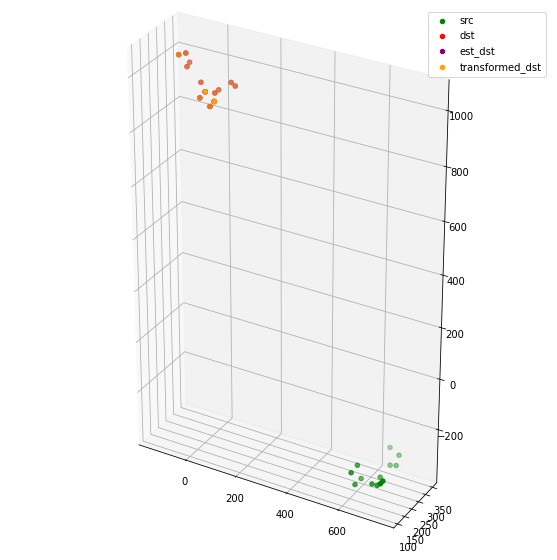

[[  -3.57888934  -40.03195977   24.91311948   -7.42621388  -12.70681317
   -15.36434258  -66.82589075 -117.230145   -119.48514673 -127.83652629
  -129.20904195   34.67930036   20.02052741]
 [ 272.41625769  269.88202778  254.73894898  252.3387827   342.98972101
   323.13657594  320.5902961   317.51806841  337.05670225  329.14279718
   288.04856706  370.17440613  368.93034559]
 [ 856.73399854  880.26831488  889.84003254  918.37473065  884.30407019
   880.94001092  908.41643537  954.8507592   961.86226181  996.88880741
  1008.18536762  897.96903413  907.96566851]]
[[  -3.57888934  -40.03195977   24.91311948   -7.42621388  -12.70681317
   -15.36434258  -66.82589075 -117.230145   -119.48514673 -127.83652629
  -129.20904195   34.67930036   20.02052741]
 [ 272.41625769  269.88202778  254.73894898  252.3387827   342.98972101
   323.13657594  320.5902961   317.51806841  337.05670225  329.14279718
   288.04856706  370.17440613  368.93034559]
 [ 856.73399854  880.26831488  889.84003254  918.37473

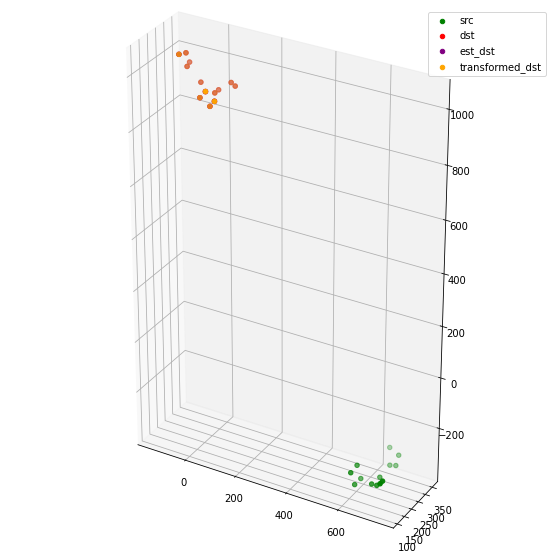

[[-1.93911918e-01 -3.64764043e+01  2.83720641e+01 -3.75406249e+00
  -8.30074687e+00 -1.12085405e+01 -6.24654473e+01 -1.12513622e+02
  -1.14491117e+02 -1.22639531e+02 -1.24378832e+02  3.94990202e+01
   2.49107440e+01]
 [ 2.56751808e+02  2.54198618e+02  2.38168618e+02  2.35614141e+02
   3.26915307e+02  3.07156401e+02  3.04686363e+02  3.01338271e+02
   3.20771556e+02  3.12322626e+02  2.71049809e+02  3.53324348e+02
   3.52063142e+02]
 [ 8.58811757e+02  8.82606183e+02  8.91353137e+02  9.20114377e+02
   8.87715117e+02  8.84019565e+02  9.11882745e+02  9.58681722e+02
   9.66060160e+02  1.00100946e+03  1.01158117e+03  9.01460185e+02
   9.11557292e+02]]
[[-1.93911918e-01 -3.64764043e+01  2.83720641e+01 -3.75406249e+00
  -8.30074687e+00 -1.12085405e+01 -6.24654473e+01 -1.12513622e+02
  -1.14491117e+02 -1.22639531e+02 -1.24378832e+02  3.94990202e+01
   2.49107440e+01]
 [ 2.56751808e+02  2.54198618e+02  2.38168618e+02  2.35614141e+02
   3.26915307e+02  3.07156401e+02  3.04686363e+02  3.01338271e+02

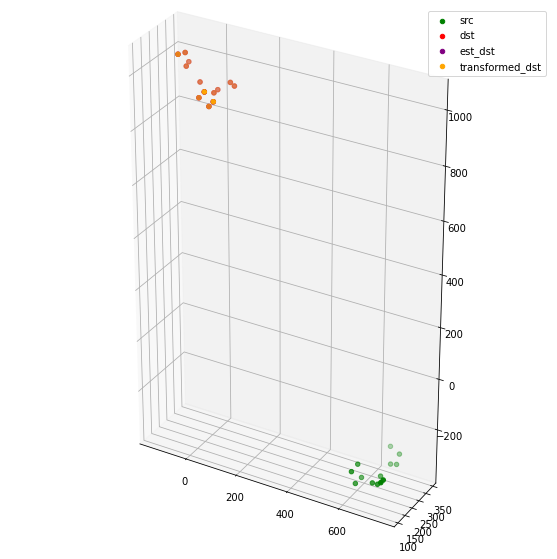

[[   7.52729046  -28.38082887   36.79658794    5.11347245   -1.13303311
    -3.82185786  -54.64580306 -103.98460562 -106.12421464 -113.66715216
  -114.69426488   46.48874304   32.06160642]
 [ 254.53753757  251.46018051  236.30893517  233.28135692  324.54962556
   304.75711664  301.55320694  297.46569361  316.86144251  308.26086901
   266.95576229  351.59424446  350.12168563]
 [ 857.11161302  881.40666501  889.22574661  918.42910669  886.22085379
   882.53934074  911.11187891  958.6002844   966.03206829 1001.08015753
  1011.61889648  899.33333353  909.63135807]]
[[   7.52729046  -28.38082887   36.79658794    5.11347245   -1.13303311
    -3.82185786  -54.64580306 -103.98460562 -106.12421464 -113.66715216
  -114.69426488   46.48874304   32.06160642]
 [ 254.53753757  251.46018051  236.30893517  233.28135692  324.54962556
   304.75711664  301.55320694  297.46569361  316.86144251  308.26086901
   266.95576229  351.59424446  350.12168563]
 [ 857.11161302  881.40666501  889.22574661  918.42910

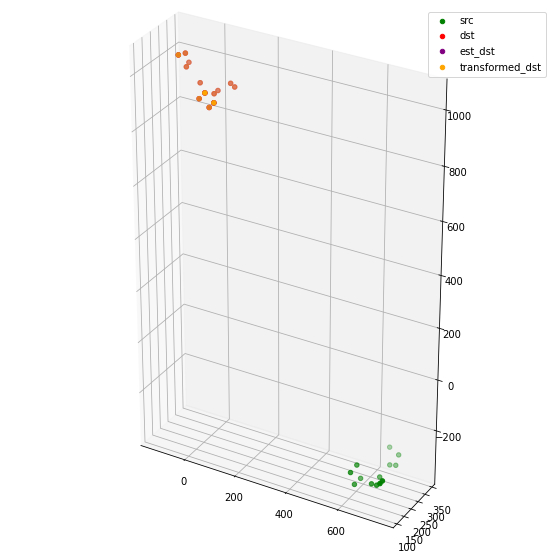

[[  -2.65325332  -38.62180713   26.80224942   -4.96934999  -12.86327615
   -15.13713848  -66.03860946 -115.53843203 -118.10404579 -125.66060256
  -125.91980723   34.13905714   19.68948868]
 [ 261.78834942  258.20079788  244.42263933  241.01111346  331.85867857
   311.98574019  308.00991966  303.34148009  322.75316711  314.30230715
   273.07616787  359.96055628  358.28763884]
 [ 854.51475561  878.64990264  886.93537817  915.99994834  882.9743054
   879.44973502  907.78631005  955.0530753   962.30624338  997.38780187
  1008.27679052  896.09860483  906.33439149]]
[[  -2.65325332  -38.62180713   26.80224942   -4.96934999  -12.86327615
   -15.13713848  -66.03860946 -115.53843203 -118.10404579 -125.66060256
  -125.91980723   34.13905714   19.68948868]
 [ 261.78834942  258.20079788  244.42263933  241.01111346  331.85867857
   311.98574019  308.00991966  303.34148009  322.75316711  314.30230715
   273.07616787  359.96055628  358.28763884]
 [ 854.51475561  878.64990264  886.93537817  915.999948

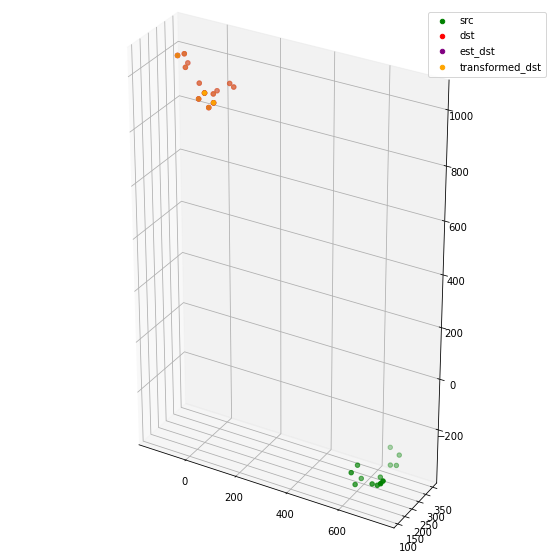

[[  -4.65673554  -40.51056247   25.21173768   -6.44467915  -16.38570332
   -18.22252837  -68.99240149 -118.32493011 -121.31209397 -128.64119168
  -127.97496862   29.99674826   15.59899294]
 [ 265.13148373  260.79747462  248.48920512  244.43427964  335.01667761
   315.09104713  310.0466496   304.37971324  323.74464095  315.20046402
   274.00113819  364.17987469  362.20825028]
 [ 855.10154538  879.28484893  887.52376256  916.63134112  883.43055099
   879.94887757  908.35138484  955.68383999  962.90054567  998.0077486
  1008.9806023   896.44432145  906.6999223 ]]
[[  -4.65673554  -40.51056247   25.21173768   -6.44467915  -16.38570332
   -18.22252837  -68.99240149 -118.32493011 -121.31209397 -128.64119168
  -127.97496862   29.99674826   15.59899294]
 [ 265.13148373  260.79747462  248.48920512  244.43427964  335.01667761
   315.09104713  310.0466496   304.37971324  323.74464095  315.20046402
   274.00113819  364.17987469  362.20825028]
 [ 855.10154538  879.28484893  887.52376256  916.631341

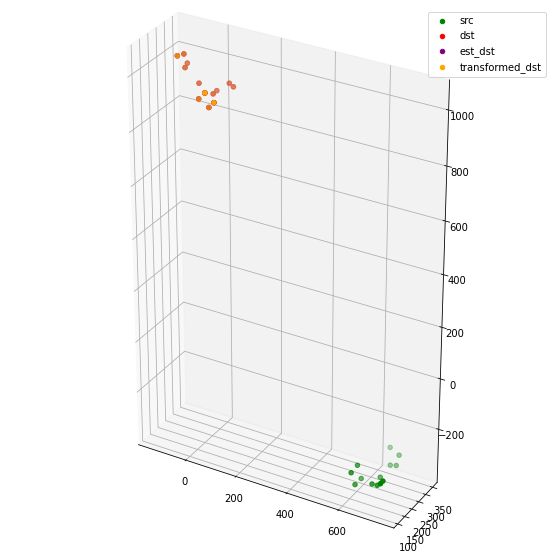

[[ -20.88890398  -57.20763129    8.489294    -23.74814775  -34.28943187
   -35.75085863  -87.06428454 -137.35620605 -140.79244698 -148.77912098
  -147.74590301   11.35015467   -3.24305708]
 [ 253.95120239  248.80991661  237.36851411  232.50991062  323.32033319
   303.41216772  297.29296116  290.35035377  309.58355278  300.52196485
   259.21094387  353.00422782  350.70208367]
 [ 862.1926476   885.5085207   895.08986983  923.42648217  891.04383667
   887.29471601  914.48324326  960.62104437  967.98858929 1002.82154772
  1013.33648126  905.4339944   915.33845364]]
[[ -20.88890398  -57.20763129    8.489294    -23.74814775  -34.28943187
   -35.75085863  -87.06428454 -137.35620605 -140.79244698 -148.77912098
  -147.74590301   11.35015467   -3.24305708]
 [ 253.95120239  248.80991661  237.36851411  232.50991062  323.32033319
   303.41216772  297.29296116  290.35035377  309.58355278  300.52196485
   259.21094387  353.00422782  350.70208367]
 [ 862.1926476   885.5085207   895.08986983  923.42648

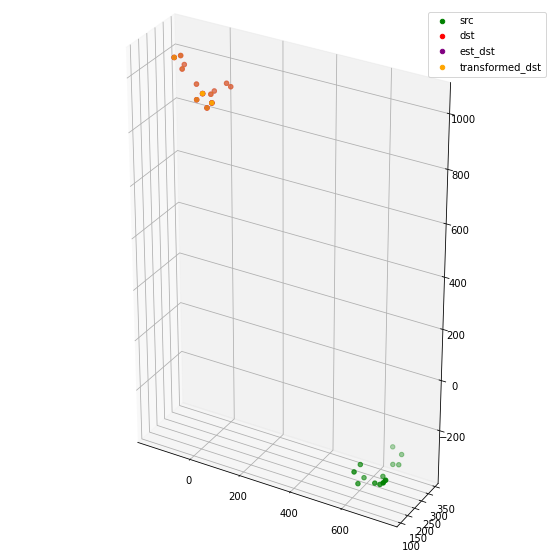

[[-1.58457852e+01 -5.21699538e+01  1.36487348e+01 -1.86163608e+01
  -3.03333407e+01 -3.14982550e+01 -8.28153008e+01 -1.33166252e+02
  -1.36901677e+02 -1.44881814e+02 -1.43298440e+02  1.48283483e+01
   2.34415661e-01]
 [ 2.41784708e+02  2.35850956e+02  2.25228477e+02  2.19575257e+02
   3.10607374e+02  2.90726686e+02  2.83556349e+02  2.75350927e+02
   2.94444116e+02  2.84854852e+02  2.43439998e+02  3.40761342e+02
   3.38134417e+02]
 [ 8.69414131e+02  8.92532480e+02  9.02220469e+02  9.30377652e+02
   8.99038327e+02  8.95047345e+02  9.21970856e+02  9.67836166e+02
   9.75419117e+02  1.01011202e+03  1.02013872e+03  9.13949470e+02
   9.23771710e+02]]
[[-1.58457852e+01 -5.21699538e+01  1.36487348e+01 -1.86163608e+01
  -3.03333407e+01 -3.14982550e+01 -8.28153008e+01 -1.33166252e+02
  -1.36901677e+02 -1.44881814e+02 -1.43298440e+02  1.48283483e+01
   2.34415661e-01]
 [ 2.41784708e+02  2.35850956e+02  2.25228477e+02  2.19575257e+02
   3.10607374e+02  2.90726686e+02  2.83556349e+02  2.75350927e+02

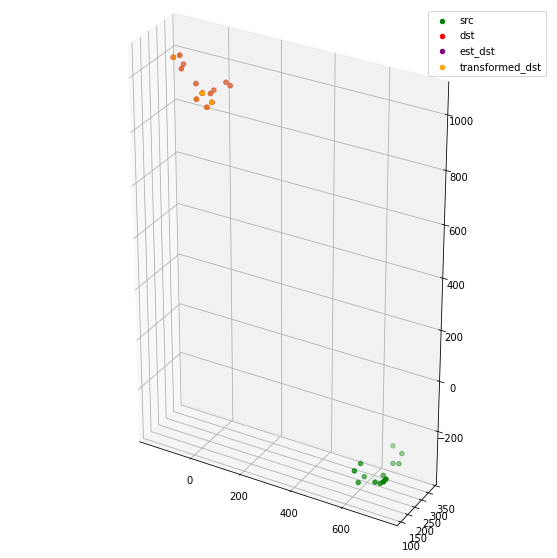

[[-2.98469172e+01 -6.69229229e+01 -1.56305507e+00 -3.47307632e+01
  -4.43696454e+01 -4.56593820e+01 -9.78504315e+01 -1.49660417e+02
  -1.53386568e+02 -1.62528190e+02 -1.61760543e+02  6.90922704e-01
  -1.42241972e+01]
 [ 2.24650553e+02  2.18815495e+02  2.07194269e+02  2.01506962e+02
   2.93171476e+02  2.73373737e+02  2.66434275e+02  2.58144762e+02
   2.77160750e+02  2.67121567e+02  2.25534807e+02  3.22500187e+02
   3.19904430e+02]
 [ 8.75542712e+02  8.97461530e+02  9.08943200e+02  9.36024188e+02
   9.05841476e+02  9.01492586e+02  9.26744647e+02  9.70939479e+02
   9.78718452e+02  1.01299497e+03  1.02238560e+03  9.22591222e+02
   9.31927241e+02]]
[[-2.98469172e+01 -6.69229229e+01 -1.56305507e+00 -3.47307632e+01
  -4.43696454e+01 -4.56593820e+01 -9.78504315e+01 -1.49660417e+02
  -1.53386568e+02 -1.62528190e+02 -1.61760543e+02  6.90922704e-01
  -1.42241972e+01]
 [ 2.24650553e+02  2.18815495e+02  2.07194269e+02  2.01506962e+02
   2.93171476e+02  2.73373737e+02  2.66434275e+02  2.58144762e+02

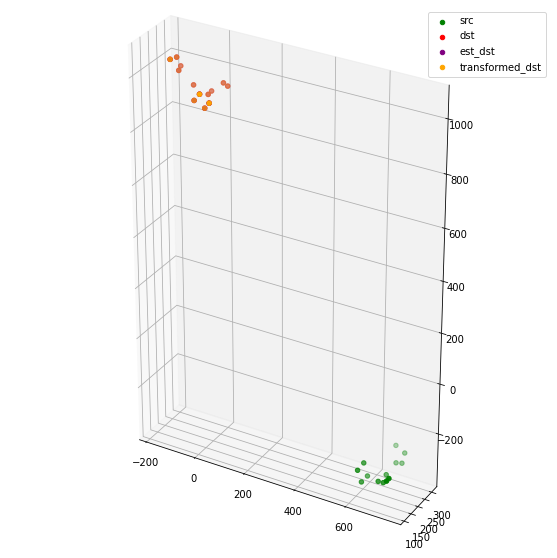

[[ -20.34988918  -57.69964368    7.35010338  -26.13140522  -33.90955887
   -35.51229314  -88.02076115 -140.32582635 -143.7796531  -153.37463958
  -153.41555897   11.52288095   -3.51094685]
 [ 210.12443826  204.55140103  191.56524918  185.97680835  278.33090704
   258.6414111   252.172108    244.00247185  262.93722376  252.44117299
   210.68368573  306.5461631   304.04648072]
 [ 881.0117838   902.53037592  914.30680159  941.01972332  912.4451187
   907.72476717  932.43786666  976.06825811  984.16459464 1018.17934854
  1026.81314287  930.07959737  939.24996375]]
[[ -20.34988918  -57.69964368    7.35010338  -26.13140522  -33.90955887
   -35.51229314  -88.02076115 -140.32582635 -143.7796531  -153.37463958
  -153.41555897   11.52288095   -3.51094685]
 [ 210.12443826  204.55140103  191.56524918  185.97680835  278.33090704
   258.6414111   252.172108    244.00247185  262.93722376  252.44117299
   210.68368573  306.5461631   304.04648072]
 [ 881.0117838   902.53037592  914.30680159  941.019723

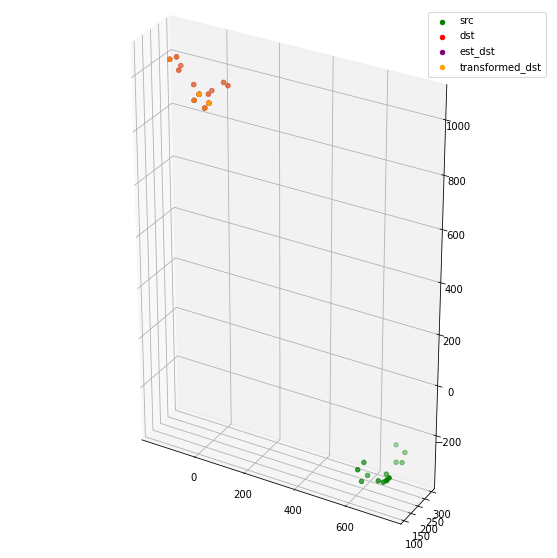

[[ -18.44110602  -55.95805635    9.18378876  -24.53766313  -33.87995226
   -34.99864924  -87.69458084 -140.4126617  -144.379555   -154.21888772
  -153.49217547   10.69467584   -4.40803953]
 [ 214.32255401  207.95869048  196.35822226  190.06147992  282.22761414
   262.50820266  254.9264384   245.65028627  264.50791883  253.81262159
   212.06425575  311.40286929  308.58495888]
 [ 882.59108489  903.59328454  916.27252295  942.52203715  913.80945133
   909.07446938  933.06163313  975.96770276  984.00871423 1017.89134221
  1026.53874992  932.06018054  941.02273482]]
[[ -18.44110602  -55.95805635    9.18378876  -24.53766313  -33.87995226
   -34.99864924  -87.69458084 -140.4126617  -144.379555   -154.21888772
  -153.49217547   10.69467584   -4.40803953]
 [ 214.32255401  207.95869048  196.35822226  190.06147992  282.22761414
   262.50820266  254.9264384   245.65028627  264.50791883  253.81262159
   212.06425575  311.40286929  308.58495888]
 [ 882.59108489  903.59328454  916.27252295  942.52203

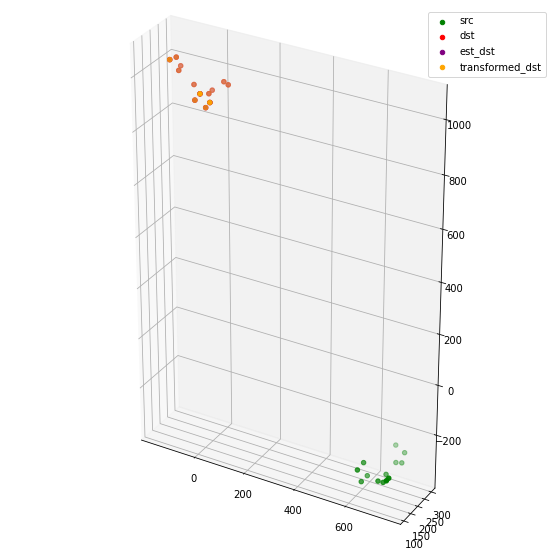

[[ -44.63389405  -83.1539789   -18.75032445  -53.73551296  -61.34027033
   -62.29567813 -116.1266052  -170.90963188 -175.19821302 -186.71820316
  -186.56145975  -17.60794908  -33.14019336]
 [ 215.68279036  209.33494265  197.4093688   191.08235419  283.45579992
   263.76986176  256.24396894  246.90914726  265.73269493  254.86984942
   213.06736891  312.34961005  309.53507466]
 [ 888.51130016  907.61681257  923.38843001  947.92060783  919.36187121
   914.4549617   935.79320457  976.01577226  983.97105597 1017.26554117
  1025.67743011  939.94861242  948.14542813]]
[[ -44.63389405  -83.1539789   -18.75032445  -53.73551296  -61.34027033
   -62.29567813 -116.1266052  -170.90963188 -175.19821302 -186.71820316
  -186.56145975  -17.60794908  -33.14019336]
 [ 215.68279036  209.33494265  197.4093688   191.08235419  283.45579992
   263.76986176  256.24396894  246.90914726  265.73269493  254.86984942
   213.06736891  312.34961005  309.53507466]
 [ 888.51130016  907.61681257  923.38843001  947.92060

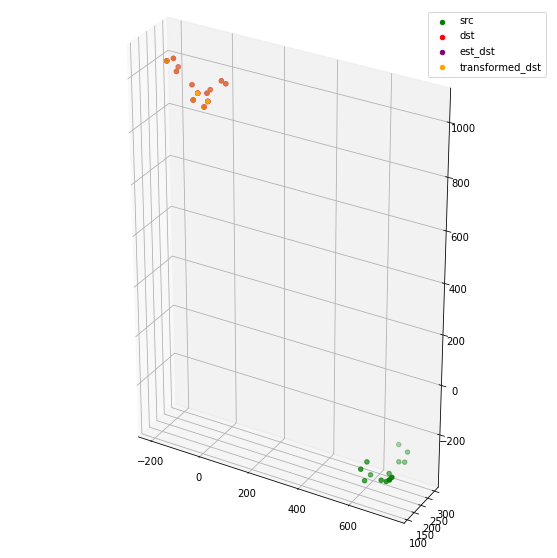

[[ -55.79501653  -94.60487729  -30.34470026  -65.74872199  -74.6785186
   -75.09333965 -129.23300263 -184.72649855 -189.60560974 -201.66306583
  -200.79958607  -32.07387319  -47.72897403]
 [ 202.07781535  194.59125299  183.7693291   176.28663971  268.94859757
   249.33279449  240.30592533  229.13059688  247.72140671  236.05396091
   194.12768015  298.41081354  295.12886045]
 [ 892.73271323  910.81195004  927.90901249  951.49686702  924.2882738
   919.03709116  938.96548566  977.71800563  985.87769178 1018.70638032
  1026.43122371  946.37908908  954.15768866]]
[[ -55.79501653  -94.60487729  -30.34470026  -65.74872199  -74.6785186
   -75.09333965 -129.23300263 -184.72649855 -189.60560974 -201.66306583
  -200.79958607  -32.07387319  -47.72897403]
 [ 202.07781535  194.59125299  183.7693291   176.28663971  268.94859757
   249.33279449  240.30592533  229.13059688  247.72140671  236.05396091
   194.12768015  298.41081354  295.12886045]
 [ 892.73271323  910.81195004  927.90901249  951.49686702

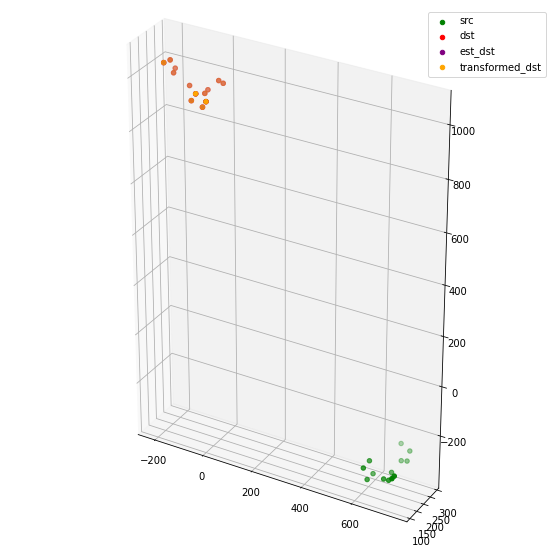

[[ -94.51470991 -134.23898215  -70.9840909  -107.63069647 -115.87568948
  -115.78750913 -170.90739806 -228.45816634 -233.99084266 -247.83074468
  -247.00333195  -74.93107509  -90.98083272]
 [ 187.54865717  179.27400879  168.56299897  160.18022879  253.42856951
   233.95061767  223.9591512   211.32729521  229.6614454   217.05686312
   174.95561131  282.67606629  279.06389067]
 [ 897.62801183  913.20443953  933.76865444  955.04252905  929.68401391
   923.92829134  940.41151989  975.54724449  983.86907383 1015.63093694
  1022.34151103  954.9684871   961.72995713]]
[[ -94.51470991 -134.23898215  -70.9840909  -107.63069647 -115.87568948
  -115.78750913 -170.90739806 -228.45816634 -233.99084266 -247.83074468
  -247.00333195  -74.93107509  -90.98083272]
 [ 187.54865717  179.27400879  168.56299897  160.18022879  253.42856951
   233.95061767  223.9591512   211.32729521  229.6614454   217.05686312
   174.95561131  282.67606629  279.06389067]
 [ 897.62801183  913.20443953  933.76865444  955.04252

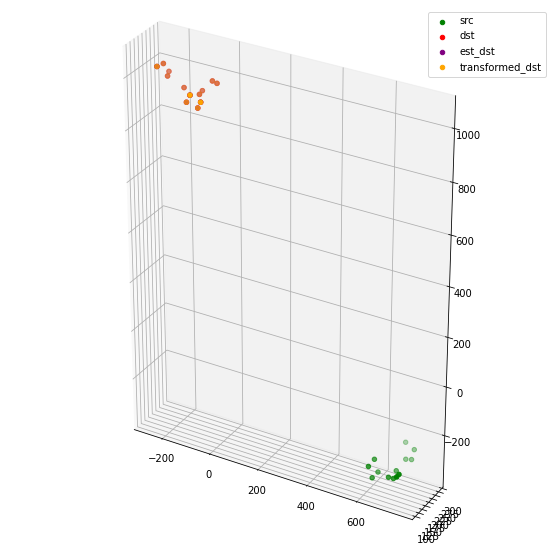

[[ -98.85540717 -139.14620863  -76.70046359 -114.08602652 -120.14883562
  -120.18759794 -175.91858373 -234.67292499 -240.1692502  -255.13655065
  -255.15216035  -79.53031097  -95.82696485]
 [ 192.81981511  185.02295843  173.14252334  165.13787382  258.72992374
   239.30609569  230.02399663  217.97016495  236.31175668  223.63576913
   181.46746581  287.10571596  283.68236923]
 [ 899.82475153  914.14163161  936.46153579  956.56296726  931.86361938
   925.92727979  940.67950813  973.97825261  982.30776857 1013.52528909
  1019.85504208  958.62426157  964.8740439 ]]
[[ -98.85540717 -139.14620863  -76.70046359 -114.08602652 -120.14883562
  -120.18759794 -175.91858373 -234.67292499 -240.1692502  -255.13655065
  -255.15216035  -79.53031097  -95.82696485]
 [ 192.81981511  185.02295843  173.14252334  165.13787382  258.72992374
   239.30609569  230.02399663  217.97016495  236.31175668  223.63576913
   181.46746581  287.10571596  283.68236923]
 [ 899.82475153  914.14163161  936.46153579  956.56296

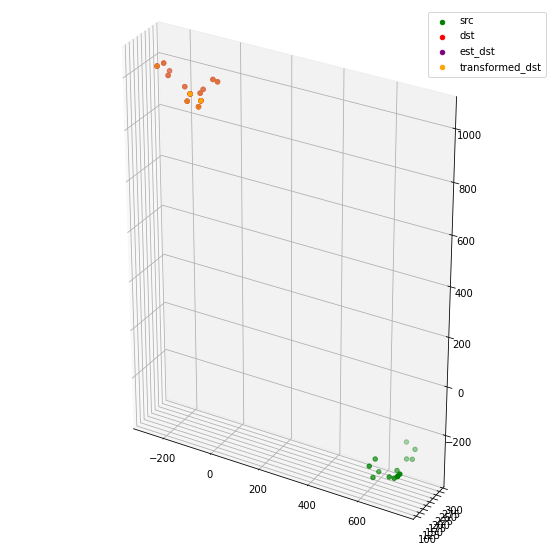

[[ -95.64061983 -136.27686631  -74.4001322  -112.25989289 -117.27958117
  -117.29181065 -173.38178624 -232.91602282 -238.49575017 -254.2117721
  -254.59139042  -77.10698477  -93.55487141]
 [ 189.23355982  181.4241307   168.80834006  160.67594691  254.70854231
   235.38926716  226.17563766  213.89185084  232.1198967   218.99933865
   176.73004166  282.39149251  278.95528075]
 [ 900.84549296  914.1428987   937.61427564  956.75389368  933.5383605
   927.27001269  940.63983139  972.43538319  980.95649818 1011.61741698
  1017.22047352  961.66306257  967.49568493]]
[[ -95.64061983 -136.27686631  -74.4001322  -112.25989289 -117.27958117
  -117.29181065 -173.38178624 -232.91602282 -238.49575017 -254.2117721
  -254.59139042  -77.10698477  -93.55487141]
 [ 189.23355982  181.4241307   168.80834006  160.67594691  254.70854231
   235.38926716  226.17563766  213.89185084  232.1198967   218.99933865
   176.73004166  282.39149251  278.95528075]
 [ 900.84549296  914.1428987   937.61427564  956.75389368

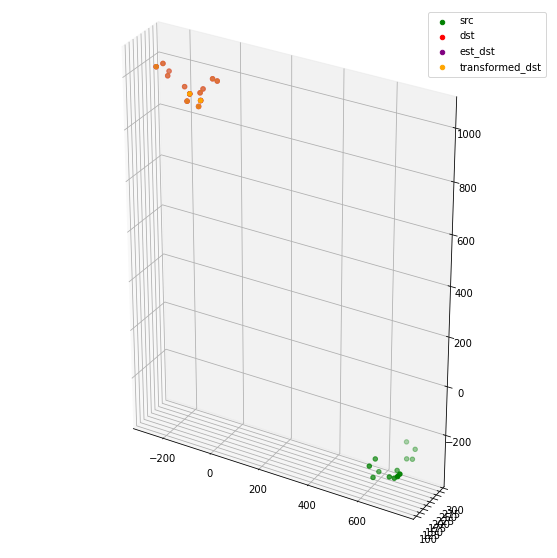

[[ -93.76625606 -134.6301621   -73.19787419 -111.4114099  -116.54975811
  -116.29635844 -172.60218777 -232.73317887 -238.61898595 -254.91283106
  -255.13291656  -77.18616451  -93.73419594]
 [ 190.40527394  182.1251675   169.52183217  160.84173535  255.20436752
   235.98943644  226.2066114   213.03398205  231.08606824  217.37178685
   175.01574773  282.68131905  279.04734504]
 [ 904.64663116  916.92236869  941.53992085  959.71143386  937.90367662
   931.32728413  943.31387244  973.59455283  982.28269838 1012.37694082
  1017.29113791  967.34356     972.75806812]]
[[ -93.76625606 -134.6301621   -73.19787419 -111.4114099  -116.54975811
  -116.29635844 -172.60218777 -232.73317887 -238.61898595 -254.91283106
  -255.13291656  -77.18616451  -93.73419594]
 [ 190.40527394  182.1251675   169.52183217  160.84173535  255.20436752
   235.98943644  226.2066114   213.03398205  231.08606824  217.37178685
   175.01574773  282.68131905  279.04734504]
 [ 904.64663116  916.92236869  941.53992085  959.71143

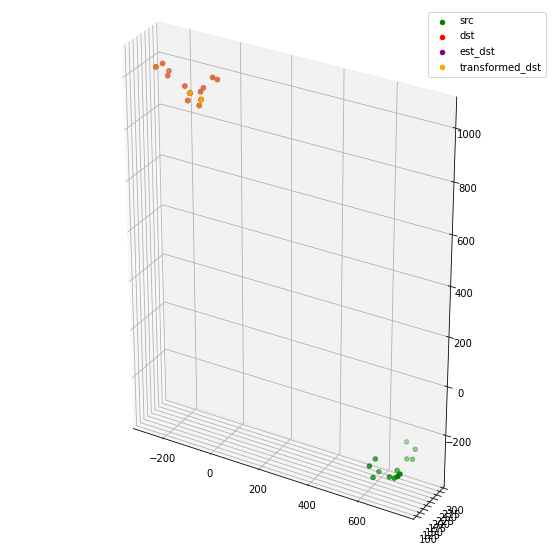

[[ -97.48374666 -138.23214115  -76.86085814 -115.06375758 -123.4296784
  -122.29799736 -178.40934792 -238.57622523 -245.33194701 -261.67880486
  -260.35026088  -85.76062557 -102.25982525]
 [ 174.28861813  164.08688136  153.1122373   142.43586538  237.14340495
   218.15779465  205.87282463  189.50786661  207.05322381  191.83044342
   149.36886461  265.21275184  260.78765941]
 [ 909.67918948  920.84187845  946.37453879  963.47353976  944.32202376
   937.19512924  947.69866344  976.30476215  985.38909359 1014.71964978
  1018.39131377  975.37578881  980.33108664]]
[[ -97.48374666 -138.23214115  -76.86085814 -115.06375758 -123.4296784
  -122.29799736 -178.40934792 -238.57622523 -245.33194701 -261.67880486
  -260.35026088  -85.76062557 -102.25982525]
 [ 174.28861813  164.08688136  153.1122373   142.43586538  237.14340495
   218.15779465  205.87282463  189.50786661  207.05322381  191.83044342
   149.36886461  265.21275184  260.78765941]
 [ 909.67918948  920.84187845  946.37453879  963.4735397

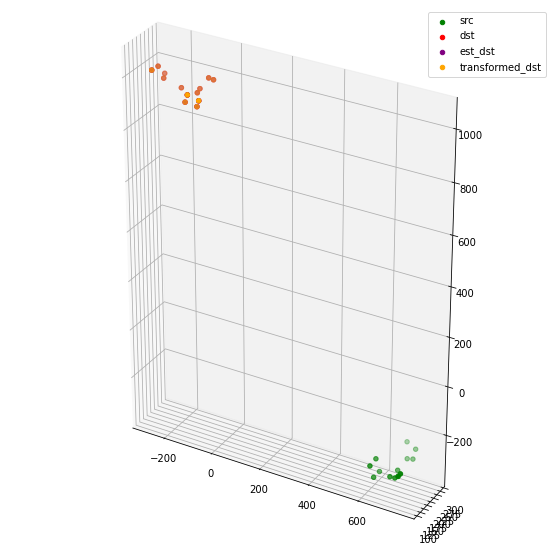

[[ -70.92093542 -111.14581713  -49.20167167  -86.82147599  -99.11897539
   -97.27748176 -152.77367372 -212.02821616 -219.41720838 -234.9288023
  -231.8708547   -62.38465385  -78.65693832]
 [ 153.52340371  141.25261717  131.76842425  118.89276742  213.86589166
   195.23689951  180.29170749  160.39629296  177.28310156  160.26923221
   117.78431705  242.18883842  236.90929691]
 [ 915.87346943  926.85069133  951.58461262  968.46033665  953.12526479
   945.24514558  955.5670783   983.83800931  993.64835605 1022.44337357
  1024.42144364  985.05616531  989.92434867]]
[[ -70.92093542 -111.14581713  -49.20167167  -86.82147599  -99.11897539
   -97.27748176 -152.77367372 -212.02821616 -219.41720838 -234.9288023
  -231.8708547   -62.38465385  -78.65693832]
 [ 153.52340371  141.25261717  131.76842425  118.89276742  213.86589166
   195.23689951  180.29170749  160.39629296  177.28310156  160.26923221
   117.78431705  242.18883842  236.90929691]
 [ 915.87346943  926.85069133  951.58461262  968.4603366

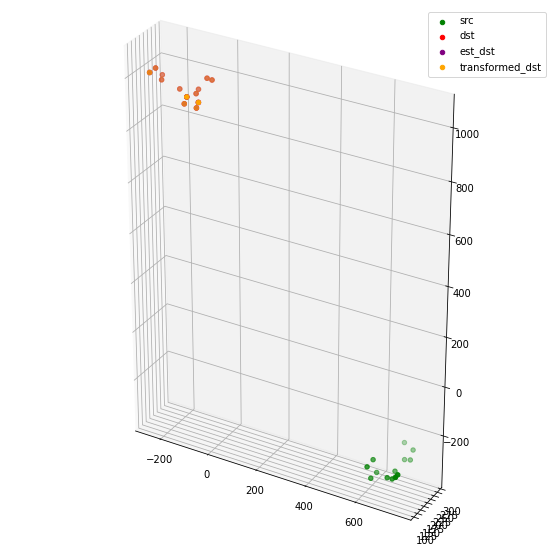

[[ -46.20557871  -86.5443068   -24.7589076   -62.52085834  -74.22268609
   -72.45213774 -128.07398636 -187.55739339 -194.89317436 -210.62080952
  -207.80869567  -37.46553897  -53.7874434 ]
 [ 154.31216314  141.9971562   131.5385781   118.4550454   213.85376916
   195.4196352   180.53461775  160.26894868  176.94429845  159.29693178
   116.75888147  241.15133867  235.84321259]
 [ 918.79505887  929.29459845  954.03275771  970.42417393  957.44580807
   949.10466966  958.81932831  986.33661023  996.54069967 1024.83285887
  1025.74834383  990.23203893  994.89886261]]
[[ -46.20557871  -86.5443068   -24.7589076   -62.52085834  -74.22268609
   -72.45213774 -128.07398636 -187.55739339 -194.89317436 -210.62080952
  -207.80869567  -37.46553897  -53.7874434 ]
 [ 154.31216314  141.9971562   131.5385781   118.4550454   213.85376916
   195.4196352   180.53461775  160.26894868  176.94429845  159.29693178
   116.75888147  241.15133867  235.84321259]
 [ 918.79505887  929.29459845  954.03275771  970.42417

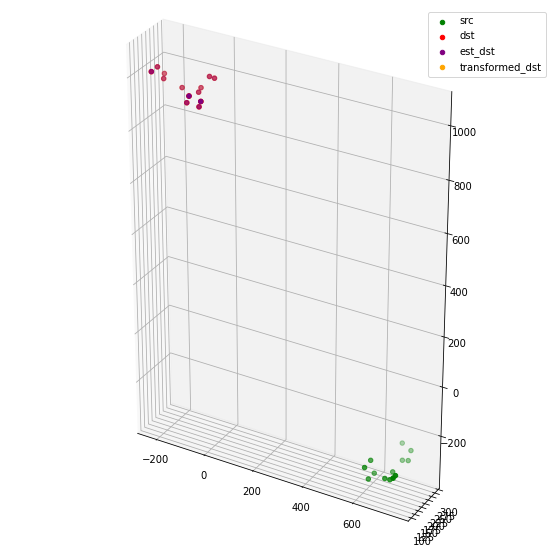

[[ -11.15611765  -51.15914186   10.85948078  -26.55325681  -40.81036516
   -38.53430627  -93.74471783 -152.68912037 -160.4829268  -175.75895984
  -171.80138141   -4.83792822  -21.01567335]
 [ 170.18040174  156.74878759  147.88240836  133.73344899  228.8223516
   210.46910603  194.05869772  172.10926113  188.54838619  170.39400115
   127.94459483  256.99773476  251.23660437]
 [ 911.53490977  921.94944322  946.72587757  963.03281754  950.3394055
   941.94270024  951.54672729  978.93200621  989.1797456  1017.39845302
  1018.18413566  983.25313613  987.88454512]]
[[ -11.15611765  -51.15914186   10.85948078  -26.55325681  -40.81036516
   -38.53430627  -93.74471783 -152.68912037 -160.4829268  -175.75895984
  -171.80138141   -4.83792822  -21.01567335]
 [ 170.18040174  156.74878759  147.88240836  133.73344899  228.8223516
   210.46910603  194.05869772  172.10926113  188.54838619  170.39400115
   127.94459483  256.99773476  251.23660437]
 [ 911.53490977  921.94944322  946.72587757  963.03281754

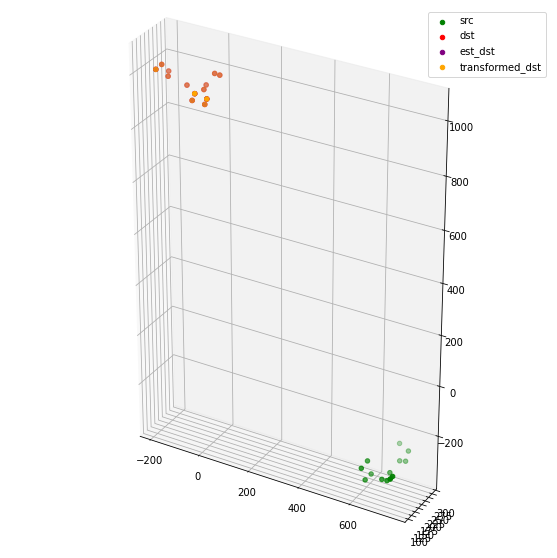

[[  44.01138235    3.99416981   66.21010304   28.8469284    15.47529084
    17.4480935   -37.8168936   -96.65879545 -104.14691344 -119.27468242
  -115.77165611   52.15242414   35.97046842]
 [ 165.9492897   152.77504273  142.83184689  128.81419714  224.24921697
   206.01547073  190.03953246  168.26861854  184.6168308   166.15830905
   123.66172636  251.48367789  245.81968453]
 [ 900.727413    911.41266588  935.2685759   951.80099717  940.8628279
   932.13555604  942.14949526  969.89533733  980.5098773  1008.61090773
  1008.64388137  973.79084228  978.52618789]]
[[  44.01138235    3.99416981   66.21010304   28.8469284    15.47529084
    17.4480935   -37.8168936   -96.65879545 -104.14691344 -119.27468242
  -115.77165611   52.15242414   35.97046842]
 [ 165.9492897   152.77504273  142.83184689  128.81419714  224.24921697
   206.01547073  190.03953246  168.26861854  184.6168308   166.15830905
   123.66172636  251.48367789  245.81968453]
 [ 900.727413    911.41266588  935.2685759   951.800997

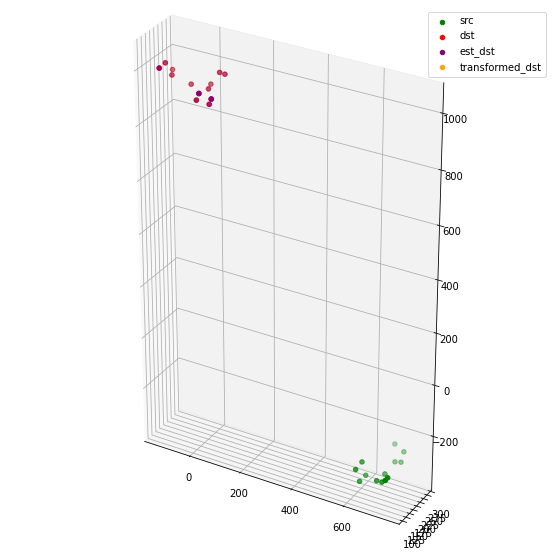

[[  58.00872812   17.72456482   79.52081377   41.80565317   29.54349583
    31.44526607  -24.10419283  -83.51960234  -90.97958504 -106.65792864
  -103.58561446   66.06228739   49.76358079]
 [ 179.13068873  166.31706729  155.63611621  141.92629019  237.53982741
   219.32572694  203.86865932  182.57494745  198.95138764  180.52362231
   137.99387437  264.25391642  258.73393877]
 [ 901.88996674  911.99491624  936.61065986  952.5928252   941.91676572
   933.13288617  942.35595822  969.2364494   979.82726046 1007.64526429
  1007.53016975  975.44164322  979.94075642]]
[[  58.00872812   17.72456482   79.52081377   41.80565317   29.54349583
    31.44526607  -24.10419283  -83.51960234  -90.97958504 -106.65792864
  -103.58561446   66.06228739   49.76358079]
 [ 179.13068873  166.31706729  155.63611621  141.92629019  237.53982741
   219.32572694  203.86865932  182.57494745  198.95138764  180.52362231
   137.99387437  264.25391642  258.73393877]
 [ 901.88996674  911.99491624  936.61065986  952.59282

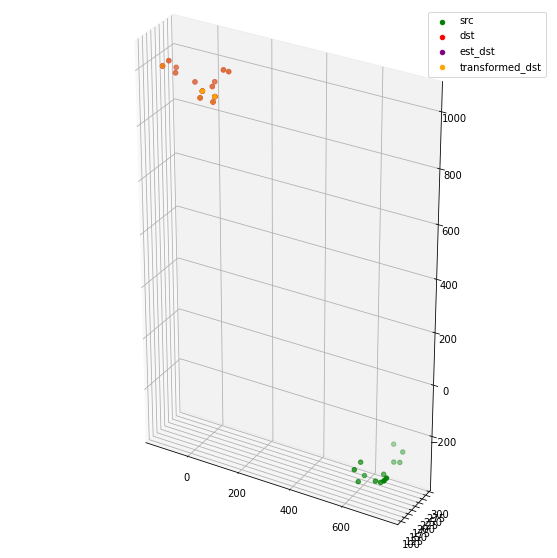

[[  71.52135762   30.93996716   92.24778441   54.14222438   43.25955811
    45.04805026  -10.81773545  -70.86777443  -78.26208649  -94.55893876
   -92.03262071   79.65234492   63.223391  ]
 [ 193.22017196  180.84500903  169.15366335  155.79903264  251.65109162
   233.48926219  218.67663384  197.92795825  214.30911951  195.85032201
   153.28679649  277.60257389  272.25653831]
 [ 908.27964482  917.71992037  943.08639263  958.4305254   948.41865183
   939.50372202  947.83009034  973.7078634   984.3373563  1011.77673915
  1011.33420918  982.67164785  986.89886757]]
[[  71.52135762   30.93996716   92.24778441   54.14222438   43.25955811
    45.04805026  -10.81773545  -70.86777443  -78.26208649  -94.55893876
   -92.03262071   79.65234492   63.223391  ]
 [ 193.22017196  180.84500903  169.15366335  155.79903264  251.65109162
   233.48926219  218.67663384  197.92795825  214.30911951  195.85032201
   153.28679649  277.60257389  272.25653831]
 [ 908.27964482  917.71992037  943.08639263  958.43052

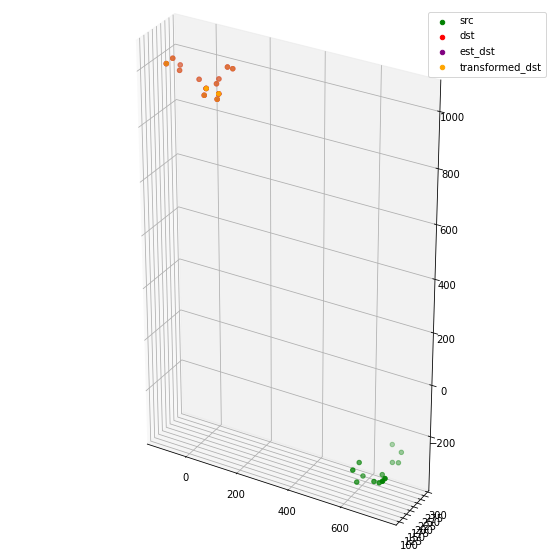

[[  51.04634958    9.84132211   69.68191378   30.65981362   22.11743001
    23.95865311  -32.50819529  -94.07464597 -101.62804913 -119.52265544
  -117.80851225   57.39986693   40.69329954]
 [ 211.78555258  200.21925831  187.39000421  174.80802623  270.83333176
   252.62262533  238.91386557  219.38609957  235.92869766  217.84401957
   175.23867823  296.1410033   291.12329477]
 [ 921.63567524  929.21718297  957.38290259  970.97671758  960.3722078
   951.56841344  957.33844974  980.45581044  990.71704638 1017.39965896
  1017.11961708  996.23100737  999.7056609 ]]
[[  51.04634958    9.84132211   69.68191378   30.65981362   22.11743001
    23.95865311  -32.50819529  -94.07464597 -101.62804913 -119.52265544
  -117.80851225   57.39986693   40.69329954]
 [ 211.78555258  200.21925831  187.39000421  174.80802623  270.83333176
   252.62262533  238.91386557  219.38609957  235.92869766  217.84401957
   175.23867823  296.1410033   291.12329477]
 [ 921.63567524  929.21718297  957.38290259  970.976717

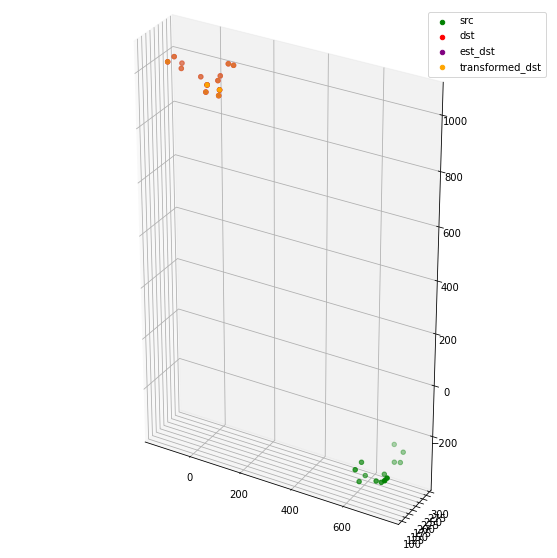

[[ 1.26810484e+01 -2.92465239e+01  2.82528295e+01 -1.19148589e+01
  -1.69564158e+01 -1.50817262e+01 -7.21782841e+01 -1.35650528e+02
  -1.43365675e+02 -1.63463731e+02 -1.62975942e+02  1.66599935e+01
  -3.74942485e-01]
 [ 2.51533999e+02  2.41291660e+02  2.27473860e+02  2.16296533e+02
   3.12247514e+02  2.93792254e+02  2.81788554e+02  2.64515734e+02
   2.81495956e+02  2.64540973e+02  2.21909607e+02  3.37400341e+02
   3.32929002e+02]
 [ 9.35938934e+02  9.41065910e+02  9.73341082e+02  9.84630300e+02
   9.71428812e+02  9.63157437e+02  9.65528646e+02  9.84999080e+02
   9.94388062e+02  1.02023049e+03  1.02097915e+03  1.00895819e+03
   1.01144377e+03]]
[[ 1.26810484e+01 -2.92465239e+01  2.82528295e+01 -1.19148589e+01
  -1.69564158e+01 -1.50817262e+01 -7.21782841e+01 -1.35650528e+02
  -1.43365675e+02 -1.63463731e+02 -1.62975942e+02  1.66599935e+01
  -3.74942485e-01]
 [ 2.51533999e+02  2.41291660e+02  2.27473860e+02  2.16296533e+02
   3.12247514e+02  2.93792254e+02  2.81788554e+02  2.64515734e+02

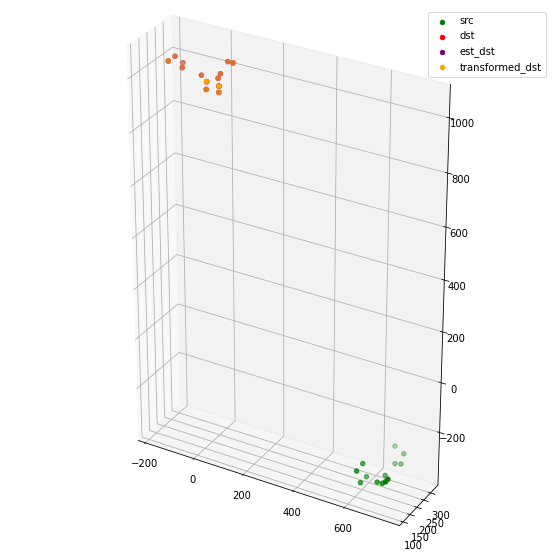

[[  36.73351787   -5.544585     51.10663774   10.48283492    8.50524806
     9.92417828  -47.53384497 -111.73530314 -119.0499797  -139.96978127
  -140.77894336   42.39796435   25.20625909]
 [ 272.47736321  263.49083906  247.83428923  237.83969785  333.94220528
   315.46602842  305.18676657  289.77733208  306.95209827  290.52766825
   247.89881537  357.94320483  353.98091444]
 [ 961.64097698  966.21449993  999.14329194 1009.8967595   996.98612573
   988.67082346  990.29585322 1008.92099635 1018.27660039 1043.80764681
  1044.40596132 1035.01792695 1037.27747005]]
[[  36.73351787   -5.544585     51.10663774   10.48283492    8.50524806
     9.92417828  -47.53384497 -111.73530314 -119.0499797  -139.96978127
  -140.77894336   42.39796435   25.20625909]
 [ 272.47736321  263.49083906  247.83428923  237.83969785  333.94220528
   315.46602842  305.18676657  289.77733208  306.95209827  290.52766825
   247.89881537  357.94320483  353.98091444]
 [ 961.64097698  966.21449993  999.14329194 1009.89675

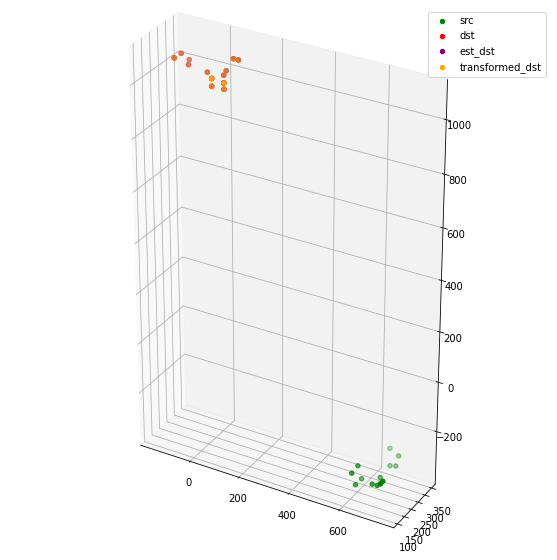

[[  44.99130455    2.5711161    58.74386613   17.91212784   17.19065355
    18.46175287  -39.12648622 -103.66613114 -110.85686068 -132.1916047
  -133.5132249    51.03503429   33.77841356]
 [ 277.94989793  269.42360978  252.74466919  243.12585535  339.37515773
   320.97142687  311.36549908  296.53280834  313.69509808  297.25613897
   254.63612664  362.56820139  358.78890892]
 [ 977.93990039  982.0560555  1015.30104051 1025.60006206 1013.69046445
  1005.19259864 1006.21692846 1024.12780163 1033.60164105 1058.77749558
  1058.91781448 1052.26276952 1054.33303503]]
[[  44.99130455    2.5711161    58.74386613   17.91212784   17.19065355
    18.46175287  -39.12648622 -103.66613114 -110.85686068 -132.1916047
  -133.5132249    51.03503429   33.77841356]
 [ 277.94989793  269.42360978  252.74466919  243.12585535  339.37515773
   320.97142687  311.36549908  296.53280834  313.69509808  297.25613897
   254.63612664  362.56820139  358.78890892]
 [ 977.93990039  982.0560555  1015.30104051 1025.6000620

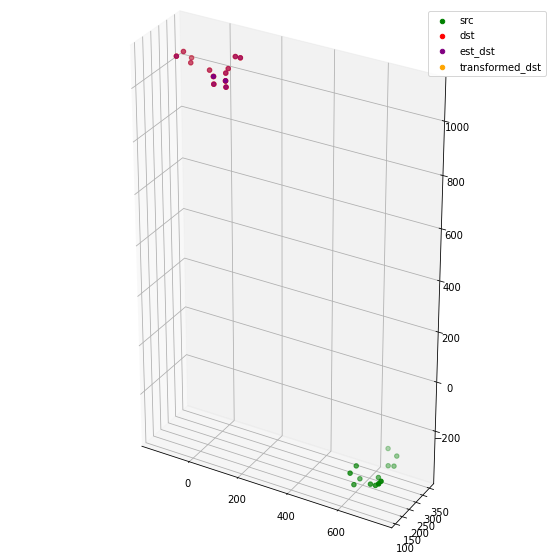

[[  65.75962154   23.16764599   79.03841114   38.02692173   39.46865241
    40.29552438  -17.49382538  -82.304532    -89.07505527 -110.70850878
  -113.00201761   73.94185388   56.60937061]
 [ 268.30911235  260.67290423  242.0821672   233.19862918  329.65101903
   311.39027915  303.07975148  289.37764517  306.51343771  290.08233371
   247.50865877  351.32013744  347.89544316]
 [ 993.29416946  997.38374837 1030.11960078 1040.36473452 1030.30763991
  1021.45391822 1022.48083886 1040.3133499  1050.13826937 1075.06309316
  1074.38941617 1069.20789425 1071.26130676]]
[[  65.75962154   23.16764599   79.03841114   38.02692173   39.46865241
    40.29552438  -17.49382538  -82.304532    -89.07505527 -110.70850878
  -113.00201761   73.94185388   56.60937061]
 [ 268.30911235  260.67290423  242.0821672   233.19862918  329.65101903
   311.39027915  303.07975148  289.37764517  306.51343771  290.08233371
   247.50865877  351.32013744  347.89544316]
 [ 993.29416946  997.38374837 1030.11960078 1040.36473

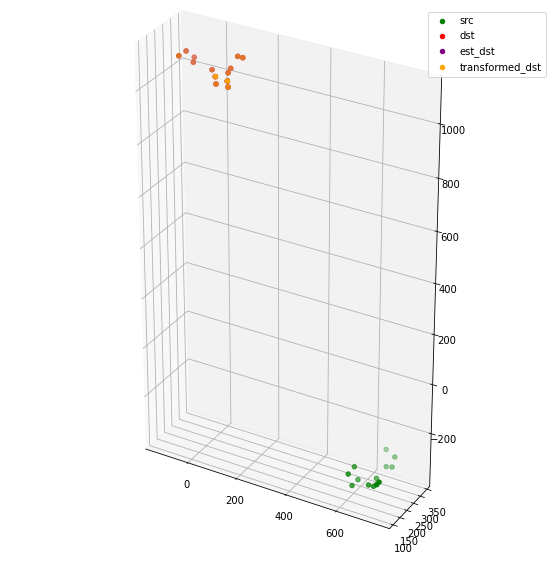

[[  71.33140234   28.68946065   84.37188378   43.28671153   45.25194436
    46.00989341  -11.82402505  -76.75405549  -83.46405779 -105.25150306
  -107.76169849   79.72659689   62.37105864]
 [ 252.67351985  245.15880492  225.46164889  216.53726381  313.20291599
   295.16613387  287.13329033  273.32530113  290.24405562  273.30523294
   230.77439821  333.70898643  330.32406718]
 [1010.14286993 1013.92527387 1046.33335514 1056.24225258 1048.61488107
  1039.3075329  1039.970618   1057.27970345 1067.51376567 1091.9599892
  1090.21103616 1088.13932297 1090.05964152]]
[[  71.33140234   28.68946065   84.37188378   43.28671153   45.25194436
    46.00989341  -11.82402505  -76.75405549  -83.46405779 -105.25150306
  -107.76169849   79.72659689   62.37105864]
 [ 252.67351985  245.15880492  225.46164889  216.53726381  313.20291599
   295.16613387  287.13329033  273.32530113  290.24405562  273.30523294
   230.77439821  333.70898643  330.32406718]
 [1010.14286993 1013.92527387 1046.33335514 1056.242252

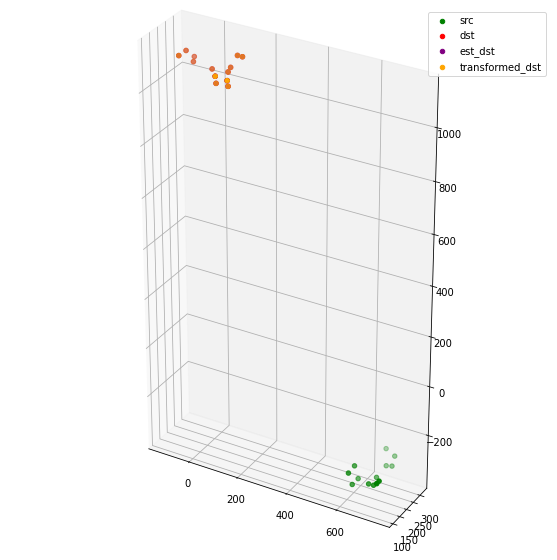

[[  78.47316707   35.82685417   91.58559837   50.51672676   52.70806703
    53.38102329   -4.47090622  -69.36781323  -75.99202614  -97.72669093
  -100.35670674   87.39435962   70.03769481]
 [ 234.57269063  227.06760822  206.36478872  197.2819148   294.11233906
   276.33037151  268.42986865  254.32696862  270.98156017  253.44729761
   210.98536704  313.4608035   310.0696868 ]
 [1022.18769702 1025.93982252 1057.58077137 1067.41293607 1062.37763921
  1052.58603638 1053.26771704 1070.4628771  1081.17496361 1105.24544996
  1102.36460103 1102.29856267 1104.19764775]]
[[  78.47316707   35.82685417   91.58559837   50.51672676   52.70806703
    53.38102329   -4.47090622  -69.36781323  -75.99202614  -97.72669093
  -100.35670674   87.39435962   70.03769481]
 [ 234.57269063  227.06760822  206.36478872  197.2819148   294.11233906
   276.33037151  268.42986865  254.32696862  270.98156017  253.44729761
   210.98536704  313.4608035   310.0696868 ]
 [1022.18769702 1025.93982252 1057.58077137 1067.41293

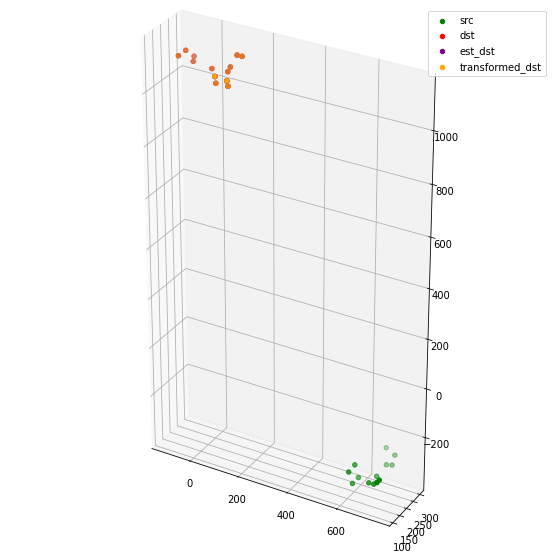

[[  72.4717028    29.73862105   85.12102172   43.9149644    46.99848763
    47.57147934  -10.35154706  -75.47290453  -82.01234217 -104.0455142
  -107.03631015   81.61689844   64.21970242]
 [ 220.39017159  213.18672093  191.25954694  182.32490111  279.22165563
   261.66387943  254.27309447  240.36626363  256.8296666   238.94445538
   196.58538986  297.33391091  294.05711529]
 [1031.20942827 1034.54210495 1066.01880539 1075.40257976 1072.61007273
  1062.41581446 1062.58222318 1079.07412167 1090.12837569 1113.66330464
  1109.79076951 1113.1648991  1114.88541967]]
[[  72.4717028    29.73862105   85.12102172   43.9149644    46.99848763
    47.57147934  -10.35154706  -75.47290453  -82.01234217 -104.0455142
  -107.03631015   81.61689844   64.21970242]
 [ 220.39017159  213.18672093  191.25954694  182.32490111  279.22165563
   261.66387943  254.27309447  240.36626363  256.8296666   238.94445538
   196.58538986  297.33391091  294.05711529]
 [1031.20942827 1034.54210495 1066.01880539 1075.4025797

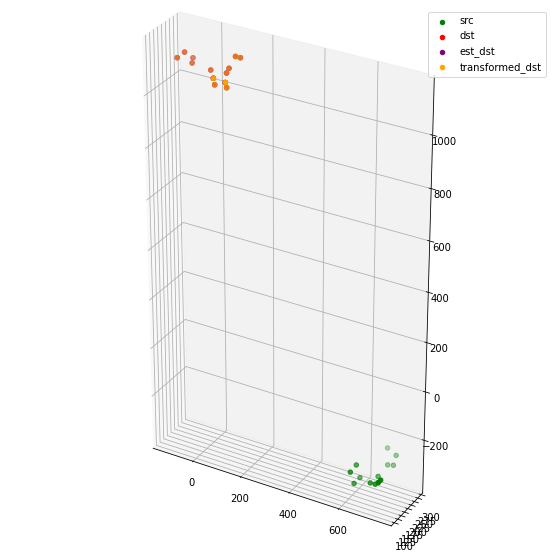

[[  57.59053172   14.8169381    69.86534235   28.55874404   31.81519892
    32.45819742  -25.47492178  -90.77059809  -97.38957289 -119.67180601
  -122.68986115   66.07512893   48.65747244]
 [ 238.24044693  231.106453    209.14775524  200.29015829  297.17749984
   279.60227235  272.29852712  258.51617467  275.00737088  257.19360924
   214.83280721  315.30404568  312.05612125]
 [1031.86097834 1034.80011612 1066.83576371 1075.84299353 1072.9230969
  1062.76314327 1062.39248745 1078.28887937 1089.25400746 1112.60794319
  1108.77576163 1113.77487326 1115.33571894]]
[[  57.59053172   14.8169381    69.86534235   28.55874404   31.81519892
    32.45819742  -25.47492178  -90.77059809  -97.38957289 -119.67180601
  -122.68986115   66.07512893   48.65747244]
 [ 238.24044693  231.106453    209.14775524  200.29015829  297.17749984
   279.60227235  272.29852712  258.51617467  275.00737088  257.19360924
   214.83280721  315.30404568  312.05612125]
 [1031.86097834 1034.80011612 1066.83576371 1075.842993

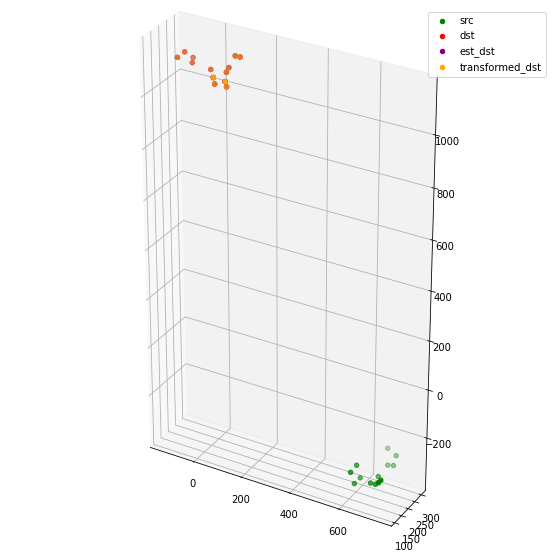

[[  66.0824284    23.26281975   78.28887358   36.9547728    41.07875429
    41.50384201  -16.49469114  -81.82246002  -88.22851794 -110.53992793
  -113.96608935   75.73323928   58.2957748 ]
 [ 259.4044093   252.6646532   230.23999708  221.77010591  318.62033659
   301.02860722  294.25385186  281.08621478  297.64943792  280.06607442
   237.73033921  336.47895472  333.39198824]
 [1033.46005497 1036.64902258 1068.3990168  1077.64971045 1074.59801559
  1064.45518145 1064.42020875 1080.70117327 1091.68418176 1115.1844082
  1111.41893825 1115.23443434 1116.8974077 ]]
[[  66.0824284    23.26281975   78.28887358   36.9547728    41.07875429
    41.50384201  -16.49469114  -81.82246002  -88.22851794 -110.53992793
  -113.96608935   75.73323928   58.2957748 ]
 [ 259.4044093   252.6646532   230.23999708  221.77010591  318.62033659
   301.02860722  294.25385186  281.08621478  297.64943792  280.06607442
   237.73033921  336.47895472  333.39198824]
 [1033.46005497 1036.64902258 1068.3990168  1077.649710

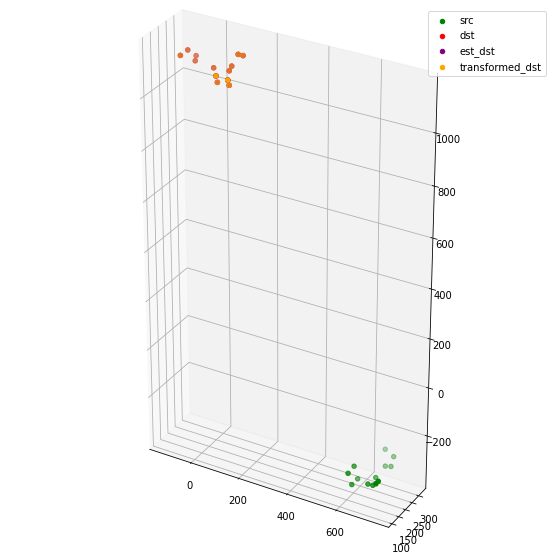

[[  62.04174753   19.29901825   74.57802165   33.34197682   36.41488886
    37.02638476  -20.89533447  -86.06981084  -92.65043082 -114.76023026
  -117.72896199   70.89065993   53.48836405]
 [ 270.94853272  263.72718502  241.72174443  232.75233827  329.6572368
   312.12857626  304.7258707   290.75938783  307.1900566   289.23376002
   246.8852634   347.66118528  344.37607263]
 [1033.12329883 1036.28935988 1067.89294039 1077.11034982 1074.6033392
  1064.36132482 1064.30866895 1080.53823597 1091.61672769 1115.0253268
  1111.02241697 1115.32754758 1116.97925662]]
[[  62.04174753   19.29901825   74.57802165   33.34197682   36.41488886
    37.02638476  -20.89533447  -86.06981084  -92.65043082 -114.76023026
  -117.72896199   70.89065993   53.48836405]
 [ 270.94853272  263.72718502  241.72174443  232.75233827  329.6572368
   312.12857626  304.7258707   290.75938783  307.1900566   289.23376002
   246.8852634   347.66118528  344.37607263]
 [1033.12329883 1036.28935988 1067.89294039 1077.11034982 

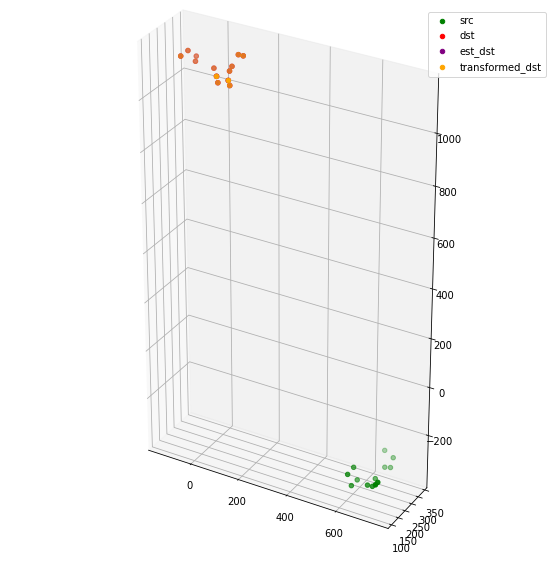

[[  75.18774693   32.5679975    88.48972183   47.47562111   49.51610953
    50.17072319   -7.6671512   -72.47071872  -79.07107044 -100.67871948
  -103.26442767   84.34772406   67.00391751]
 [ 283.0731501   275.40018993  253.8695032   244.4453329   341.38417108
   323.89474726  315.89343334  301.2030013   317.53014209  299.2732849
   256.90901072  359.61693115  356.14683975]
 [1027.23083708 1030.94504653 1061.73439876 1071.47353799 1069.24075774
  1058.93453332 1059.63284788 1076.68754525 1087.90646877 1111.55030515
  1107.449792   1109.5583369  1111.43206308]]
[[  75.18774693   32.5679975    88.48972183   47.47562111   49.51610953
    50.17072319   -7.6671512   -72.47071872  -79.07107044 -100.67871948
  -103.26442767   84.34772406   67.00391751]
 [ 283.0731501   275.40018993  253.8695032   244.4453329   341.38417108
   323.89474726  315.89343334  301.2030013   317.53014209  299.2732849
   256.90901072  359.61693115  356.14683975]
 [1027.23083708 1030.94504653 1061.73439876 1071.4735379

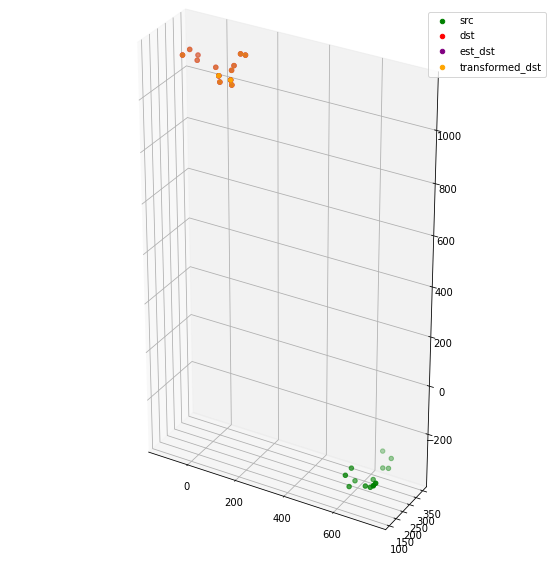

[[  88.81108568   46.11236684  101.87178457   60.77859458   64.02531206
    64.42318556    6.49253208  -58.42741883  -64.78176008  -86.53013949
   -89.6613508    99.22933418   81.85035632]
 [ 285.43801317  278.25036309  255.62842076  246.59216323  343.51870603
   326.15673558  318.86958594  304.77056039  321.03288238  302.74396717
   260.47162332  360.79425383  357.51704377]
 [1025.27634915 1029.05388899 1059.35123202 1069.12456632 1068.12888828
  1057.59653788 1058.41214725 1075.52329309 1086.97596284 1110.46549038
  1105.83123934 1108.54440974 1110.43941178]]
[[  88.81108568   46.11236684  101.87178457   60.77859458   64.02531206
    64.42318556    6.49253208  -58.42741883  -64.78176008  -86.53013949
   -89.6613508    99.22933418   81.85035632]
 [ 285.43801317  278.25036309  255.62842076  246.59216323  343.51870603
   326.15673558  318.86958594  304.77056039  321.03288238  302.74396717
   260.47162332  360.79425383  357.51704377]
 [1025.27634915 1029.05388899 1059.35123202 1069.12456

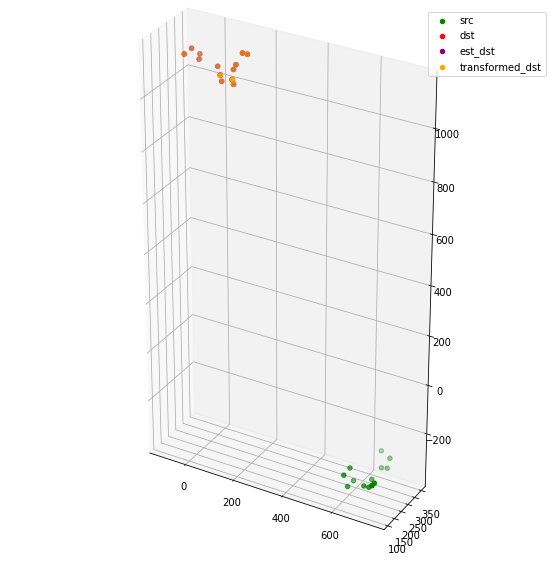

[[ 100.87517386   58.24936131  114.35783549   73.39065702   76.02612161
    76.45903766   18.58199814  -46.1283699   -52.50424624  -73.9744959
   -76.87425822  111.40168261   94.05705462]
 [ 292.20272141  284.7081082   262.13200823  252.73823256  349.68842921
   332.43702107  324.7769352   310.09613488  326.20109086  307.53815734
   265.29608824  366.77478143  363.36903257]
 [1018.5822532  1022.58020128 1052.26104981 1062.22446004 1062.19371464
  1051.48258833 1052.62265958 1070.03576468 1081.6969399  1105.14811518
  1100.10521945 1102.53982166 1104.52092347]]
[[ 100.87517386   58.24936131  114.35783549   73.39065702   76.02612161
    76.45903766   18.58199814  -46.1283699   -52.50424624  -73.9744959
   -76.87425822  111.40168261   94.05705462]
 [ 292.20272141  284.7081082   262.13200823  252.73823256  349.68842921
   332.43702107  324.7769352   310.09613488  326.20109086  307.53815734
   265.29608824  366.77478143  363.36903257]
 [1018.5822532  1022.58020128 1052.26104981 1062.2244600

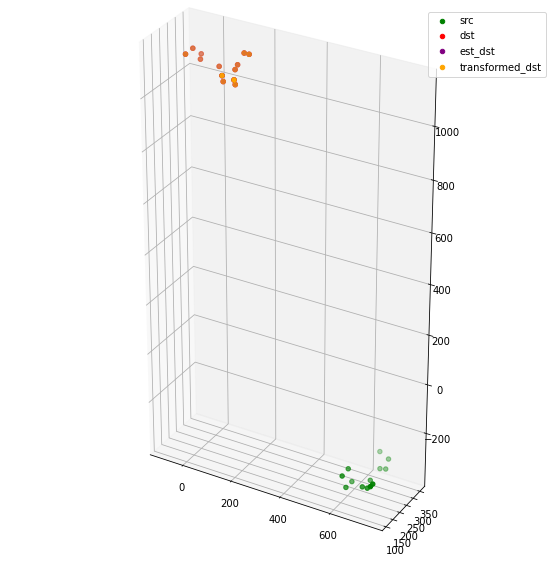

[[ 105.22902582   62.72027326  119.27923005   78.48975217   79.99460431
    80.55919176   22.78398201  -41.63667622  -48.12417569  -69.22302083
   -71.66276807  115.42923222   98.13868385]
 [ 289.79661276  281.73760809  259.34645398  249.31181246  346.27414579
   329.20429005  320.84664422  305.12646232  320.96485534  301.67433557
   259.48805433  363.12141644  359.48036202]
 [1020.04894249 1024.19274639 1053.14986224 1063.2169741  1064.74294435
  1053.75076567 1055.13035835 1072.70956577 1084.67042155 1107.95021775
  1102.24082821 1105.13773011 1107.17234796]]
[[ 105.22902582   62.72027326  119.27923005   78.48975217   79.99460431
    80.55919176   22.78398201  -41.63667622  -48.12417569  -69.22302083
   -71.66276807  115.42923222   98.13868385]
 [ 289.79661276  281.73760809  259.34645398  249.31181246  346.27414579
   329.20429005  320.84664422  305.12646232  320.96485534  301.67433557
   259.48805433  363.12141644  359.48036202]
 [1020.04894249 1024.19274639 1053.14986224 1063.21697

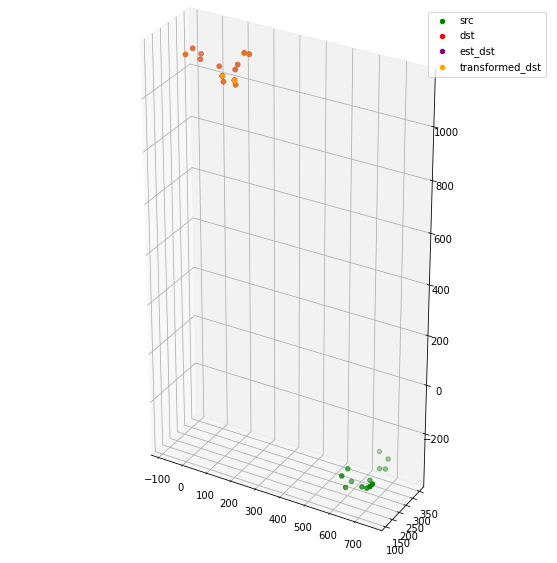

[[ 105.60405859   63.0867094   119.7166372    78.94405257   80.85698434
    81.28875259   23.488379    -40.89552314  -47.2496241   -68.29508398
   -70.94101508  116.58976628   99.29621022]
 [ 255.85549249  247.82227072  224.20489463  213.98215844  310.82414942
   294.1494827   285.97485169  269.89842933  285.33152776  265.31676335
   223.36733159  326.10097868  322.45835724]
 [1029.6894149  1033.79490847 1061.61692776 1071.56249383 1076.48760545
  1064.89899931 1066.32047833 1083.71115539 1096.2590352  1118.9687722
  1111.7940914  1117.24259142 1119.24864166]]
[[ 105.60405859   63.0867094   119.7166372    78.94405257   80.85698434
    81.28875259   23.488379    -40.89552314  -47.2496241   -68.29508398
   -70.94101508  116.58976628   99.29621022]
 [ 255.85549249  247.82227072  224.20489463  213.98215844  310.82414942
   294.1494827   285.97485169  269.89842933  285.33152776  265.31676335
   223.36733159  326.10097868  322.45835724]
 [1029.6894149  1033.79490847 1061.61692776 1071.562493

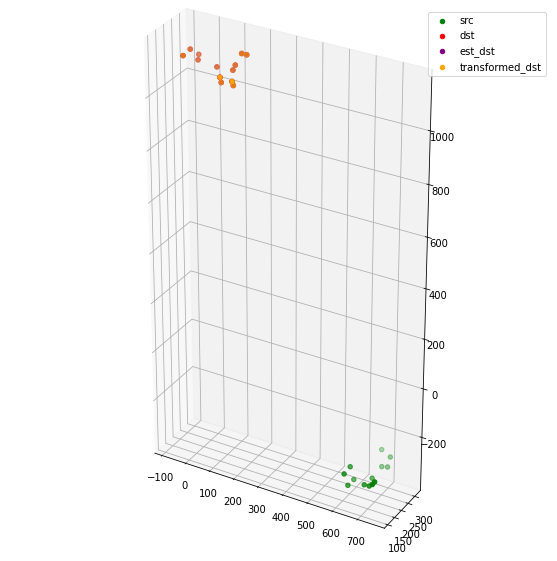

[[  95.22423402   52.63899061  108.99593393   68.11618323   70.6280323
    71.00299416   13.14585663  -51.41411954  -57.72332794  -78.99432634
   -81.87788808  106.28175097   88.95672626]
 [ 242.94648787  235.12496571  210.70659006  200.59265394  297.33071598
   280.83807939  273.01632264  257.08516375  272.3596399   252.12651307
   210.31321291  311.73258186  308.17083014]
 [1032.5611056  1036.3602564  1064.04476118 1073.65603349 1080.11553927
  1068.26737198 1069.31624733 1086.17986238 1098.9426474  1121.24510324
  1113.39877784 1121.25652496 1123.13201243]]
[[  95.22423402   52.63899061  108.99593393   68.11618323   70.6280323
    71.00299416   13.14585663  -51.41411954  -57.72332794  -78.99432634
   -81.87788808  106.28175097   88.95672626]
 [ 242.94648787  235.12496571  210.70659006  200.59265394  297.33071598
   280.83807939  273.01632264  257.08516375  272.3596399   252.12651307
   210.31321291  311.73258186  308.17083014]
 [1032.5611056  1036.3602564  1064.04476118 1073.6560334

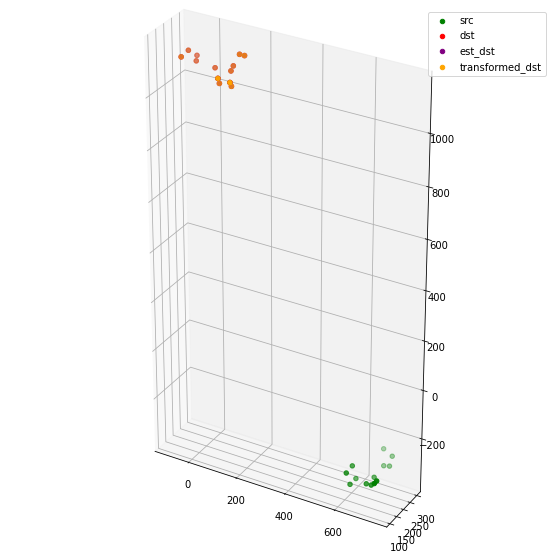

[[  96.03122236   53.42059257  109.7280847    68.82482859   71.76439089
    72.04473922   14.1568363   -50.43668387  -56.6545888   -77.96708496
   -81.04569636  107.56246179   90.22614692]
 [ 250.0139525   242.37864551  217.7443156   207.81465851  304.54696992
   288.04196494  280.46938656  264.83080549  280.14395533  260.02280313
   218.21504128  318.83370071  315.34801487]
 [1029.39363011 1033.28580525 1060.87946491 1070.58244519 1076.9468894
  1065.11333788 1066.28599904 1083.29440263 1096.05565313 1118.41971073
  1110.61810696 1118.00257772 1119.91626283]]
[[  96.03122236   53.42059257  109.7280847    68.82482859   71.76439089
    72.04473922   14.1568363   -50.43668387  -56.6545888   -77.96708496
   -81.04569636  107.56246179   90.22614692]
 [ 250.0139525   242.37864551  217.7443156   207.81465851  304.54696992
   288.04196494  280.46938656  264.83080549  280.14395533  260.02280313
   218.21504128  318.83370071  315.34801487]
 [1029.39363011 1033.28580525 1060.87946491 1070.582445

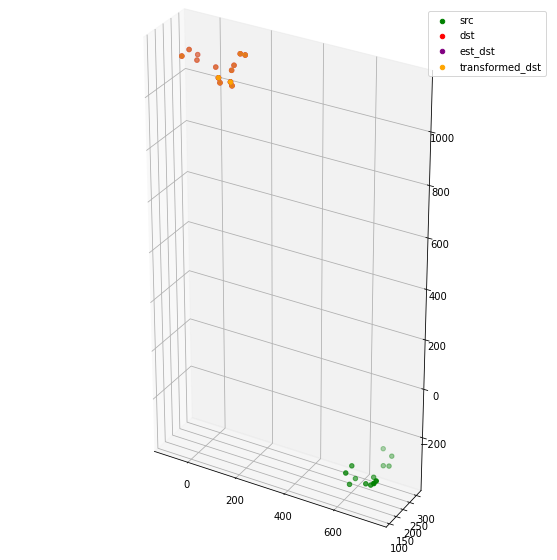

[[  98.91353302   56.19809971  112.17990045   71.14989344   75.62123876
    75.61379253   17.61732948  -47.17156227  -53.1173377   -74.68780921
   -78.44060661  111.73938648   94.35529528]
 [ 261.61060995  254.66812846  229.31742025  220.08860091  316.79893724
   300.22163463  293.56546911  279.04363255  294.52792611  274.87675579
   233.07689275  330.76553469  327.56374026]
 [1025.12260052 1029.1607213  1056.76821145 1066.62669486 1072.40641515
  1060.67101108 1062.02530649 1079.27899095 1091.96318668 1114.49717421
  1106.95265415 1113.29156723 1115.26688881]]
[[  98.91353302   56.19809971  112.17990045   71.14989344   75.62123876
    75.61379253   17.61732948  -47.17156227  -53.1173377   -74.68780921
   -78.44060661  111.73938648   94.35529528]
 [ 261.61060995  254.66812846  229.31742025  220.08860091  316.79893724
   300.22163463  293.56546911  279.04363255  294.52792611  274.87675579
   233.07689275  330.76553469  327.56374026]
 [1025.12260052 1029.1607213  1056.76821145 1066.62669

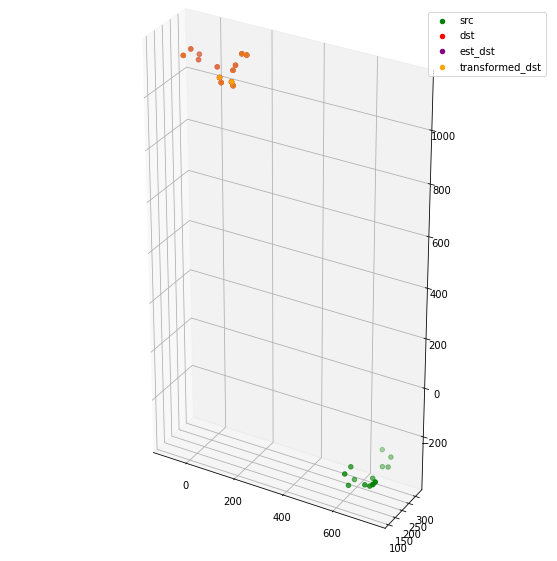

[[  86.41717831   43.71066074   99.69168118   58.66227705   62.85943517
    62.92564698    4.94409289  -59.84816931  -65.86698111  -87.44043572
   -91.06218927   98.83835869   81.45808345]
 [ 261.27931354  254.19729077  228.82150753  219.42076832  316.10407814
   299.60161749  292.78212311  277.97811116  293.36566851  273.51436189
   231.75334185  329.9073627   326.64668126]
 [1024.22432359 1028.11161342 1055.69764085 1065.39487632 1071.7986811
  1059.95844737 1061.12560787 1078.12495631 1090.89215638 1113.2471561
  1105.42846521 1112.86166318 1114.77320683]]
[[  86.41717831   43.71066074   99.69168118   58.66227705   62.85943517
    62.92564698    4.94409289  -59.84816931  -65.86698111  -87.44043572
   -91.06218927   98.83835869   81.45808345]
 [ 261.27931354  254.19729077  228.82150753  219.42076832  316.10407814
   299.60161749  292.78212311  277.97811116  293.36566851  273.51436189
   231.75334185  329.9073627   326.64668126]
 [1024.22432359 1028.11161342 1055.69764085 1065.3948763

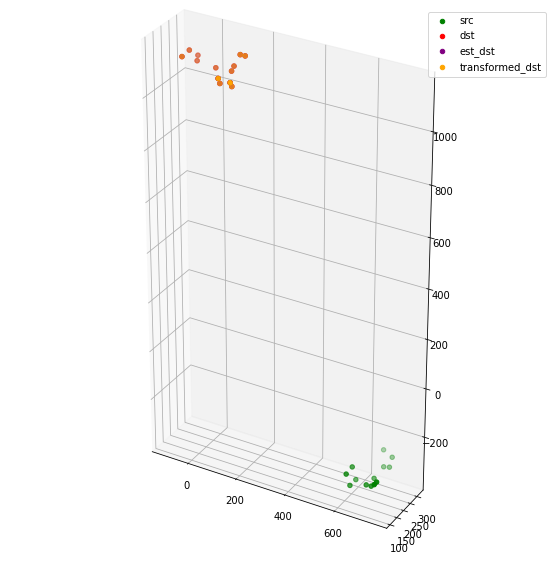

[[  74.67063266   31.87761311   87.44053615   46.26375078   51.26422767
    51.26806862   -6.77779649  -71.81416775  -77.78646696  -99.68828907
  -103.62174858   87.07621314   69.6551204 ]
 [ 263.60434051  256.88833025  230.95291045  221.88908535  318.51553735
   302.04263834  295.73017895  281.45401497  296.86207414  277.14561238
   235.43762047  331.89984092  328.78731164]
 [1017.90990838 1021.48277769 1049.39172818 1058.78010916 1065.45927467
  1053.57776342 1054.32528061 1070.83695567 1083.6012719  1105.75540592
  1097.8053664  1106.80590953 1108.58851971]]
[[  74.67063266   31.87761311   87.44053615   46.26375078   51.26422767
    51.26806862   -6.77779649  -71.81416775  -77.78646696  -99.68828907
  -103.62174858   87.07621314   69.6551204 ]
 [ 263.60434051  256.88833025  230.95291045  221.88908535  318.51553735
   302.04263834  295.73017895  281.45401497  296.86207414  277.14561238
   235.43762047  331.89984092  328.78731164]
 [1017.90990838 1021.48277769 1049.39172818 1058.78010

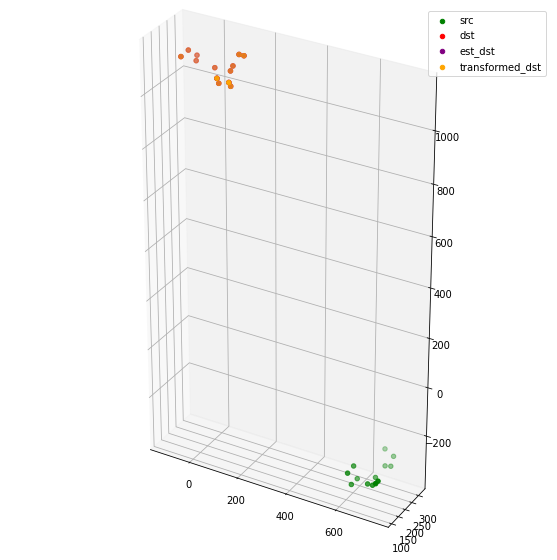

[[  58.82511093   16.06964375   71.66380899   30.50443797   34.59467443
    34.8293731   -23.16163775  -88.18272462  -94.38221036 -116.26273873
  -119.76746406   69.99334001   52.58860114]
 [ 261.79733212  254.67959649  229.06888264  219.58229041  316.20674015
   299.80744617  292.97496023  278.02077039  293.29685249  273.2515136
   231.55957872  329.65582258  326.37776731]
 [1011.96954703 1015.19763896 1043.34322586 1052.38385761 1059.68268811
  1047.70208713 1047.99903477 1063.96162628 1076.77615343 1098.65448055
  1090.42457851 1101.36288433 1103.00283203]]
[[  58.82511093   16.06964375   71.66380899   30.50443797   34.59467443
    34.8293731   -23.16163775  -88.18272462  -94.38221036 -116.26273873
  -119.76746406   69.99334001   52.58860114]
 [ 261.79733212  254.67959649  229.06888264  219.58229041  316.20674015
   299.80744617  292.97496023  278.02077039  293.29685249  273.2515136
   231.55957872  329.65582258  326.37776731]
 [1011.96954703 1015.19763896 1043.34322586 1052.3838576

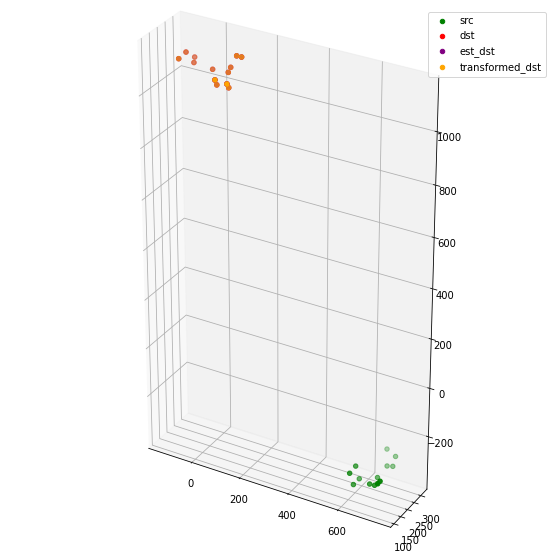

[[  70.78453373   27.9583556    83.43352483   42.22663084   47.91439192
    47.76545611  -10.31970213  -75.39777992  -81.22153584 -103.18509248
  -107.43194407   83.9544396    66.51832906]
 [ 243.95398508  237.45999416  210.59507369  201.62682355  298.06456451
   281.83218299  275.90197712  261.74319959  276.93406969  256.92961574
   215.41620507  310.37738682  307.34878464]
 [1007.70506378 1011.29104491 1038.48618384 1047.83415975 1056.41895682
  1044.21181406 1045.03366102 1061.48196393 1074.57111007 1096.4036164
  1087.63818391 1097.9001751  1099.6805199 ]]
[[  70.78453373   27.9583556    83.43352483   42.22663084   47.91439192
    47.76545611  -10.31970213  -75.39777992  -81.22153584 -103.18509248
  -107.43194407   83.9544396    66.51832906]
 [ 243.95398508  237.45999416  210.59507369  201.62682355  298.06456451
   281.83218299  275.90197712  261.74319959  276.93406969  256.92961574
   215.41620507  310.37738682  307.34878464]
 [1007.70506378 1011.29104491 1038.48618384 1047.834159

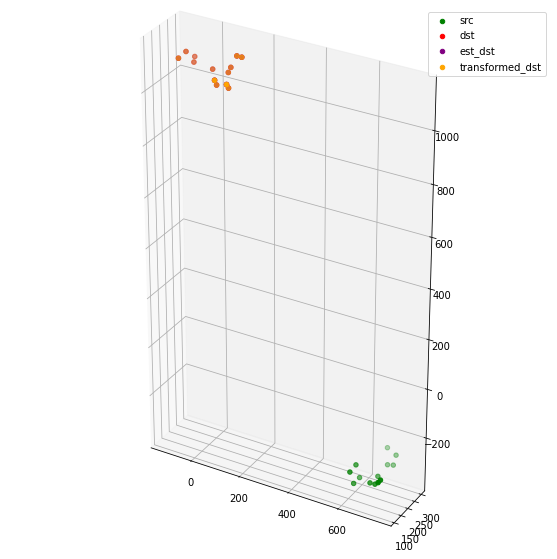

[[  65.68249069   22.6617556    77.12203647   35.59947691   43.89300818
    43.40136872  -14.83140489  -80.4229494   -85.93833236 -108.64469687
  -113.96714134   79.88948894   62.36059263]
 [ 238.49923299  233.19718684  204.77243774  196.94664988  293.18056727
   276.96996071  272.65902155  260.30297064  275.63799715  256.2327658
   214.8618861   304.44638126  301.90291581]
 [1005.10253585 1008.2989981  1035.95592094 1044.92566836 1053.67425295
  1041.44718249 1041.74427306 1057.59517694 1070.64975187 1092.26207098
  1083.41030739 1095.48952418 1097.11081613]]
[[  65.68249069   22.6617556    77.12203647   35.59947691   43.89300818
    43.40136872  -14.83140489  -80.4229494   -85.93833236 -108.64469687
  -113.96714134   79.88948894   62.36059263]
 [ 238.49923299  233.19718684  204.77243774  196.94664988  293.18056727
   276.96996071  272.65902155  260.30297064  275.63799715  256.2327658
   214.8618861   304.44638126  301.90291581]
 [1005.10253585 1008.2989981  1035.95592094 1044.9256683

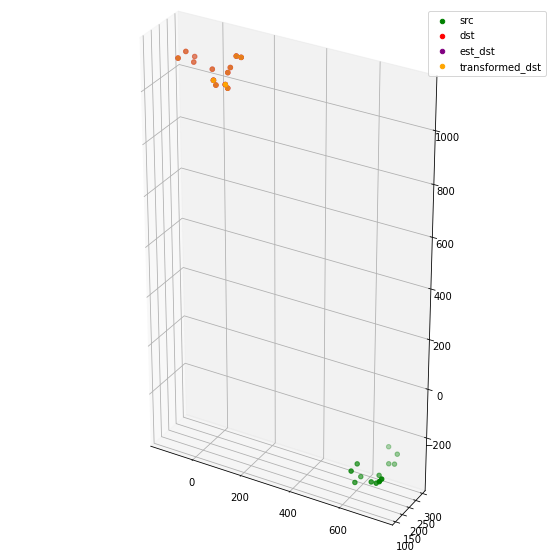

[[  72.33553242   29.27775673   83.56073619   41.99678641   51.22730015
    50.54139863   -7.72811173  -73.37929192  -78.70557105 -101.52072903
  -107.26311678   87.46972016   69.92319625]
 [ 241.830777    236.95732534  208.20505073  200.83258918  297.04030455
   280.75341406  276.99539506  265.36672699  280.84044859  261.79620918
   220.41905806  308.24549326  305.87882452]
 [1005.53638462 1008.91131176 1036.57823749 1045.738323   1053.8105202
  1041.69468496 1042.21414305 1058.36562835 1071.33478808 1093.15266703
  1084.59765856 1095.42917993 1097.1257611 ]]
[[  72.33553242   29.27775673   83.56073619   41.99678641   51.22730015
    50.54139863   -7.72811173  -73.37929192  -78.70557105 -101.52072903
  -107.26311678   87.46972016   69.92319625]
 [ 241.830777    236.95732534  208.20505073  200.83258918  297.04030455
   280.75341406  276.99539506  265.36672699  280.84044859  261.79620918
   220.41905806  308.24549326  305.87882452]
 [1005.53638462 1008.91131176 1036.57823749 1045.738323

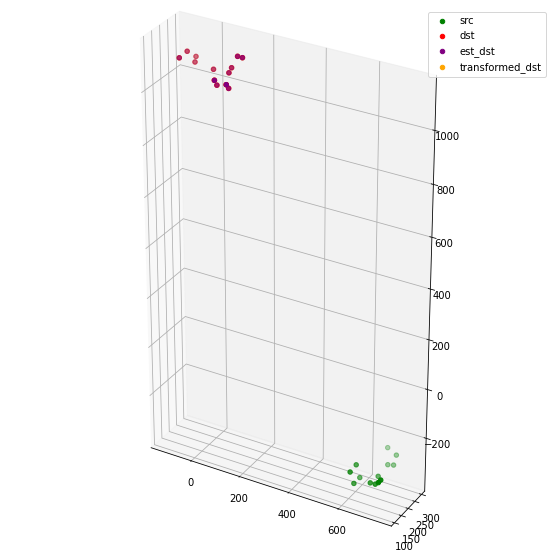

[[  76.46520087   33.41479205   87.77698593   46.2451349    55.73723435
    54.95045356   -3.32392813  -68.91551203  -74.13817446  -96.88151385
  -102.76313268   92.22366262   74.68096428]
 [ 242.0769938   237.32890843  208.65979226  201.45282913  297.6968853
   281.32094988  277.70205057  266.34745     281.93059976  263.10396854
   221.67705895  309.13077095  306.81761881]
 [1007.80097144 1011.43837401 1039.03597516 1048.4692837  1055.76784169
  1043.77882833 1044.63228509 1061.21513848 1074.09510954 1096.17525448
  1087.96248746 1097.11017969 1098.91657721]]
[[  76.46520087   33.41479205   87.77698593   46.2451349    55.73723435
    54.95045356   -3.32392813  -68.91551203  -74.13817446  -96.88151385
  -102.76313268   92.22366262   74.68096428]
 [ 242.0769938   237.32890843  208.65979226  201.45282913  297.6968853
   281.32094988  277.70205057  266.34745     281.93059976  263.10396854
   221.67705895  309.13077095  306.81761881]
 [1007.80097144 1011.43837401 1039.03597516 1048.4692837

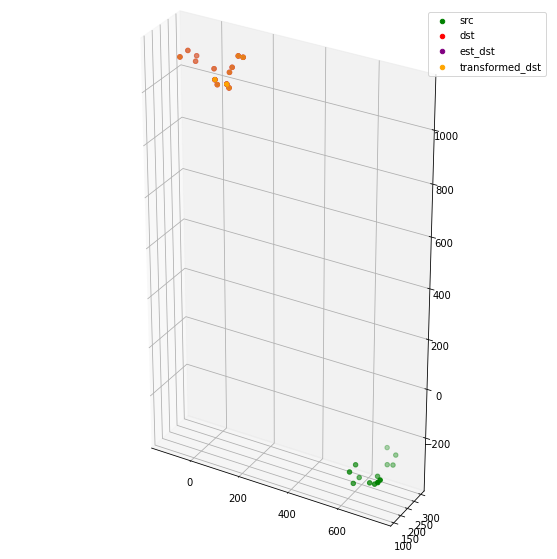

[[  69.20759143   26.53200033   82.7752584    41.84150839   46.39481792
    46.26787903  -11.71425911  -76.33459664  -82.15157297 -103.50512255
  -107.34276457   82.91599345   65.55127391]
 [ 234.91215425  227.89507895  202.00526292  192.588331    289.16680789
   272.82219949  266.14496942  251.29309631  266.52677408  246.44018304
   204.79614089  302.32851167  299.08993992]
 [1008.32873193 1012.64929783 1039.20503697 1049.28331955 1056.9090931
  1044.85237759 1046.64531845 1064.24667354 1077.28899932 1099.64496297
  1091.32161761 1097.70315383 1099.7859832 ]]
[[  69.20759143   26.53200033   82.7752584    41.84150839   46.39481792
    46.26787903  -11.71425911  -76.33459664  -82.15157297 -103.50512255
  -107.34276457   82.91599345   65.55127391]
 [ 234.91215425  227.89507895  202.00526292  192.588331    289.16680789
   272.82219949  266.14496942  251.29309631  266.52677408  246.44018304
   204.79614089  302.32851167  299.08993992]
 [1008.32873193 1012.64929783 1039.20503697 1049.283319

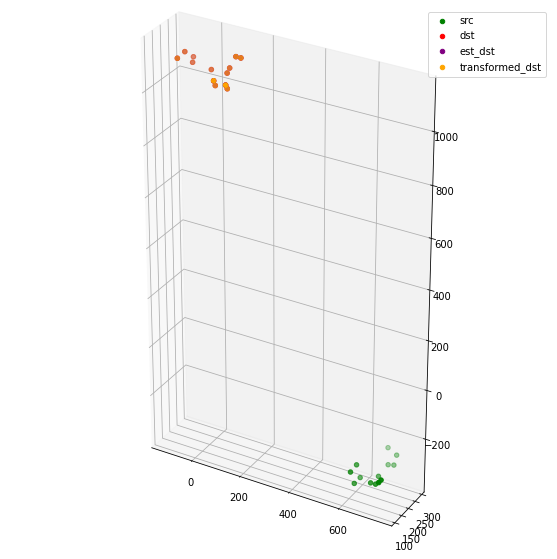

[[  69.37153522   26.67918672   82.99326454   42.1102267    48.27846103
    47.68230387  -10.35302379  -74.86233982  -80.2074973  -101.45588762
  -106.0808869    85.73233803   68.36084019]
 [ 230.90178958  224.53874583  197.79234803  189.00330081  285.50109275
   269.1598662   263.37075568  249.51016183  264.8315829   245.07498446
   203.49421612  298.1039981   295.13160978]
 [1006.01465046 1011.11247018 1036.649674   1047.47335836 1054.98443588
  1042.93721055 1045.78595132 1064.56375585 1077.70482741 1100.45163065
  1092.21264365 1095.10370773 1097.50287011]]
[[  69.37153522   26.67918672   82.99326454   42.1102267    48.27846103
    47.68230387  -10.35302379  -74.86233982  -80.2074973  -101.45588762
  -106.0808869    85.73233803   68.36084019]
 [ 230.90178958  224.53874583  197.79234803  189.00330081  285.50109275
   269.1598662   263.37075568  249.51016183  264.8315829   245.07498446
   203.49421612  298.1039981   295.13160978]
 [1006.01465046 1011.11247018 1036.649674   1047.47335

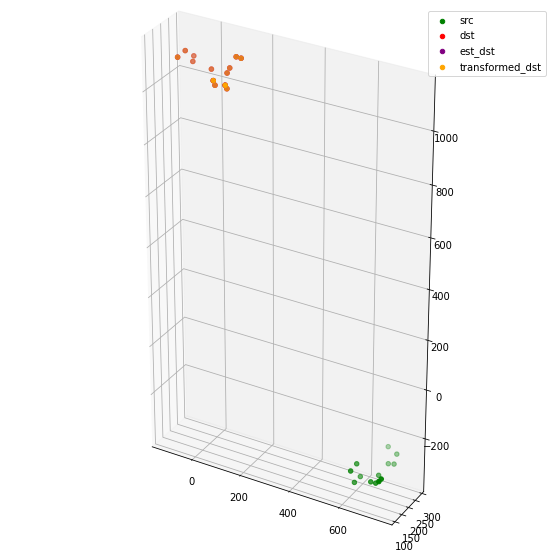

[[  68.97885487   26.71748358   84.71683238   44.53539228   47.72292596
    47.27053068  -10.41108124  -73.75675623  -79.16834963  -98.97165864
  -102.47743987   86.05592303   68.88346756]
 [ 210.24989508  202.34363327  177.06303403  166.68838816  263.18496687
   247.05834173  239.24467598  222.85076166  237.73581521  216.85012562
   175.29534023  276.3124097   272.70637096]
 [1001.14421194 1007.51447354 1030.66098031 1042.64600727 1051.84041721
  1039.50129138 1044.13881819 1064.74801256 1078.35515229 1101.39536176
  1092.49923166 1090.94839185 1093.85756138]]
[[  68.97885487   26.71748358   84.71683238   44.53539228   47.72292596
    47.27053068  -10.41108124  -73.75675623  -79.16834963  -98.97165864
  -102.47743987   86.05592303   68.88346756]
 [ 210.24989508  202.34363327  177.06303403  166.68838816  263.18496687
   247.05834173  239.24467598  222.85076166  237.73581521  216.85012562
   175.29534023  276.3124097   272.70637096]
 [1001.14421194 1007.51447354 1030.66098031 1042.64600

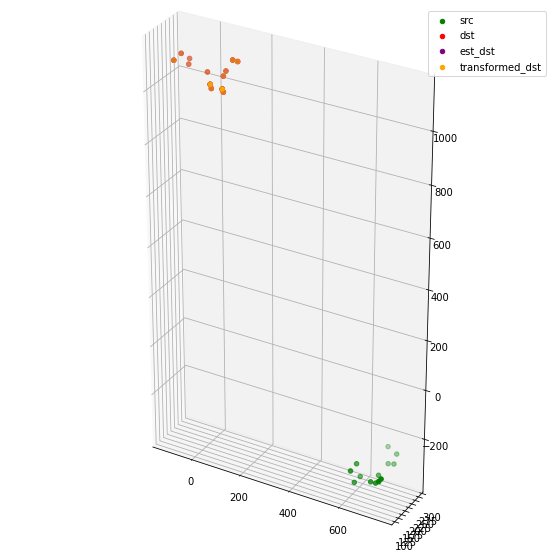

[[  66.37088795   24.48231353   83.62980141   44.05529825   46.1658087
    45.50890854  -11.85151969  -74.17877671  -79.31836841  -97.98366949
  -101.19975681   85.6715312    68.66768552]
 [ 199.53827757  190.92536504  166.24139023  155.12479089  251.54190989
   235.55841986  226.82803635  209.24402223  223.883341    202.43081285
   160.93712842  264.77465157  260.8777256 ]
 [ 996.74334294 1004.50721969 1025.26944496 1038.53979519 1048.81462645
  1036.29970516 1042.87922323 1065.51303286 1079.48727191 1102.95277642
  1093.67038684 1086.70096353 1090.17129635]]
[[  66.37088795   24.48231353   83.62980141   44.05529825   46.1658087
    45.50890854  -11.85151969  -74.17877671  -79.31836841  -97.98366949
  -101.19975681   85.6715312    68.66768552]
 [ 199.53827757  190.92536504  166.24139023  155.12479089  251.54190989
   235.55841986  226.82803635  209.24402223  223.883341    202.43081285
   160.93712842  264.77465157  260.8777256 ]
 [ 996.74334294 1004.50721969 1025.26944496 1038.5397951

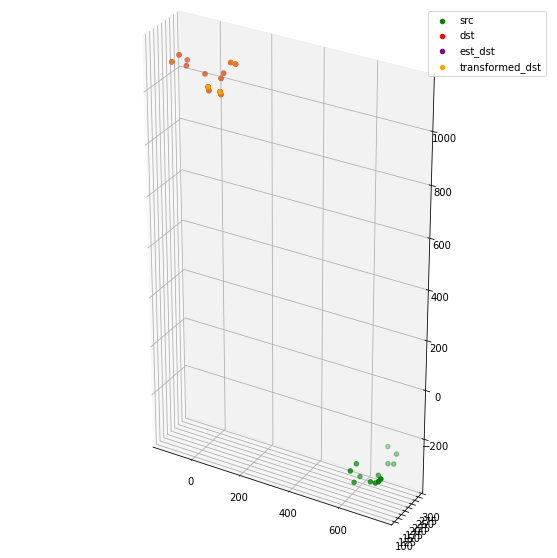

[[  68.15896173   26.733293     87.00340423   48.1359178    49.08604695
    48.21737137   -8.70976127  -69.85744256  -74.70436596  -92.1332234
   -95.02982426   89.76437886   72.96677465]
 [ 203.11342325  193.87927525  170.24204043  158.56970208  255.0601046
   239.00356989  229.40106604  210.95079689  225.57921095  203.9560002
   162.36907517  269.11236016  264.96496346]
 [ 990.05009858  999.41797945 1018.06171181 1032.85688986 1042.60300321
  1030.19494849 1038.95975714 1063.99418345 1078.08394034 1102.33071364
  1093.36582712 1078.92089862 1083.04395617]]
[[  68.15896173   26.733293     87.00340423   48.1359178    49.08604695
    48.21737137   -8.70976127  -69.85744256  -74.70436596  -92.1332234
   -95.02982426   89.76437886   72.96677465]
 [ 203.11342325  193.87927525  170.24204043  158.56970208  255.0601046
   239.00356989  229.40106604  210.95079689  225.57921095  203.9560002
   162.36907517  269.11236016  264.96496346]
 [ 990.05009858  999.41797945 1018.06171181 1032.85688986 10

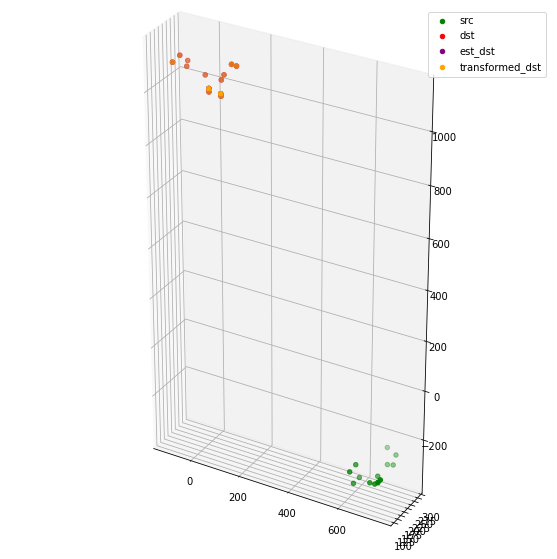

[[  68.69568493   27.91844064   89.4723775    51.51934749   50.14068598
    49.26113677   -7.01298545  -66.65452744  -71.38241737  -87.29280904
   -89.35935347   91.72781766   75.21638031]
 [ 184.24175268  173.7090649   151.54064324  138.56978844  234.90685325
   219.00231978  207.66969467  187.15269327  201.4447282   179.00789613
   137.48124727  249.61289638  244.93474533]
 [ 985.8959767   996.63802247 1012.71495849 1028.7507533  1039.86634974
  1027.26480482 1037.96635411 1064.94992285 1079.42020994 1103.96979922
  1094.50942664 1074.87241885 1079.54653365]]
[[  68.69568493   27.91844064   89.4723775    51.51934749   50.14068598
    49.26113677   -7.01298545  -66.65452744  -71.38241737  -87.29280904
   -89.35935347   91.72781766   75.21638031]
 [ 184.24175268  173.7090649   151.54064324  138.56978844  234.90685325
   219.00231978  207.66969467  187.15269327  201.4447282   179.00789613
   137.48124727  249.61289638  244.93474533]
 [ 985.8959767   996.63802247 1012.71495849 1028.75075

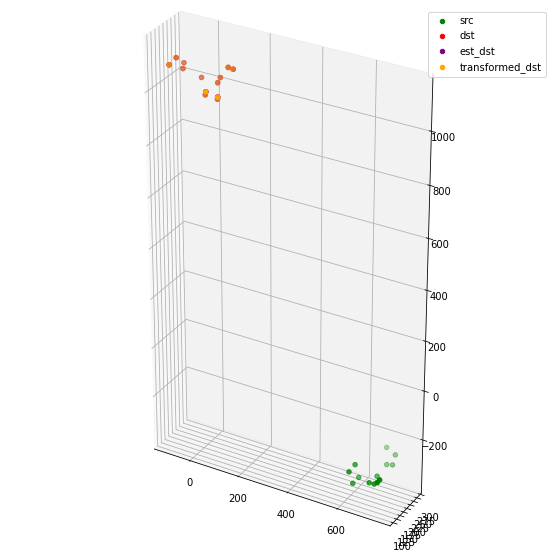

[[  71.438644     30.79398959   92.39075453   54.66805079   55.07735967
    53.62454388   -2.52342183  -61.75893715  -65.88775028  -81.50492716
   -84.46178563   97.78027182   81.32448473]
 [ 184.85990209  174.99158316  151.90181388  139.56406361  235.93706102
   220.01830971  209.59233667  190.07448949  204.4730536   182.34613313
   140.83449543  250.07430832  245.66599516]
 [ 976.9395339   988.76074624 1003.3036152  1020.35060373 1031.23017561
  1018.69983606 1030.88316131 1059.45554701 1074.00335329 1099.01809909
  1089.7297868  1065.1091017  1070.22123006]]
[[  71.438644     30.79398959   92.39075453   54.66805079   55.07735967
    53.62454388   -2.52342183  -61.75893715  -65.88775028  -81.50492716
   -84.46178563   97.78027182   81.32448473]
 [ 184.85990209  174.99158316  151.90181388  139.56406361  235.93706102
   220.01830971  209.59233667  190.07448949  204.4730536   182.34613313
   140.83449543  250.07430832  245.66599516]
 [ 976.9395339   988.76074624 1003.3036152  1020.35060

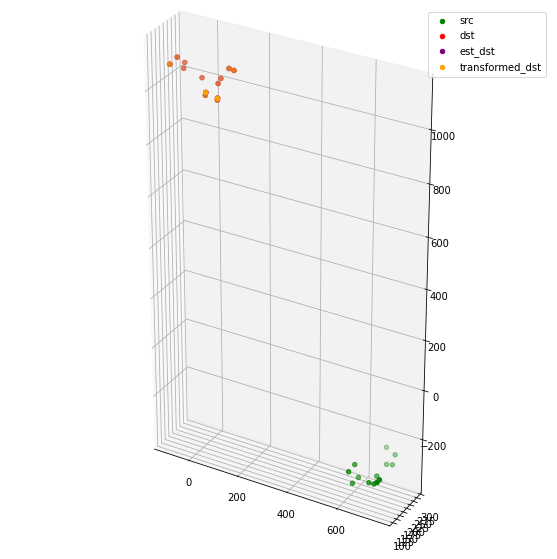

[[  96.24853708   56.92953866  120.35865053   84.39024417   80.68575323
    79.26897054   24.5433913   -31.82139946  -35.77225029  -48.73730729
   -50.19142284  124.60327305  108.72431529]
 [ 203.39627804  191.22421037  170.99193313  156.39141104  252.40677136
   236.7053879   223.18043093  200.07116082  213.92784169  190.50734081
   149.10642927  267.97203609  262.62468416]
 [ 985.71992805  999.68308828 1009.98826458 1028.93346912 1042.10975755
  1029.3040553  1044.53280763 1076.07874011 1091.19123782 1116.54122335
  1106.43766494 1073.73500201 1079.70363147]]
[[  96.24853708   56.92953866  120.35865053   84.39024417   80.68575323
    79.26897054   24.5433913   -31.82139946  -35.77225029  -48.73730729
   -50.19142284  124.60327305  108.72431529]
 [ 203.39627804  191.22421037  170.99193313  156.39141104  252.40677136
   236.7053879   223.18043093  200.07116082  213.92784169  190.50734081
   149.10642927  267.97203609  262.62468416]
 [ 985.71992805  999.68308828 1009.98826458 1028.93346

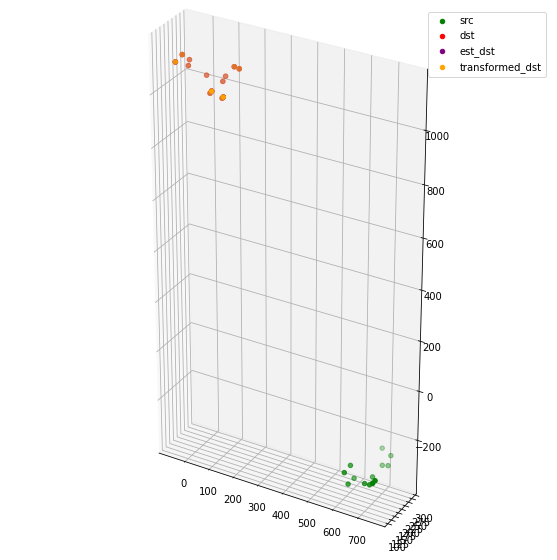

[[ 1.23206130e+02  8.40774143e+01  1.47064690e+02  1.11399398e+02
   1.11939334e+02  1.09379882e+02  5.48716356e+01 -9.48131576e-01
  -3.72035442e+00 -1.64861713e+01 -1.99530660e+01  1.57723244e+02
   1.41918574e+02]
 [ 2.17452848e+02  2.06641726e+02  1.83916139e+02  1.70501495e+02
   2.66451611e+02  2.50944192e+02  2.39352903e+02  2.18083568e+02
   2.31928207e+02  2.08763803e+02  1.67551011e+02  2.80022712e+02
   2.75222011e+02]
 [ 1.00399261e+03  1.01952245e+03  1.02693492e+03  1.04727839e+03
   1.06140535e+03  1.04854083e+03  1.06598277e+03  1.09971618e+03
   1.11509946e+03  1.14078367e+03  1.13040492e+03  1.09125230e+03
   1.09784970e+03]]
[[ 1.23206130e+02  8.40774143e+01  1.47064690e+02  1.11399398e+02
   1.11939334e+02  1.09379882e+02  5.48716356e+01 -9.48131576e-01
  -3.72035442e+00 -1.64861713e+01 -1.99530660e+01  1.57723244e+02
   1.41918574e+02]
 [ 2.17452848e+02  2.06641726e+02  1.83916139e+02  1.70501495e+02
   2.66451611e+02  2.50944192e+02  2.39352903e+02  2.18083568e+02

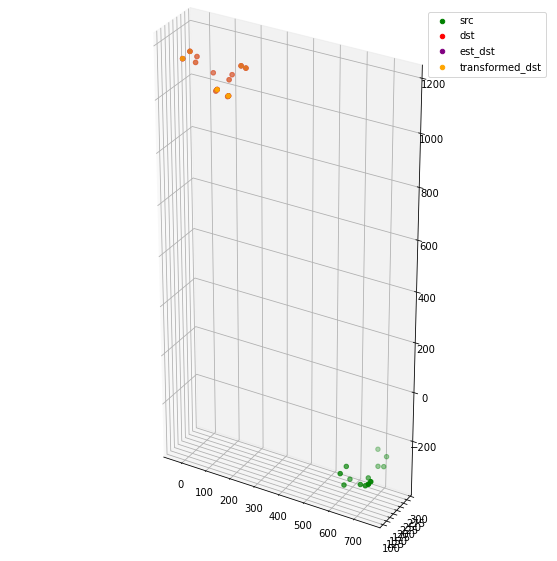

[[ 119.92887901   80.42955274  142.21110821  106.07748775  111.7389906
   108.2613678    53.38032165   -3.16989799   -5.08075355  -18.80725147
   -24.50770666  158.43053923  142.45645662]
 [ 227.84402191  219.72228874  194.03984711  183.32970311  279.60449878
   263.75440683  255.7357959   238.77498861  253.34513724  231.91841508
   190.56465562  291.93148934  288.23088882]
 [ 970.30483326  986.52067076  994.41025432 1015.51657007 1025.78294002
  1013.56788983 1031.82990049 1066.76666527 1081.60121324 1108.27916598
  1099.5841553  1054.75062357 1061.64223082]]
[[ 119.92887901   80.42955274  142.21110821  106.07748775  111.7389906
   108.2613678    53.38032165   -3.16989799   -5.08075355  -18.80725147
   -24.50770666  158.43053923  142.45645662]
 [ 227.84402191  219.72228874  194.03984711  183.32970311  279.60449878
   263.75440683  255.7357959   238.77498861  253.34513724  231.91841508
   190.56465562  291.93148934  288.23088882]
 [ 970.30483326  986.52067076  994.41025432 1015.5165700

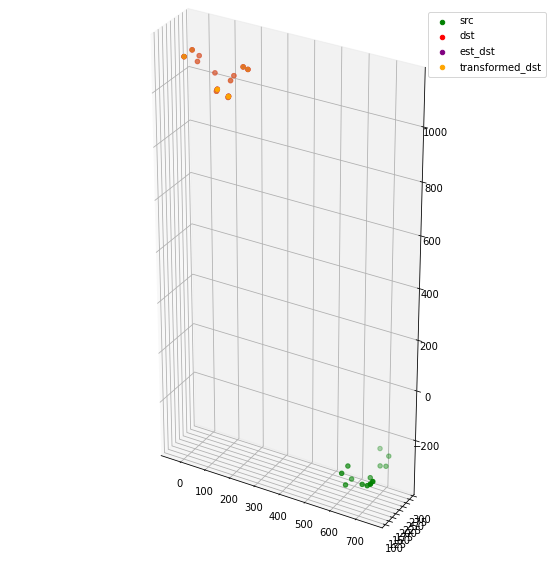

[[  90.989977     50.62715668  109.238723     71.87987495   87.50988609
    82.55582518   26.88018991  -31.63572994  -32.2118874   -48.4997791
   -58.40236904  134.8222173   118.4503092 ]
 [ 232.74378064  229.64717524  198.09112116  192.3255213   287.88316406
   271.87154666  270.59131509  261.46898522  276.90847891  258.44613455
   217.51991756  296.74711959  295.0988944 ]
 [ 938.66501814  954.48799137  964.86554786  985.76761971  991.31080554
   979.83857321  997.39741785 1032.02174573 1046.06790147 1073.51021834
  1066.78598628 1020.53674792 1027.28982046]]
[[  90.989977     50.62715668  109.238723     71.87987495   87.50988609
    82.55582518   26.88018991  -31.63572994  -32.2118874   -48.4997791
   -58.40236904  134.8222173   118.4503092 ]
 [ 232.74378064  229.64717524  198.09112116  192.3255213   287.88316406
   271.87154666  270.59131509  261.46898522  276.90847891  258.44613455
   217.51991756  296.74711959  295.0988944 ]
 [ 938.66501814  954.48799137  964.86554786  985.7676197

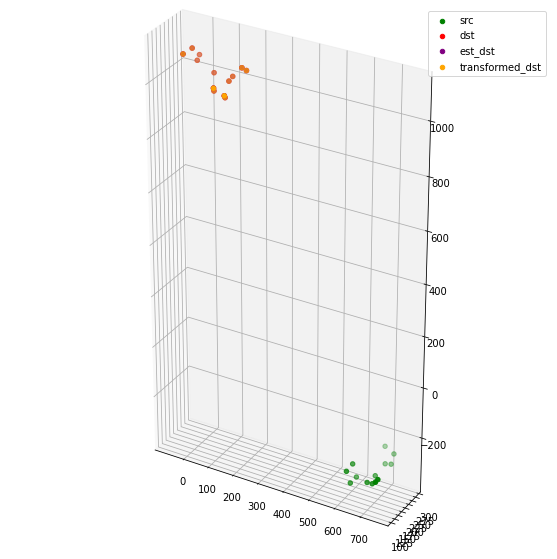

[[  76.32466998   36.08077004   95.65289392   58.49575153   71.12750886
    66.67551244   11.06968368  -47.12717225  -48.1844158   -63.88255647
   -72.50006215  118.14323766  101.83188953]
 [ 217.21453546  212.71412851  182.91652759  175.79702491  271.7435596
   255.6882438   252.50832187  241.24848888  256.53577959  237.32721836
   196.17302171  281.82176816  279.60133862]
 [ 945.15409764  960.94294074  971.04536475  991.88959004  998.29181127
   986.67573238 1004.21449761 1038.74732229 1052.93130595 1080.20462415
  1073.11219759 1027.60278291 1034.33848071]]
[[  76.32466998   36.08077004   95.65289392   58.49575153   71.12750886
    66.67551244   11.06968368  -47.12717225  -48.1844158   -63.88255647
   -72.50006215  118.14323766  101.83188953]
 [ 217.21453546  212.71412851  182.91652759  175.79702491  271.7435596
   255.6882438   252.50832187  241.24848888  256.53577959  237.32721836
   196.17302171  281.82176816  279.60133862]
 [ 945.15409764  960.94294074  971.04536475  991.8895900

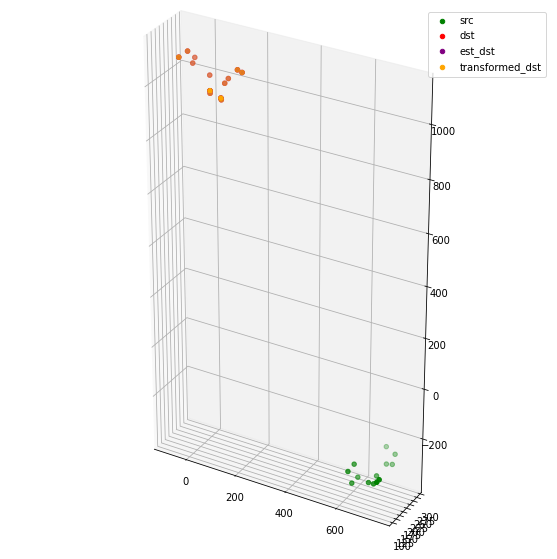

0 out of 172 images failed
[[  33.2724982     4.9671052     1.25381468  -31.26401346   21.82148281
    20.08924026  -14.09728151  -66.51182183  -69.04602762 -105.7634699
  -126.35688104   21.54286407    9.59531259]
 [ 164.79990612  168.29259231  154.91091854  159.63966852  239.96312074
   219.90923897  224.50828476  232.98404034  253.64538866  254.1953732
   216.87030347  268.9356993   270.24513745]
 [ 780.78155908  747.98341003  813.90712514  785.87050527  774.19316156
   771.4787762   724.36339773  680.92319297  679.28279643  676.00235736
   676.99352248  822.48078072  809.36966347]]


NameError: name 'cv2' is not defined

In [32]:
easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr = evaluate_comparison(data, solver_params)

In [ ]:
print(easy_pos_error_norms[["Depth"]].std())
print(easy_pos_error_norms[["Detector"]].std())

In [ ]:
# plot_comparison(pos_error_norms, rot_error_norms)
plot_errors(easy_pos_error_norms[["Ground Truth"]], 
            easy_rot_error_norms[["Ground Truth"]],
            pos_max=300, rot_max=0.3)

plot_errors(easy_pos_error_norms[["Depth"]], 
            easy_rot_error_norms[["Depth"]],
            pos_max=300, rot_max=0.3)

plot_errors(easy_pos_error_norms[["Detector"]], 
            easy_rot_error_norms[["Detector"]],
            pos_max=300, rot_max=0.3)

# plot_errors(easy_pos_error_norms[["Detector", "Detector Filt"]], 
#             easy_rot_error_norms[["Detector", "Detector Filt"]],
#             pos_max=0.1, rot_max=0.5)

plot_errors(easy_pos_error_norms[["Ground Truth", "Depth", "Detector"]], 
            easy_rot_error_norms[["Ground Truth", "Depth", "Detector"]],
            pos_max=300, rot_max=0.3)

In [ ]:
plot_errors_distance(easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr, "Ground Truth")
plot_errors_distance(easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr, "Depth")
plot_errors_distance(easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr, "Detector")

# Hard Test Set

In [ ]:
teaser_folder = "/home/subella/TestSetHard/Validation/"

# Open the data folder and parse the metadata into a python dict.
with open(teaser_folder + "metadata.json") as json_file:
    data = json.load(json_file)

In [ ]:
hard_pos_error_norms, hard_rot_error_norms = evaluate_comparison(data, solver_params)

In [ ]:
plot_errors(hard_pos_error_norms[["Depth", "Depth Filt"]], 
            hard_rot_error_norms[["Depth", "Depth Filt"]],
            pos_max=0.1, rot_max=0.5)

plot_errors(hard_pos_error_norms[["Detector", "Detector Filt"]], 
            hard_rot_error_norms[["Detector", "Detector Filt"]],
            pos_max=None, rot_max=None)

plot_errors(hard_pos_error_norms[["Ground Truth", "Depth", "Detector"]], 
            hard_rot_error_norms[["Ground Truth", "Depth", "Detector"]],
            pos_max=0.7, rot_max=0.5)

# Teaser Ground Truth with Stereo Depth

Helper functions to calculate focal lengths:

In [ ]:
def vfov_from_hfov(hfov, width, height):
    """ Returns horiziontal FOV based on provided vertical FOV and dimensions.

        Based on (this source)[http://paulbourke.net/miscellaneous/lens].

        Args:
            hfov: Horizontal FOV in degrees.
            width: width of image, in pixels.
            height: height of image, in pixels.

        Returns:
            A float representing the vertical FOV of the image in degrees.
    """
    return np.rad2deg(2.0 * np.arctan(np.tan(np.deg2rad(hfov) / 2.0) * height / width))


def hfov_from_vfov(vfov, width, height):
    """ Returns vertical FOV based on provided horizontal FOV and dimensions.

        Based on (this source)[http://paulbourke.net/miscellaneous/lens].

        Args:
            vfov: Vertical FOV in degrees.
            width: width of image, in pixels.
            height: height of image, in pixels.

        Returns:
            A float representing the horizontal FOV of the image in degrees.
    """
    return np.rad2deg(2.0 * np.arctan(np.tan(np.deg2rad(vfov) / 2.0) * width / height))


def fx_from_hfov(hfov, width):
    """ Returns horizontal focal length based on provided horizontal FOV and
        width.

        Based on (this source)[http://paulbourke.net/miscellaneous/lens].

        Args:
            hfov: Horizontal FOV in degrees.
            width: width of the image, in pixels.

        Returns:
            A float representing the horizontal focal length of the image in
            pixels.
    """
    return (width / 2.0) / np.tan(np.deg2rad(hfov) / 2.0)


def fy_from_vfov(vfov, height):
    """ Returns vertical focal length based on provided vertical FOV and
        height.

        Based on (this source)[http://paulbourke.net/miscellaneous/lens].

        Args:
            vfov: Vertical FOV in degrees.
            height: height of the image, in pixels.

        Returns:
            A float representing the vertical focal length of the image in
            pixels.
    """
    return (height / 2.0) / np.tan(np.deg2rad(vfov) / 2.0)

Lets plot a disparity map for an rgb pair to sanity check:

In [ ]:
def stereo_to_3D(left_image, right_image):
    # Get camera params from JSON metadata.
    stereo_baseline = data["cameraParams"]["stereoBaseline"]
    unity_vertical_fov = data["cameraParams"]["fieldOfView"]
    width = data["images"][0]["width"]
    height = data["images"][0]["height"]

    print(unity_vertical_fov)
    print(width)
    print(height)
    # Convert Unity fov to focal lengths.
    unity_horizontal_fov = hfov_from_vfov(unity_vertical_fov, width, height)
    fx = fx_from_hfov(unity_horizontal_fov, width)
    fy = fy_from_vfov(unity_vertical_fov, height)

    assert(np.isclose(fx, fy))

    f = fx
    
    rgb_left = cv2.cvtColor(left_image, cv2.COLOR_BGR2GRAY)
    rgb_right = cv2.cvtColor(right_image, cv2.COLOR_BGR2GRAY)
    stereo = cv2.StereoBM_create()
    cx = width//2
    cy = height//2
    Tx = -stereo_baseline
    Q = np.float32([[1, 0, 0, -cx],
                 [0, 1, 0, -cy],
                 [0, 0, 0, fx],
                 [0, 0, -1/Tx, 0]])

    disparity = stereo.compute(rgb_left, rgb_right).astype(np.float32) / 16.
    points_3D = cv2.reprojectImageTo3D(disparity, Q)
    depth = stereo_baseline * f / disparity
    return depth, disparity, points_3D

left_image = cv2.imread(teaser_folder + "medkit_image_rgb_left_3.png")
right_image = cv2.imread(teaser_folder + "medkit_image_rgb_right_3.png")
depth, disparity, world_points = stereo_to_3D(left_image, right_image)

# depth = stereo_baseline * f / disparity

plt.figure()
plt.imshow(disparity, 'gray')
plt.figure()
plt.imshow(depth, 'gray')
plt.figure()
image_rgb = cv2.cvtColor(left_image,cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)

# print(points_3D[236, 328])

Iterate over every image pair and double check that the computed location of each visible keypoint matches with the ground truth:

In [ ]:
def kpts_pixels_to_meters(kpts_gt_pixels, world_points):
    world_pos_list = []
    for x, y, v in zip(*[iter(kpts_gt_pixels)]*3):
#         px = kpts_gt_pixels[i*3]
#         py = kpts_gt_pixels[i*3 + 1]
        world_pos = world_points[y, x]
        world_pos_enu = np.array([world_pos[0], world_pos[2], -world_pos[1]])
        world_pos_list.append(world_pos_enu)
    return np.array(world_pos_list).reshape((3,20))

def evaluate_test_set_stereo():
    # Positions of the keypoints in the CAD frame.
    src_kpts = data["keypointFrame"]["localKeypoints"]
    src_kpts_wrt_world = kpts_unity_to_enu_np(src_kpts)

    # By construction the transform src wrt world is the identity.
    gt_src_wrt_world_tf = np.eye(4)
    
    annotations = data["annotations"]
    est_transformation_arr = np.empty((len(annotations),4,4))
    gt_transformation_arr = np.empty((len(annotations),4,4))
    
    for annotation_id in range(0, len(annotations),2):
        left_annotation = annotations[annotation_id]
        right_annotation = annotations[annotation_id + 1]
        left_image = cv2.imread(teaser_folder + left_annotation["file_name"])
        right_image = cv2.imread(teaser_folder + right_annotation["file_name"])
 
        gt_cam_wrt_world_pos_unity = left_annotation["cameraPosition"]
        gt_cam_wrt_world_rot_unity = left_annotation["cameraRotation"]
        gt_cam_wrt_world_tf = unity_to_enu_transformation(gt_cam_wrt_world_pos_unity, 
                                                            gt_cam_wrt_world_rot_unity)
        
        gt_tar_wrt_world_pos_unity = left_annotation["localPosition"]
        gt_tar_wrt_world_rot_unity = left_annotation["localRotation"]
        gt_tar_wrt_world_tf = unity_to_enu_transformation(gt_tar_wrt_world_pos_unity, gt_tar_wrt_world_rot_unity)

        gt_kpts_wrt_cam_pixels = left_annotation["keypoints"]
        _, world_points = stereo_to_3D(left_image, right_image)
        est_kpts_wrt_cam = kpts_pixels_to_meters(gt_kpts_wrt_cam_pixels, world_points)
        est_kpts_wrt_world = transform_kpts(est_kpts_wrt_cam, gt_cam_wrt_world_tf)
#         print ("Estimate", est_kpts_wrt_world)

        # Target's transformation relative to the camera.
        gt_tar_wrt_cam_tf = np.matmul(gt_tar_wrt_world_tf, np.linalg.inv(gt_cam_wrt_world_tf))

        # Keypoints attached to current target's location relative to the world.
        gt_kpts_wrt_world_unity = left_annotation["groundTruthKeypoints"]
        dst_kpts_wrt_world = kpts_unity_to_enu_np(gt_kpts_wrt_world_unity)
#         print("gt", dst_kpts_wrt_world)

        # Target's tf relative to the keypoints CAD frame.
        est_tar_wrt_src_pos, est_tar_wrt_src_rot = estimate_pose(src_kpts_wrt_world, est_kpts_wrt_world)
        est_tar_wrt_src_tf = make_transformation_matrix(est_tar_wrt_src_rot, est_tar_wrt_src_pos)

        # Estimated pose of target wrt camera frame.
        est_tar_wrt_cam_tf = np.matmul(est_tar_wrt_src_tf, np.matmul(gt_src_wrt_world_tf, np.linalg.inv(gt_cam_wrt_world_tf)))                      

        gt_transformation_arr[annotation_id] = gt_tar_wrt_cam_tf
        est_transformation_arr[annotation_id] = est_tar_wrt_cam_tf
        print("gt tf", gt_tar_wrt_cam_tf)
        print("est tf", est_tar_wrt_cam_tf)

    return est_transformation_arr, gt_transformation_arr

In [ ]:
stereo_est_transformation_arr, stereo_gt_transformation_arr = evaluate_test_set_stereo()

In [ ]:
evaluate_teaser(stereo_est_transformation_arr, stereo_gt_transformation_arr)

In [ ]:
def get_visible_kpt_ids(kpts_gt_pixels):
    ids = []
    idx = 0
    for x, y, v in zip(*[iter(kpts_gt_pixels)]*3):
        if v == 2:
            ids.append(idx)
        idx += 1
    return ids

def kpts_pixels_to_world(kpts_gt_pixels, world_points, visible_kpts_ids):
    world_pos_list = []
    
    for i in visible_kpts_ids:
        px = kpts_gt_pixels[i*3]
        py = kpts_gt_pixels[i*3 + 1]
        world_pos = world_points[py, px]
        world_pos_enu = np.array([world_pos[0], world_pos[2], -world_pos[1]])
        world_pos_list.append(world_pos_enu)
    return np.array(world_pos_list)
        
    
#     kpts_world = np.empty((len(kpts_gt_pixels)//3,3))
#     count = 0
#     for x, y, v in zip(*[iter(kpts_gt_pixels)]*3):
#         if v == 2:  
#             world_pos = world_points[y, x]
#             # LAZY SMH
#             world_pos_enu = np.array([world_pos[0], world_pos[2], -world_pos[1]])
#             world_pos_list.append(world_pos_enu)
# #             print(world_pos_list)
#         count += 1
#     return np.array(world_pos_list)
        
def get_visible_gt_kpts(kpts_gt_world, visible_kpts_ids):
    return kpts_gt_world.T[visible_kpts_ids]
            


annotations = data["annotations"]
for annotation_id in range(0, 1, 2):
    left_annotation = annotations[annotation_id]
    right_annotation = annotations[annotation_id + 1]
    left_image = cv2.imread(teaser_folder + left_annotation["file_name"])
    right_image = cv2.imread(teaser_folder + right_annotation["file_name"])
    
    kpts_gt_pixels = left_annotation["keypoints"]
    visible_kpts_ids = get_visible_kpt_ids(kpts_gt_pixels)
    print(visible_kpts_ids)
    _, world_points = stereo_to_3D(left_image, right_image)
#     print(left_annotation["keypoints"])
    stereo_kpts = kpts_pixels_to_world(kpts_gt_pixels, world_points, visible_kpts_ids)
    gt_kpts = get_visible_gt_kpts(kpts_unity_to_enu_np(left_annotation["groundTruthKeypoints"]), visible_kpts_ids)
    src_kpts = data["keypointFrame"]["localKeypoints"]
    src = (kpts_unity_to_enu_np(src_kpts).T[visible_kpts_ids]).T
    est_pos, est_rot = estimate_pose(src, stereo_kpts.T)
    est_transformation = make_transformation_matrix(est_rot, est_pos)
    
    gt_pos_unity = left_annotation["localPosition"]
    gt_rot_unity = left_annotation["localRotation"]
    gt_transformation = unity_to_enu_transformation(gt_pos_unity, gt_rot_unity)
    
    
    
    print ("Stereo", stereo_kpts)
    print ("Ground Truth", gt_kpts)
    print ("Error", stereo_kpts - gt_kpts)
    print ("Estimated Pose", est_transformation)
    print ("GT Pose", gt_transformation)

In [ ]:
evaluate_teaser(np.expand_dims(est_transformation,axis=0), np.expand_dims(gt_transformation, axis=0))

# Teaser with Keypoint Predictions

In [ ]:
def get_visible_kpt_ids(kpts_gt_pixels):
    ids = []
    idx = 0
    for x, y, v in zip(*[iter(kpts_gt_pixels)]*3):
        if v == 2:
            ids.append(idx)
        idx += 1
    return ids

def kpts_pixels_to_world(kpts_gt_pixels, world_points, visible_kpts_ids):
    world_pos_list = []
    
    for i in visible_kpts_ids:
        px = kpts_gt_pixels[i*3]
        py = kpts_gt_pixels[i*3 + 1]
        world_pos = world_points[py, px]
        world_pos_enu = np.array([world_pos[0], world_pos[2], -world_pos[1]])
        world_pos_list.append(world_pos_enu)
    return np.array(world_pos_list)
        
    
#     kpts_world = np.empty((len(kpts_gt_pixels)//3,3))
#     count = 0
#     for x, y, v in zip(*[iter(kpts_gt_pixels)]*3):
#         if v == 2:  
#             world_pos = world_points[y, x]
#             # LAZY SMH
#             world_pos_enu = np.array([world_pos[0], world_pos[2], -world_pos[1]])
#             world_pos_list.append(world_pos_enu)
# #             print(world_pos_list)
#         count += 1
#     return np.array(world_pos_list)
        
def get_visible_gt_kpts(kpts_gt_world, visible_kpts_ids):
    return kpts_gt_world.T[visible_kpts_ids]
            

kpt_cfg.MODEL.WEIGHTS = os.path.join(kpt_cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
kpt_cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = .7  # set a custom testing threshold
kpt_predictor = DefaultPredictor(kpt_cfg)

annotations = data["annotations"]
for annotation_id in range(0, 1, 2):
    left_annotation = annotations[annotation_id]
    right_annotation = annotations[annotation_id + 1]
    left_image = cv2.imread(teaser_folder + left_annotation["file_name"])
    right_image = cv2.imread(teaser_folder + right_annotation["file_name"])

    outputs = kpt_predictor(image)
    predictions = np.array(outputs["instances"].to("cpu").pred_keypoints)
    
    print (predictions.flatten())
    
    kpts_gt_pixels = left_annotation["keypoints"]
    kpts_nn_pixels = predictions.flatten()
    visible_kpts_ids = get_visible_kpt_ids(kpts_gt_pixels)
    print(visible_kpts_ids)
    print(kpts_gt_pixels)
    _, world_points = stereo_to_3D(left_image, right_image)
#     print(left_annotation["keypoints"])
    stereo_kpts = kpts_pixels_to_world(kpts_nn_pixels, world_points, visible_kpts_ids)
    gt_kpts = get_visible_gt_kpts(kpts_unity_to_enu_np(left_annotation["groundTruthKeypoints"]), visible_kpts_ids)
    src_kpts = data["keypointFrame"]["localKeypoints"]
    src = (kpts_unity_to_enu_np(src_kpts).T[visible_kpts_ids]).T
    est_pos, est_rot = estimate_pose(src, stereo_kpts.T)
    est_transformation = make_transformation_matrix(est_rot, est_pos)
    
    gt_pos_unity = left_annotation["localPosition"]
    gt_rot_unity = left_annotation["localRotation"]
    gt_transformation = unity_to_enu_transformation(gt_pos_unity, gt_rot_unity)
    
    
    
    print ("Stereo", stereo_kpts)
    print ("Ground Truth", gt_kpts)
    print ("Error", stereo_kpts - gt_kpts)
    print ("Estimated Pose", est_transformation)
    print ("GT Pose", gt_transformation)